# Exploration of Socioeconomic Influences on Cancer Mortality

## Introduction

Cancer is an ever-present threat to our health, productivity, and potential, and the effects that socioeconomic, geographic and dietary factors have on cancer mortality are an important area of study. Of course, the field of oncology research has a long and rich history, but using machine learning models to predict cancer outcomes is a fairly new field. The earliest paper found in a literature review on the subject used machine learning models in conjunction with electronic administrative records and a cancer registry to predict cancer survival (Gupta, Tran, Luo, Phung, Kennedy, Broad, Campbell, Kipp, Singh, Khasraw, Matheson, Ashley, Venkatesh, 2014). A paper just published in Scientific Reports in July 2020 used machine learning models to investigate the major effects of health-related quality of life on five-year survival prediction among lung cancer survivors (Sim, Kim, Kim, Lee, Kim, Shim, Zo, Yun, 2020). This project aims to add to this body of literature by using a set of socioeconomic  indicators, geographic locations, proximity to non-cancerogenic and cancerogenic locations, and food environment features to attempt to predict cancer mortality at the U.S. county level for the year 2015.

The original data set of socioeconomic indicators and cancer mortality rates for 2015 amongst 3,047 out of 3,141 total U.S. counties (97% of all U.S. counties and county equivalents) came pre-assembled as a data science challenge from the American Community Survey (census.gov), clinicaltrials.gov, and cancer.gov, and was downloaded from https://data.world/exercises/linear-regression-exercise-1. The assemblage process can be examined at https://data.world/nrippner/cancer-trials. The data dictionaries are located at https://data.world/exercises/linear-regression-exercise-1/workspace/data-dictionary. The target variable is mean per capita (100,000) cancer mortality by county, labeled as ‘TARGET_deathRate’, and the original DataFrame contains 31 other features. After removing a feature that contained the same information as the target variable in order to eliminate the chances for data leakage, and after the binned median income string feature binned on deciles was binarized into separate binary features for each income category, an initial run of a basic Ordinary Least Squares (OLS) linear regression model returned a test accuracy with no hyperparameter tuning of 49.2%.

As was detailed in the Data Cleaning notebook, the latitude/longitude centroids for the 3,047 counties were downloaded from https://www2.census.gov/geo/docs/maps-data/data/gazetteer/2019_Gazetteer/2019_Gaz_counties_national.zip and concatenated to the original DataFrame. 38 counties in the original DataFrame did not have county latitude/longitude centroid data, so they were looked up via Google search. These county latitude/longitude centroids were added to the core feature set.

The top 10 oncology hospitals were then found via https://health.usnews.com/best-hospitals/rankings/cancer, and their latitude/longitude locations were looked up via Google Search. L1 and L2 latitude/longitude distances to these hospitals were then calculated from each county centroid and added to the feature set, as were the L1 and L2 distances to the closest top 10 oncology hospital for each county.

Because large urban centers often have more healthcare resources, the latitude/longitude locations for eight major regional urban centers were looked up via Google search. These cities were Chicago, New York City, Atlanta, Dallas, Denver, Los Angeles, Seattle, and San Francisco. L1 and L2 latitude/longitude distances to these cities  were then calculated from each county centroid and added to the core feature set, as were the L1 and L2 distances to the closest of these regional urban centers for each county.

As Environmental Protection Agency (EPA) designated Superfund Cleanup sites contain toxic and potentially carcinogenic materials, the latitude/longitude locations of these sites could serve as predictive features and were downloaded from the EPA's website at https://semspub.epa.gov/work/HQ/201261.pdf. The L1 and L2 latitude/longitude distances to the closest of these sites for each county were then calculated and added to the core feature set.

A large set of food environment variables for the year 2015 such as the percentage of the county's populace with low access to a grocery store, or the number of farmer's markets in a county, were downloaded from the U.S. Department of Agriculture's Food Environment Atlas at https://www.ers.usda.gov/data-products/food-environment-atlas/data-access-and-documentation-downloads/#August%202015%20Version. 

After adding all of these external features to the feature set, the test accuracy increased from 49.2% to 55.3%, for an accuracy increase of 6.1%. 

As an exploratory step of understanding how the predictive feature set influences the target variable, distributions of each predictor variable of interest are visualized in histograms and bar charts below. Correlations and covariance matrices between these predictive features and the target variable are also called.

In order to uncover non-linear relationships between the target variable and the predictive features, the logarithmic and exponential transformations of these features were computed, plotted, and tested for their contribution to the overall model's accuracy. This process is further detailed in the "Logarithmic and Exponential Expansion of Predictive Feature Set" section below. After a thorough process of experimentation, the addition of these logarithmic and exponential features increased the overall model's accuracy from 55.3% to 60.5%, for an accuracy increase of 5.2%.

## Loading and Preparing DataFrame for Visual EDA

In [1]:
import csv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns
%matplotlib inline

In [2]:
current_palette = sns.color_palette()

In [3]:
pd.set_option('display.max_columns', 1000)
pd.set_option('display.width', 1000)
pd.set_option('display.max_rows', 500)

In [4]:
cancer = pd.read_csv('cancer_ml6.csv', index_col=['Geography'])

The index for the DataFrame is the 'Geography' feature, which stores county and state names. There are 3,047 counties in the DataFrame; not all U.S. counties are accounted for, as the original cancer dataset from https://data.world/exercises/linear-regression-exercise-1 only had data for 3,047 counties in the 50 states. However, most of the counties were accounted for. Puerto Rico and other U.S. territories were not included. 

The target, or dependent, variable for this study is "TARGET_deathRate", the mean per capita (100,000) cancer mortalities for each county for the year 2015. The set of features that compose the predictive feature set for exploratory data analysis (EDA) is shown in the following list, including a user-friendly feature name and the original dataset's variable name. This list does not contain all of the predictive features that will be used in the machine learning phase.

Mean number of reported cases of cancer diagnosed annually ('avgAnnCount')

Mean per capita (100,000) cancer diagnoses ('incidenceRate')

Median income per county ('medIncome')

Population of county ('popEst2015')

Percent of populace in poverty ('povertyPercent')

Per capita number of cancer-related clinical trials per county ('studyPerCap')

Median age of county residents ('MedianAge')

Median age of male county residents ('MedianAgeMale')

Median age of female county residents ('MedianAgeFemale')

Average Household Size (occupied buildings) ('AvgHouseholdSize')

Percent of county residents who are married  ('PercentMarried')

Percent of county residents ages 18-24 highest education attained: less than high school ('PctNoHS18_24')

Percent of county residents ages 18-24 highest education attained: high school diploma ('PctHS18_24')

Percent of county residents ages 18-24 highest education attained: some college ('PctSomeCol18_24')

Percent of county residents ages 18-24 highest education attained: bachelor's degree ('PctBachDeg18_24')

Percent of county residents ages 25 and over highest education attained: high school diploma ('PctHS25_Over')

Percent of county residents ages 25 and over highest education attained: bachelor's degree  ('PctBachDeg25_Over')

Percent of county residents ages 16 and over employed ('PctEmployed16_Over')

Percent of county residents ages 16 and over unemployed ('PctUnemployed16_Over')

Percent of county residents with private health coverage ('PctPrivateCoverage')

Percent of county residents with private health coverage alone (no public assistance) ('PctPrivateCoverageAlone')

Percent of county residents with employee-provided private health coverage ('PctEmpPrivCoverage')

Percent of county residents with government-provided health coverage ('PctPublicCoverage')

Percent of county residents with government-provided health coverage alone ('PctPublicCoverageAlone')

Percent of county residents who identify as White ('PctWhite')

Percent of county residents who identify as Black ('PctBlack')

Percent of county residents who identify as Asian ('PctAsian')

Percent of county residents who identify in a category which is not White, Black, or Asian ('PctOtherRace')

Percent of married households ('PctMarriedHouseholds')

Number of live births relative to number of women in county ('BirthRate')

Latitude ('INTPTLAT')

Longitude ('INTPTLONG')

L1 distance to CLOSEST top 10 oncology hospital ('onc_min_distsl1')

L2 distance to CLOSEST top 10 oncology hospital ('onc_min_distsl2)

L1 distance to CLOSEST regional urban center ('city_min_distsl1')

L2 distance to CLOSEST regional urban center ('city_min_distsl2')

L1 distance to CLOSEST EPA Superfund Cleanup Site ('sc_min_dists_l1')

L2 distance to CLOSEST EPA Superfund Cleanup Site ('sc_min_dists_l2')

Population, low access to grocery store (%), 2010 ('PCT_LACCESS_POP10')

Low income & low access to grocery store (%), 2010 ('PCT_LACCESS_LOWI10')

Households, no car & low access to grocery store (%), 2010 ('PCT_LACCESS_HHNV10')

Household food insecurity (%, three-year average), 2010-12* ('FOODINSEC_10_12')

Household food insecurity (change %),2007-09 to 2010-12* ('CH_FOODINSEC_09_12')

Direct farm sales (%), 2007 ('PCT_LOCLSALE07')

Farmers' markets, 2013 ('FMRKT13')

Farmers' markets (% change), 2009-13 ('PCH_FMRKT_09_13')

Adult diabetes rate, 2010 ('PCT_DIABETES_ADULTS10')

Adult obesity rate, 2013 ('PCT_OBESE_ADULTS13')

Recreation & fitness facilities, 2012 ('RECFAC12')

ERS natural amenity index, 1999 ('NATAMEN')

Persistent-poverty counties, 2010 ('PERPOV10')

Child poverty rate, 2010 ('CHILDPOVRATE10')

Persistent-child-poverty counties, 2010 ('PERCHLDPOV10')

Metro/nonmetro counties, 2010 ('METRO13')

Population-loss counties, 2000 ('POPLOSS00')

The full list of features, and their characteristics, are called below in the data dictionary. Features that are included in the EDA part of the analysis are marked with an asterisk.

In [5]:
cancer_data_dict = pd.read_excel('2ndCapDataDict.xlsx', sheet_name='Data_Dict')
cancer_data_dict

,Variable,Definition,Data Type,Had Nulls?
0,TARGET_deathRate,"Dependent variable. Mean per capita (100,000) ...",continuous,0
1,avgAnnCount*,Mean number of reported cases of cancer diagno...,continuous,0
2,incidenceRate*,"Mean per capita (100,000) cancer diagnoses",continuous,0
3,medIncome*,Median income per county,continuous,0
4,popEst2015*,Population of county,continuous,0
5,povertyPercent*,Percent of populace in poverty,continuous,0
6,studyPerCap*,Per capita number of cancer-related clinical t...,continuous,0
7,MedianAge*,Median age of county residents,continuous,0
8,MedianAgeMale*,Median age of male county residents,continuous,0
9,MedianAgeFemale*,Median age of female county residents,continuous,0


# Descriptive Statistics

In [6]:
cancer.describe()

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_DIABETES_ADULTS09,PCT_DIABETES_ADULTS10,PCT_OBESE_ADULTS09,PCT_OBESE_ADULTS10,PCT_OBESE_ADULTS13,PCT_OBESE_CHILD08,PCT_OBESE_CHILD11,PCH_OBESE_CHILD_08_11,PCT_HSPA09,RECFAC07,RECFAC12,PCH_RECFAC_07_12,RECFACPTH07,RECFACPTH12,PCH_RECFACPTH_07_12,NATAMEN,PERPOV10,CHILDPOVRATE10,PERCHLDPOV10,METRO13,POPLOSS00,povertyPercent_log,povertyPercent_sqrd,MedianAge_log,MedianAgeFemale_sqrd,AvgHouseholdSize_log,PercentMarried_log,PercentMarried_sqrd,PctSomeCol18_24_log,PctSomeCol18_24_sqrd,PctHS25_Over_sqrd,PctBachDeg25_Over_log,PctEmployed16_Over_log,PctEmployed16_Over_sqrd,PctPrivateCoverage_log,PctEmpPrivCoverage_log,PctPublicCoverage_log,PctPublicCoverageAlone_log,PctPublicCoverageAlone_sqrd,PctWhite_sqrd,PctBlack_sqrd,INTPTLONG_sqrd,mskcc_l1_log,mayo_l1_log,mayo_l1_sqrd,dfb_l1_log,dfb_l1_sqrd,cleveland_l1_log,cleveland_l1_sqrd,upmcps_l1_log,mgs_l1_log,atlanta_l1_log,denver_l1_sqrd,los_ang_l1_sqrd,seattle_l1_log,hopkins_l2_log,dfb_l2_log,cleveland_l2_log,upmcps_l2_log,mgs_l2_log,atlanta_l2_log,city_min_distsl1_sqrd,sc_min_dists_l1_log,PCT_LACCESS_CHILD10_sqrd,PCT_LACCESS_HHN

## Target Variable: 'TARGET_deathRate', mean per capita (100,000) cancer mortalities

The distribution of the target variable and feature set are called below. The target variable's name is 'TARGET_deathRate', and it describes the mean per capita (100,000) cancer mortalities in the United States per county for 2015. 

As a first step, the distribution of the target variable 'TARGET_deathRate' is visualized and its value counts are returned. The mean number of cancer mortalities in the United States in 2015 per 100,000 people is 178.664 and its standard deviation is 27.75. Of course, the population of U.S. counties included in this study range from 827 to 10.2 million people, so the actual count of cancer mortalities differs between counties based on county population size. The distribution below shows a roughly normal distribution with a high peak and relatively low variance.

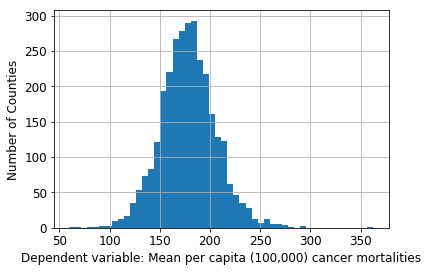

In [7]:
cancer['TARGET_deathRate'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Dependent variable: Mean per capita (100,000) cancer mortalities", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('TARGET_deathRate.png')

The county with the lowest mortality rate is Pitkin County, Colorado at 59.7 cancer mortalities per 100,000 people.

The county with the highest mortality rate is Union County, Florida at 362.8 cancer mortalities per 100,000 people.

In [8]:
cancer_sorted_on_y = cancer.sort_values(by='TARGET_deathRate')
cancer_sorted_on_y.head(1)

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

In [9]:
cancer_sorted_on_y.tail(1)

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

Five of the 10 counties with the lowest mortality rates are in Colorado. The other five counties with the lowest mortality rates are in Texas, North Dakota, South Dakota, Idaho, and California. 

In [10]:
cancer_sorted_on_y.head(10)

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

Five of the 10 counties with the highest mortality rates are in Kentucky. The other five counties with the highest mortality rates are in Missouri, Alaska, Mississippi, Kansas, and Florida.

In [11]:
cancer_sorted_on_y.tail(10)

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

# Exploring and Visualizing the Feature Set

In order to better understand the predictive feature set, three general EDA methods are utilized for each of the features listed above for exploratory data analysis.

The first is to visualize the distribution for each of the predictive features. For continuous features, a histogram is used. For binary features, a bar chart is used.

The second is to look for meaningful covariance and correlations between EDA features and the target cancer mortality variable.

The third is to include logarithmic and exponential transformations of each EDA feature in the predictive feature set in order to capture non-linear relationships between the predictive features and the target variable, thereby increasing the overall accuracy of the machine learning models built later in this project.

In order to run correlations in conjunction with covariance matrices, a quick Pearson's R function is written.

In [12]:
def pearson_r(x, y):
    corr_mat = np.corrcoef(x, y)
    return corr_mat[0, 1]

## Logarithmic and Exponential Expansion of Predictive Feature Set

As utilizing logarithmic and exponential versions for machine learning models is a somewhat specialized practice, a brief introduction of it is detailed below.

In order to uncover non-linear relationships between the target variable and the predictive features, the logarithmic and exponential transformation of these features were investigated in a series of separate notebooks (named "2nd_Capstone_Cancer_LogExp_Expansion_1-4"). For only those features that increased the model’s accuracy through logarithmic and/or exponential transformation (listed in the data dictionary above), the following plots are presented:

For the non-transformed values of these features:

- The scatter plots of the actual values of the predictive feature (X) against the actual values of the target variable (y, in blue), superimposed over the actual values of the predictive feature (X) plotted against the predicted values of the target variable (y, in orange). 

- The scatter plots of the actual values of the predictive feature (X) against the residuals (or error) of the target variable, that is the actual values of the target variable (y) minus the predicted values of the target variable (y, in blue).

Utilizing the logarithmic transformation of each feature if it increased the model's accuracy:

- The scatter plots of the actual values of the predictive feature (X) against the actual values of the target variable (y, in blue), superimposed over the actual values of the predictive feature (X) plotted against the predicted values of the target variable (y) predicted by the predictive feature plus its logarithmic transformation (in orange).

- The scatter plots of the actual values of the predictive feature (X) against the residuals (or error) of the target variable, that is the actual values of the target variable (y) minus the predicted values of the target variable predicted by the predictive feature plus its logarithmic transformation (in blue).

Utilizing the exponential transformation of each feature if it increased the model's accuracy:

- The scatter plots of the actual values of the predictive feature (X) against the actual values of the target variable (y, in blue), superimposed over the actual values of the predictive feature (X) plotted against the predicted values of the target variable (y) predicted by the predictive feature plus its exponential transformation (in orange).

- The scatter plots of the actual values of the predictive feature (X) against the residuals (or error) of the target variable, that is the actual values of the target variable (y) minus the predicted values of the target variable predicted by the predictive feature plus its exponential transformation (in blue).
        
For each feature that added to the model's accuracy, the plots are presented together in subplots first for comparative purposes, and then individually for closer inspection.

A key for the objects used in the plots follows:
        
_ap = actual & predicted values of target variable y from predictive feature X

_r = residuals from predictive feature X

_l = actual & predicted values of target variable y from predictive feature X plus its logarithmic version

_lres = residuals from predictive feature X plus its logarithmic version

_sq = actual & predicted values of target variable y from predicted feature X plus its exponential (i.e., squared) version

_sqres = residuals from predictive feature X plus its exponential (i.e., squared) version

_l&sq = actual & predicted values of target variable y from predicted feature X plus its logarithmic and exponential (i.e., squared) version

_l&sqres = residuals from predictive feature X plus its logarithmic and exponential (i.e., squared) version

## 'avgAnnCount': Mean Number of Reported Cases of Cancer Diagnosed Annually

The values of the 'avgAnnCount' feature range from 6 to 38,150, and has an average value of 606.3 with a standard deviation of 1,416. The county with the smallest value is Wibaux County, Montana, and the county with the highest value is Los Angeles County, California. 

In [13]:
cancer.describe().avgAnnCount

count     3047.000000
mean       606.338544
std       1416.356223
min          6.000000
25%         76.000000
50%        171.000000
75%        518.000000
max      38150.000000
Name: avgAnnCount, dtype: float64

In [14]:
cancer_sorted_on_avgAnnCount = cancer.sort_values(by='avgAnnCount').avgAnnCount
cancer_sorted_on_avgAnnCount.head(1)

Geography
Wibaux County, Montana    6.0
Name: avgAnnCount, dtype: float64

In [15]:
cancer_sorted_on_avgAnnCount.tail()

Geography
San Diego County, California      13294.0
Harris County, Texas              14477.0
Maricopa County, Arizona          15470.0
Cook County, Illinois             24965.0
Los Angeles County, California    38150.0
Name: avgAnnCount, dtype: float64

The full range with no X or Y limits imposed is visualized below. As can be seen, the majority of the distribution lies between 6 and approximately 2,500 diagnosed cases. There are several outliers, due to several counties with very large populations.

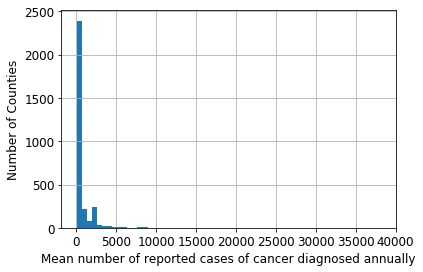

In [16]:
cancer['avgAnnCount'].hist(bins=60, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Mean number of reported cases of cancer diagnosed annually", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('avgAnnCount_full.png')

Focusing in on the main body of the distribution, the majority of counties have between 6 and 600 reported cases of cancer diagnosed annually. There is an interesting peak at around 1,900 cases, where just over 200 counties have this number of cases diagnosed. Curiously, all of the cases in this peak have the exact same value for 'avgAnnCount', namely 1962.667684. This must be an imputational artifact from how the original dataset from data.world was constructed.

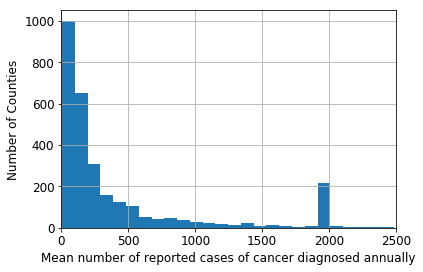

In [17]:
cancer['avgAnnCount'].hist(bins=400, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Mean number of reported cases of cancer diagnosed annually", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.xlim([0, 2500])
plt.savefig('avgAnnCount_zoomed.png')

In [18]:
avgAnnCount1900peak = cancer[(cancer['avgAnnCount'] >= 1900) & (cancer['avgAnnCount'] <= 2000)].avgAnnCount
avgAnnCount1900peak.head()

Geography
Aitkin County, Minnesota    1962.667684
Allen County, Kansas        1962.667684
Anderson County, Kansas     1962.667684
Anoka County, Minnesota     1962.667684
Atchison County, Kansas     1962.667684
Name: avgAnnCount, dtype: float64

In [19]:
avgAnnCount1900peak.tail()

Geography
Winona County, Minnesota             1962.667684
Woodson County, Kansas               1962.667684
Wright County, Minnesota             1962.667684
Wyandotte County, Kansas             1962.667684
Yellow Medicine County, Minnesota    1962.667684
Name: avgAnnCount, dtype: float64

In [20]:
len(avgAnnCount1900peak)

216

There is a slightly negative correlation of -0.14 between the number of diagnosed cancer cases and the number of cancer mortalities. This is a confusing correlation, as one would think that an increase of actual diagnosed cases would result in an increase in cancer mortality. This result could be due to the 'avgAnnCount' and 'TARGET_deathRate' variables being on different scales (i.e., actual count versus per capita), but future research is recommended for this correlation.

In [21]:
r_avgAnnCount = pearson_r(cancer['avgAnnCount'], cancer['TARGET_deathRate'])
r_avgAnnCount

-0.14353161968868808

In [22]:
cov_matrix_avgAnnCount = np.cov(cancer['avgAnnCount'], cancer['TARGET_deathRate'])
cov_matrix_avgAnnCount

array([[ 2.00606495e+06, -5.64165754e+03],
       [-5.64165754e+03,  7.70146380e+02]])

Adding a logarithmic or exponential transformation of 'avgAnnCount' did not increase the model's overall accuracy.

## 'incidenceRate': Mean per capita (100,000) cancer diagnoses 

The 'incidenceRate' feature is a per capita version of 'avgAnnCount', giving the mean per capita (100,000) cancer diagnoses. The feature's distribution ranges from 201 to 1,206 with a mean of 448.3 and a standard deviation of 54.6. The bulk of it lies between 200 and 600 diagnosed cases per 100,000 county residents. There are several outliers however, which are shown below the histogram. These counties are Powell and Bracken Counties in Kentucky, Petersburg City, Charlottesville City, and Williamsburg City in Virginia, and Union County, Florida.

In [23]:
cancer.describe().incidenceRate

count    3047.000000
mean      448.268586
std        54.560733
min       201.300000
25%       420.300000
50%       453.549422
75%       480.850000
max      1206.900000
Name: incidenceRate, dtype: float64

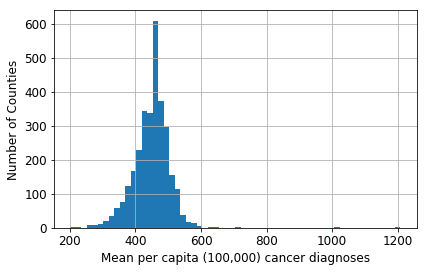

In [24]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['incidenceRate'].hist(bins=60, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Mean per capita (100,000) cancer diagnoses", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig("incidenceRate_full.png")

In [25]:
high_incidenceRate = cancer[cancer['incidenceRate'] > 600]
high_incidenceRate.sort_values(by = 'incidenceRate').incidenceRate

Geography
Powell County, Kentucky            630.4
Bracken County, Kentucky           639.7
Petersburg city, Virginia          651.3
Charlottesville city, Virginia     718.9
Williamsburg city, Virginia       1014.2
Union County, Florida             1206.9
Name: incidenceRate, dtype: float64

Looking at just the bulk of the distribution, one can see an unusual peak at just over 450 diagnosed cases per 100,000 people that stands high above the rest of the distribution. Calling the value counts of this range shows that 206 cases have the exact same incidence rate, 453.549422. This must be an artifact of the assemblage process of the original data.world dataset. 

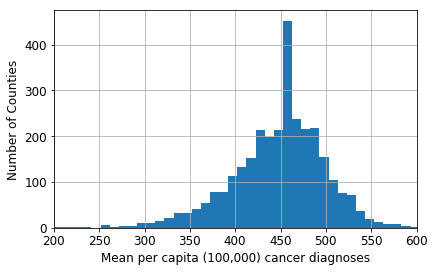

In [26]:
cancer['incidenceRate'].hist(bins=100, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Mean per capita (100,000) cancer diagnoses", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.xlim([200, 600])
plt.savefig('incidenceRate_zoomed.png')

In [27]:
incidenceRate_peak = cancer[(cancer['incidenceRate'] >=450) & (cancer['incidenceRate'] <=460)]
incidenceRate_peak['incidenceRate'].value_counts()

453.549422    206
457.000000      5
451.700000      5
460.000000      5
459.500000      5
453.400000      5
450.400000      5
459.200000      5
456.200000      5
459.600000      5
452.500000      4
451.500000      4
457.800000      4
453.600000      4
454.600000      4
456.600000      4
457.300000      4
456.900000      4
458.600000      4
456.800000      4
452.900000      4
457.200000      4
455.600000      3
458.400000      3
457.100000      3
456.700000      3
451.000000      3
455.500000      3
459.000000      3
452.400000      3
458.900000      3
450.600000      3
450.800000      3
454.300000      3
459.700000      3
458.300000      3
459.800000      3
456.500000      3
453.700000      3
454.200000      2
458.200000      2
455.800000      2
455.900000      2
457.700000      2
453.100000      2
458.500000      2
459.400000      2
457.400000      2
451.100000      2
451.300000      2
452.700000      2
452.000000      2
455.000000      2
452.200000      2
452.300000      2
459.900000

One can see a moderately strong correlation of 0.45 between the cancer incidence rate and cancer mortality rate. This makes sense and may partially exist because, unlike the 'avgAnnCount' variable, the 'incidenceRate' and 'TARGET_deathRate' features are on the same scale, namely per capita (100,000) cases.

In [28]:
r_incidenceRate = pearson_r(cancer['incidenceRate'], cancer['TARGET_deathRate'])
r_incidenceRate

0.44943169756144563

In [29]:
cov_matrix_incidenceRate = np.cov(cancer['incidenceRate'], cancer['TARGET_deathRate'])
cov_matrix_incidenceRate

array([[2976.87355487,  680.50376518],
       [ 680.50376518,  770.14638047]])

Logarithmic and exponential transformations of the 'incidenceRate' did not result in an increase in model accuracy.

## 'medIncome': Median Income per County

The median income feature has a distribution ranging from just over 20,000 dollars a year to just over 120,000 dollars a year, with a mean of 47,063 dollars and a standard deviation of 12,040 dollars. The bulk of the distribution is between 20,000 dollars and 80,000 dollars. The counties with the lowest median income are in Mississippi, Kentucky, Alabama, and West Virginia. The counties with the highest median income are in Colorado, New Mexico, and Virginia.

In [30]:
cancer.describe().medIncome

count      3047.000000
mean      47063.281917
std       12040.090836
min       22640.000000
25%       38882.500000
50%       45207.000000
75%       52492.000000
max      125635.000000
Name: medIncome, dtype: float64

Text(0, 0.5, 'Number of Counties')

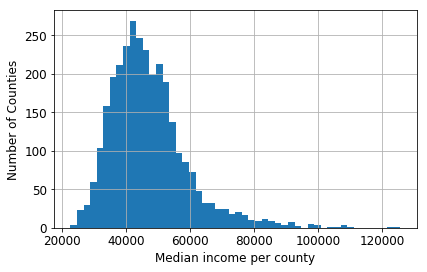

In [31]:
cancer['medIncome'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Median income per county", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [32]:
medIncome_sorted = cancer.sort_values(by = 'medIncome').medIncome
medIncome_sorted.head(5)

Geography
Holmes County, Mississippi        22640
Owsley County, Kentucky           23047
Wilcox County, Alabama            24035
McCreary County, Kentucky         24265
McDowell County, West Virginia    24707
Name: medIncome, dtype: int64

In [33]:
medIncome_sorted.tail(5)

Geography
Douglas County, Colorado         107250
Los Alamos County, New Mexico    108477
Fairfax County, Virginia         110507
Loudoun County, Virginia         122641
Falls Church city, Virginia      125635
Name: medIncome, dtype: int64

Median income and cancer mortality have a moderately negative correlation of -0.43, where cancer mortality in a county decreases as median income increases.

In [34]:
r_medIncome = pearson_r(cancer['medIncome'], cancer['TARGET_deathRate'])
r_medIncome

-0.4286149270709035

In [35]:
cov_matrix_medIncome = np.cov(cancer['medIncome'], cancer['TARGET_deathRate'])
cov_matrix_medIncome

array([[ 1.44963787e+08, -1.43213413e+05],
       [-1.43213413e+05,  7.70146380e+02]])

Adding a logarithmic or exponential transformation of 'medIncome' did not increase the model's overall accuracy score.

## 'popEst2015': Population of County

As was mentioned above, the population of U.S. counties in this dataset ranges from 827 to 10.2 million people with an average value of 102,637 and a standard deviation of 329,059, although the bulk of the distribution ranges from 827 to roughly 200,000. The full distribution is visualized below, as is the bulk. As can be seen, the majority of counties have a population less than 25,000 people.

In [36]:
cancer.describe().popEst2015

count    3.047000e+03
mean     1.026374e+05
std      3.290592e+05
min      8.270000e+02
25%      1.168400e+04
50%      2.664300e+04
75%      6.867100e+04
max      1.017029e+07
Name: popEst2015, dtype: float64

Text(0, 0.5, 'Number of Counties')

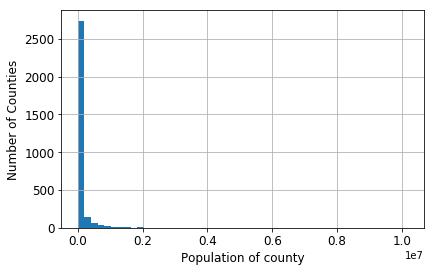

In [37]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['popEst2015'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Population of county", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

(0, 750)

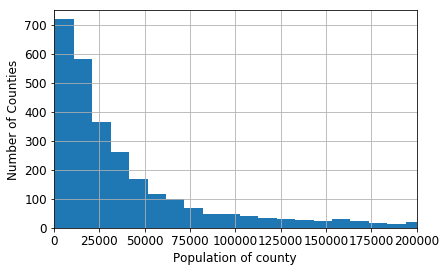

In [38]:
cancer['popEst2015'].hist(bins=1000, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Population of county", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.xlim([0, 200000])
plt.ylim([0, 750])

The 2015 county population estimate feature has a weak negative correlation with cancer mortality of -0.12, showing that as county population increases cancer mortality slightly decreases.

In [39]:
r_popEst2015 = pearson_r(cancer['popEst2015'], cancer['TARGET_deathRate'])
r_popEst2015

-0.12007309573645843

In [40]:
cov_matrix_popEst2015 = np.cov(cancer['popEst2015'], cancer['TARGET_deathRate'])
cov_matrix_popEst2015

array([[ 1.08279971e+11, -1.09649438e+06],
       [-1.09649438e+06,  7.70146380e+02]])

Adding a logarithmic or exponential transformation of 'popEst2015' did not increase the model's overall accuracy.

## 'povertyPercent': Percent of populace in poverty

The percent of the populace in U.S. counties who live at or under the poverty line ranges from 3.2% to 47.4%, and has an average value of 16.9% with a standard deviation of 6.4%. The five counties with the lowest poverty are in Virginia, Colorado, and New Mexico. The five counties with the highest poverty are in Mississippi, Kentucky, Alabama, and South Dakota.

In [41]:
cancer.describe().povertyPercent

count    3047.000000
mean       16.878175
std         6.409087
min         3.200000
25%        12.150000
50%        15.900000
75%        20.400000
max        47.400000
Name: povertyPercent, dtype: float64

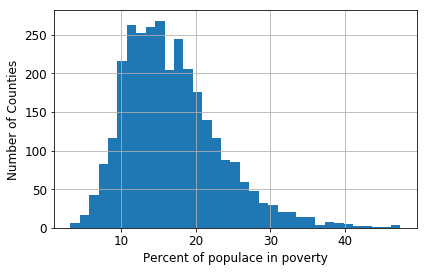

In [42]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['povertyPercent'].hist(bins=35, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of populace in poverty", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('povertyPercent_dist.png')

In [43]:
poverty = cancer.sort_values(by = 'povertyPercent').povertyPercent
poverty.head()

Geography
Falls Church city, Virginia      3.2
Douglas County, Colorado         3.7
Loudoun County, Virginia         3.9
Broomfield County, Colorado      4.0
Los Alamos County, New Mexico    4.2
Name: povertyPercent, dtype: float64

In [44]:
poverty.tail()

Geography
Holmes County, Mississippi    44.0
Owsley County, Kentucky       45.1
Perry County, Alabama         46.9
McCreary County, Kentucky     47.0
Todd County, South Dakota     47.4
Name: povertyPercent, dtype: float64

There is a moderately strong correlation of 0.429 between poverty and cancer mortality. This shows that people diagnosed with cancer who have less financial means stand a greater chance of dying from cancer.

In [45]:
r_povertyPercent = pearson_r(cancer['povertyPercent'], cancer['TARGET_deathRate'])
r_povertyPercent

0.42938898025645067

In [46]:
cov_matrix_povertyPercent = np.cov(cancer['povertyPercent'], cancer['TARGET_deathRate'])
cov_matrix_povertyPercent

array([[ 41.07639483,  76.37191733],
       [ 76.37191733, 770.14638047]])

One can clearly see the moderate correlation between poverty and cancer mortality in the prediction line of the first of the subplots below. One can also see that adding the logarithmic and exponential transformations of 'povertyPercent' predicts several of the data points more accurately, and adding them increased the linear regression model's accuracy by 0.0008.

In [49]:
cancer.shape

(3047, 329)

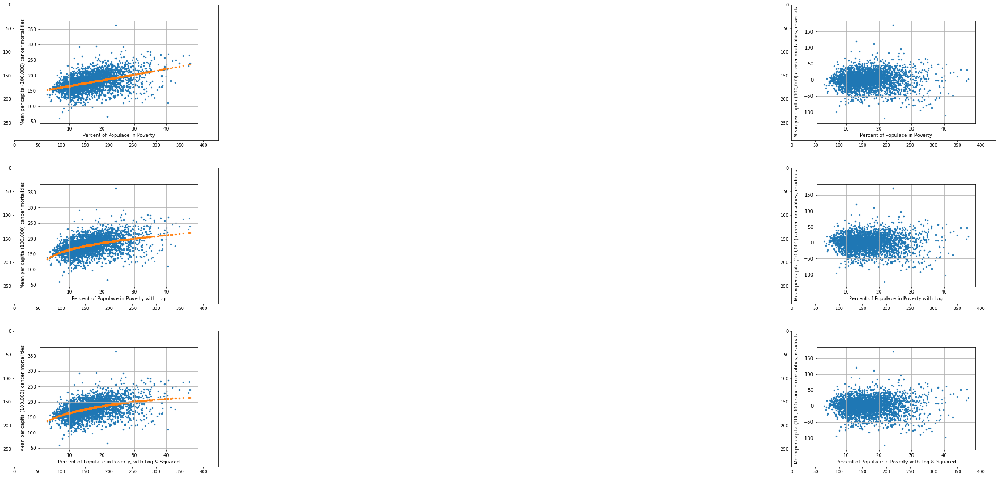

In [50]:
plt.rcParams["figure.figsize"] = (60, 20)
plt.subplot(3, 2, 1)
im_5_ap = plt.imread("povertyPercent_actual_&_predicted_Y.png")
implot_5_ap = plt.imshow(im_5_ap)
plt.subplot(3, 2, 2)
im_5_r = plt.imread("povertyPercent_residuals.png")
implot_5_r = plt.imshow(im_5_r)
plt.subplot(3, 2, 3)
im_5_l = plt.imread("povertyPercent_log_actual_&_predicted_Y.png")
implot_5_l = plt.imshow(im_5_l)
plt.subplot(3, 2, 4)
im_5_lres = plt.imread("povertyPercent_log_residuals.png")
implot_5_lres = plt.imshow(im_5_lres)
plt.subplot(3, 2, 5)
im_5_lsq = plt.imread("povertyPercent_log_sqrd_actual_&_predicted_Y.png")
implot_5_lsq = plt.imshow(im_5_lsq)
plt.subplot(3, 2, 6)
im_5_lsqres = plt.imread("povertyPercent_log_sqrd_residuals.png")
implot_5_lsqres = plt.imshow(im_5_lsqres)

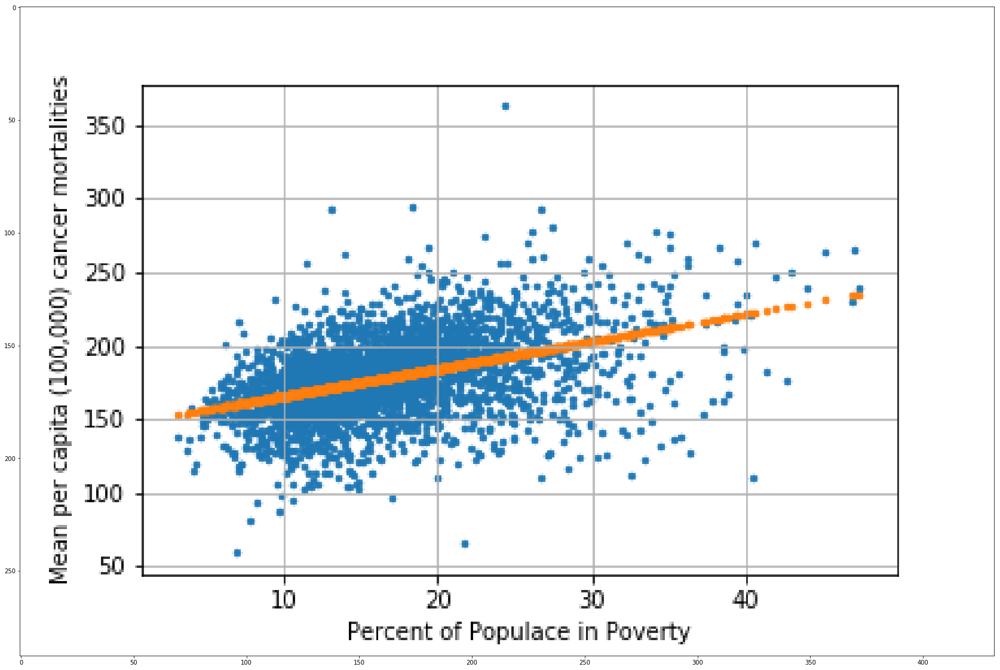

In [51]:
im_5_ap = plt.imread("povertyPercent_actual_&_predicted_Y.png")
implot_5_ap = plt.imshow(im_5_ap)

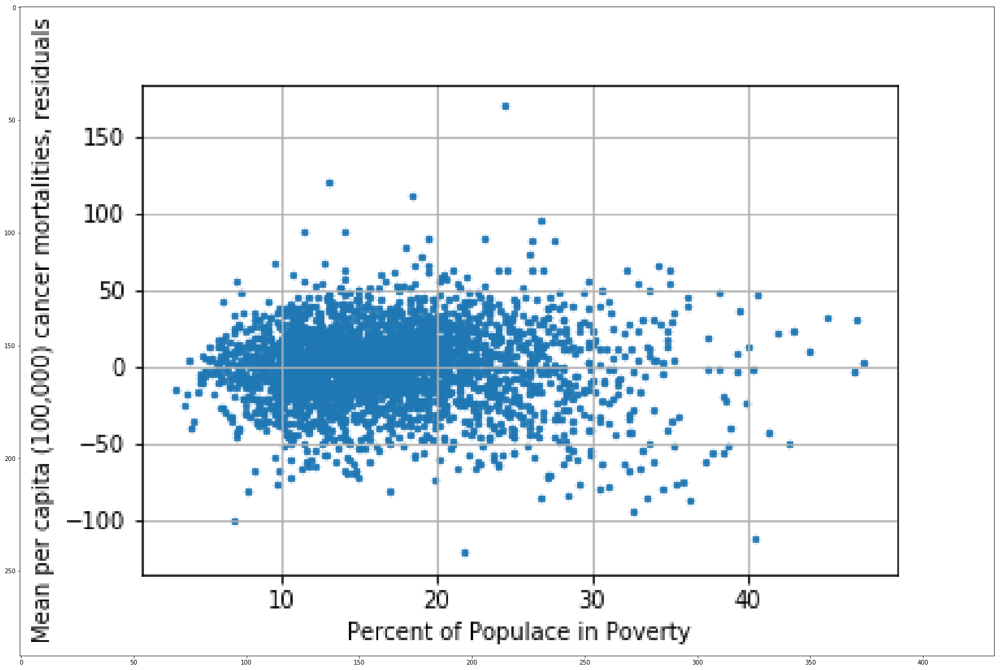

In [52]:
im_5_r = plt.imread("povertyPercent_residuals.png")
implot_5_r = plt.imshow(im_5_r)

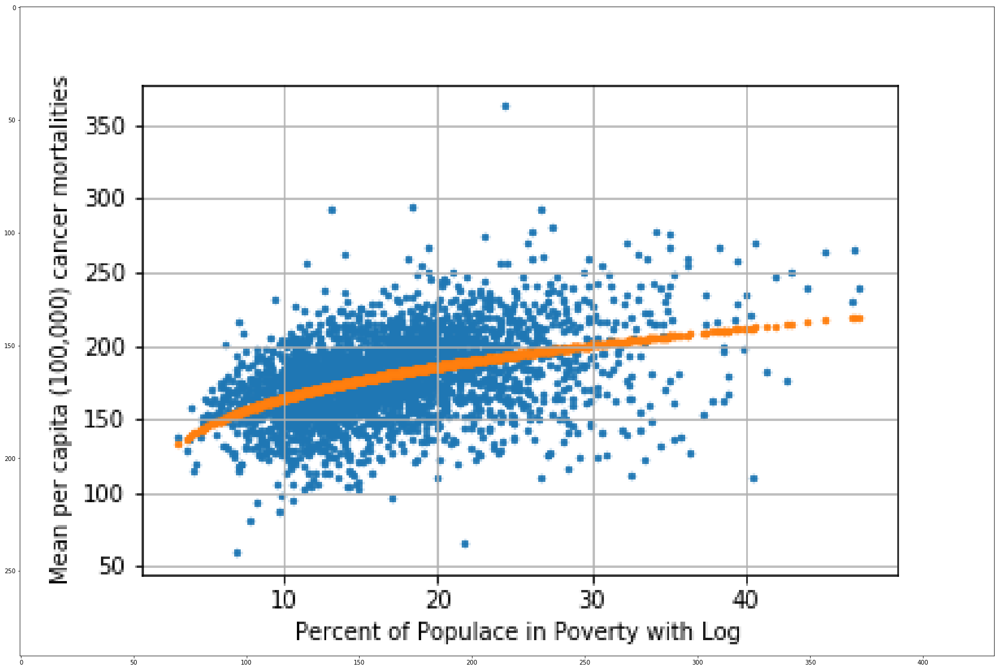

In [53]:
im_5_l = plt.imread("povertyPercent_log_actual_&_predicted_Y.png")
implot_5_l = plt.imshow(im_5_l)

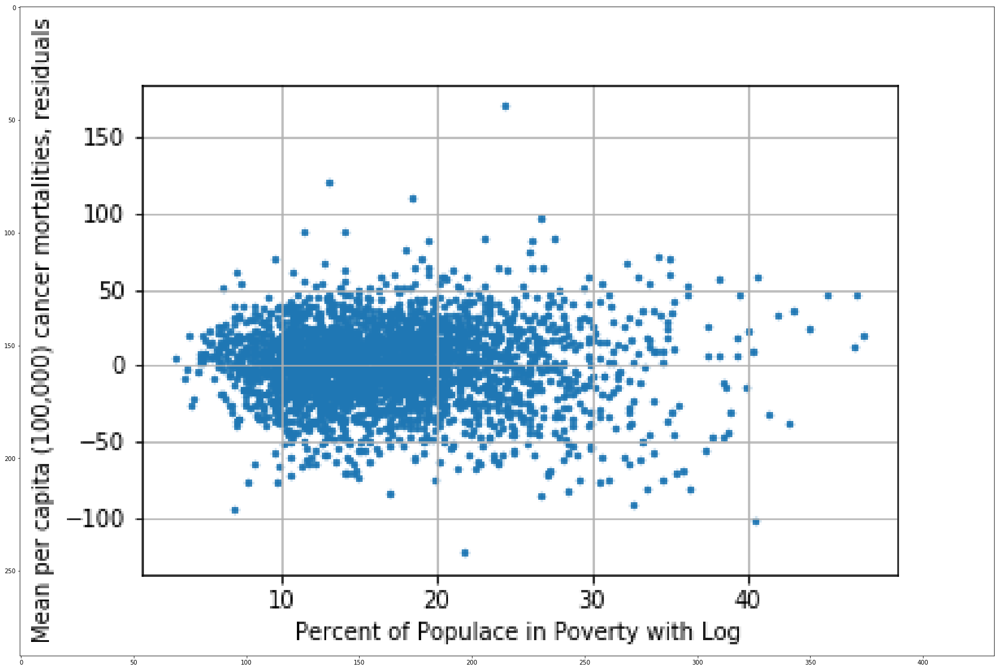

In [54]:
im_5_lres = plt.imread("povertyPercent_log_residuals.png")
implot_5_lres = plt.imshow(im_5_lres)

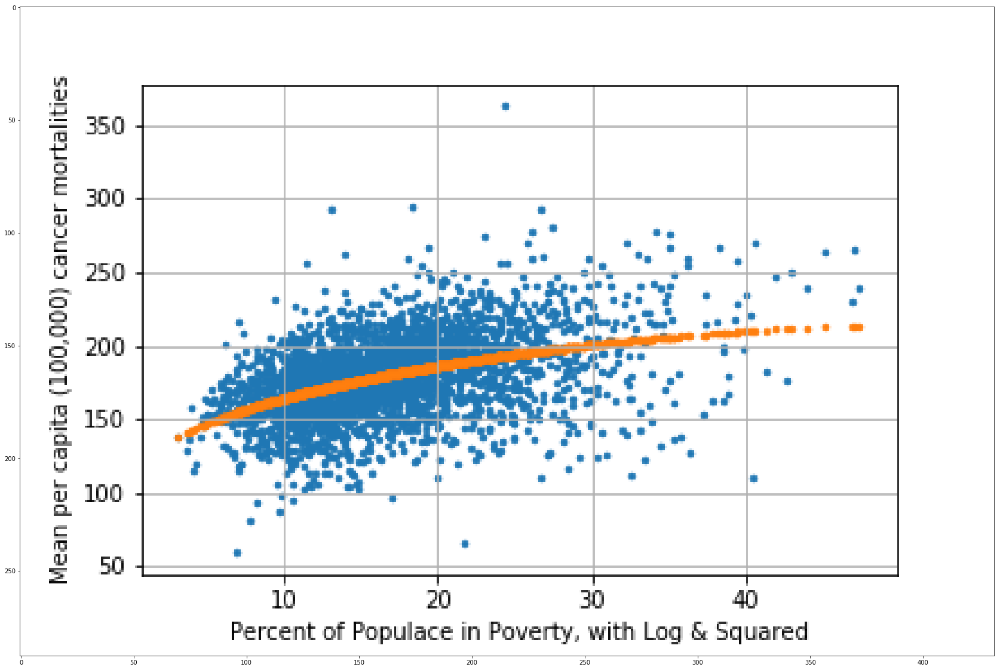

In [55]:
im_5_lsq = plt.imread("povertyPercent_log_sqrd_actual_&_predicted_Y.png")
implot_5_lsq = plt.imshow(im_5_lsq)

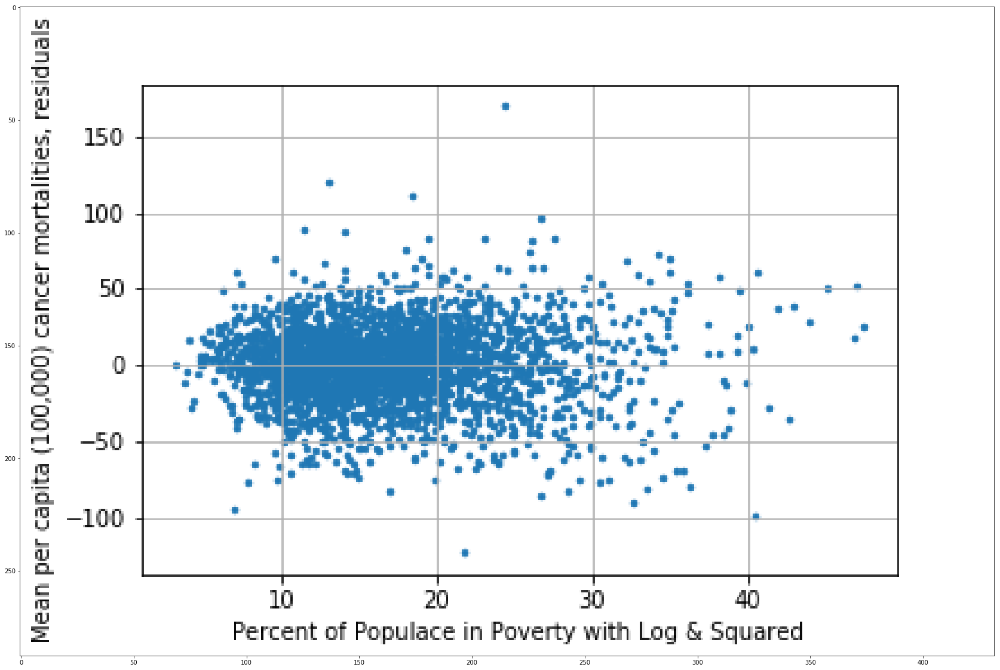

In [56]:
im_5_lsqres = plt.imread("povertyPercent_log_sqrd_residuals.png")
implot_5_lsqres = plt.imshow(im_5_lsqres)

## 'studyPerCap': Per capita number of cancer-related clinical trials per county

Cancer-related clinical trials are research studies where doctors find new ways to discover new cancer treatments, improve existing cancer treatments, and increase quality of life factors for people with cancer. The per capita (100,000) number of these trials varies by county, and helps represent the varying treatment options and other healthcare support for cancer patients. 

The 'studyPerCap' variable gives the per capita (100,000 people) cancer-related clinical trials that occur in each county in the year 2015. The 'studyPerCap' feature's values range from zero to 9,762, and has an average value of 155.4 with a standard deviation of 529.6. The majority of counties have no such clinical trials, probably because most counties don't have cancer research facilities. 

In [57]:
cancer.describe().studyPerCap

count    3047.000000
mean      155.399415
std       529.628366
min         0.000000
25%         0.000000
50%         0.000000
75%        83.650776
max      9762.308998
Name: studyPerCap, dtype: float64

Text(0, 0.5, 'Number of Counties')

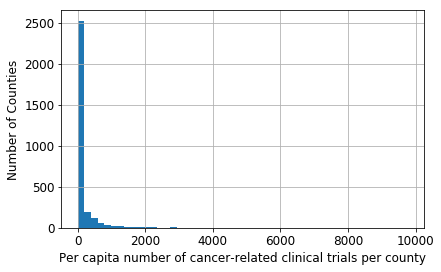

In [58]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['studyPerCap'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Per capita number of cancer-related clinical trials per county", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

The counties with the highest number of clinical cancer trials are called below. 1,931 out of 3,047 counties (63%) had no clinical cancer trials.

In [59]:
study_per_cap = cancer.sort_values(by = 'studyPerCap').studyPerCap
study_per_cap.tail(10)

Geography
Craig County, Virginia        4221.838419
Hancock County, Illinois      4260.367794
Bourbon County, Kansas        4282.218597
Forest County, Wisconsin      4306.061610
Hitchcock County, Nebraska    4856.052723
Clay County, West Virginia    4938.271605
Pratt County, Kansas          6810.442679
Kingman County, Kansas        8585.924288
Custer County, Nebraska       9439.200444
Hamilton County, New York     9762.308998
Name: studyPerCap, dtype: float64

In [60]:
cancer['studyPerCap'].value_counts().head(1)

0.0    1931
Name: studyPerCap, dtype: int64

The number of clinical cancer trials in a county has almost no correlation with the per capita number of cancer mortalities (Pearson's R of -0.02). Both features are per capita (100,000) so there truly seems to be no correlation.

In [61]:
r_studyPerCap = pearson_r(cancer['studyPerCap'], cancer['TARGET_deathRate'])
r_studyPerCap

-0.02228501077237754

In [62]:
cov_matrix_studyPerCap = np.cov(cancer['studyPerCap'], cancer['TARGET_deathRate'])
cov_matrix_studyPerCap

array([[280506.20612391,   -327.54481189],
       [  -327.54481189,    770.14638047]])

## 'MedianAge': Median age of county residents

The median age ranges from 22 to 65, and has an average value of 41 with a standard deviation of 5.2. The five counties with the lowest median age are in Virginia, Idaho, Georgia and South Dakota and the five counties with the highest median age are in Michigan, New Mexico, Florida and Virginia.

In [63]:
cancer.describe().MedianAge

count    3047.000000
mean       40.825599
std         5.171307
min        22.300000
25%        37.700000
50%        41.000000
75%        43.800000
max        65.300000
Name: MedianAge, dtype: float64

Text(0, 0.5, 'Number of Counties')

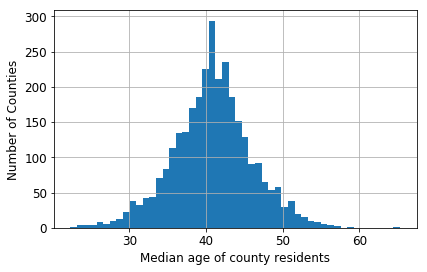

In [64]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['MedianAge'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Median age of county residents", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [65]:
median_age = cancer.sort_values(by = 'MedianAge').MedianAge
median_age.head()

Geography
Radford city, Virginia           22.3
Madison County, Idaho            23.2
Chattahoochee County, Georgia    23.3
Harrisonburg city, Virginia      23.5
Todd County, South Dakota        23.9
Name: MedianAge, dtype: float64

In [66]:
median_age.tail()

Geography
Alcona County, Michigan      56.6
Catron County, New Mexico    57.1
Charlotte County, Florida    57.3
Highland County, Virginia    59.0
Sumter County, Florida       65.3
Name: MedianAge, dtype: float64

Median Age has nearly zero correlation with cancer mortality, which is a bit of surprise as generally the risk for cancer seems to increase with age.

In [67]:
r_MedianAge = pearson_r(cancer['MedianAge'], cancer['TARGET_deathRate'])
r_MedianAge

-0.004245350764716504

In [68]:
cov_matrix_MedianAge = np.cov(cancer['MedianAge'], cancer['TARGET_deathRate'])
cov_matrix_MedianAge

array([[ 2.67424174e+01, -6.09257031e-01],
       [-6.09257031e-01,  7.70146380e+02]])

One can see the flat line of correlation between median age and cancer mortality in the prediction line. Adding the logarithmic transformation of median age captures a nonlinear relationship between the two variables and added 0.002 to the overall model's accuracy score. 

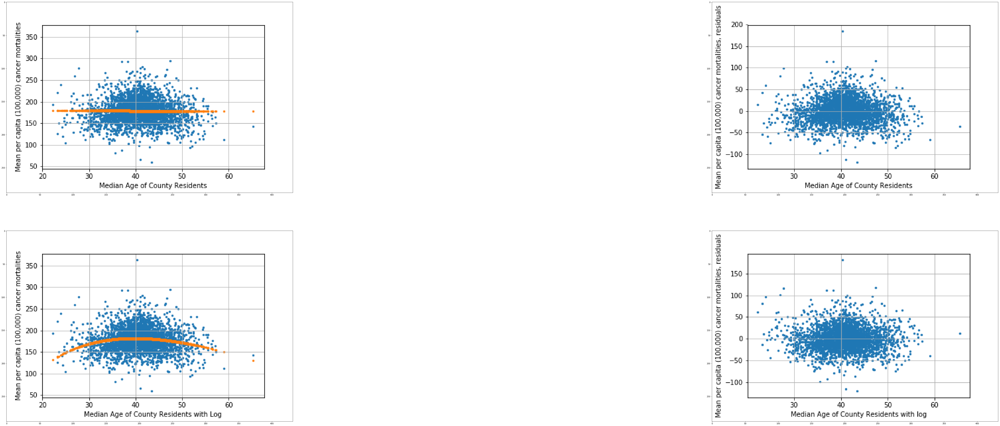

In [69]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_7_ap = plt.imread("MedianAge_actual_&_predicted_Y.png")
implot_7_ap = plt.imshow(im_7_ap)
plt.subplot(2, 2, 2)
im_7_r = plt.imread("MedianAge_residuals.png")
implot_7_r = plt.imshow(im_7_r)
plt.subplot(2, 2, 3)
im_7_l = plt.imread("MedianAge_log_actual_&_predicted_Y.png")
implot_7_l = plt.imshow(im_7_l)
plt.subplot(2, 2, 4)
im_7_lres = plt.imread("MedianAge_log_residuals.png")
implot_7_lres = plt.imshow(im_7_lres)

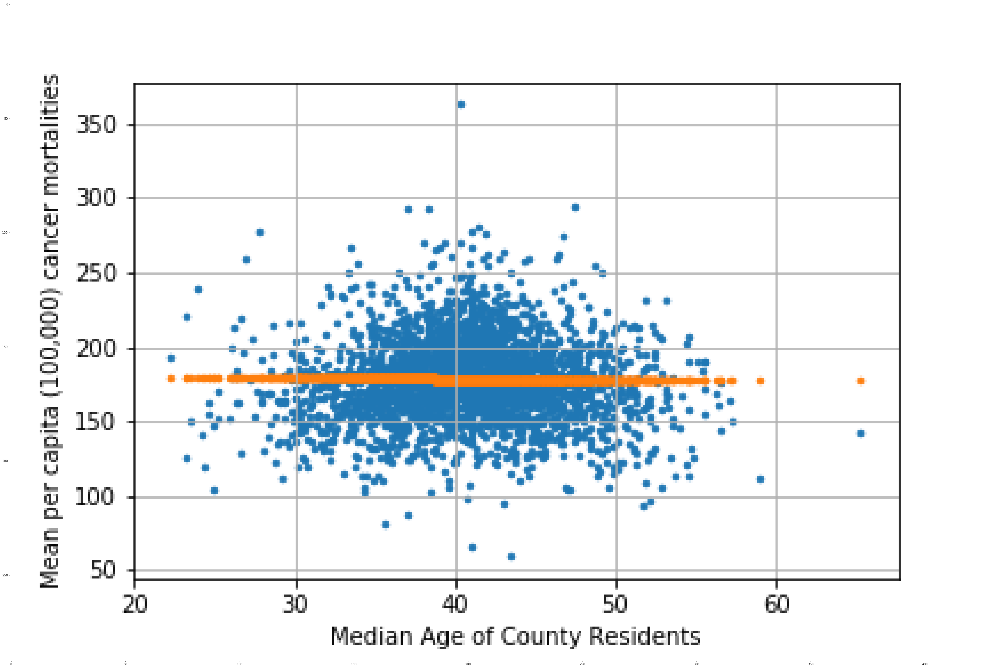

In [70]:
im_7_ap = plt.imread("MedianAge_actual_&_predicted_Y.png")
implot_7_ap = plt.imshow(im_7_ap)

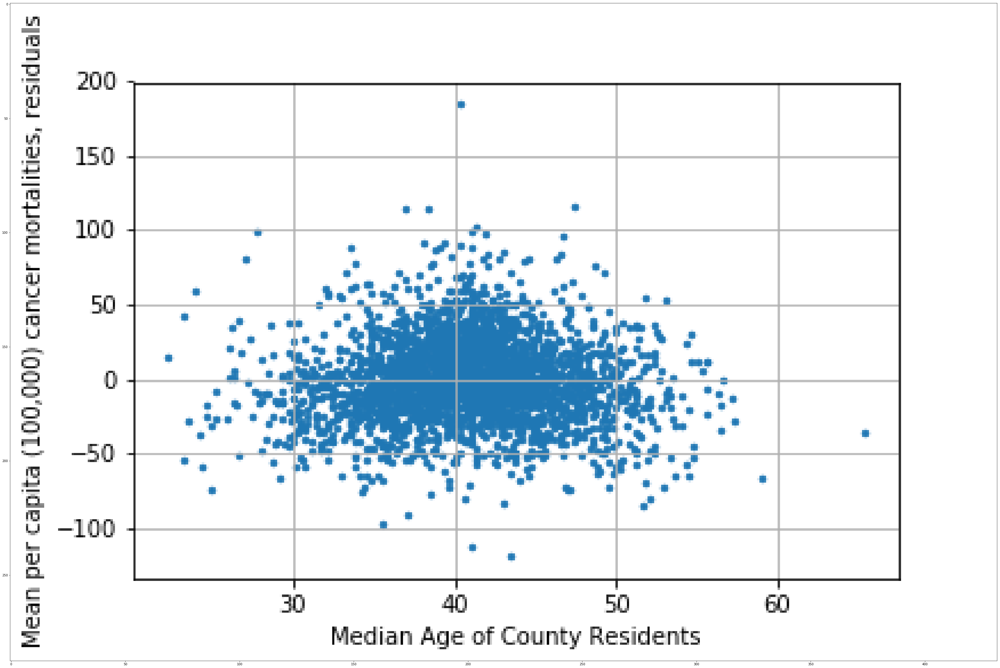

In [71]:
im_7_r = plt.imread("MedianAge_residuals.png")
implot_7_r = plt.imshow(im_7_r)

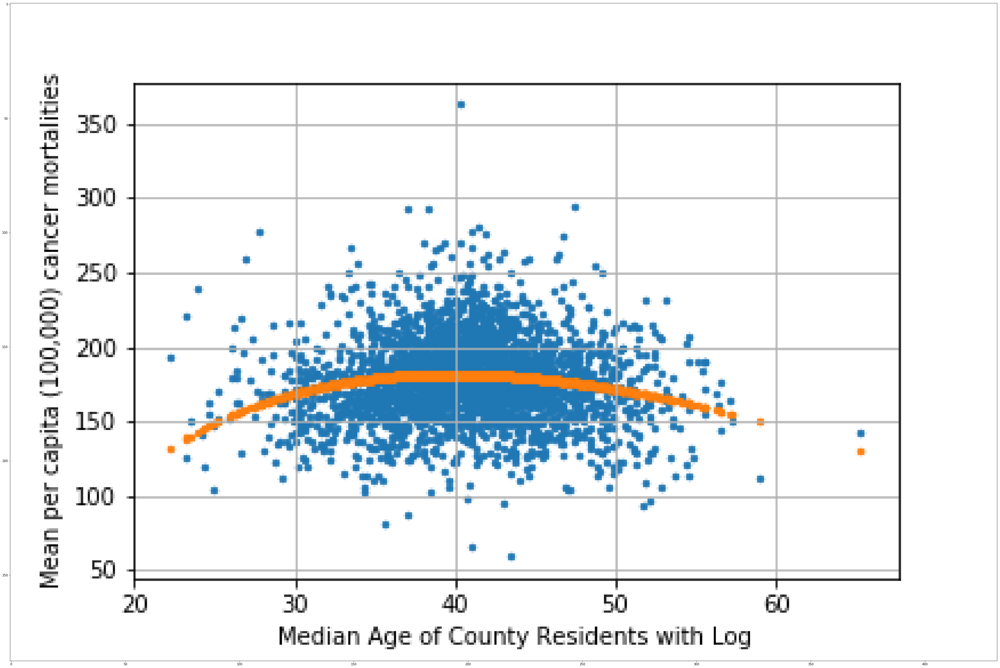

In [72]:
im_7_l = plt.imread("MedianAge_log_actual_&_predicted_Y.png")
implot_7_l = plt.imshow(im_7_l)

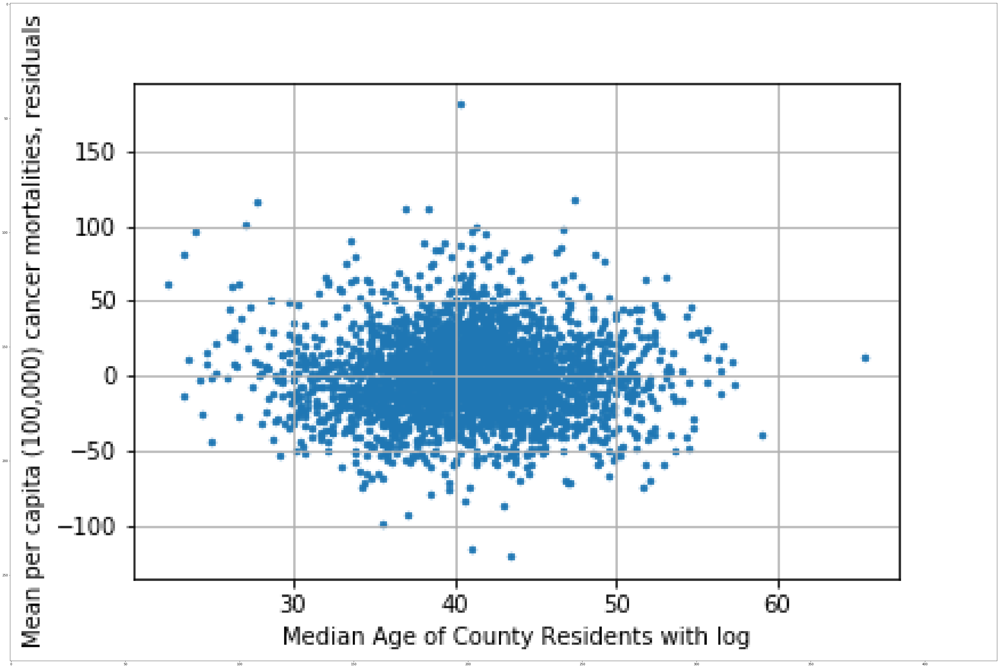

In [73]:
im_7_lres = plt.imread("MedianAge_log_residuals.png")
implot_7_lres = plt.imshow(im_7_lres)

## 'MedianAgeMale': Median age of male county residents

The male median age ranges from 22 to 65, and has an average value of 40 with a standard deviation of 5.2. The five counties with the lowest male median age are in Virginia, South Dakota, Georgia, Texas, and Idaho and the five counties with the highest median male age are in Michigan, Colorado, Oregon, Virginia and Florida.

In [74]:
cancer.describe().MedianAgeMale

count    3047.000000
mean       39.570725
std         5.226017
min        22.400000
25%        36.350000
50%        39.600000
75%        42.500000
max        64.700000
Name: MedianAgeMale, dtype: float64

Text(0, 0.5, 'Number of Counties')

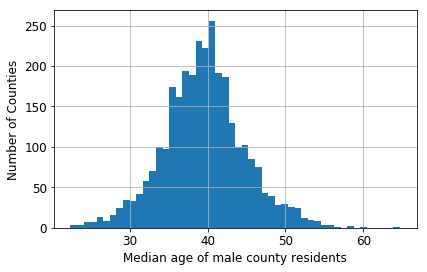

In [75]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['MedianAgeMale'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Median age of male county residents", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [76]:
median_age_male = cancer.sort_values(by = 'MedianAgeMale').MedianAgeMale
median_age_male.head()

Geography
Radford city, Virginia           22.4
Todd County, South Dakota        22.8
Chattahoochee County, Georgia    23.0
Oldham County, Texas             23.7
Madison County, Idaho            23.8
Name: MedianAgeMale, dtype: float64

In [77]:
median_age_male.tail()

Geography
Alcona County, Michigan      56.5
Custer County, Colorado      58.5
Wheeler County, Oregon       58.6
Highland County, Virginia    60.2
Sumter County, Florida       64.7
Name: MedianAgeMale, dtype: float64

There is nearly no correlation between male median age and cancer mortality. Also, adding a logarithmic or exponential transformation of male median age did not add to the model's overall accuracy.

In [78]:
r_MedianAgeMale = pearson_r(cancer['MedianAgeMale'], cancer['TARGET_deathRate'])
r_MedianAgeMale

-0.021929429076614944

In [79]:
cov_matrix_MedianAgeMale = np.cov(cancer['MedianAgeMale'], cancer['TARGET_deathRate'])
cov_matrix_MedianAgeMale

array([[ 27.31125039,  -3.18042205],
       [ -3.18042205, 770.14638047]])

## 'MedianAgeFemale': Median age of female county residents

The female median age ranges from 22 to 66, and has an average value of 42 with a standard deviation of 5.3. The five counties with the lowest female median age are in Virginia, Idaho, Virginia, and Washington and the five counties with the highest median female age are in Florida, Virginia, New Mexico and Pennsylvania.

In [80]:
cancer.describe().MedianAgeFemale

count    3047.000000
mean       42.145323
std         5.292849
min        22.300000
25%        39.100000
50%        42.400000
75%        45.300000
max        65.700000
Name: MedianAgeFemale, dtype: float64

Text(0, 0.5, 'Number of Counties')

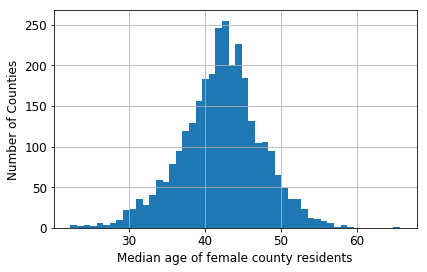

In [81]:
cancer['MedianAgeFemale'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Median age of female county residents", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [82]:
median_age_female = cancer.sort_values(by = 'MedianAgeFemale').MedianAgeFemale
median_age_female.head()

Geography
Radford city, Virginia         22.3
Madison County, Idaho          22.3
Harrisonburg city, Virginia    22.8
Williamsburg city, Virginia    23.6
Whitman County, Washington     23.9
Name: MedianAgeFemale, dtype: float64

In [83]:
median_age_female.tail()

Geography
Charlotte County, Florida      58.0
Highland County, Virginia      58.2
Catron County, New Mexico      58.7
Forest County, Pennsylvania    59.6
Sumter County, Florida         65.7
Name: MedianAgeFemale, dtype: float64

There is nearly no correlation between female median age and cancer mortality.

In [84]:
r_MedianAgeFemale = pearson_r(cancer['MedianAgeFemale'], cancer['TARGET_deathRate'])
r_MedianAgeFemale

0.012048385965001445

In [85]:
cov_matrix_MedianAgeFemale = np.cov(cancer['MedianAgeFemale'], cancer['TARGET_deathRate'])
cov_matrix_MedianAgeFemale

array([[ 28.01425176,   1.7697219 ],
       [  1.7697219 , 770.14638047]])

One can see the nearly flat correlation line between female median age and cancer mortality in the prediction line below. Adding the squared transformation of female median age reduces the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.00005.

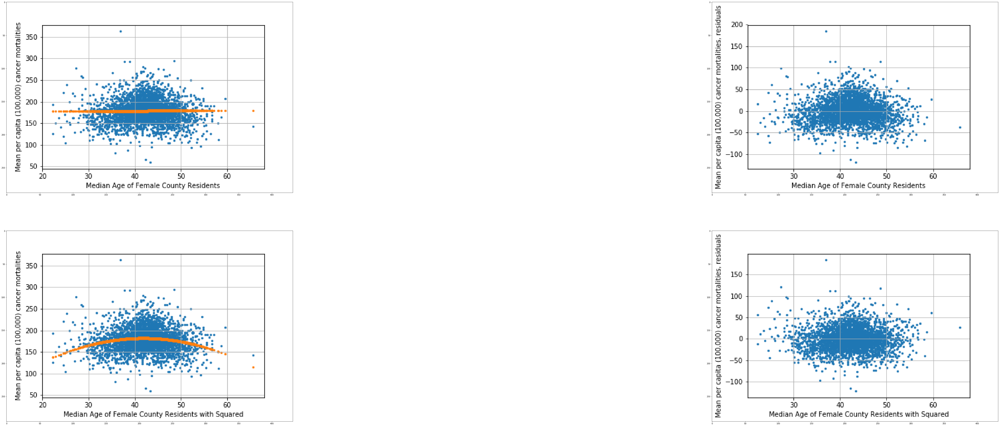

In [86]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_9_ap = plt.imread("MedianAgeFemale_actual_&_predicted_Y.png")
implot_9_ap = plt.imshow(im_9_ap)
plt.subplot(2, 2, 2)
im_9_r = plt.imread("MedianAgeFemale_residuals.png")
implot_9_r = plt.imshow(im_9_r)
plt.subplot(2, 2, 3)
im_9_sq = plt.imread("MedianAgeFemale_sqrd_actual_&_predicted_Y.png")
implot_9_sq = plt.imshow(im_9_sq)
plt.subplot(2, 2, 4)
im_9_sqres = plt.imread("MedianAgeFemale_squared_residuals.png")
implot_9_sqres = plt.imshow(im_9_sqres)

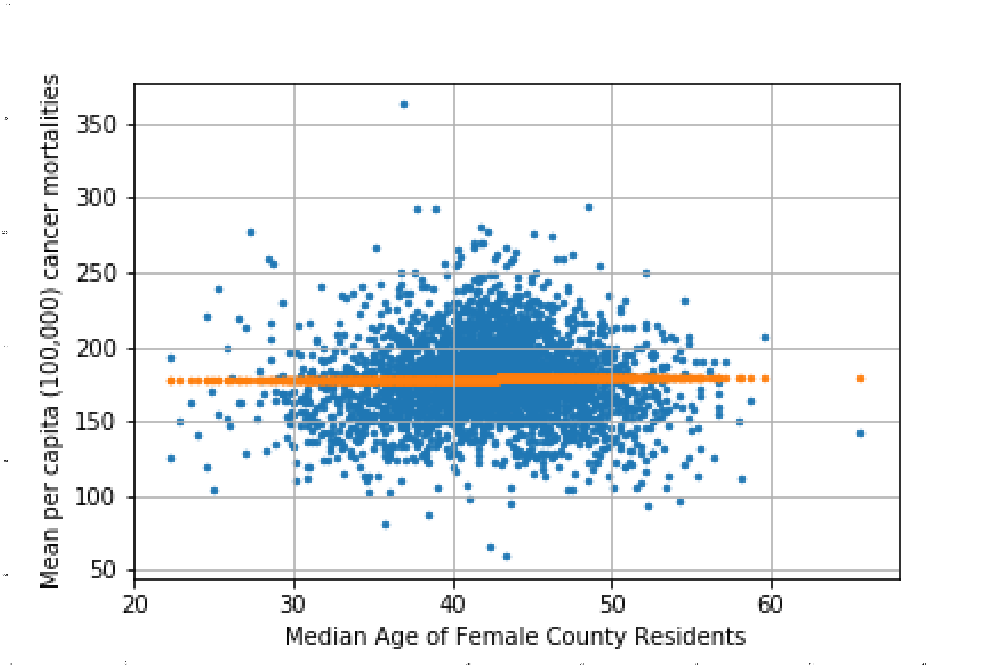

In [87]:
im_9_ap = plt.imread("MedianAgeFemale_actual_&_predicted_Y.png")
implot_9_ap = plt.imshow(im_9_ap)

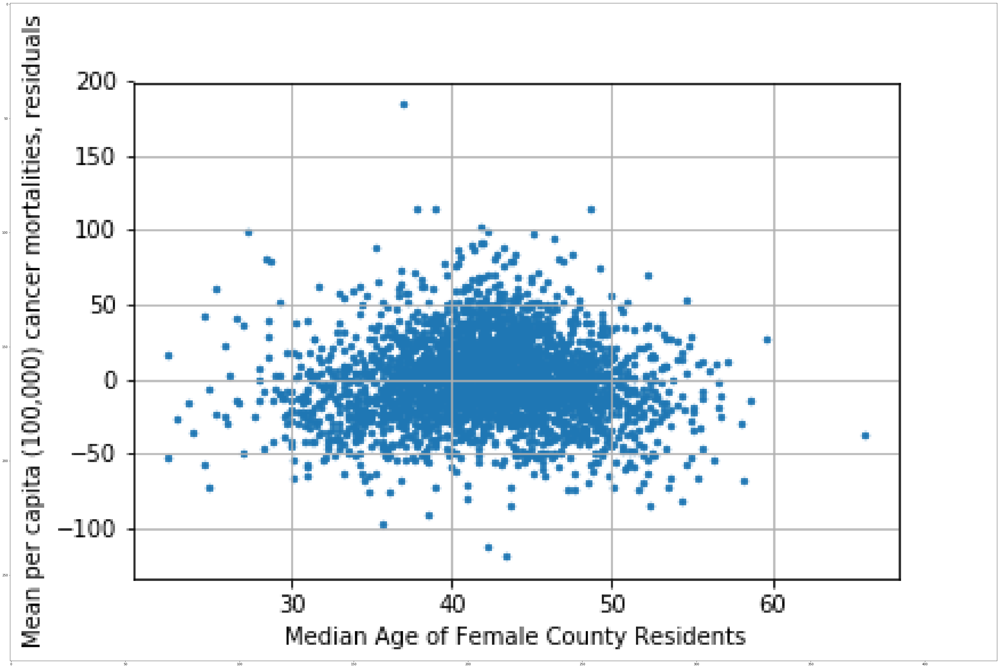

In [88]:
im_9_r = plt.imread("MedianAgeFemale_residuals.png")
implot_9_r = plt.imshow(im_9_r)

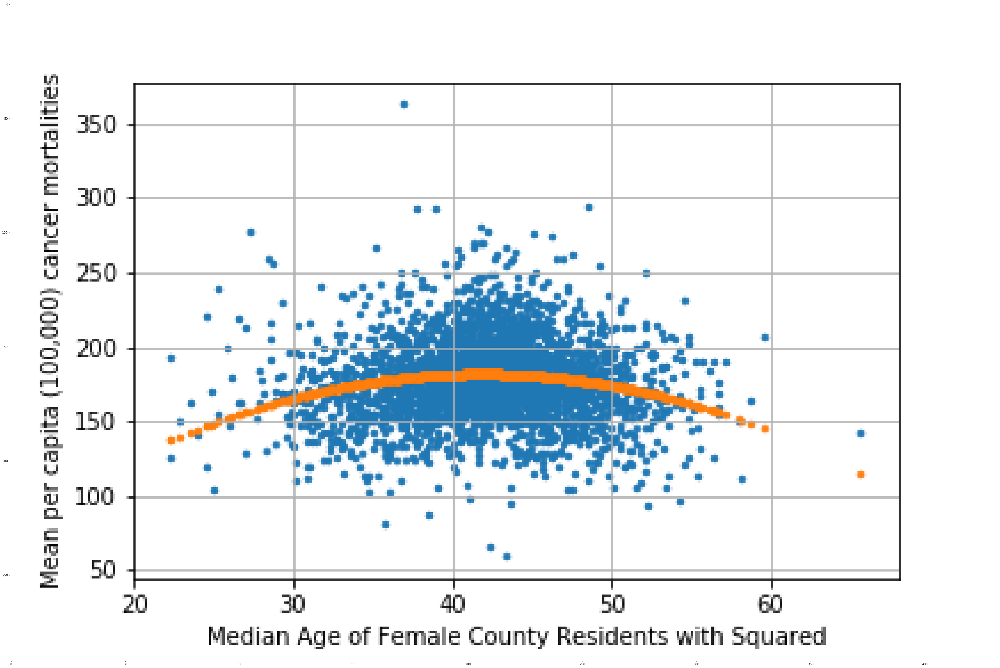

In [89]:
im_9_sq = plt.imread("MedianAgeFemale_sqrd_actual_&_predicted_Y.png")
implot_9_sq = plt.imshow(im_9_sq)

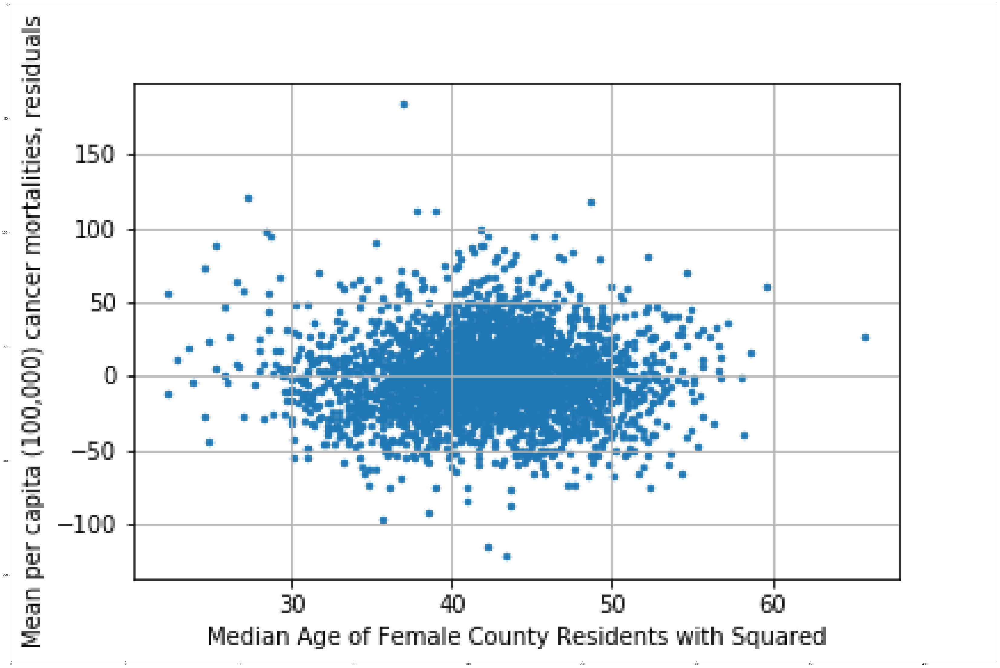

In [90]:
im_9_sqres = plt.imread("MedianAgeFemale_squared_residuals.png")
implot_9_sqres = plt.imshow(im_9_sqres)

## 'AvgHouseholdSize': Average Household Size (occupied buildings)

The average household size ranges from 1.86 to 3.97, and has an average value of 2.5 with a standard deviation of 0.25. The five counties with the smallest average household size are in Pennsylvania, South Dakota, Kansas, Minnesota and Nebraska, and the five counties with the largest average household size are in Texas, Alaska, North Dakota, and New Mexico.

In [91]:
cancer.describe().AvgHouseholdSize

count    3047.000000
mean        2.529206
std         0.247187
min         1.860000
25%         2.380000
50%         2.500000
75%         2.630000
max         3.970000
Name: AvgHouseholdSize, dtype: float64

Text(0, 0.5, 'Number of Counties')

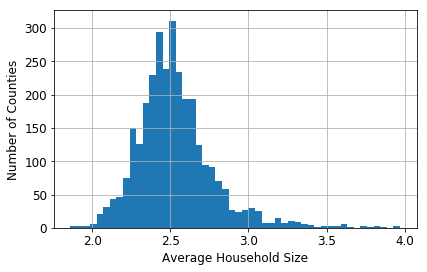

In [92]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['AvgHouseholdSize'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Average Household Size", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [93]:
avg_household_size = cancer.sort_values(by = 'AvgHouseholdSize').AvgHouseholdSize
avg_household_size.head()

Geography
Forest County, Pennsylvania       1.86
McPherson County, South Dakota    1.89
Decatur County, Kansas            1.91
Cook County, Minnesota            1.93
Rock County, Nebraska             1.94
Name: AvgHouseholdSize, dtype: float64

In [94]:
avg_household_size.tail()

Geography
Starr County, Texas                 3.84
Bethel Census Area, Alaska          3.86
Sioux County, North Dakota          3.93
Northwest Arctic Borough, Alaska    3.97
McKinley County, New Mexico         3.97
Name: AvgHouseholdSize, dtype: float64

There is nearly no correlation between average household size and cancer mortality (-0.04).

In [95]:
r_AvgHouseholdSize = pearson_r(cancer['AvgHouseholdSize'], cancer['TARGET_deathRate'])
r_AvgHouseholdSize

-0.034588855932577135

In [96]:
cov_matrix_AvgHouseholdSize = np.cov(cancer['AvgHouseholdSize'], cancer['TARGET_deathRate'])
cov_matrix_AvgHouseholdSize

array([[ 6.11012731e-02, -2.37272806e-01],
       [-2.37272806e-01,  7.70146380e+02]])

One can see the nearly flat correlation between the average household size and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic transformations of 'AvgHouseholdSize' is added, and doing so increased the model's accuracy by 0.0007.

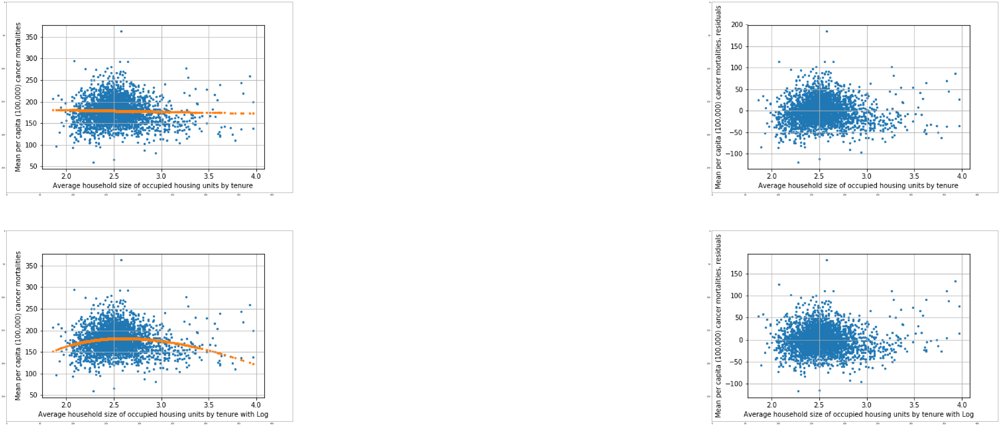

In [97]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_10_ap = plt.imread("AvgHouseholdSize_actual_&_predicted_Y.png")
implot_10_ap = plt.imshow(im_10_ap)
plt.subplot(2, 2, 2)
im_10_r = plt.imread("AvgHouseholdSize_residuals.png")
implot_10_r = plt.imshow(im_10_r)
plt.subplot(2, 2, 3)
im_10_l = plt.imread("AvgHouseholdSize_log_actual_&_predicted_Y.png")
implot_10_l = plt.imshow(im_10_l)
plt.subplot(2, 2, 4)
im_10_lres = plt.imread("AvgHouseholdSize_log_residuals.png")
implot_10_lres = plt.imshow(im_10_lres)

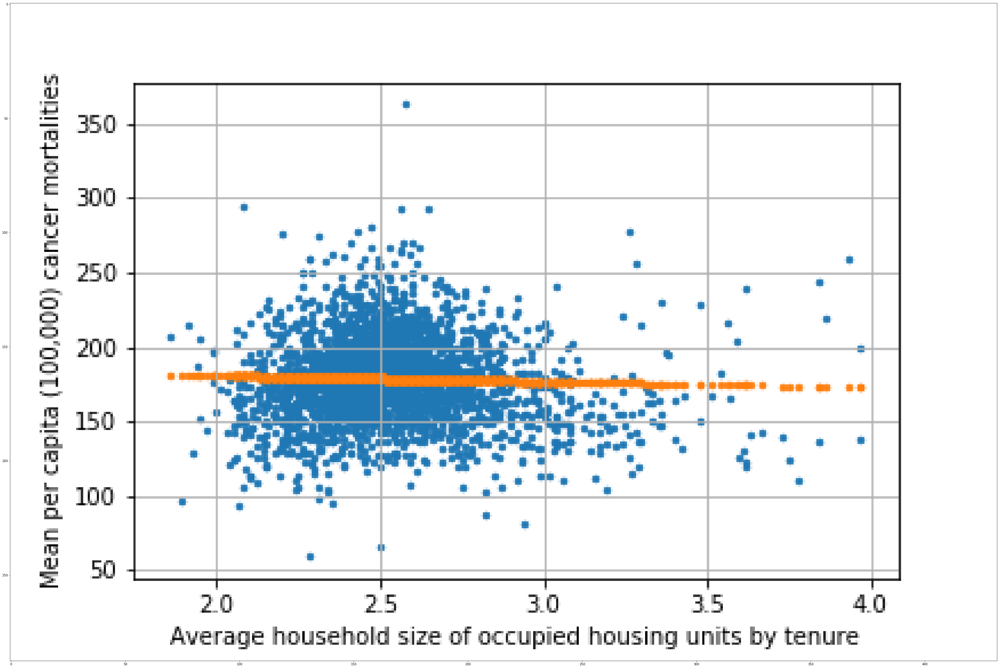

In [98]:
im_10_ap = plt.imread("AvgHouseholdSize_actual_&_predicted_Y.png")
implot_10_ap = plt.imshow(im_10_ap)

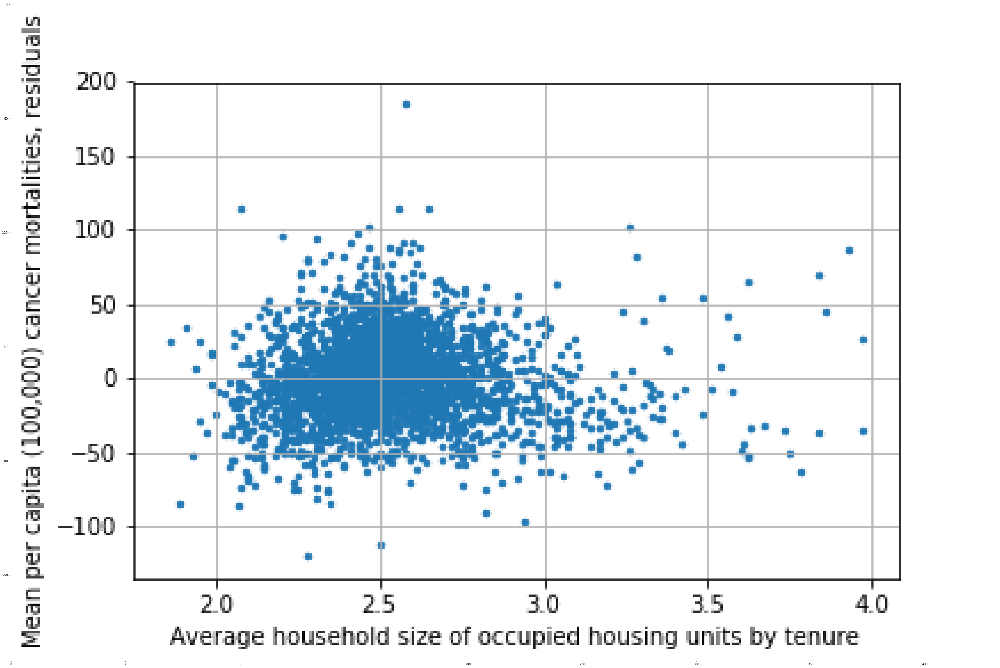

In [99]:
im_10_r = plt.imread("AvgHouseholdSize_residuals.png")
implot_10_r = plt.imshow(im_10_r)

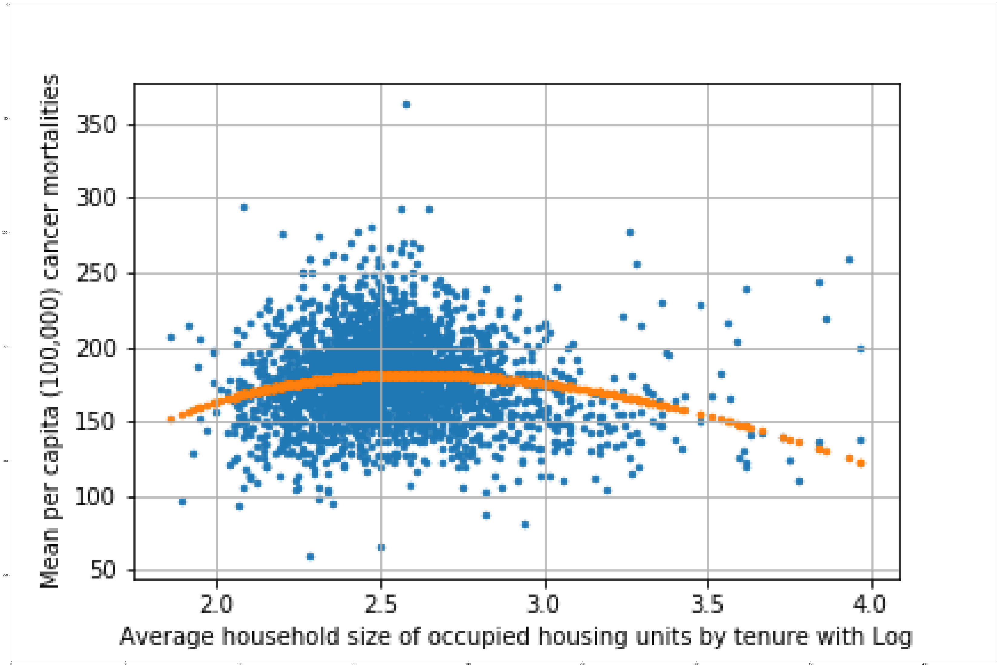

In [100]:
im_10_l = plt.imread("AvgHouseholdSize_log_actual_&_predicted_Y.png")
implot_10_l = plt.imshow(im_10_l)

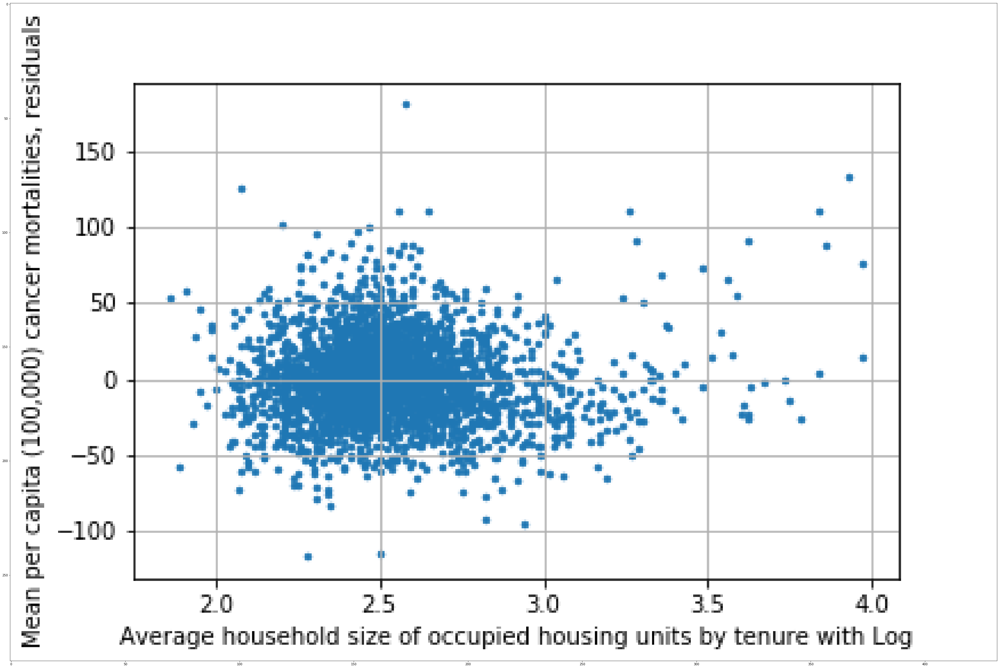

In [101]:
im_10_lres = plt.imread("AvgHouseholdSize_log_residuals.png")
implot_10_lres = plt.imshow(im_10_lres)

## 'PercentMarried': Percent of county residents who are married 

The percentage of county residents who were married ranges from 23% to 73%, and has an average value of 52% with a standard deviation of 6.9%. The counties with the lowest percentage of county residents who are married are in Georgia, Mississippi, and Virginia. The counties with the highest percentage of county residents who are married are in Nebraska, Kansas, Utah, and North Dakota.

In [102]:
cancer.describe().PercentMarried

count    3047.000000
mean       51.773679
std         6.896928
min        23.100000
25%        47.750000
50%        52.400000
75%        56.400000
max        72.500000
Name: PercentMarried, dtype: float64

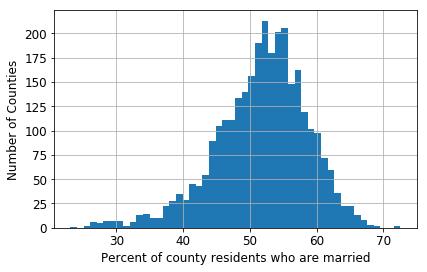

In [104]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PercentMarried'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents who are married", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PercentMarried_dist.png')

In [105]:
percent_married = cancer.sort_values(by='PercentMarried').PercentMarried
percent_married.head()

Geography
Stewart County, Georgia          23.1
Holmes County, Mississippi       25.1
Radford city, Virginia           25.3
Richmond city, Virginia          26.2
Claiborne County, Mississippi    26.2
Name: PercentMarried, dtype: float64

In [106]:
percent_married.tail()

Geography
Cherry County, Nebraska        68.0
Gove County, Kansas            69.1
Morgan County, Utah            69.2
Kidder County, North Dakota    72.3
Oliver County, North Dakota    72.5
Name: PercentMarried, dtype: float64

There is a somewhat weak negative correlation of -0.27 between the percentage of county residents who are married and cancer mortality rate. This suggests a weak relationship between being married and being less likely to die from cancer, but of course no causative relationship can be posited here.

In [107]:
r_PercentMarried = pearson_r(cancer['PercentMarried'], cancer['TARGET_deathRate'])
r_PercentMarried

-0.2668204635535114

In [108]:
cov_matrix_PercentMarried = np.cov(cancer['PercentMarried'], cancer['TARGET_deathRate'])
cov_matrix_PercentMarried

array([[ 47.56761295, -51.06948199],
       [-51.06948199, 770.14638047]])

One can see the weakly negative correlation between the percentage of county residents married and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic and exponential transformations of 'PercentMarried' are added, and doing so increased the model's accuracy by 0.003.

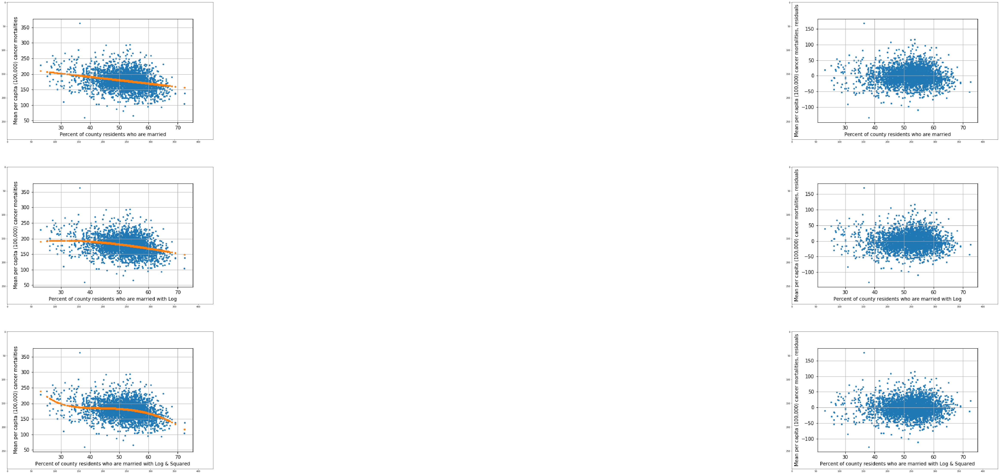

In [109]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(3, 2, 1)
im_11_ap = plt.imread("PercentMarried_actual_&_predicted_Y.png")
implot_11_ap = plt.imshow(im_11_ap)
plt.subplot(3, 2, 2)
im_11_r = plt.imread("PercentMarried_residuals.png")
implot_11_r = plt.imshow(im_11_r)
plt.subplot(3, 2, 3)
im_11_l = plt.imread("PercentMarried_log_actual_&_predicted_Y.png")
implot_11_l = plt.imshow(im_11_l)
plt.subplot(3, 2, 4)
im_11_lres = plt.imread("PercentMarried_log_residuals.png")
implot_11_lres = plt.imshow(im_11_lres)
plt.subplot(3, 2, 5)
im_11_lsq = plt.imread("PercentMarried_log_sqrd_actual_&_predicted_Y.png")
implot_11_lsq = plt.imshow(im_11_lsq)
plt.subplot(3, 2, 6)
im_11_lsqres = plt.imread("PercentMarried_log_sqrd_residuals.png")
implot_11_lsqres = plt.imshow(im_11_lsqres)

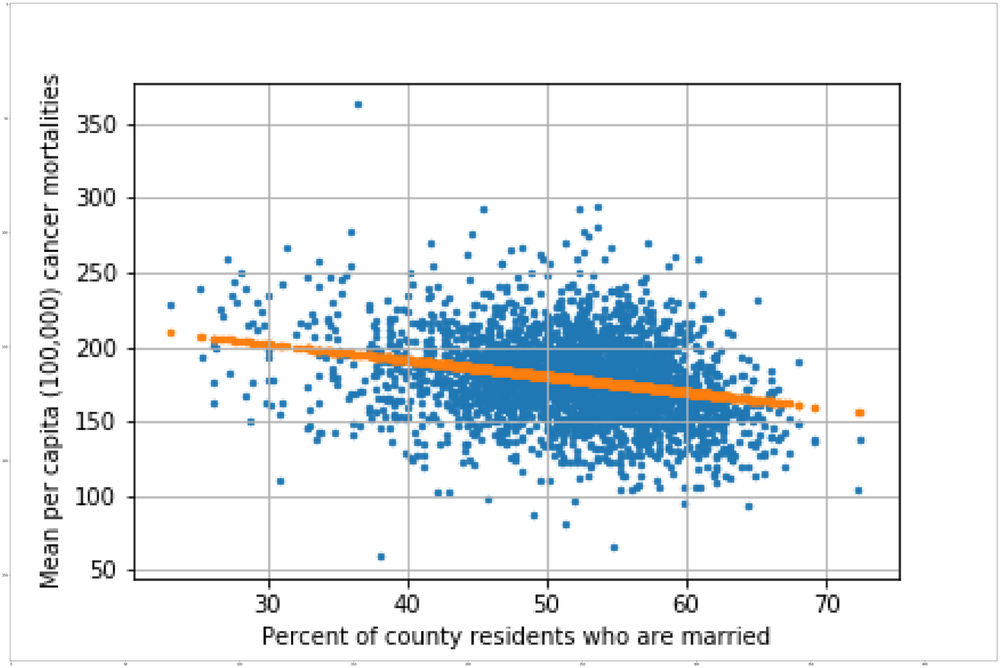

In [110]:
im_11_ap = plt.imread("PercentMarried_actual_&_predicted_Y.png")
implot_11_ap = plt.imshow(im_11_ap)

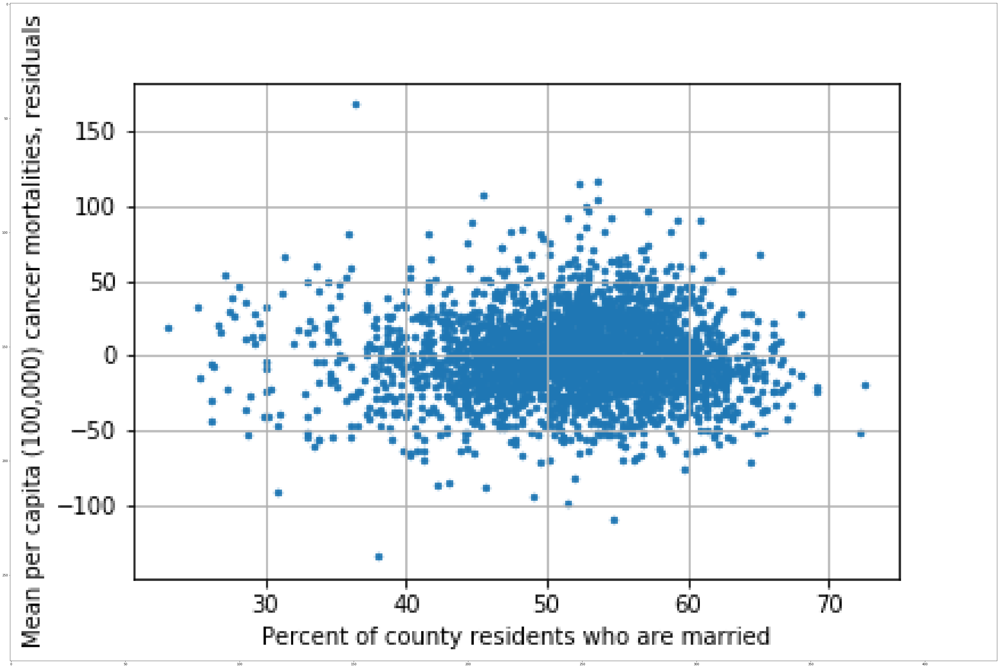

In [111]:
im_11_r = plt.imread("PercentMarried_residuals.png")
implot_11_r = plt.imshow(im_11_r)

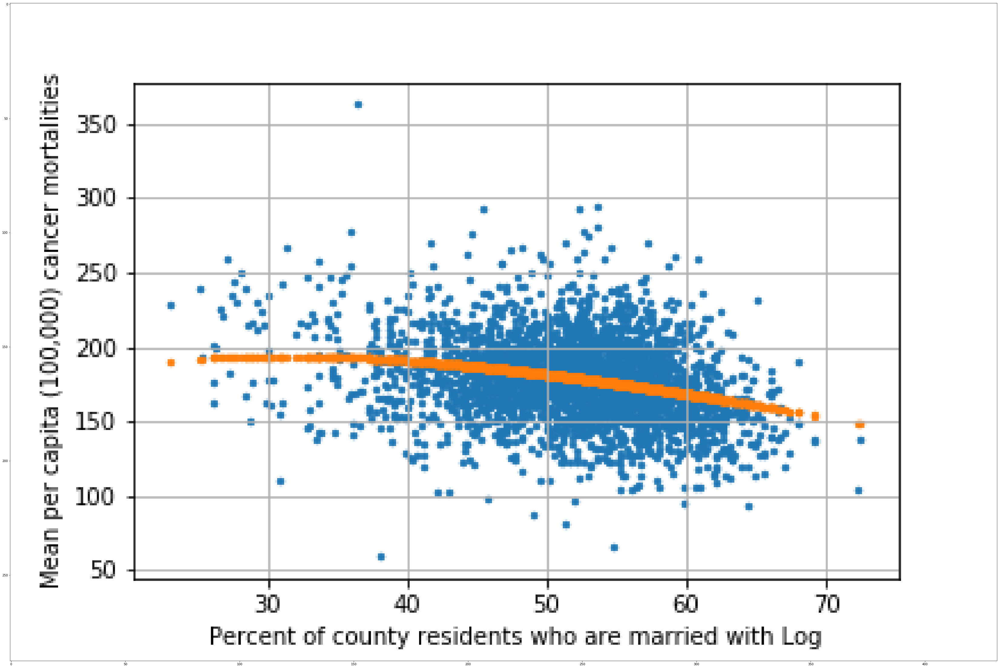

In [112]:
im_11_l = plt.imread("PercentMarried_log_actual_&_predicted_Y.png")
implot_11_l = plt.imshow(im_11_l)

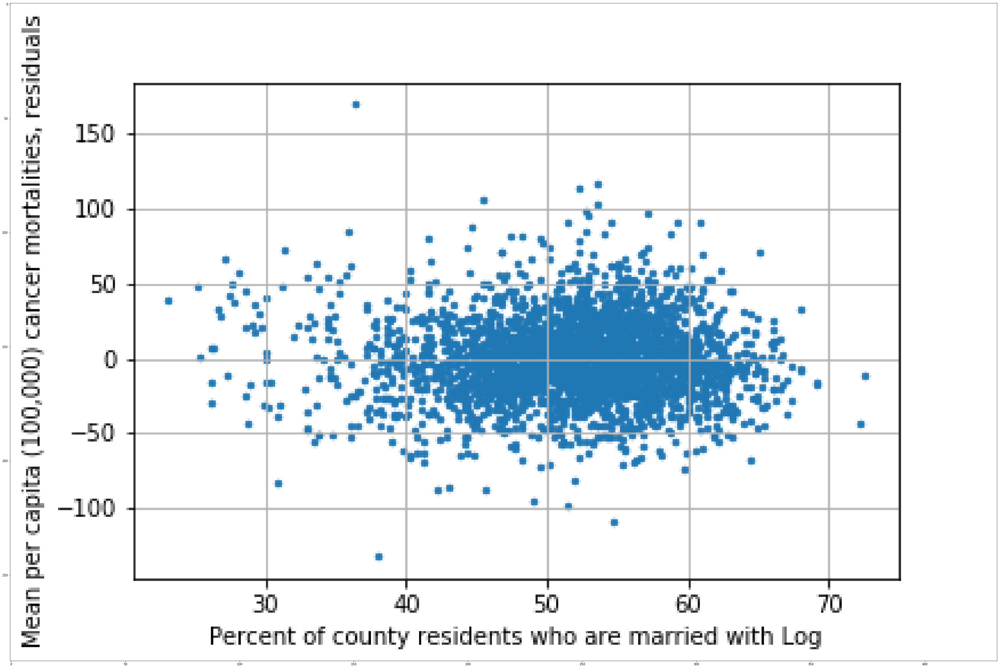

In [113]:
im_11_lres = plt.imread("PercentMarried_log_residuals.png")
implot_11_lres = plt.imshow(im_11_lres)

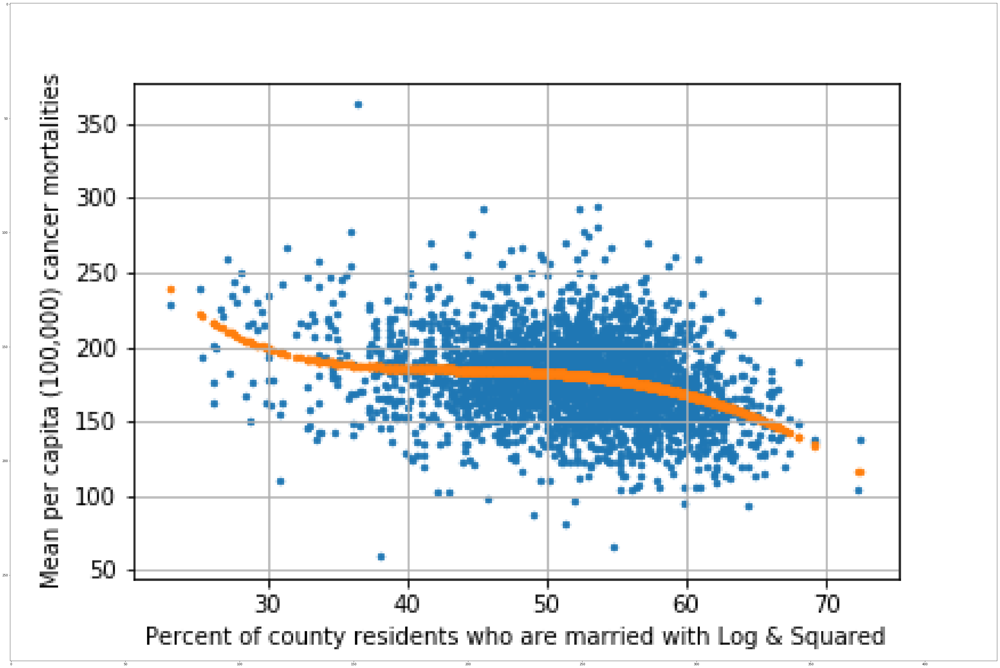

In [114]:
im_11_lsq = plt.imread("PercentMarried_log_sqrd_actual_&_predicted_Y.png")
implot_11_lsq = plt.imshow(im_11_lsq)

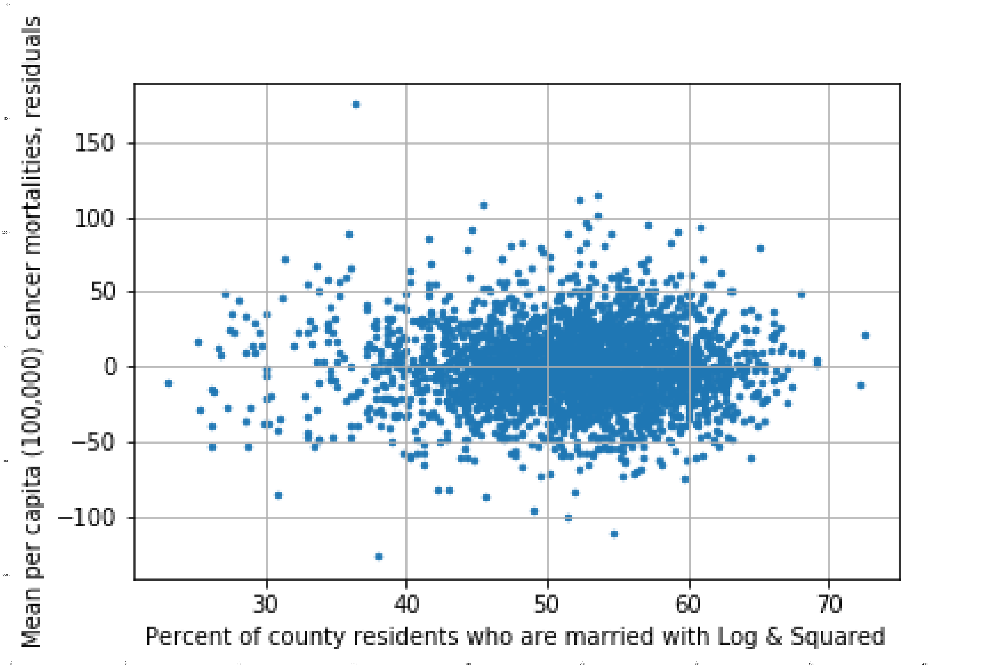

In [115]:
im_11_lsqres = plt.imread("PercentMarried_log_sqrd_residuals.png")
implot_11_lsqres = plt.imshow(im_11_lsqres)

## 'PctNoHS18_24': Percent of county residents ages 18-24 highest education attained: less than high school

The percentage of county residents that are 18-24 years old who never graduated high school ranges from zero to 64.1%, and has an average value of 18.2 with a standard deviation of 8.1. The counties with the lowest percentage of 18-24 year old county residents with less than a high school education are in New Mexico, Virginia, Alaska and Montana. The counties with the highest percentage of 18-24 year old county residents are in Texas, New Mexico, Indiana, Nebraska and Ohio.

In [116]:
cancer.PctNoHS18_24.describe()

count    3047.000000
mean       18.224450
std         8.093064
min         0.000000
25%        12.800000
50%        17.100000
75%        22.700000
max        64.100000
Name: PctNoHS18_24, dtype: float64

Text(0, 0.5, 'Number of Counties')

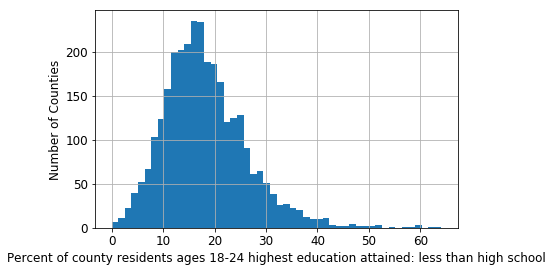

In [117]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctNoHS18_24'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 18-24 highest education attained: less than high school", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [118]:
pct_no_hs_18_24 = cancer.sort_values(by='PctNoHS18_24').PctNoHS18_24
pct_no_hs_18_24.head()

Geography
Catron County, New Mexico       0.0
Craig County, Virginia          0.0
Haines Borough, Alaska          0.5
Buena Vista city, Virginia      0.5
Judith Basin County, Montana    0.8
Name: PctNoHS18_24, dtype: float64

In [119]:
pct_no_hs_18_24.tail()

Geography
Presidio County, Texas        59.0
De Baca County, New Mexico    59.1
LaGrange County, Indiana      59.7
Brown County, Nebraska        62.7
Holmes County, Ohio           64.1
Name: PctNoHS18_24, dtype: float64

There is only a 0.09 correlation between being an 18-24 year old with less than a high school education and cancer mortality. Adding a logarithmic or exponential transformation of this feature did not increase the model's overall accuracy.

In [120]:
r_PctNoHS18_24 = pearson_r(cancer['PctNoHS18_24'], cancer['TARGET_deathRate'])
r_PctNoHS18_24

0.08846261004222876

In [121]:
cov_matrix_PctNoHS18_24 = np.cov(cancer['PctNoHS18_24'], cancer['TARGET_deathRate'])
cov_matrix_PctNoHS18_24

array([[ 65.49769155,  19.86823943],
       [ 19.86823943, 770.14638047]])

## 'PctHS18_24': Percent of county residents ages 18-24 highest education attained: high school diploma

The percentage of county residents that are 18-24 years old whose highest education is a high school diploma ranges from zero to 72.5%, and has an average value of 35% with a standard deviation of 9.1%. The counties with the lowest percentage of 18-24 year old county residents whose highest education is a high school diploma are in Kansas, Wyoming, Utah, New Mexico and Kansas. The counties with the highest percentage are in Alabama, Montana, Kentucky, Utah and Alaska.

In [122]:
cancer.describe().PctHS18_24

count    3047.000000
mean       35.002068
std         9.069722
min         0.000000
25%        29.200000
50%        34.700000
75%        40.700000
max        72.500000
Name: PctHS18_24, dtype: float64

Text(0, 0.5, 'Number of Counties')

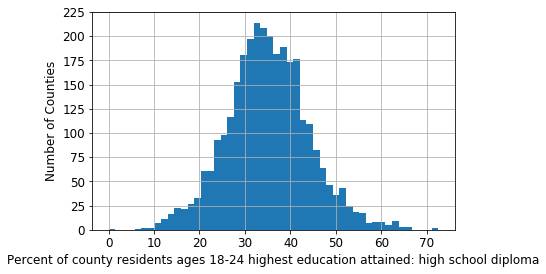

In [123]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctHS18_24'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 18-24 highest education attained: high school diploma", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [124]:
pct_hs_18_24 = cancer.sort_values(by='PctHS18_24').PctHS18_24
pct_hs_18_24.head()

Geography
Greeley County, Kansas          0.0
Hot Springs County, Wyoming     7.1
Wayne County, Utah              8.0
De Baca County, New Mexico      8.6
Williamsburg city, Virginia    10.0
Name: PctHS18_24, dtype: float64

In [125]:
pct_hs_18_24.tail()

Geography
Bullock County, Alabama      65.5
McCone County, Montana       65.7
Gallatin County, Kentucky    66.2
Kane County, Utah            72.1
Haines Borough, Alaska       72.5
Name: PctHS18_24, dtype: float64

There is a 0.26 correlation between the percentage of 18-24 year old county residents whose highest education is a high school diploma and cancer mortality, showing some relationship between the prevalence of lower education and increased cancer mortality. Adding a logarithmic and exponential transformation of the 'PctHS18_24' feature did not increase the linear regression model's accuracy.

In [126]:
r_PctHS18_24 = pearson_r(cancer['PctHS18_24'], cancer['TARGET_deathRate'])
r_PctHS18_24

0.26197594028618737

In [127]:
cov_matrix_PctHS18_24 = np.cov(cancer['PctHS18_24'], cancer['TARGET_deathRate'])
cov_matrix_PctHS18_24

array([[ 82.25985455,  65.93894826],
       [ 65.93894826, 770.14638047]])

## 'PctSomeCol18_24': Percent of county residents ages 18-24 highest education attained: some college

The percentage of county residents that are 18-24 years old whose highest education is some college education ranges from 7.1% to 79%, and has a mean value of 40.5% with a standard deviation of 5.6%. The histogram below has such a strong peak at the median because nearly 75% of the counties initially had missing data in the original data set and the values for this variable were filled by the median (as described in the data cleaning notebook). The counties with the lowest percentage of county residents who are married are in Texas, Utah, West Virginia and Wisconsin. The counties with the highest percentage of county residents who are married are in Idaho, North Carolina, Georgia, Virginia and Iowa.

In [128]:
cancer.describe().PctSomeCol18_24

count    3047.000000
mean       40.544306
std         5.561696
min         7.100000
25%        40.400000
50%        40.400000
75%        40.400000
max        79.000000
Name: PctSomeCol18_24, dtype: float64

Text(0, 0.5, 'Number of Counties')

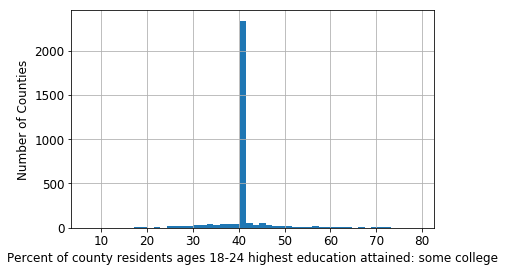

In [129]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctSomeCol18_24'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 18-24 highest education attained: some college", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [130]:
Pct_Some_Col_18_24 = cancer.sort_values(by='PctSomeCol18_24').PctSomeCol18_24
Pct_Some_Col_18_24.head()

Geography
Bailey County, Texas                7.1
Kane County, Utah                   9.6
Doddridge County, West Virginia    10.1
Menominee County, Wisconsin        11.2
Collingsworth County, Texas        11.4
Name: PctSomeCol18_24, dtype: float64

In [131]:
Pct_Some_Col_18_24.tail()

Geography
Madison County, Idaho             73.5
Watauga County, North Carolina    75.2
Bulloch County, Georgia           76.2
Williamsburg city, Virginia       78.3
Winneshiek County, Iowa           79.0
Name: PctSomeCol18_24, dtype: float64

There is a weak negative correlation of -0.10 between 'PctSomeCol18_24' and cancer mortality, showing that as the percentage of 18-24 year olds in a county whose highest education is some college (but not a degree) increases, cancer mortality goes slightly down. 

In [132]:
r_PctSomeCol18_24 = pearson_r(cancer['PctSomeCol18_24'], cancer['TARGET_deathRate'])
r_PctSomeCol18_24

-0.09490143372046697

In [133]:
cov_matrix_PctSomeCol18_24 = np.cov(cancer['PctSomeCol18_24'], cancer['TARGET_deathRate'])
cov_matrix_PctSomeCol18_24

array([[ 30.93246182, -14.64760621],
       [-14.64760621, 770.14638047]])

One can see the weakly negative correlation between the percentage of 18-24 year olds in a county whose highest education is some college and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic and exponential transformations of 'PctSomeCol18_24' are added, and doing so increased the model's accuracy by 0.0006.

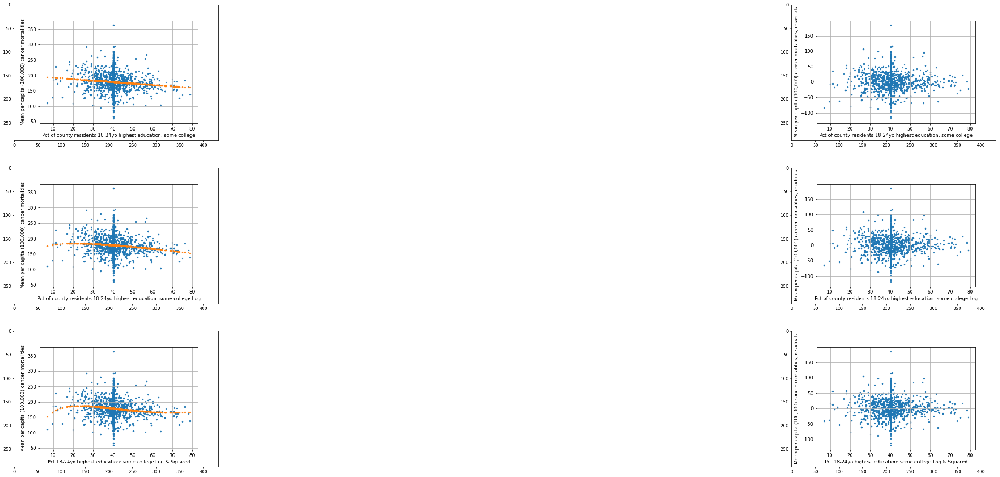

In [134]:
plt.rcParams["figure.figsize"] = (60, 20)
plt.subplot(3, 2, 1)
im_14_ap = plt.imread("PctSomeCol18_24_actual_&_predicted_Y.png")
implot_14_ap = plt.imshow(im_14_ap)
plt.subplot(3, 2, 2)
im_14_r = plt.imread("PctSomeCol18_24_residuals.png")
implot_14_r = plt.imshow(im_14_r)
plt.subplot(3, 2, 3)
im_14_l = plt.imread("PctSomeCol18_24_log_actual_&_predicted_Y.png")
implot_14_l = plt.imshow(im_14_l)
plt.subplot(3, 2, 4)
im_14_lres = plt.imread("PctSomeCol18_24_log_residuals.png")
implot_14_lres = plt.imshow(im_14_lres)
plt.subplot(3, 2, 5)
im_14_lsq = plt.imread("PctSomeCol18_24_log_sqrd_actual_&_predicted_Y.png")
implot_14_lsq = plt.imshow(im_14_lsq)
plt.subplot(3, 2, 6)
im_14_lsqres = plt.imread("PctSomeCol18_24_log_sqrd_residuals.png")
implot_14_lsqres = plt.imshow(im_14_lsqres)

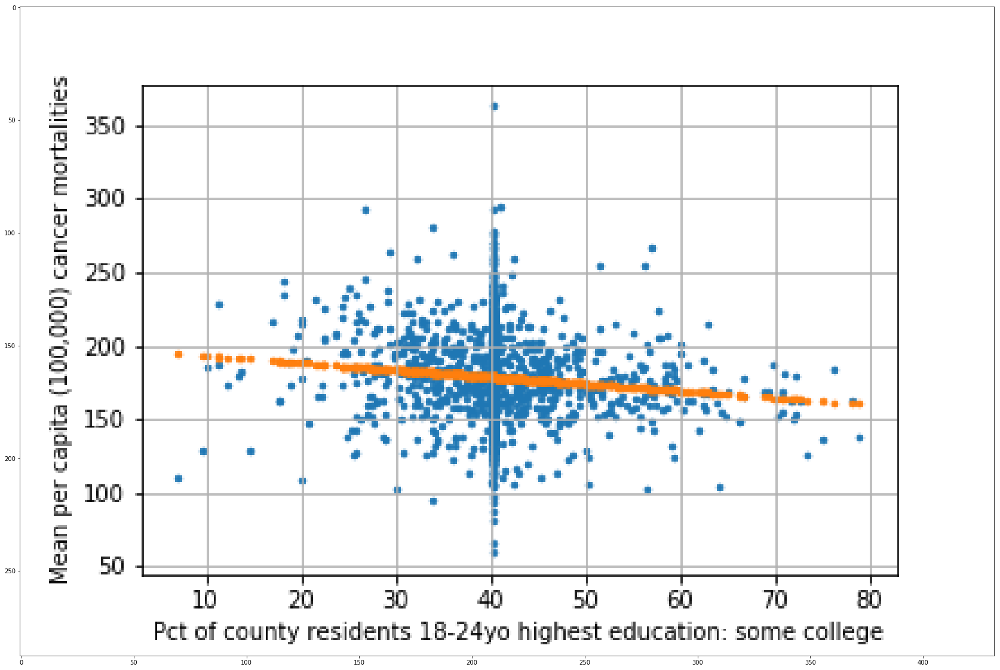

In [135]:
im_14_ap = plt.imread("PctSomeCol18_24_actual_&_predicted_Y.png")
implot_14_ap = plt.imshow(im_14_ap)

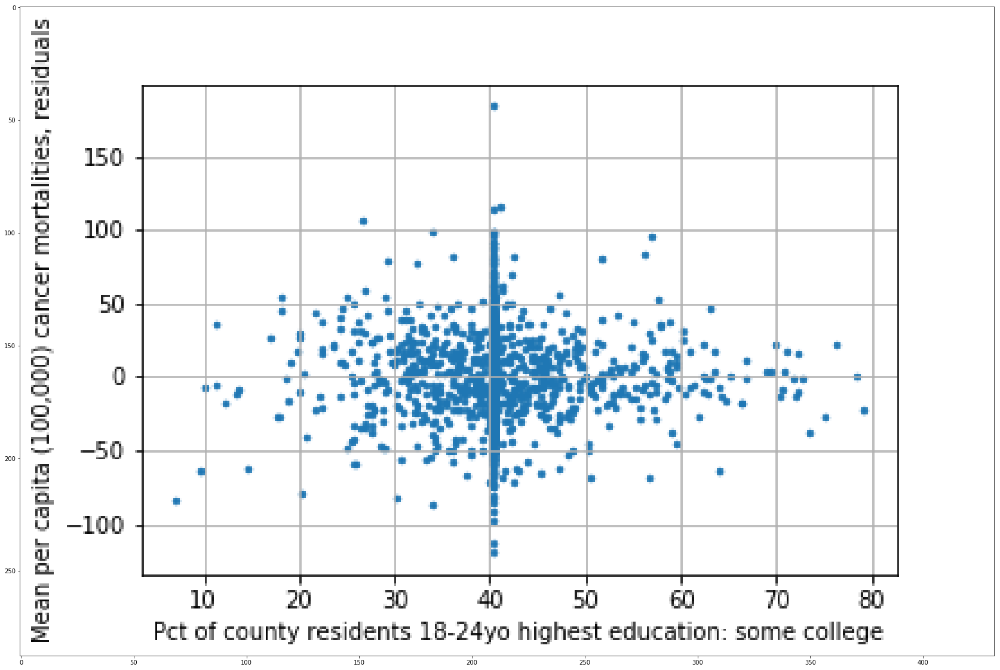

In [136]:
im_14_r = plt.imread("PctSomeCol18_24_residuals.png")
implot_14_r = plt.imshow(im_14_r)

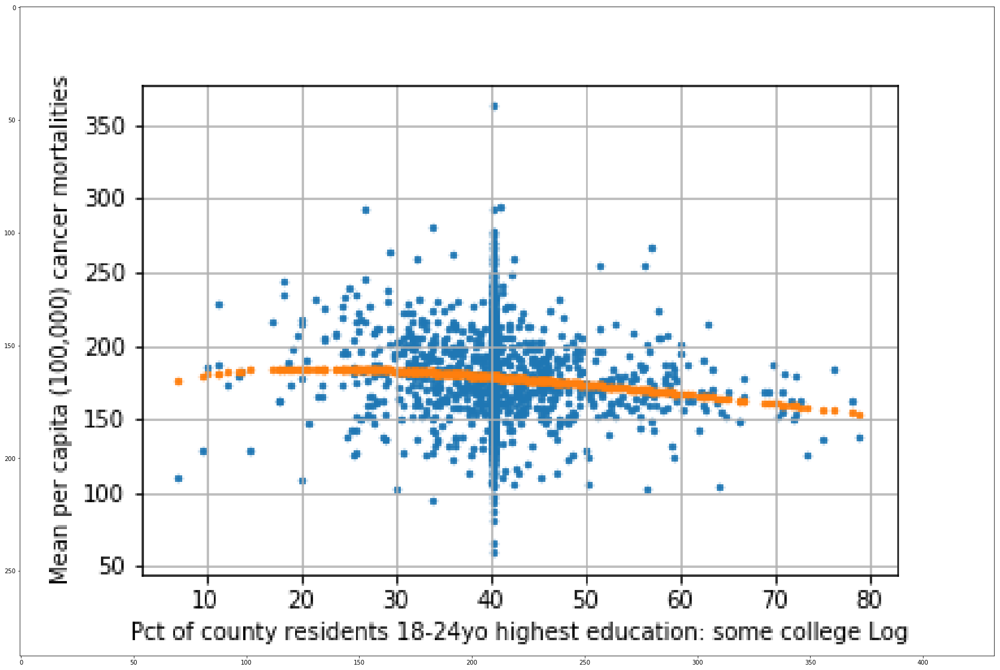

In [137]:
im_14_l = plt.imread("PctSomeCol18_24_log_actual_&_predicted_Y.png")
implot_14_l = plt.imshow(im_14_l)

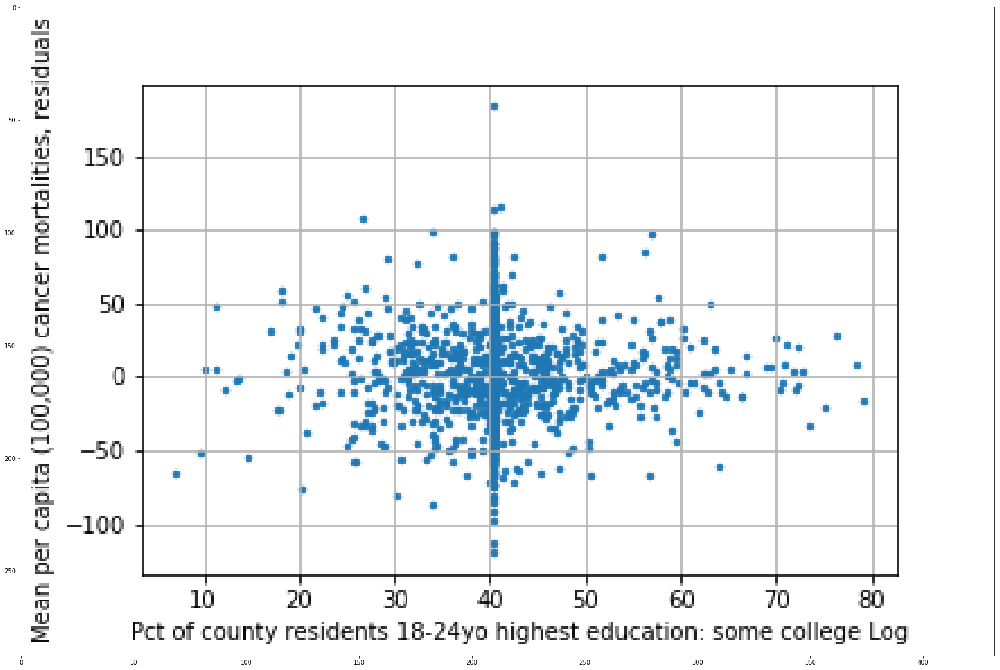

In [138]:
im_14_lres = plt.imread("PctSomeCol18_24_log_residuals.png")
implot_14_lres = plt.imshow(im_14_lres)

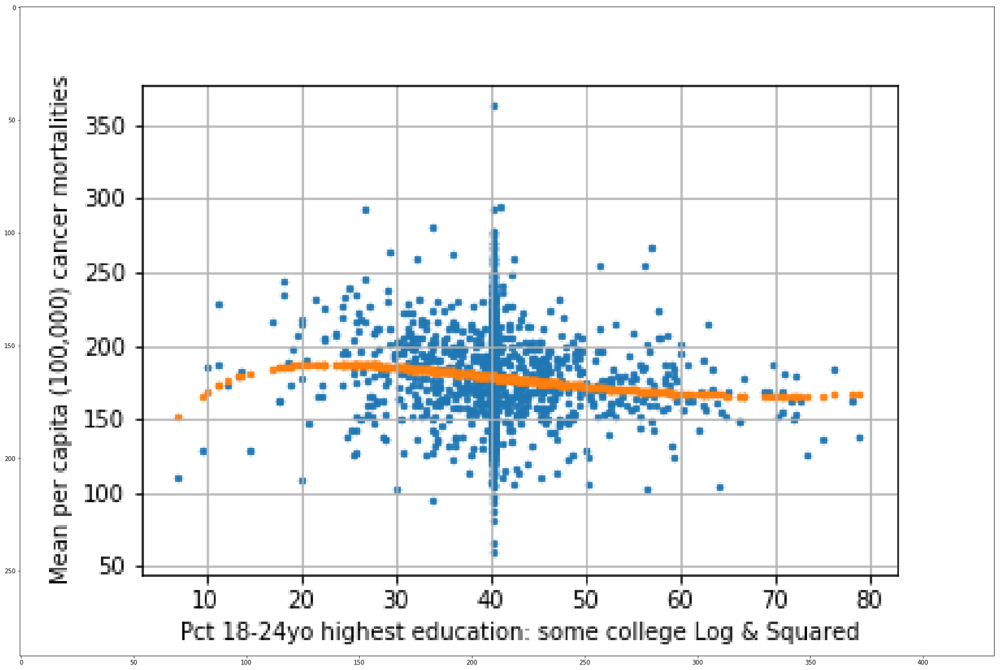

In [139]:
im_14_lsq = plt.imread("PctSomeCol18_24_log_sqrd_actual_&_predicted_Y.png")
implot_14_lsq = plt.imshow(im_14_lsq)

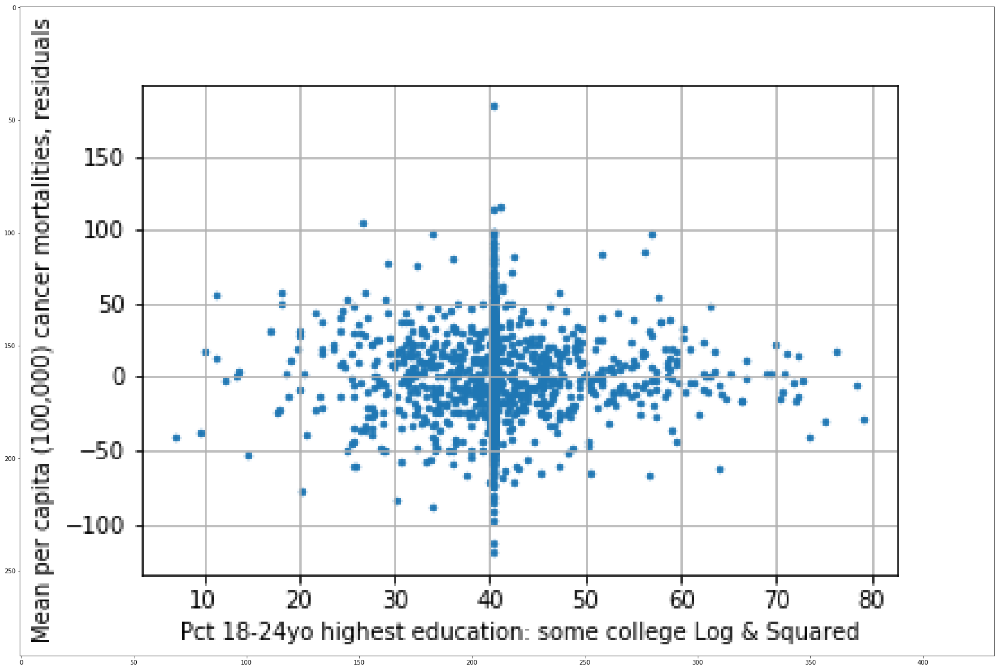

In [140]:
im_14_lsqres = plt.imread("PctSomeCol18_24_log_sqrd_residuals.png")
implot_14_lsqres = plt.imshow(im_14_lsqres)

## 'PctBachDeg18_24': Percent of county residents ages 18-24 highest education attained: bachelor's degree 

The percentage of county residents that are 18-24 years old with their highest education being a Bachelor's degree ranges from zero to 51.8%, and has a mean value of 6.2% with a standard deviation of 4.5%. The counties with the lowest percentage of 18-24 year old county residents with their highest education being a Bachelor's degree are in Texas, South Carolina, and Indiana. The counties with the highest percentage are in Colorado, Virginia, Kansas and North Dakota.

In [141]:
cancer.describe().PctBachDeg18_24

count    3047.000000
mean        6.158287
std         4.529059
min         0.000000
25%         3.100000
50%         5.400000
75%         8.200000
max        51.800000
Name: PctBachDeg18_24, dtype: float64

Text(0, 0.5, 'Number of Counties')

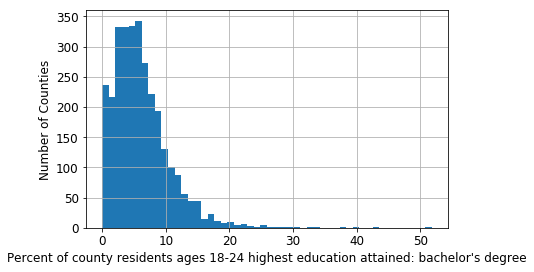

In [142]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctBachDeg18_24'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 18-24 highest education attained: bachelor's degree", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [143]:
Pct_Bach_Deg_18_24 = cancer.sort_values(by='PctBachDeg18_24').PctBachDeg18_24
Pct_Bach_Deg_18_24.head()

Geography
Zavala County, Texas              0.0
Bamberg County, South Carolina    0.0
Oldham County, Texas              0.0
Switzerland County, Indiana       0.0
Swisher County, Texas             0.0
Name: PctBachDeg18_24, dtype: float64

In [144]:
Pct_Bach_Deg_18_24.tail()

Geography
Dolores County, Colorado              33.3
Falls Church city, Virginia           37.5
Greeley County, Kansas                40.3
Golden Valley County, North Dakota    43.4
Arlington County, Virginia            51.8
Name: PctBachDeg18_24, dtype: float64

There is a moderate negative correlation of -0.29 between the percentage of 18-24 year old county residents with their highest education being a Bachelor's degree and cancer mortality. This again shows that there is a relationship between the level of education in a county and reduced cancer mortality, although a causative link can't be made between the two as part of this analysis. 

Adding a logarithmic or exponential expansion of 'PctBachDeg18_24' did not add to the model's overall accuracy. 

In [145]:
r_PctBachDeg18_24 = pearson_r(cancer['PctBachDeg18_24'], cancer['TARGET_deathRate'])
r_PctBachDeg18_24

-0.28781741016746587

In [146]:
cov_matrix_PctBachDeg18_24 = np.cov(cancer['PctBachDeg18_24'], cancer['TARGET_deathRate'])
cov_matrix_PctBachDeg18_24

array([[ 20.5123796 , -36.17526513],
       [-36.17526513, 770.14638047]])

## 'PctHS25_Over': Percent of county residents ages 25 and over highest education attained: high school diploma

The percentage of county residents that are 25 years and over with their highest education being a high school degree ranges from 7% to 54.8%, and has a mean value of 34.8% with a standard deviation of 7%. The counties with the lowest percentage of county residents 25 years and over with their highest education being a high school degree are in Virginia, New Mexico, Colorado, and California. The counties with the highest percentage are in Pennsylvania, Ohio, West Virginia, and Georgia.

In [147]:
cancer.describe().PctHS25_Over

count    3047.000000
mean       34.804660
std         7.034924
min         7.500000
25%        30.400000
50%        35.300000
75%        39.650000
max        54.800000
Name: PctHS25_Over, dtype: float64

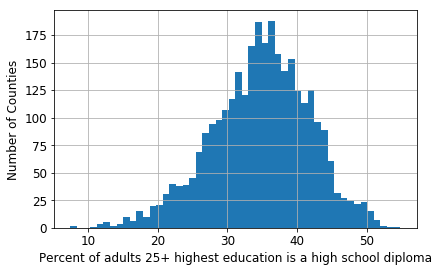

In [150]:
cancer['PctHS25_Over'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of adults 25+ highest education is a high school diploma", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctHS25_Over_dist.png')

In [151]:
pct_hs_25_over = cancer.sort_values(by='PctHS25_Over').PctHS25_Over
pct_hs_25_over.head()

Geography
Falls Church city, Virginia       7.5
Arlington County, Virginia        8.3
Los Alamos County, New Mexico    10.8
Pitkin County, Colorado          11.5
Marin County, California         11.8
Name: PctHS25_Over, dtype: float64

In [152]:
pct_hs_25_over.tail()

Geography
Huntingdon County, Pennsylvania    51.7
Noble County, Ohio                 52.1
Tucker County, West Virginia       52.7
Forest County, Pennsylvania        53.6
Wheeler County, Georgia            54.8
Name: PctHS25_Over, dtype: float64

There is a moderately strong correlation of 0.41 between the percentage of county residents 25 years and over with their highest education being a high school degree and cancer mortality. This again shows the relationship between lower education and an increased rate of cancer mortality, because it is shown with this correlation that cancer mortality increases as the percentage of adults in a county with only a high school diploma increases.

In [153]:
r_PctHS25_Over = pearson_r(cancer['PctHS25_Over'], cancer['TARGET_deathRate'])
r_PctHS25_Over

0.404589075781319

In [154]:
cov_matrix_PctHS25_Over = np.cov(cancer['PctHS25_Over'], cancer['TARGET_deathRate'])
cov_matrix_PctHS25_Over

array([[ 49.49015556,  78.98783332],
       [ 78.98783332, 770.14638047]])

One can see the moderately positive correlation between the percentage of county residents 25 years and over with their highest education being a high school degree and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformation of 'PctHS25_Over' is added, and doing so increased the model's accuracy by 0.0002.

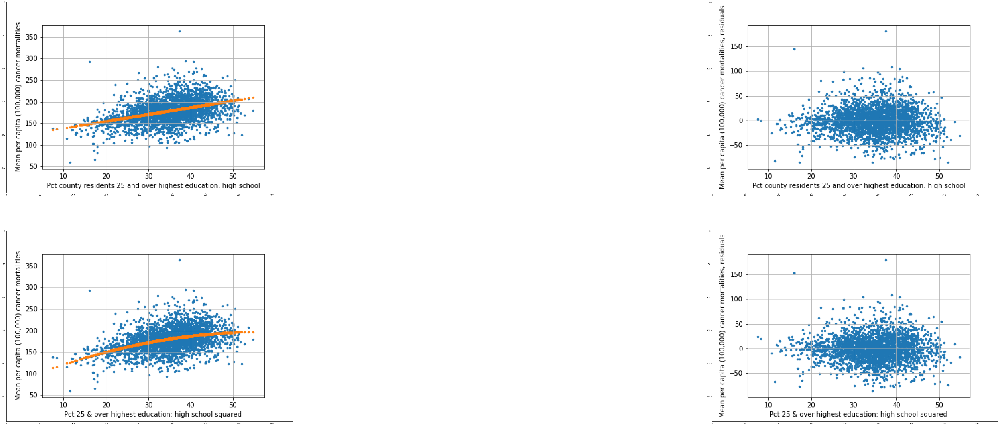

In [155]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_16_ap = plt.imread("PctHS25_Over_actual_&_predicted_Y.png")
implot_16_ap = plt.imshow(im_16_ap)
plt.subplot(2, 2, 2)
im_16_r = plt.imread("PctHS25_Over_residuals.png")
implot_16_r = plt.imshow(im_16_r)
plt.subplot(2, 2, 3)
im_16_sq = plt.imread("PctHS25_Over_sqrd_actual_&_predicted_Y.png")
implot_16_sq = plt.imshow(im_16_sq)
plt.subplot(2, 2, 4)
im_16_sqres = plt.imread("PctHS25_Over_sqrd_residuals.png")
implot_16_sqres = plt.imshow(im_16_sqres)

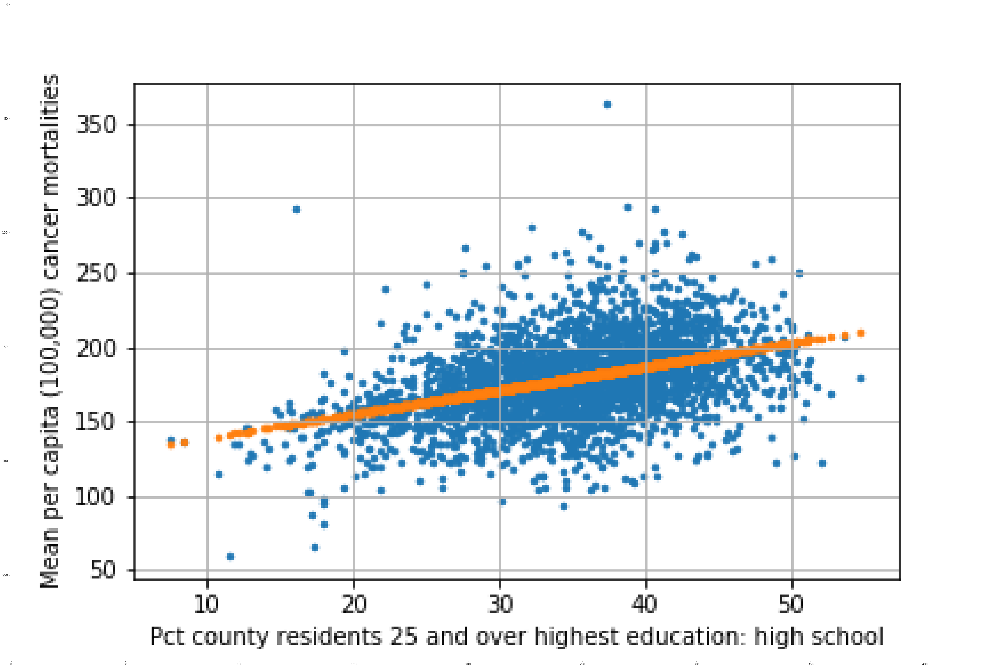

In [156]:
im_16_ap = plt.imread("PctHS25_Over_actual_&_predicted_Y.png")
implot_16_ap = plt.imshow(im_16_ap)

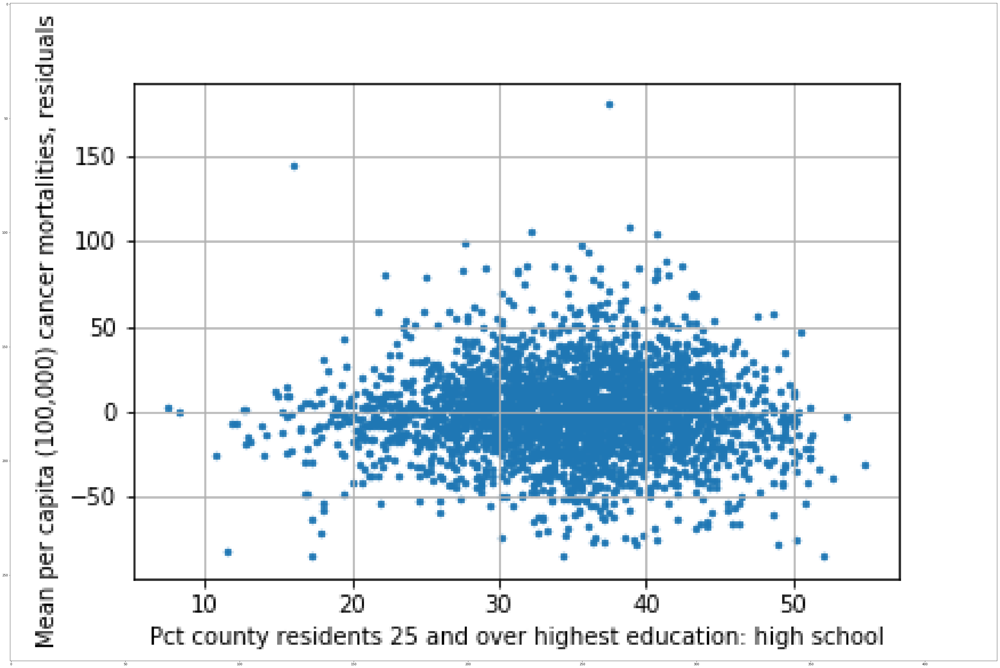

In [157]:
im_16_r = plt.imread("PctHS25_Over_residuals.png")
implot_16_r = plt.imshow(im_16_r)

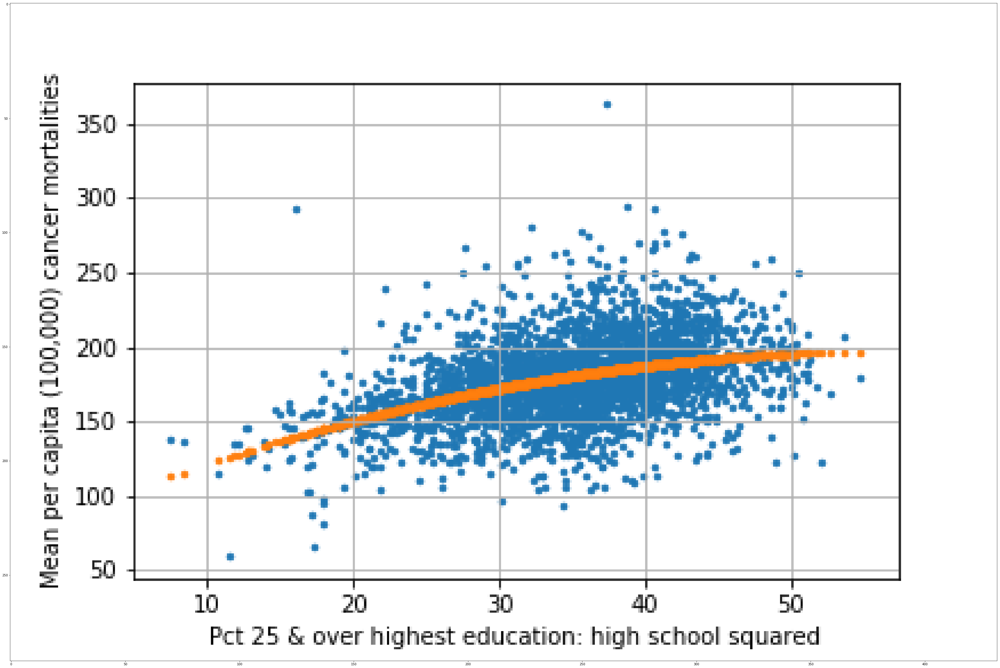

In [158]:
im_16_sq = plt.imread("PctHS25_Over_sqrd_actual_&_predicted_Y.png")
implot_16_sq = plt.imshow(im_16_sq)

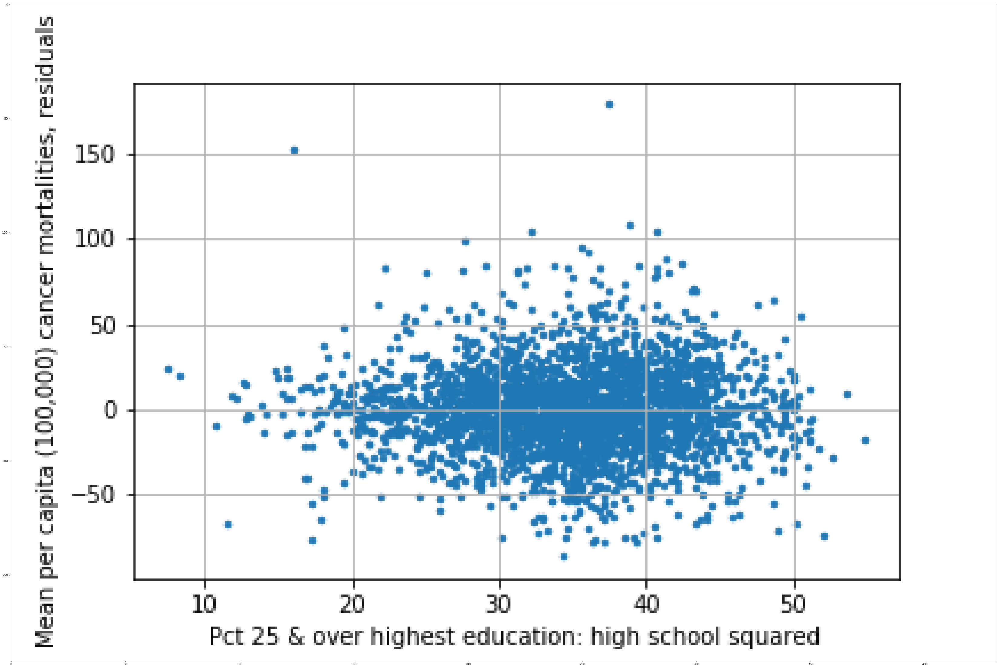

In [159]:
im_16_sqres = plt.imread("PctHS25_Over_sqrd_residuals.png")
implot_16_sqres = plt.imshow(im_16_sqres)

## 'PctBachDeg25_Over': Percent of county residents ages 25 and over highest education attained: bachelor's degree 

The percentage of county residents that are 25 years and older with their highest education being a bachelor's degree ranges from 2.5% to 42.2%, and has a mean value of 13.3% with a standard deviation of 5.4%. The counties with the lowest percentage of county residents aged 25 years and older with their highest education being a bachelor's degree are in Kentucky, Georgia and West Virginia. The counties with the highest percentage are in Colorado and Wyoming.

In [160]:
cancer.describe().PctBachDeg25_Over

count    3047.000000
mean       13.282015
std         5.394756
min         2.500000
25%         9.400000
50%        12.300000
75%        16.100000
max        42.200000
Name: PctBachDeg25_Over, dtype: float64

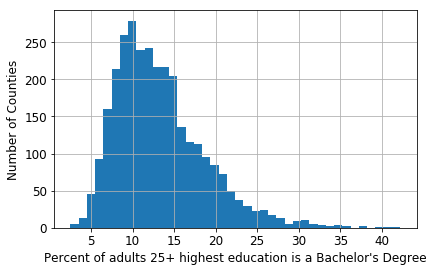

In [165]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctBachDeg25_Over'].hist(bins=40, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of adults 25+ highest education is a Bachelor's Degree", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctBachDeg25_Over_dist.png')

In [162]:
pct_bach_deg_25_over = cancer.sort_values(by='PctBachDeg25_Over').PctBachDeg25_Over
pct_bach_deg_25_over.head()

Geography
Martin County, Kentucky           2.5
Clay County, Georgia              2.7
McCreary County, Kentucky         3.2
McDowell County, West Virginia    3.2
Lee County, Kentucky              3.4
Name: PctBachDeg25_Over, dtype: float64

In [163]:
pct_bach_deg_25_over.tail()

Geography
Douglas County, Colorado       37.8
Teton County, Wyoming          37.8
San Miguel County, Colorado    39.7
Gunnison County, Colorado      40.4
Pitkin County, Colorado        42.2
Name: PctBachDeg25_Over, dtype: float64

There is a moderately negative correlation of -0.49 between the percentage of county residents 25 years and older with their highest education being a Bachelor's degree and cancer mortality. This again shows the relationship between education and cancer mortality, because as that educated percentage goes up, cancer mortality goes down.

In [164]:
r_PctBachDeg25_Over = pearson_r(cancer['PctBachDeg25_Over'], cancer['TARGET_deathRate'])
r_PctBachDeg25_Over

-0.4854773180877449

In [155]:
cov_matrix_PctBachDeg25_Over = np.cov(cancer['PctBachDeg25_Over'], cancer['TARGET_deathRate'])
cov_matrix_PctBachDeg25_Over

array([[ 29.10339279, -72.68208777],
       [-72.68208777, 770.14638047]])

One can see the moderately positive correlation between the percentage of county residents 25 years and older with their highest education being a Bachelor's degree and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic transformation of 'PercentMarried' is added, and doing so increased the model's accuracy by 0.0004.

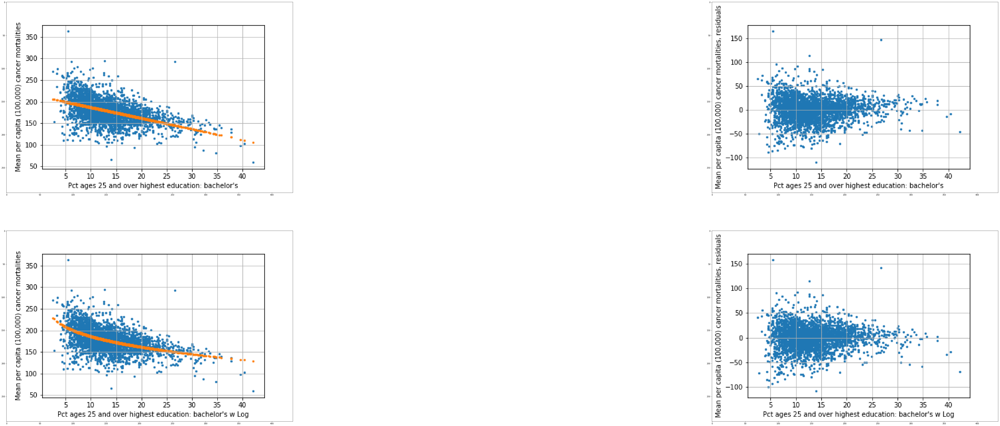

In [166]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_17_ap = plt.imread("PctBachDeg25_Over_actual_&_predicted_Y.png")
implot_17_ap = plt.imshow(im_17_ap)
plt.subplot(2, 2, 2)
im_17_r = plt.imread("PctBachDeg25_Over_residuals.png")
implot_17_r = plt.imshow(im_17_r)
plt.subplot(2, 2, 3)
im_17_l = plt.imread("PctBachDeg25_Over_log_actual_&_predicted_Y.png")
implot_17_l = plt.imshow(im_17_l)
plt.subplot(2, 2, 4)
im_17_lres = plt.imread("PctBachDeg25_Over_log_residuals.png")
implot_17_lres = plt.imshow(im_17_lres)

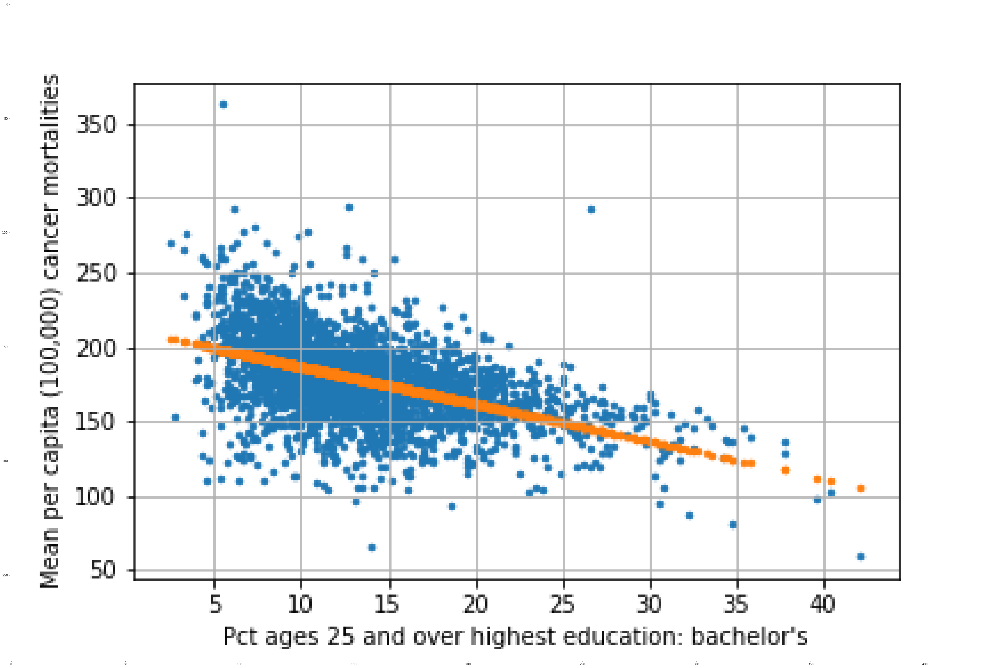

In [167]:
im_17_ap = plt.imread("PctBachDeg25_Over_actual_&_predicted_Y.png")
implot_17_ap = plt.imshow(im_17_ap)

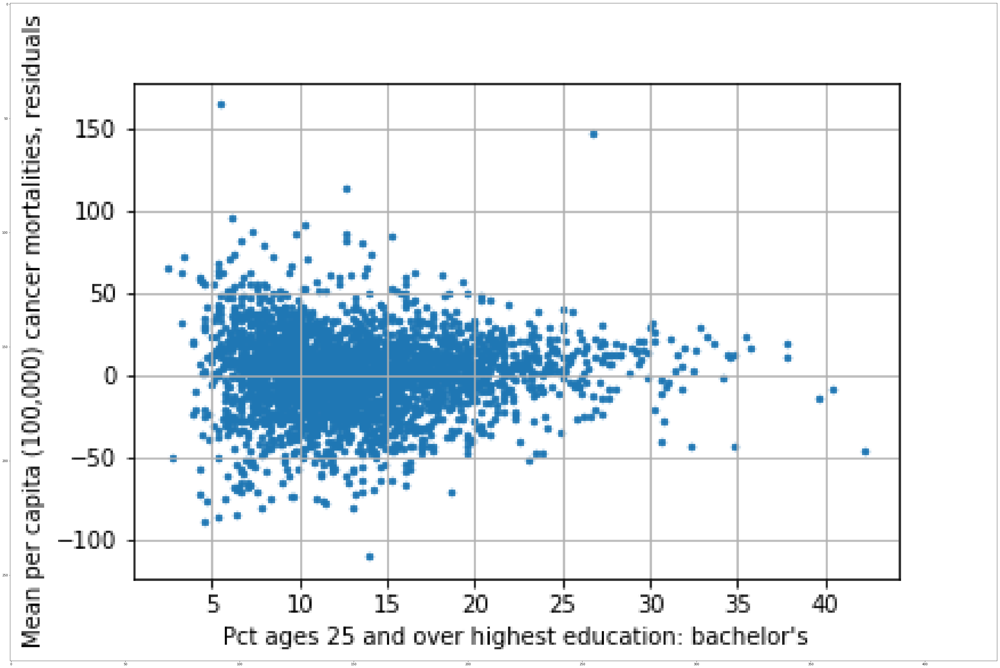

In [168]:
im_17_r = plt.imread("PctBachDeg25_Over_residuals.png")
implot_17_r = plt.imshow(im_17_r)

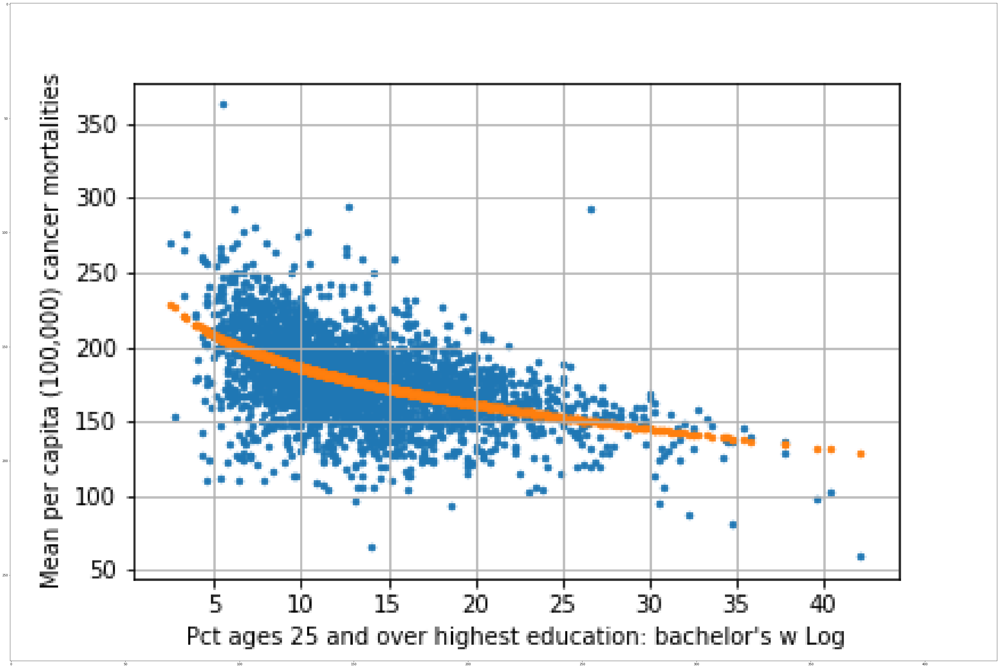

In [169]:
im_17_l = plt.imread("PctBachDeg25_Over_log_actual_&_predicted_Y.png")
implot_17_l = plt.imshow(im_17_l)

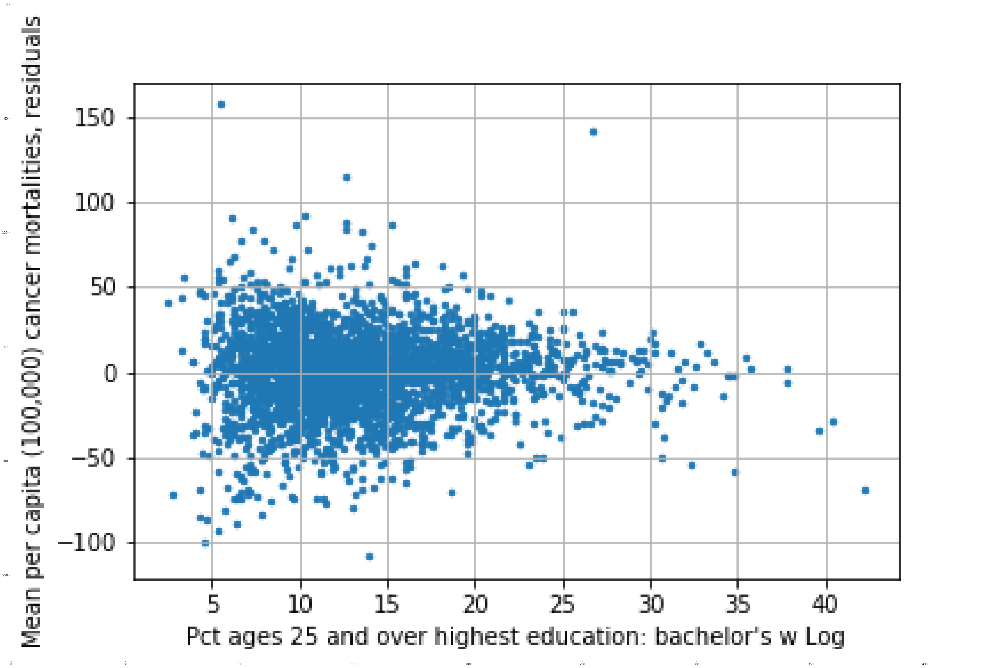

In [170]:
im_17_lres = plt.imread("PctBachDeg25_Over_log_residuals.png")
implot_17_lres = plt.imshow(im_17_lres)

## 'PctEmployed16_Over': Percent of county residents ages 16 and over employed

The percentage of county residents that are 16 years and older and are employed ranges from 17.6% to 80.1%, and has a mean value of 54.2% with a standard deviation of 8.1%. The counties with the lowest percentage of county residents aged 16 and over that are employed are in Pennsylvania, Georgia, Florida, Kentucky and Colorado. The counties with the highest percentage are in Virginia, South Dakota, Wyoming, Colorado, and Alaska.

One can see a high central measurement peak in the histogram below because 5% of the values for 'PctEmployed16_Over' were missing and these counties' values were filled in with the national median.

In [171]:
cancer.describe().PctEmployed16_Over

count    3047.000000
mean       54.169970
std         8.105295
min        17.600000
25%        48.900000
50%        54.500000
75%        60.000000
max        80.100000
Name: PctEmployed16_Over, dtype: float64

Text(0, 0.5, 'Number of Counties')

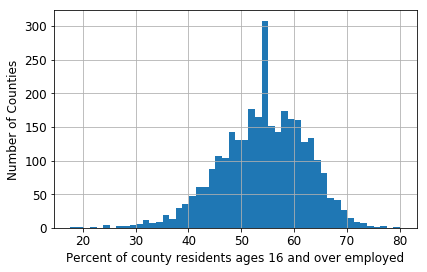

In [172]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctEmployed16_Over'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 16 and over employed", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [173]:
pct_employed_16_over = cancer.sort_values(by='PctEmployed16_Over').PctEmployed16_Over
pct_employed_16_over.head()

Geography
Forest County, Pennsylvania    17.6
Wheeler County, Georgia        19.5
Sumter County, Florida         22.1
Martin County, Kentucky        23.9
Bent County, Colorado          24.0
Name: PctEmployed16_Over, dtype: float64

In [174]:
pct_employed_16_over.tail()

Geography
Arlington County, Virginia            74.4
Lincoln County, South Dakota          75.9
Teton County, Wyoming                 76.5
Eagle County, Colorado                76.5
Aleutians West Census Area, Alaska    80.1
Name: PctEmployed16_Over, dtype: float64

There is a moderately negative relationship of -0.4 between the percentage of county residents 16 years and older and cancer mortality. This shows that as the percentage of employed people in a county increases, cancer mortality decreases.

In [175]:
r_PctEmployed16_Over = pearson_r(cancer['PctEmployed16_Over'], cancer['TARGET_deathRate'])
r_PctEmployed16_Over

-0.39743254078640966

In [176]:
cov_matrix_PctEmployed16_Over = np.cov(cancer['PctEmployed16_Over'], cancer['TARGET_deathRate'])
cov_matrix_PctEmployed16_Over

array([[ 65.69581165, -89.39616817],
       [-89.39616817, 770.14638047]])

One can see the negative correlation line between the percentage of county residents 16 and older who are employed and cancer mortality in the prediction line below. Adding the logarithmic and exponential transformations of this feature reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.006.

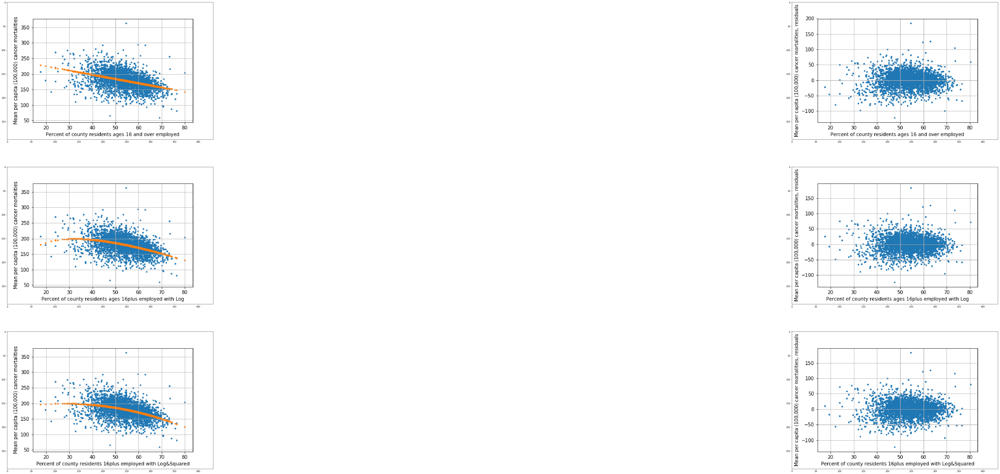

In [177]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(3, 2, 1)
im_18_ap = plt.imread("PctEmployed16_Over_actual_&_predicted_Y.png")
implot_18_ap = plt.imshow(im_18_ap)
plt.subplot(3, 2, 2)
im_18_r = plt.imread("PctEmployed16_Over_residuals.png")
implot_18_r = plt.imshow(im_18_r)
plt.subplot(3, 2, 3)
im_18_l = plt.imread("PctEmployed16_Over_Log_actual_&_predicted_Y.png")
implot_18_l = plt.imshow(im_18_l)
plt.subplot(3, 2, 4)
im_18_lres = plt.imread("PctEmployed16_Over_Log_residuals.png")
implot_18_lres = plt.imshow(im_18_lres)
plt.subplot(3, 2, 5)
im_18_lsq = plt.imread("PctEmployed16_Over_log_sqrd_actual_&_predicted_Y.png")
implot_18_lsq = plt.imshow(im_18_lsq)
plt.subplot(3, 2, 6)
im_18_lsqres = plt.imread("PctEmployed16_Over_log_sqrd_residuals.png")
implot_18_lsqres = plt.imshow(im_18_lsqres)

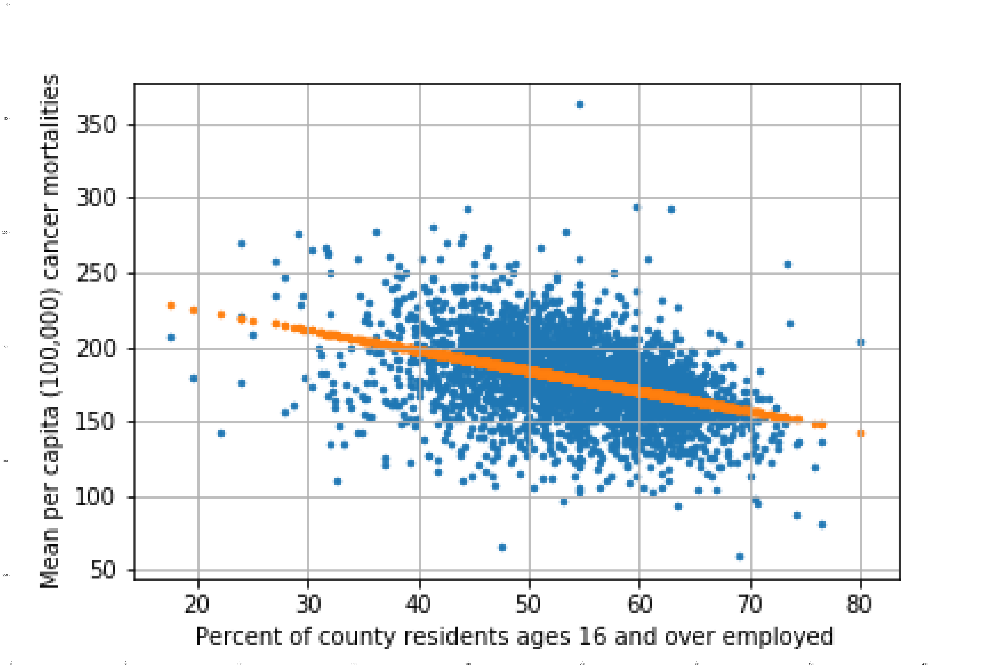

In [178]:
m_18_ap = plt.imread("PctEmployed16_Over_actual_&_predicted_Y.png")
implot_18_ap = plt.imshow(im_18_ap)

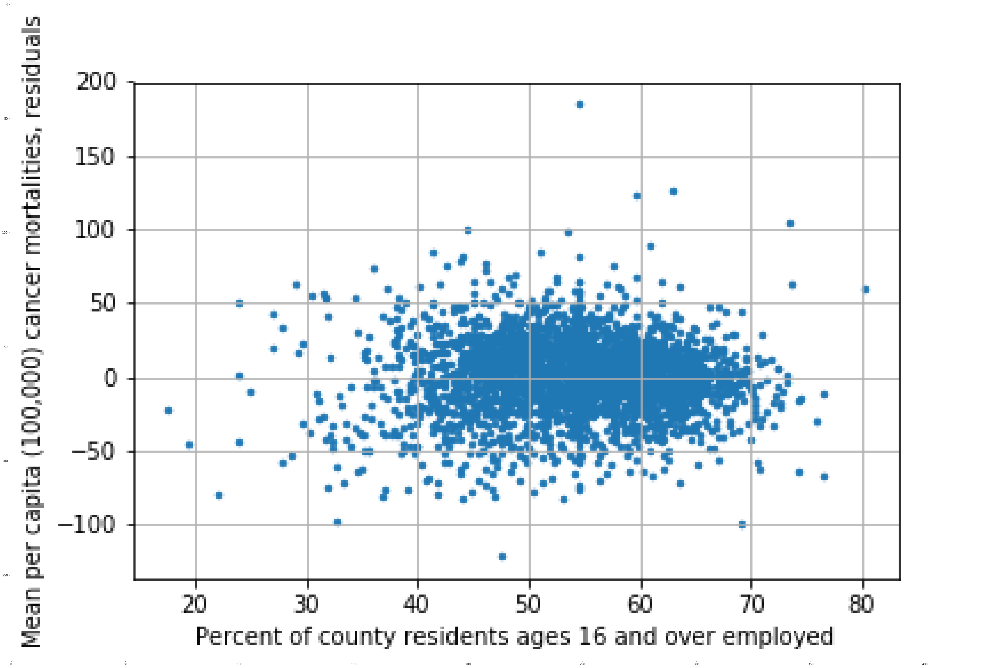

In [179]:
im_18_r = plt.imread("PctEmployed16_Over_residuals.png")
implot_18_r = plt.imshow(im_18_r)

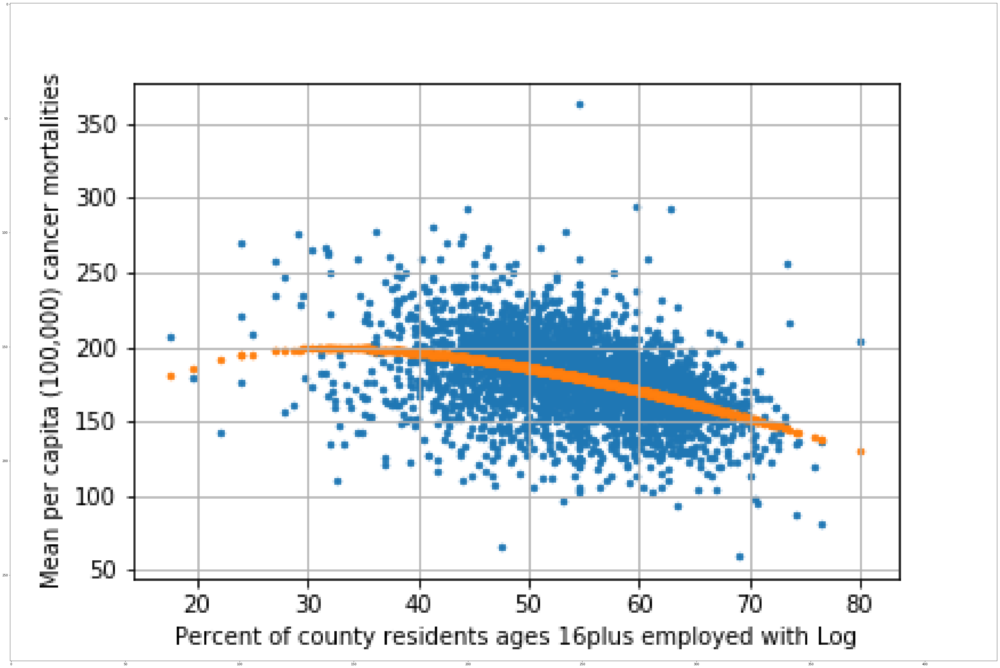

In [180]:
im_18_l = plt.imread("PctEmployed16_Over_Log_actual_&_predicted_Y.png")
implot_18_l = plt.imshow(im_18_l)

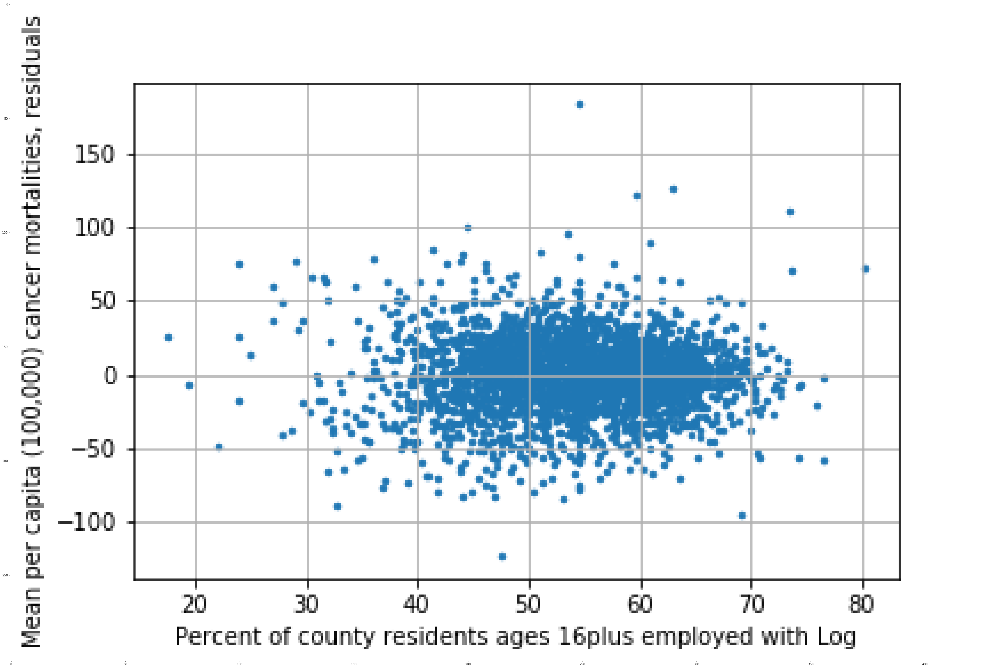

In [181]:
im_18_lres = plt.imread("PctEmployed16_Over_Log_residuals.png")
implot_18_lres = plt.imshow(im_18_lres)

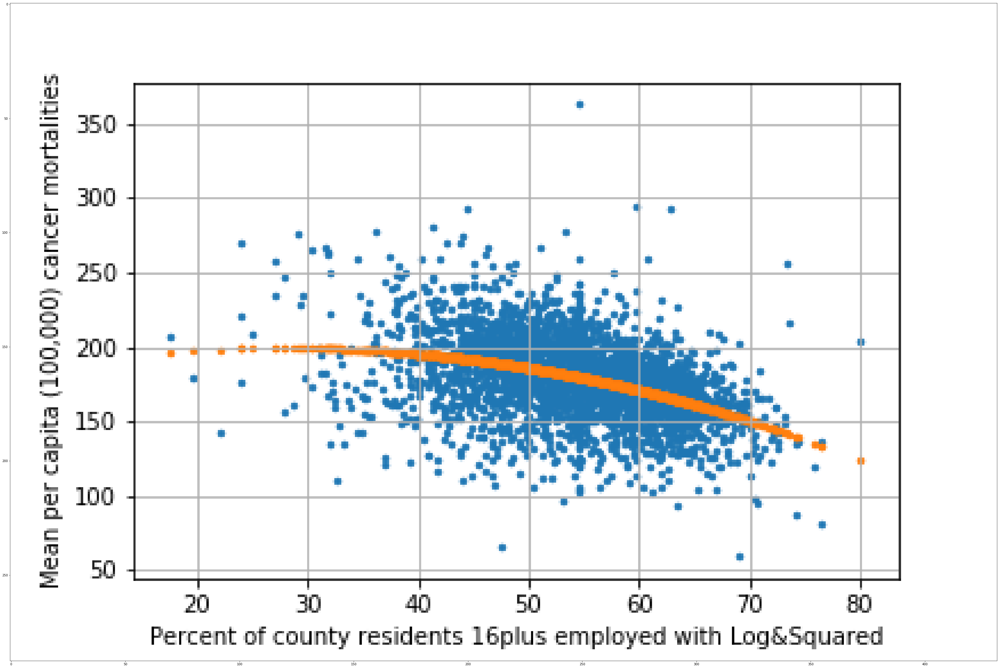

In [182]:
im_18_lsq = plt.imread("PctEmployed16_Over_log_sqrd_actual_&_predicted_Y.png")
implot_18_lsq = plt.imshow(im_18_lsq)

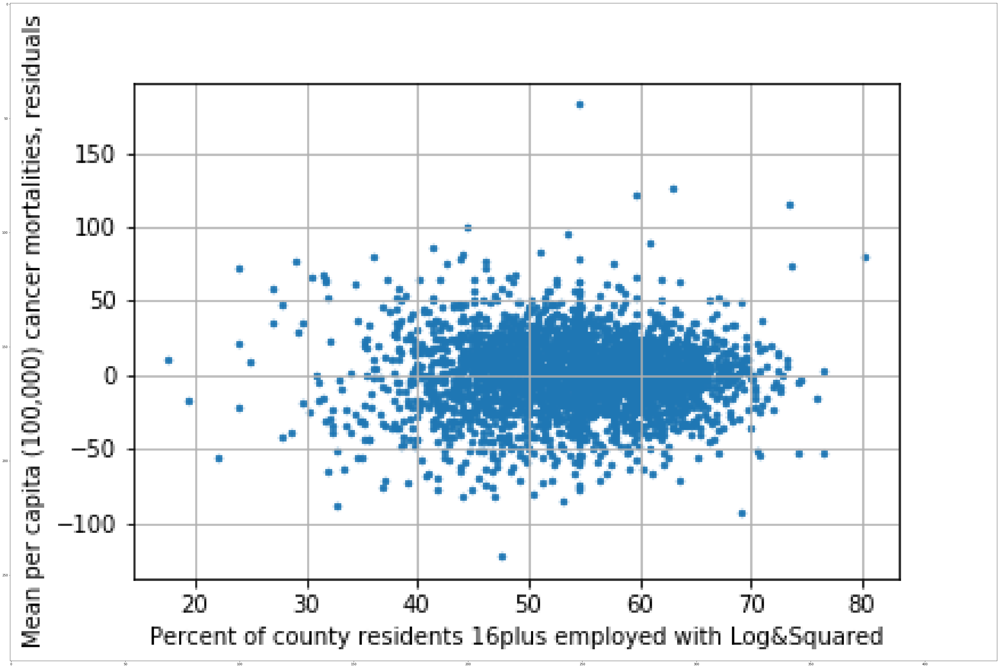

In [183]:
im_18_lsqres = plt.imread("PctEmployed16_Over_log_sqrd_residuals.png")
implot_18_lsqres = plt.imshow(im_18_lsqres)

## 'PctUnemployed16_Over': Percent of county residents ages 16 and over unemployed

The percentage of county residents that are 16 years and over who are unemployed ranges from 0.4% to 29.4%, with a mean value of 7.9% and a standard deviation of 3.5%. The counties with the lowest percentage of county residents who are 16 years and over and unemployed were in South Dakota, Nebraska, and North Dakota. The counties with the highest percentage were in Mississippi, South Dakota and Colorado.

In [184]:
cancer.describe().PctUnemployed16_Over

count    3047.000000
mean        7.852412
std         3.452371
min         0.400000
25%         5.500000
50%         7.600000
75%         9.700000
max        29.400000
Name: PctUnemployed16_Over, dtype: float64

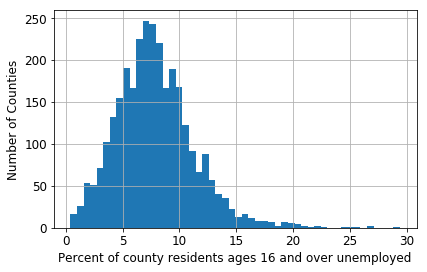

In [185]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctUnemployed16_Over'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents ages 16 and over unemployed", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctUnemployed16_Over_dist.png')

In [186]:
pct_unemployed_16_over = cancer.sort_values(by='PctUnemployed16_Over').PctUnemployed16_Over
pct_unemployed_16_over.head()

Geography
Douglas County, South Dakota    0.4
Potter County, South Dakota     0.5
Chase County, Nebraska          0.7
Divide County, North Dakota     0.7
Brown County, Nebraska          0.7
Name: PctUnemployed16_Over, dtype: float64

In [187]:
pct_unemployed_16_over.tail()

Geography
Quitman County, Mississippi      25.3
Todd County, South Dakota        25.4
Humphreys County, Mississippi    26.8
Crowley County, Colorado         27.0
Corson County, South Dakota      29.4
Name: PctUnemployed16_Over, dtype: float64

There is a moderately strong correlation of 0.38 between the percentage of county residents who were 16 years and older and unemployed and cancer mortality. This again shows the relationship between employment and cancer mortality, because as the percentage of unemployed individuals increases in a county, cancer mortality also increases.

Adding a logarithmic or exponential transformation of 'PctUnemployed16_Over' did not add to the accuracy of the overall model.

In [188]:
r_PctUnemployed16_Over = pearson_r(cancer['PctUnemployed16_Over'], cancer['TARGET_deathRate'])
r_PctUnemployed16_Over

0.3784124421389391

In [189]:
cov_matrix_PctUnemployed16_Over = np.cov(cancer['PctUnemployed16_Over'], cancer['TARGET_deathRate'])
cov_matrix_PctUnemployed16_Over

array([[ 11.91886401,  36.25513104],
       [ 36.25513104, 770.14638047]])

## 'PctPrivateCoverage': Percent of county residents with private health coverage

The percentage of county residents with private health coverage ranges from 22.3% to 92.3%, and has a mean value of 64.4% with a standard deviation of 10.6%. The counties with the lowest percentage of county residents with private health coverage were in South Dakota, Texas, and New Mexico. The counties with the highest percentage were in South Dakota, North Dakota, Colorado, New Mexico and Virginia.

In [190]:
cancer.describe().PctPrivateCoverage

count    3047.000000
mean       64.354939
std        10.647057
min        22.300000
25%        57.200000
50%        65.100000
75%        72.100000
max        92.300000
Name: PctPrivateCoverage, dtype: float64

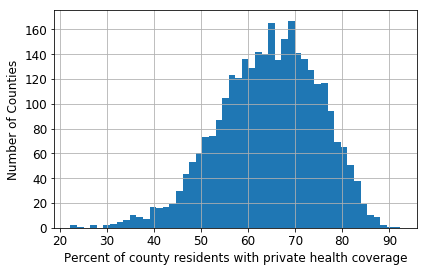

In [191]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctPrivateCoverage'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents with private health coverage", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctPrivateCoverage_dist.png')

In [192]:
pct_private_coverage = cancer.sort_values(by='PctPrivateCoverage').PctPrivateCoverage
pct_private_coverage.head()

Geography
Todd County, South Dakota      22.3
Starr County, Texas            23.4
McKinley County, New Mexico    25.0
Willacy County, Texas          27.2
Mora County, New Mexico        27.8
Name: PctPrivateCoverage, dtype: float64

In [193]:
pct_private_coverage.tail()

Geography
Lincoln County, South Dakota     88.0
Sargent County, North Dakota     88.8
Douglas County, Colorado         88.9
Los Alamos County, New Mexico    89.6
Falls Church city, Virginia      92.3
Name: PctPrivateCoverage, dtype: float64

There is a moderate negative correlation of -0.39 between the percentage of county residents with private health coverage and cancer mortality. Although a causative link can't be made between the two, a county's cancer mortality rate decreases as the percentage of residents in a county with private health coverage increases. 

In [194]:
r_PctPrivateCoverage = pearson_r(cancer['PctPrivateCoverage'], cancer['TARGET_deathRate'])
r_PctPrivateCoverage

-0.3860655067538743

In [195]:
cov_matrix_PctPrivateCoverage = np.cov(cancer['PctPrivateCoverage'], cancer['TARGET_deathRate'])
cov_matrix_PctPrivateCoverage

array([[ 113.35981719, -114.07151482],
       [-114.07151482,  770.14638047]])

One can see the negative correlation between the percentage of county residents with private health coverage and cancer mortality in the prediction line below. Adding the logarithmic transformation of 'PctPrivateCoverage' reduces the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.008.

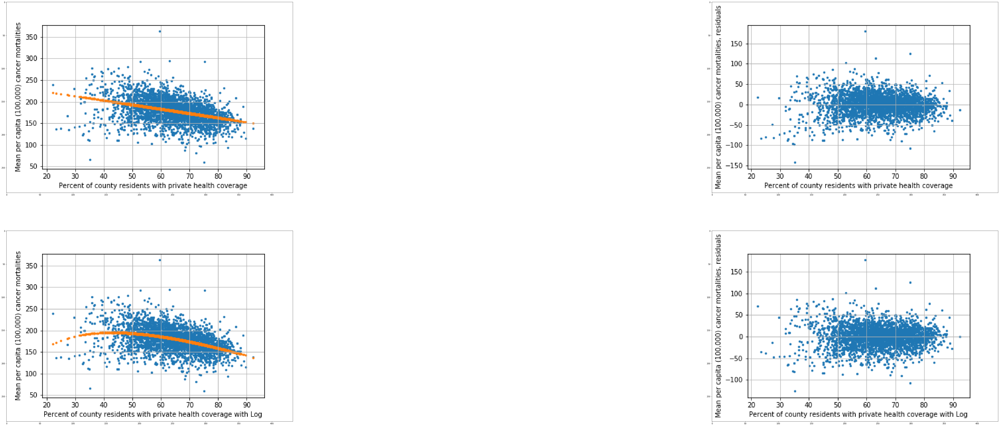

In [196]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_20_ap = plt.imread("PctPrivateCoverage_actual_&_predicted_Y.png")
implot_20_ap = plt.imshow(im_20_ap)
plt.subplot(2, 2, 2)
im_20_r = plt.imread("PctPrivateCoverage_residuals.png")
implot_20_r = plt.imshow(im_20_r)
plt.subplot(2, 2, 3)
im_20_l = plt.imread("PctPrivateCoverage_Log_actual_&_predicted_Y.png")
implot_20_l = plt.imshow(im_20_l)
plt.subplot(2, 2, 4)
im_20_lres = plt.imread("PctPrivateCoverage_log_residuals.png")
implot_20_lres = plt.imshow(im_20_lres)

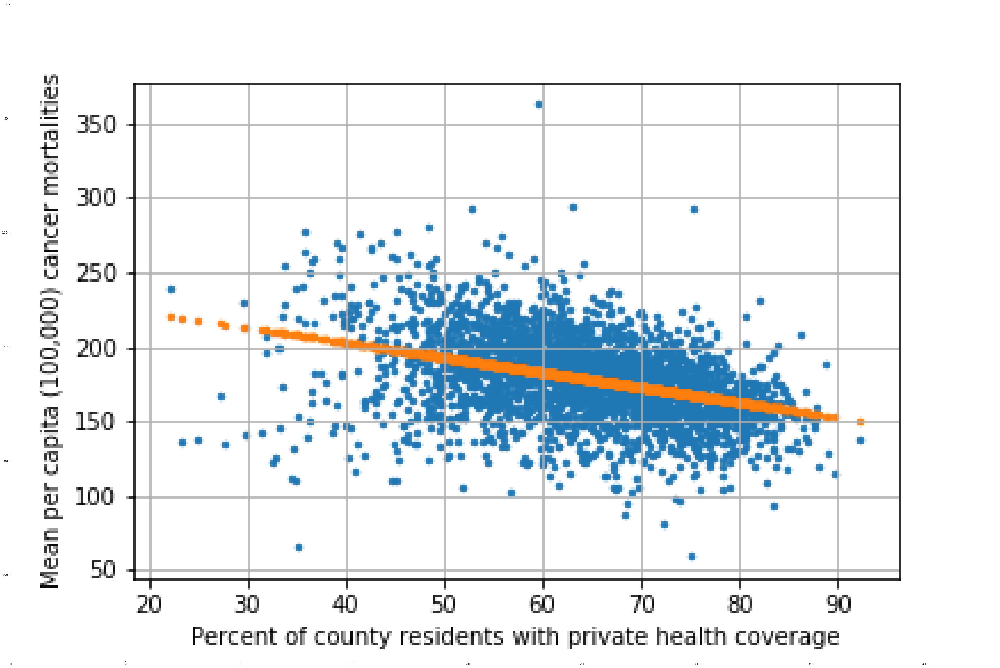

In [197]:
im_20_ap = plt.imread("PctPrivateCoverage_actual_&_predicted_Y.png")
implot_20_ap = plt.imshow(im_20_ap)

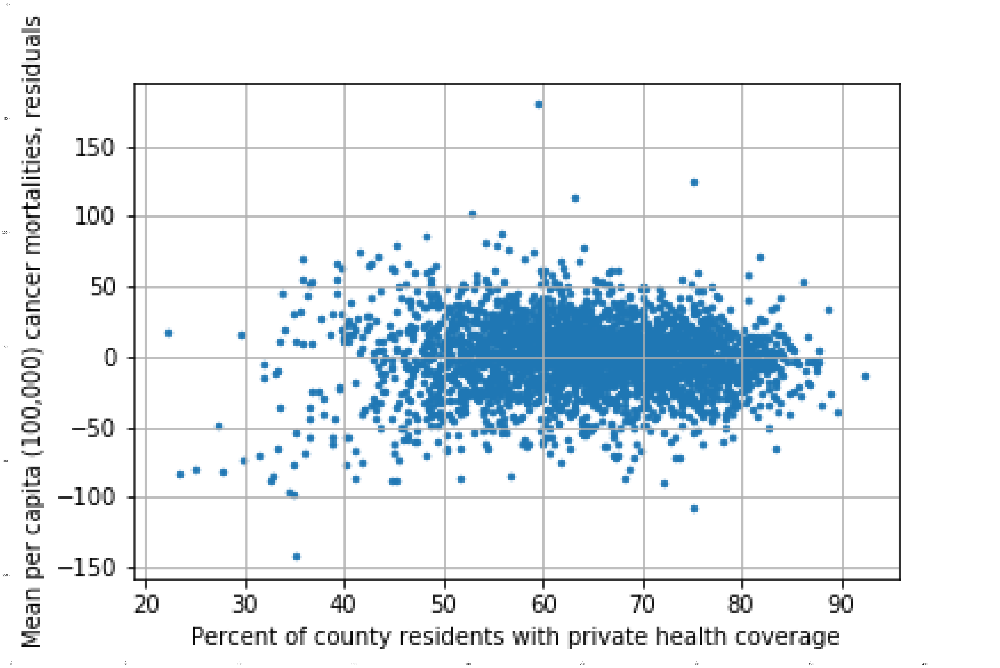

In [198]:
im_20_r = plt.imread("PctPrivateCoverage_residuals.png")
implot_20_r = plt.imshow(im_20_r)

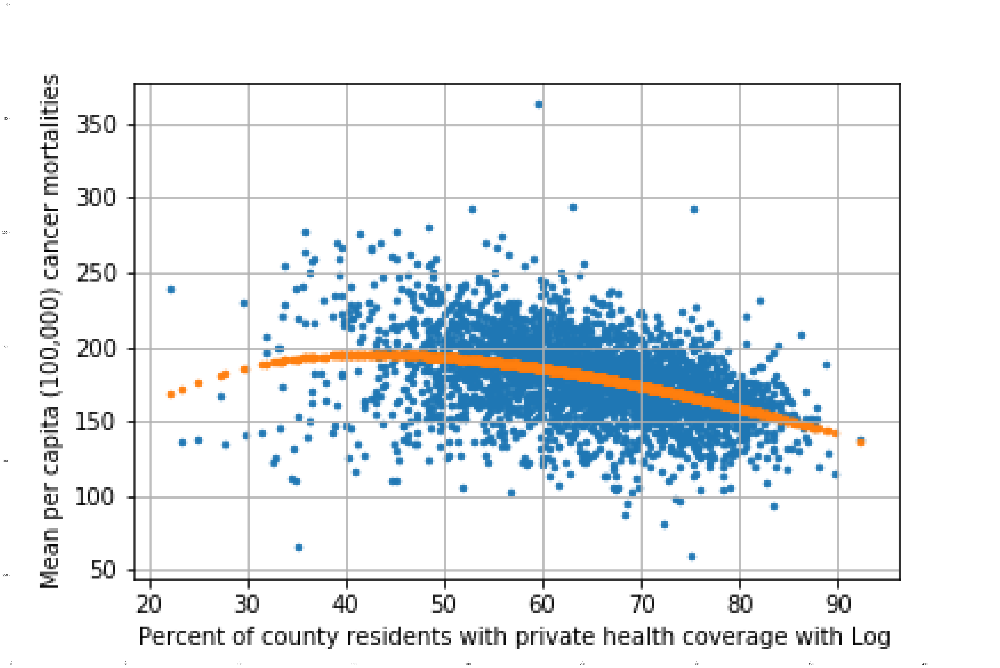

In [199]:
im_20_l = plt.imread("PctPrivateCoverage_Log_actual_&_predicted_Y.png")
implot_20_l = plt.imshow(im_20_l)

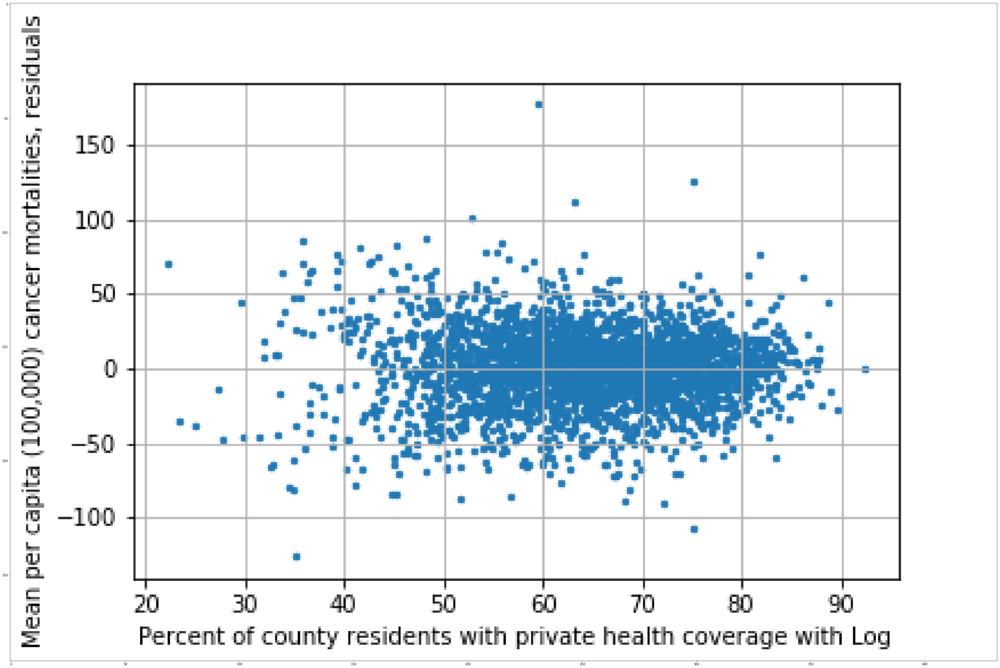

In [200]:
im_20_lres = plt.imread("PctPrivateCoverage_log_residuals.png")
implot_20_lres = plt.imshow(im_20_lres)

## 'PctPrivateCoverageAlone': Percent of county residents with private health coverage alone (no public assistance)

The percentage of county residents with private health coverage alone ranges from 15.7% to 78.9%, and has a mean value of 48.5% with a standard deviation of 9%. The high peak at the center of the distribution comes from the fact that 20% of the counties had missing values for 'PctPrivateCoverageAlone' and were filled with the nationwide median value. The counties with the lowest percentage of county residents with private health coverage alone were in South Dakota, New Mexico, Texas and Georgia. The counties with the highest percentage were in Ohio, Minnesota, Virginia and Colorado.

In [201]:
cancer.describe().PctPrivateCoverageAlone

count    3047.000000
mean       48.502987
std         9.019423
min        15.700000
25%        43.100000
50%        48.700000
75%        53.800000
max        78.900000
Name: PctPrivateCoverageAlone, dtype: float64

Text(0, 0.5, 'Number of Counties')

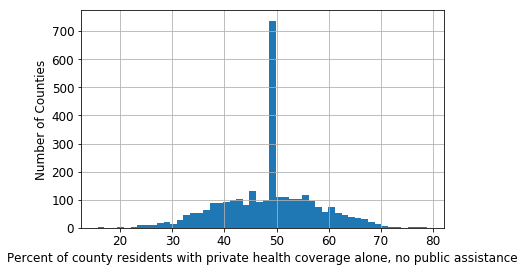

In [202]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctPrivateCoverageAlone'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents with private health coverage alone, no public assistance", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [203]:
Pct_Private_Coverage_Alone = cancer.sort_values(by='PctPrivateCoverageAlone').PctPrivateCoverageAlone
Pct_Private_Coverage_Alone.head()

Geography
Todd County, South Dakota      15.7
Mora County, New Mexico        16.8
McKinley County, New Mexico    19.6
Willacy County, Texas          20.7
Clay County, Georgia           22.2
Name: PctPrivateCoverageAlone, dtype: float64

In [204]:
Pct_Private_Coverage_Alone.tail()

Geography
Delaware County, Ohio          76.5
Carver County, Minnesota       76.6
Loudoun County, Virginia       77.1
Falls Church city, Virginia    78.2
Douglas County, Colorado       78.9
Name: PctPrivateCoverageAlone, dtype: float64

There is a moderate negative correlation of -0.33 between the percentage of county residents with only private health coverage and cancer mortality. Although a causative link can't be made between the two, a county's cancer mortality level decreases the more the percentage of residents in a county who have private health coverage alone increases.

Adding a logarithmic or exponential expansion of 'PctPrivateCoverageAlone' did not add to the model's overall accuracy. 

In [205]:
r_PctPrivateCoverageAlone = pearson_r(cancer['PctPrivateCoverageAlone'], cancer['TARGET_deathRate'])
r_PctPrivateCoverageAlone

-0.32619500798488693

In [206]:
cov_matrix_PctPrivateCoverageAlone = np.cov(cancer['PctPrivateCoverageAlone'], cancer['TARGET_deathRate'])
cov_matrix_PctPrivateCoverageAlone

array([[ 81.34998779, -81.64746322],
       [-81.64746322, 770.14638047]])

## 'PctEmpPrivCoverage': Percent of county residents with employee-provided private health coverage

The percentage of county residents with employee-provided private health coverage ranges from 13.5% to 70.7%, and has a mean value of 41.2% with a standard deviation of 9.5%. The counties with the lowest percentages of county residents with employee-provided private health coverage were in South Dakota, New Mexico, Texas, and Missouri. The counties with the highest percentages were in Indiana, Virginia, Colorado and Ohio.

In [207]:
cancer.describe().PctEmpPrivCoverage

count    3047.000000
mean       41.196324
std         9.447687
min        13.500000
25%        34.500000
50%        41.100000
75%        47.700000
max        70.700000
Name: PctEmpPrivCoverage, dtype: float64

Text(0, 0.5, 'Number of Counties')

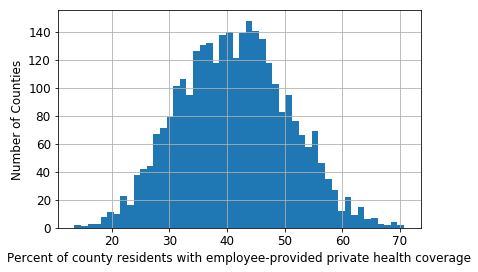

In [208]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctEmpPrivCoverage'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents with employee-provided private health coverage", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [209]:
pct_emp_priv_coverage = cancer.sort_values(by='PctEmpPrivCoverage').PctEmpPrivCoverage
pct_emp_priv_coverage.head()

Geography
Todd County, South Dakota      13.5
Mora County, New Mexico        14.3
San Augustine County, Texas    15.0
Pulaski County, Missouri       16.3
McKinley County, New Mexico    16.8
Name: PctEmpPrivCoverage, dtype: float64

In [210]:
pct_emp_priv_coverage.tail()

Geography
Hamilton County, Indiana       68.8
Loudoun County, Virginia       68.9
Douglas County, Colorado       69.2
Delaware County, Ohio          70.2
Falls Church city, Virginia    70.7
Name: PctEmpPrivCoverage, dtype: float64

There is a moderate negative correlation of -0.27 between the percentage of county residents with employee-provided private health coverage and cancer mortality. Although a causative link can't be made between the two, a county's cancer mortality level decreases the more the percentage of residents in a county who have employee-provided private health coverage increases. Intriguingly, this negative correlation is weaker than what is seen with private health coverage and private health coverage alone, which possibly shows that employee-provided health insurance is not as effective as other forms of private health insurance. This is definitely an area for future research.

In [211]:
r_PctEmpPrivCoverage = pearson_r(cancer['PctEmpPrivCoverage'], cancer['TARGET_deathRate'])
r_PctEmpPrivCoverage

-0.2673994281604379

In [212]:
cov_matrix_PctEmpPrivCoverage = np.cov(cancer['PctEmpPrivCoverage'], cancer['TARGET_deathRate'])
cov_matrix_PctEmpPrivCoverage

array([[ 89.25879804, -70.10881566],
       [-70.10881566, 770.14638047]])

One can see the weakly negative correlation between the percentage of employee-provided private health coverage and cancer mortality in the prediction line below. Adding the logarithmic transformation of 'PctEmpPrivCoverage' reduces the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.0008.

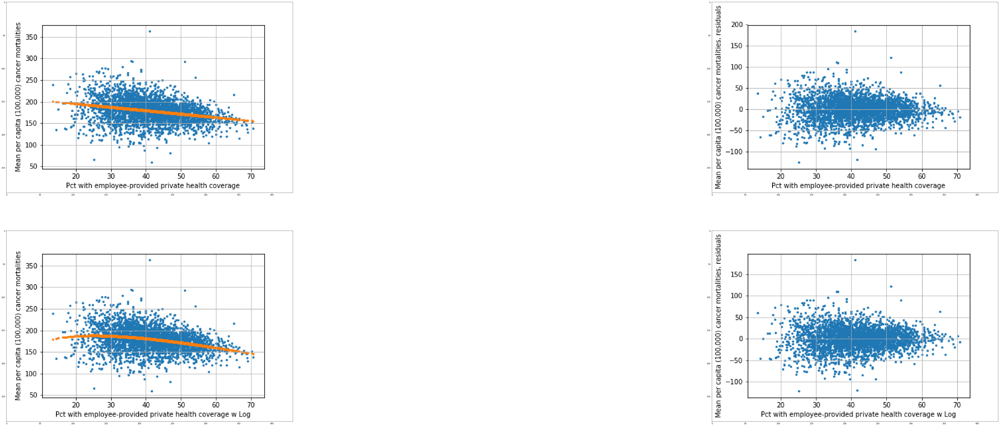

In [213]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_22_ap = plt.imread("PctEmpPrivCoverage_actual_&_predicted_Y.png")
implot_22_ap = plt.imshow(im_22_ap)
plt.subplot(2, 2, 2)
im_22_r = plt.imread("PctEmpPrivCoverage_residuals.png")
implot_22_r = plt.imshow(im_22_r)
plt.subplot(2, 2, 3)
im_22_l = plt.imread("PctEmpPrivCoverage_Log_actual_&_predicted_Y.png")
implot_22_l = plt.imshow(im_22_l)
plt.subplot(2, 2, 4)
im_22_lres = plt.imread("PctEmpPrivCoverage_Log_residuals.png")
implot_22_lres = plt.imshow(im_22_lres)

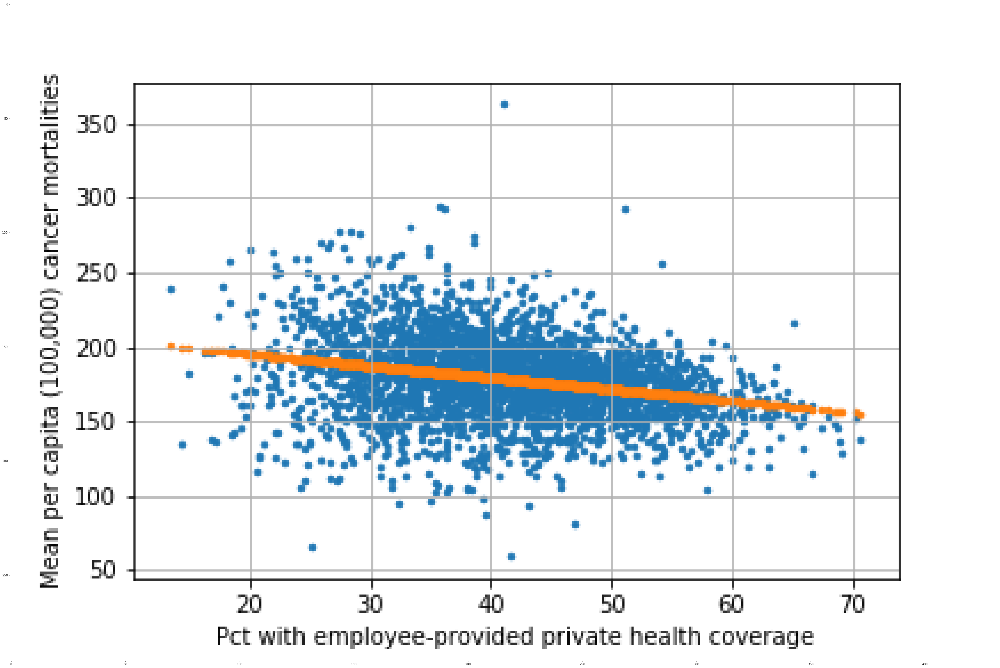

In [214]:
im_22_ap = plt.imread("PctEmpPrivCoverage_actual_&_predicted_Y.png")
implot_22_ap = plt.imshow(im_22_ap)

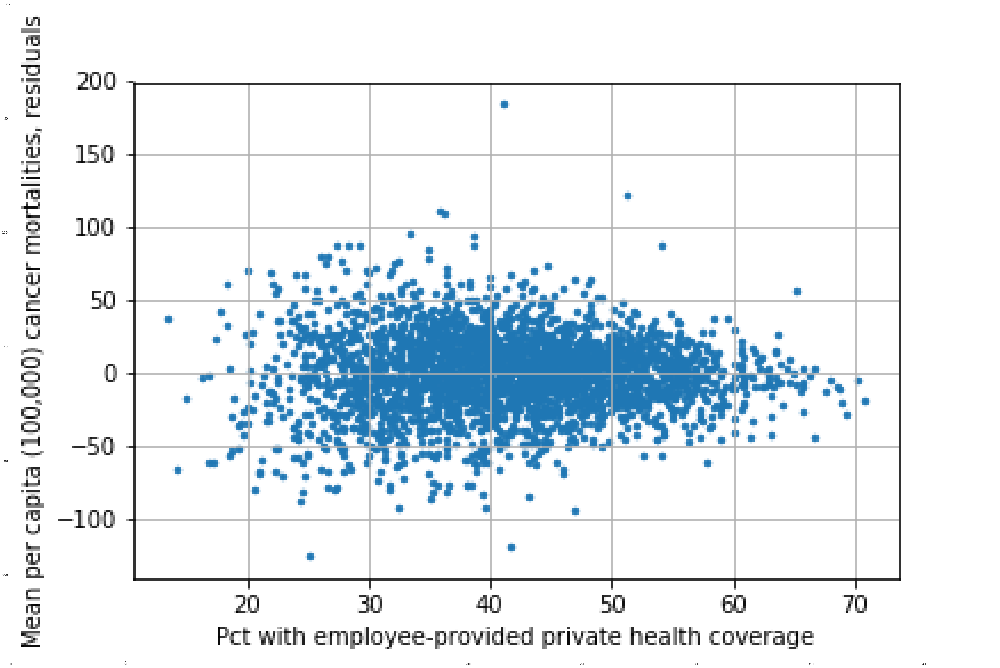

In [215]:
im_22_r = plt.imread("PctEmpPrivCoverage_residuals.png")
implot_22_r = plt.imshow(im_22_r)

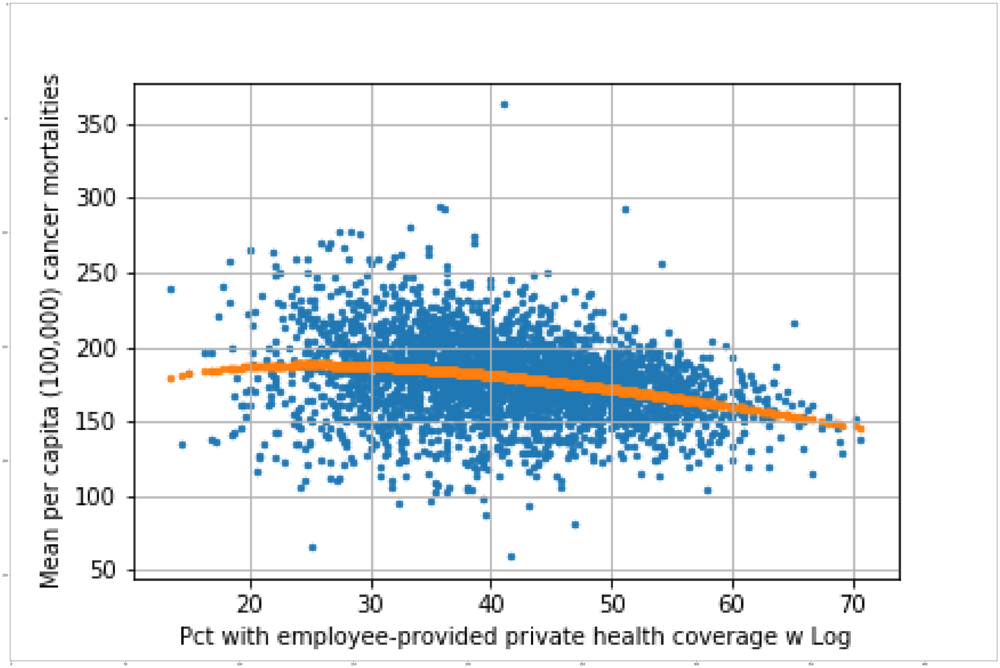

In [216]:
im_22_l = plt.imread("PctEmpPrivCoverage_Log_actual_&_predicted_Y.png")
implot_22_l = plt.imshow(im_22_l)

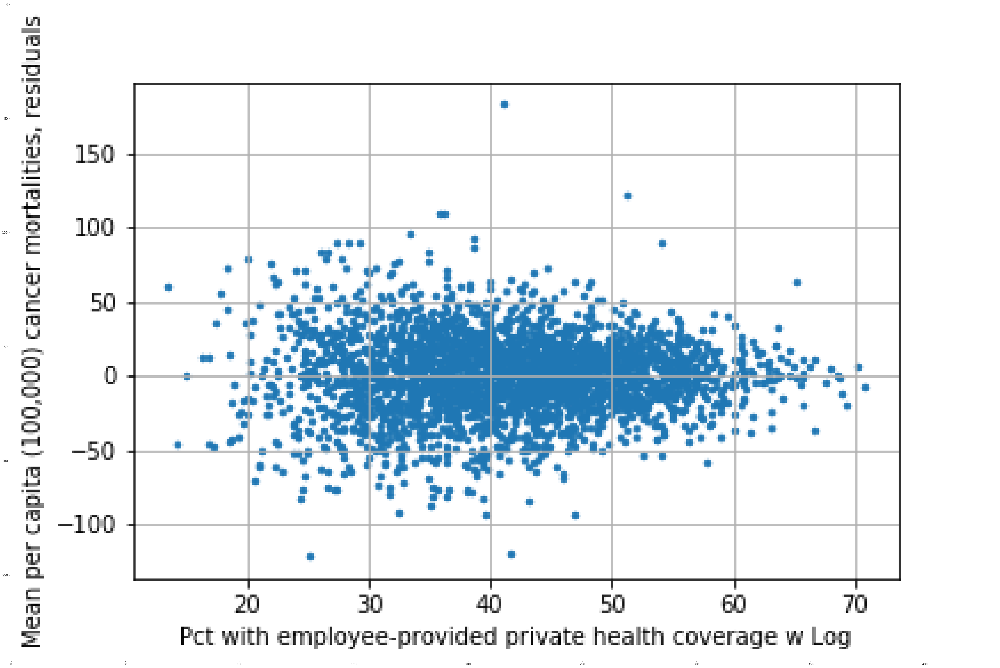

In [217]:
im_22_lres = plt.imread("PctEmpPrivCoverage_Log_residuals.png")
implot_22_lres = plt.imshow(im_22_lres)

## 'PctPublicCoverage': Percent of county residents with government-provided health coverage

The percentage of county residents with government-provided health coverage ranges from 11.2% to 65.1%, and has a mean value of 36.3% with a standard deviation of 7.8%. The counties with the lowest percentage of county residents with government-provided health coverage were in Alaska, Virginia, Utah, and Colorado. The counties with the highest percentage were in West Virginia, Kentucky, Arizona, New Mexico, and Florida.

In [218]:
cancer.describe().PctPublicCoverage

count    3047.000000
mean       36.252642
std         7.841741
min        11.200000
25%        30.900000
50%        36.300000
75%        41.550000
max        65.100000
Name: PctPublicCoverage, dtype: float64

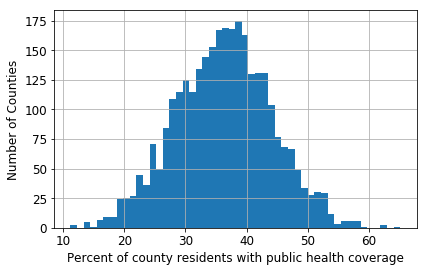

In [220]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctPublicCoverage'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents with public health coverage", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctPublicCoverage_dist.png')

In [221]:
pct_public_coverage = cancer.sort_values(by='PctPublicCoverage').PctPublicCoverage
pct_public_coverage.head()

Geography
Aleutians West Census Area, Alaska    11.2
Loudoun County, Virginia              11.8
Summit County, Utah                   13.5
Falls Church city, Virginia           13.5
Douglas County, Colorado              13.8
Name: PctPublicCoverage, dtype: float64

In [222]:
pct_public_coverage.tail()

Geography
McDowell County, West Virginia    58.5
Owsley County, Kentucky           59.3
La Paz County, Arizona            62.2
Mora County, New Mexico           62.7
Sumter County, Florida            65.1
Name: PctPublicCoverage, dtype: float64

There is a moderately strong positive correlation of 0.41 between the percentage of county residents with public health coverage and cancer mortality. Therefore, as the percentage of county residents with public health coverage increases, cancer mortality increases. This is in marked opposition to the negative correlation between the percentage of county residents with private health coverage and cancer mortality. This is an important finding that bolsters the need for further research into this connection and for better public health insurance generally.

In [223]:
r_PctPublicCoverage = pearson_r(cancer['PctPublicCoverage'], cancer['TARGET_deathRate'])
r_PctPublicCoverage

0.4045716562932601

In [224]:
cov_matrix_PctPublicCoverage = np.cov(cancer['PctPublicCoverage'], cancer['TARGET_deathRate'])
cov_matrix_PctPublicCoverage

array([[ 61.49290093,  88.04294954],
       [ 88.04294954, 770.14638047]])

One can see the moderately positive correlation between the percentage of county residents with public health coverage and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic transformation of 'PctPublicCoverage' is added, and doing so increased the model's accuracy by 0.0002.

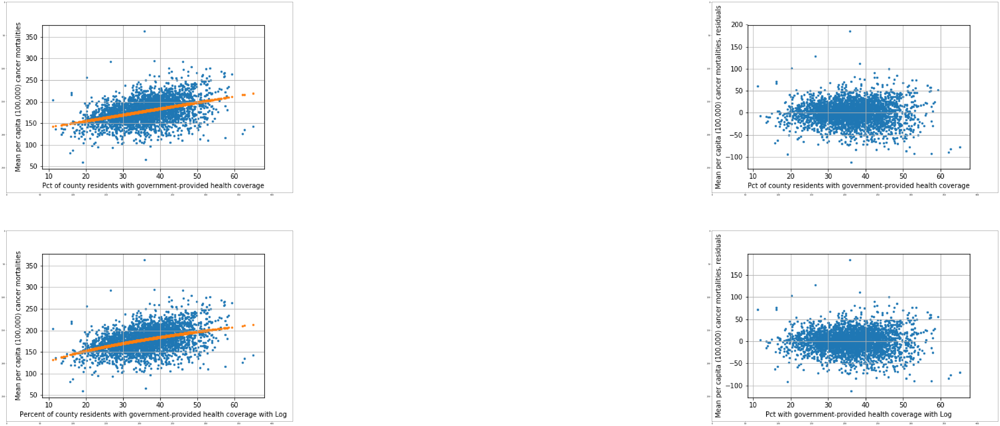

In [225]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_23_ap = plt.imread("PctPublicCoverage_actual_&_predicted_Y.png")
implot_23_ap = plt.imshow(im_23_ap)
plt.subplot(2, 2, 2)
im_23_r = plt.imread("PctPublicCoverage_residuals.png")
implot_23_r = plt.imshow(im_23_r)
plt.subplot(2, 2, 3)
im_23_l = plt.imread("PctPublicCoverage_log_actual_&_predicted_Y.png")
implot_23_l = plt.imshow(im_23_l)
plt.subplot(2, 2, 4)
im_23_lres = plt.imread("PctPublicCoverage_log_residuals.png")
implot_23_lres = plt.imshow(im_23_lres)

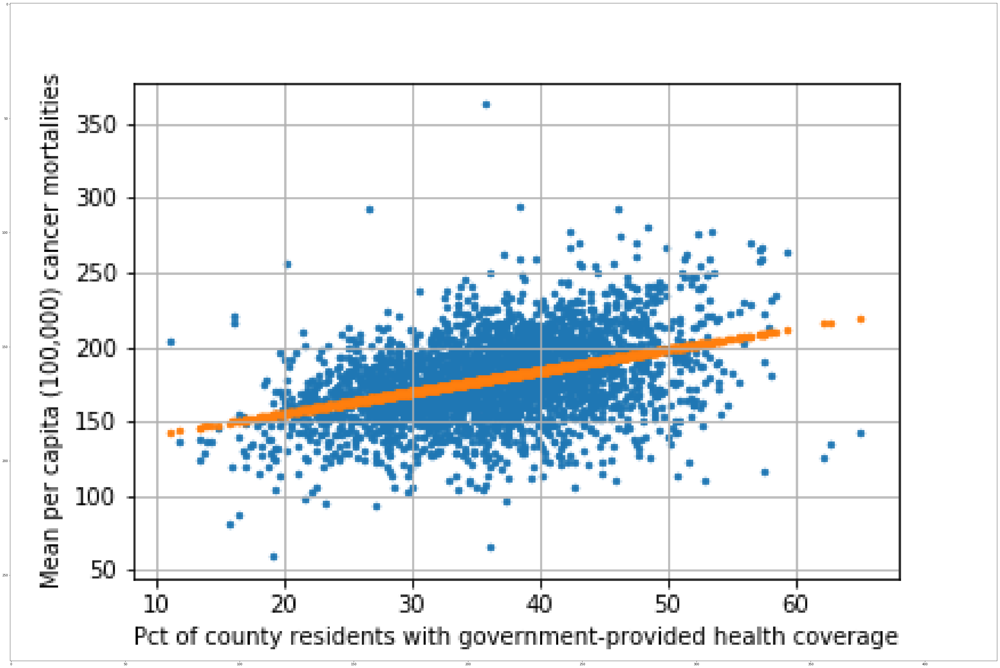

In [226]:
im_23_ap = plt.imread("PctPublicCoverage_actual_&_predicted_Y.png")
implot_23_ap = plt.imshow(im_23_ap)

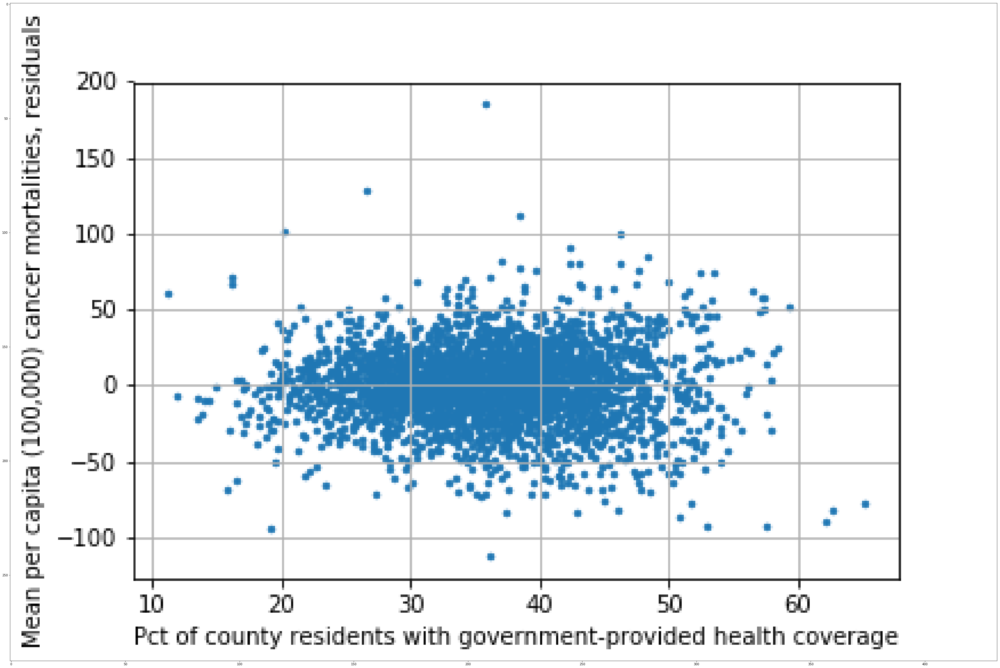

In [227]:
im_23_r = plt.imread("PctPublicCoverage_residuals.png")
implot_23_r = plt.imshow(im_23_r)

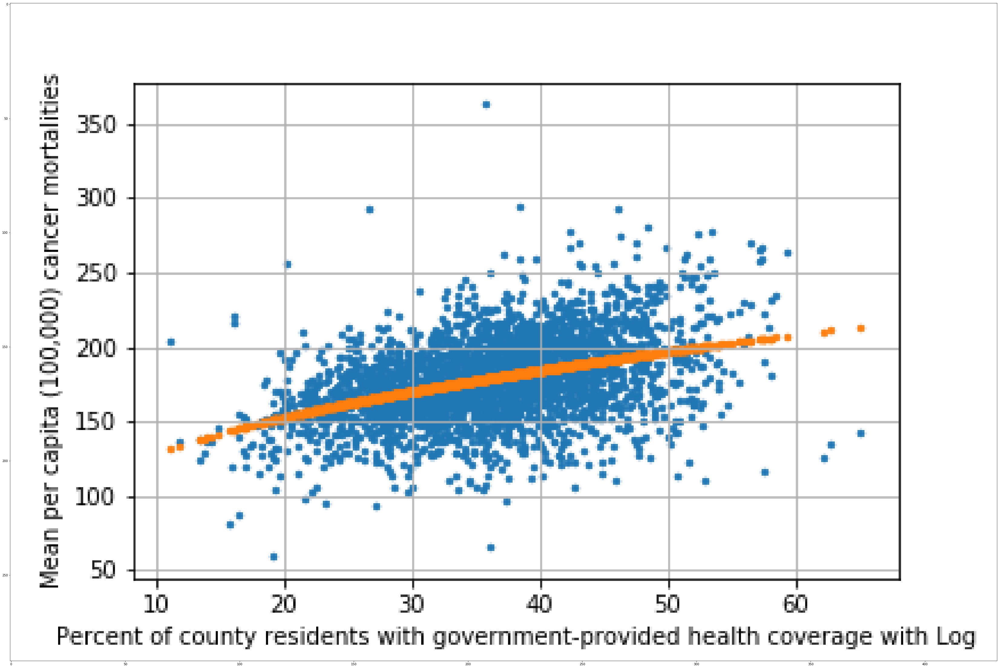

In [228]:
im_23_l = plt.imread("PctPublicCoverage_log_actual_&_predicted_Y.png")
implot_23_l = plt.imshow(im_23_l)

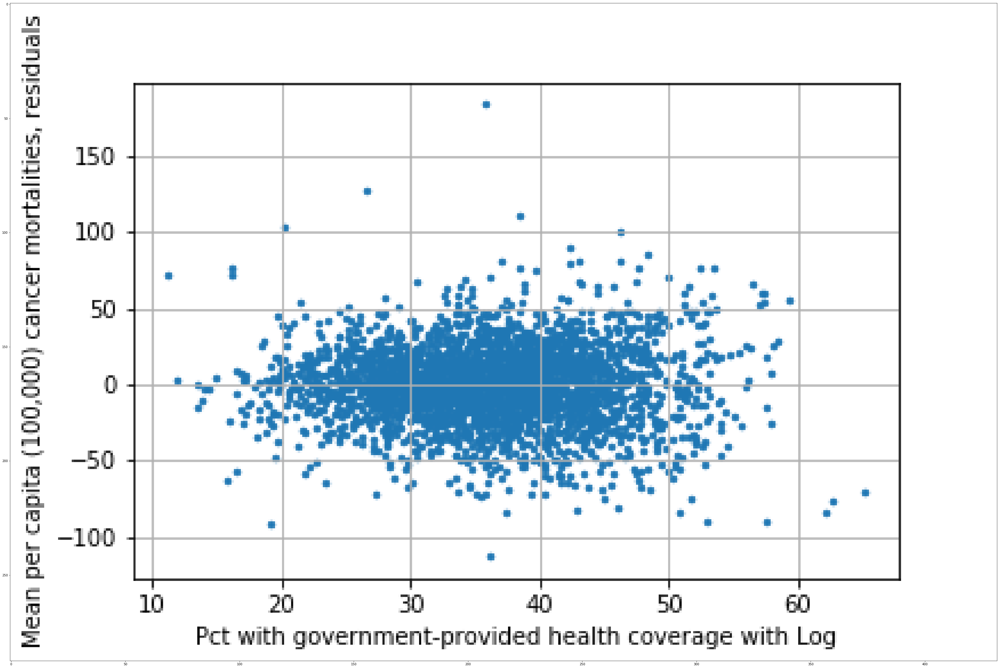

In [229]:
im_23_lres = plt.imread("PctPublicCoverage_log_residuals.png")
implot_23_lres = plt.imshow(im_23_lres)

## 'PctPublicCoverageAlone': Percent of county residents with government-provided health coverage alone

The percentage of county residents with government-provided health coverage alone ranges from 2.6% to 46.6%, and has a mean value of 19.2% with a standard deviation of 6.1%. The counties with the lowest percentage of county residents with government-provided health coverage alone were in Nevada, Virginia and New Mexico. The counties with the highest percentage were in South Dakota, Kentucky and New Mexico.

In [230]:
cancer.describe().PctPublicCoverageAlone

count    3047.000000
mean       19.240072
std         6.113041
min         2.600000
25%        14.850000
50%        18.800000
75%        23.100000
max        46.600000
Name: PctPublicCoverageAlone, dtype: float64

Text(0, 0.5, 'Number of Counties')

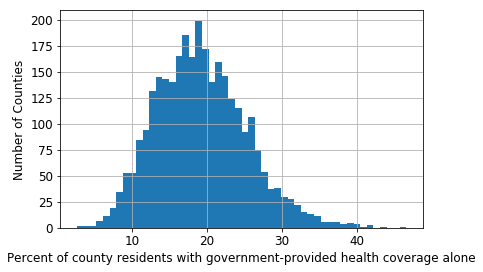

In [231]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctPublicCoverageAlone'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents with government-provided health coverage alone", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [232]:
pct_public_coverage_alone = cancer.sort_values(by='PctPublicCoverageAlone').PctPublicCoverageAlone
pct_public_coverage_alone.head()

Geography
Eureka County, Nevada            2.6
Falls Church city, Virginia      2.7
Los Alamos County, New Mexico    4.2
Arlington County, Virginia       4.2
Loudoun County, Virginia         4.6
Name: PctPublicCoverageAlone, dtype: float64

In [233]:
pct_public_coverage_alone.tail()

Geography
Corson County, South Dakota    41.4
Owsley County, Kentucky        41.4
Clay County, Kentucky          41.9
Todd County, South Dakota      43.3
Mora County, New Mexico        46.6
Name: PctPublicCoverageAlone, dtype: float64

The correlation between the percentage of county residents with public health coverage ALONE and cancer mortality is slightly higher than the correlation between the percentage of county residents with public health coverage and cancer mortality (0.45 vs. 0.41). This again shows that more research and action needs to be enacted in this area to improve public health insurance.

In [234]:
r_PctPublicCoverageAlone = pearson_r(cancer['PctPublicCoverageAlone'], cancer['TARGET_deathRate'])
r_PctPublicCoverageAlone

0.4493575757853325

In [235]:
cov_matrix_PctPublicCoverageAlone = np.cov(cancer['PctPublicCoverageAlone'], cancer['TARGET_deathRate'])
cov_matrix_PctPublicCoverageAlone

array([[ 37.36927025,  76.23177213],
       [ 76.23177213, 770.14638047]])

One can see the positive correlation between the percentage of county residents with public health coverage alone and cancer mortality in the prediction line below. Adding the logarithmic and exponential transformations of the percentage of county residents with public health coverage alone reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.003.

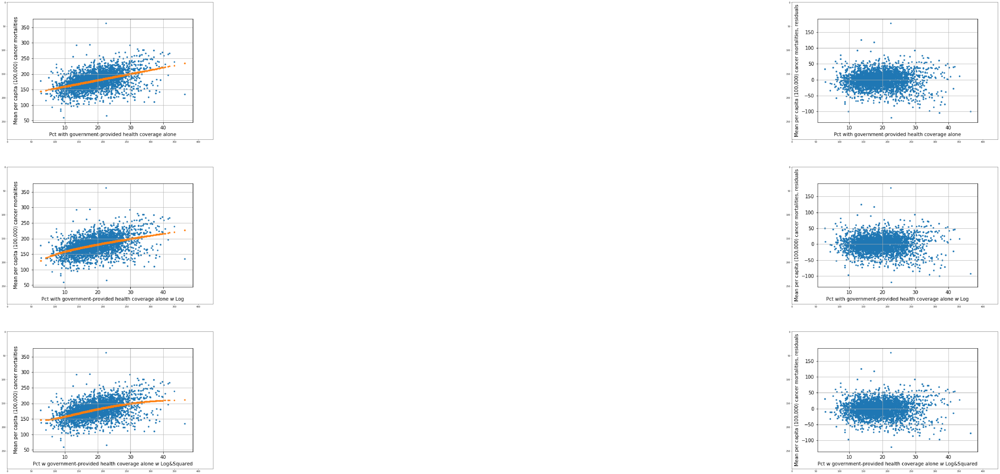

In [236]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(3, 2, 1)
im_24_ap = plt.imread("PctPublicCoverageAlone_actual_&_predicted_Y.png")
implot_24_ap = plt.imshow(im_24_ap)
plt.subplot(3, 2, 2)
im_24_r = plt.imread("PctPublicCoverageAlone_residuals.png")
implot_24_r = plt.imshow(im_24_r)
plt.subplot(3, 2, 3)
im_24_l = plt.imread("PctPublicCoverageAlone_Log_actual_&_predicted_Y.png")
implot_24_l = plt.imshow(im_24_l)
plt.subplot(3, 2, 4)
im_24_lres = plt.imread("PctPublicCoverageAlone_Log_residuals.png")
implot_24_lres = plt.imshow(im_24_lres)
plt.subplot(3, 2, 5)
im_24_l = plt.imread("PctPublicCoverageAlone_log_sqrd_actual_&_predicted_Y.png")
implot_24_l = plt.imshow(im_24_l)
plt.subplot(3, 2, 6)
im_24_lres = plt.imread("PctPublicCoverageAlone_log_sqrd_residuals.png")
implot_24_lres = plt.imshow(im_24_lres)

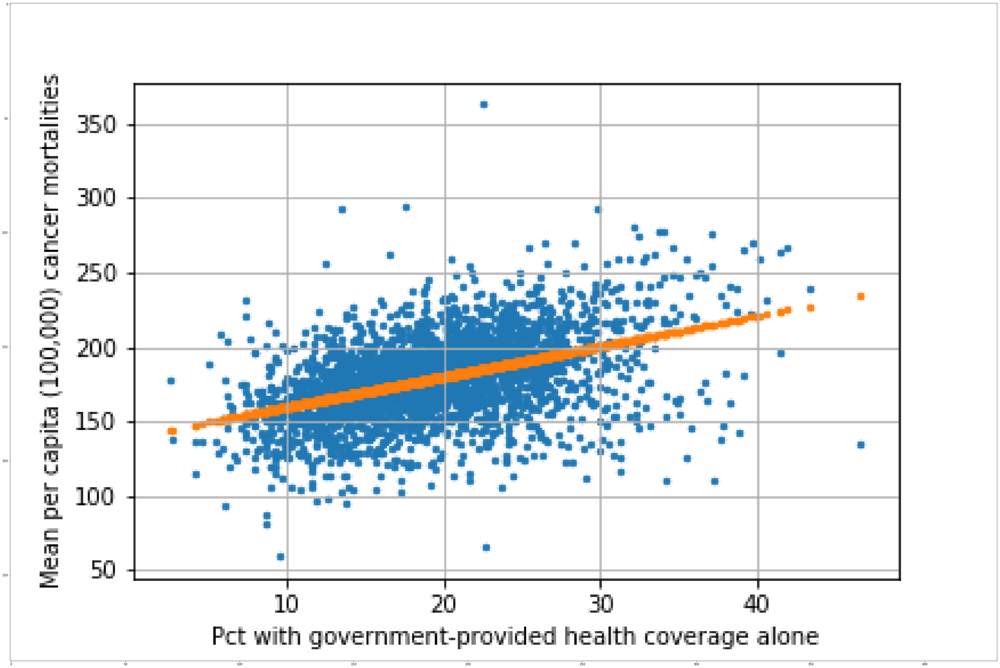

In [237]:
im_24_ap = plt.imread("PctPublicCoverageAlone_actual_&_predicted_Y.png")
implot_24_ap = plt.imshow(im_24_ap)

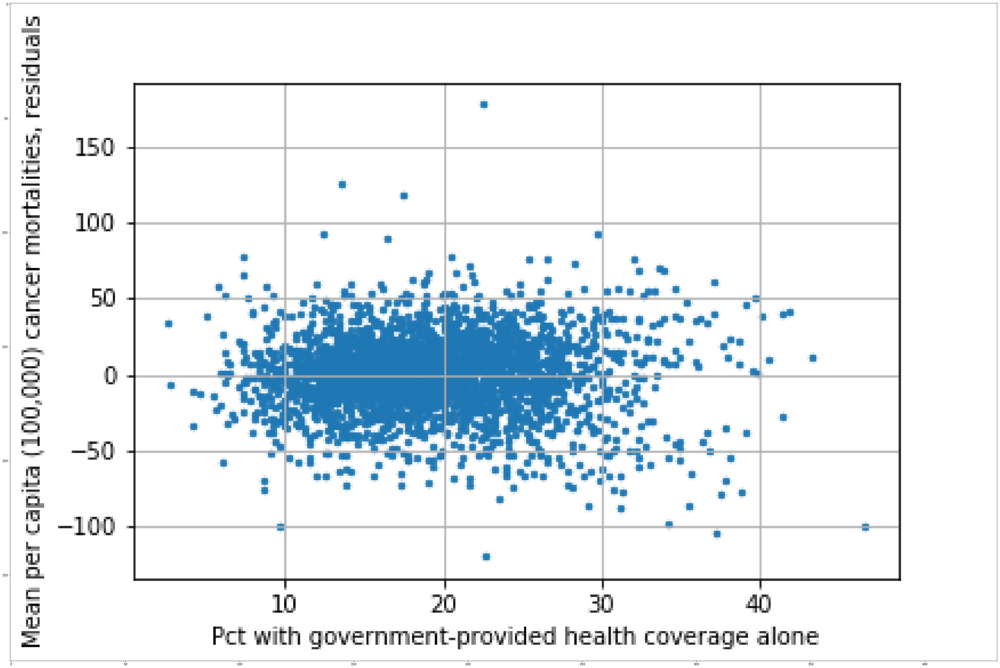

In [238]:
im_24_r = plt.imread("PctPublicCoverageAlone_residuals.png")
implot_24_r = plt.imshow(im_24_r)

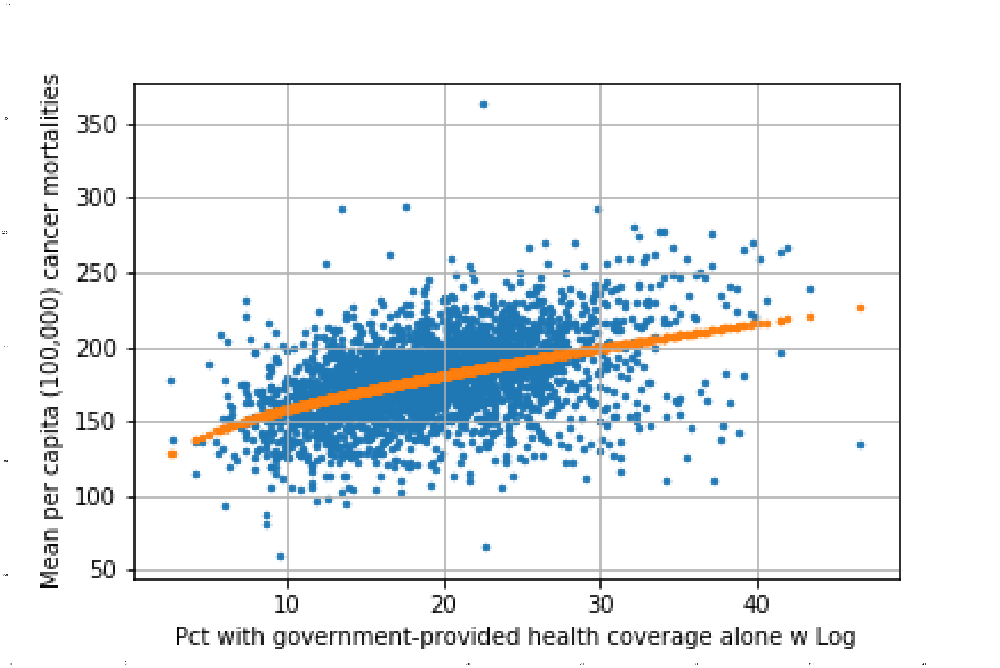

In [239]:
im_24_l = plt.imread("PctPublicCoverageAlone_Log_actual_&_predicted_Y.png")
implot_24_l = plt.imshow(im_24_l)

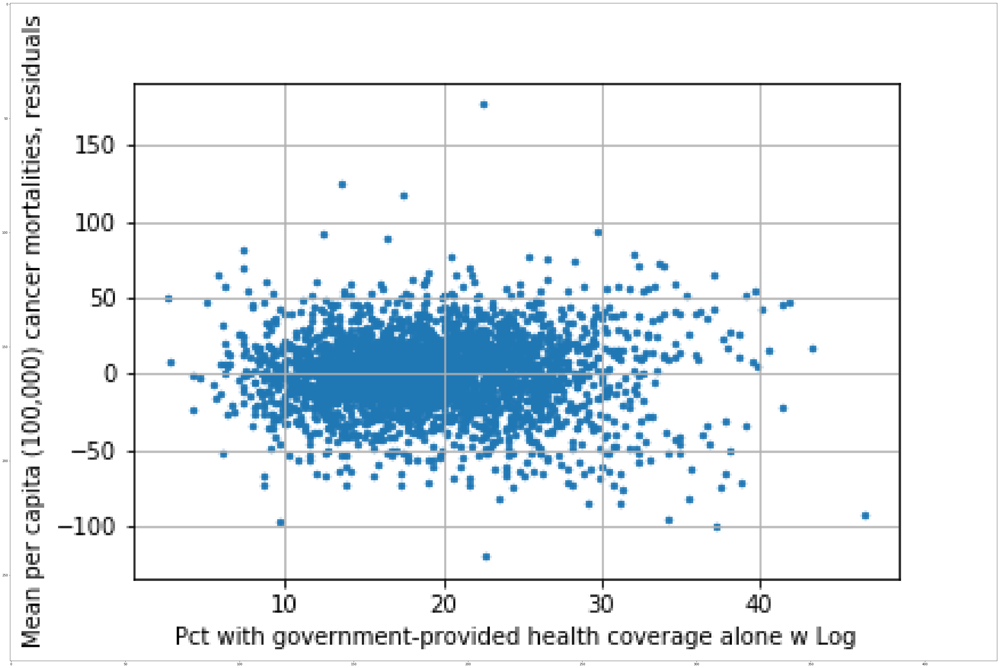

In [240]:
im_24_lres = plt.imread("PctPublicCoverageAlone_Log_residuals.png")
implot_24_lres = plt.imshow(im_24_lres)

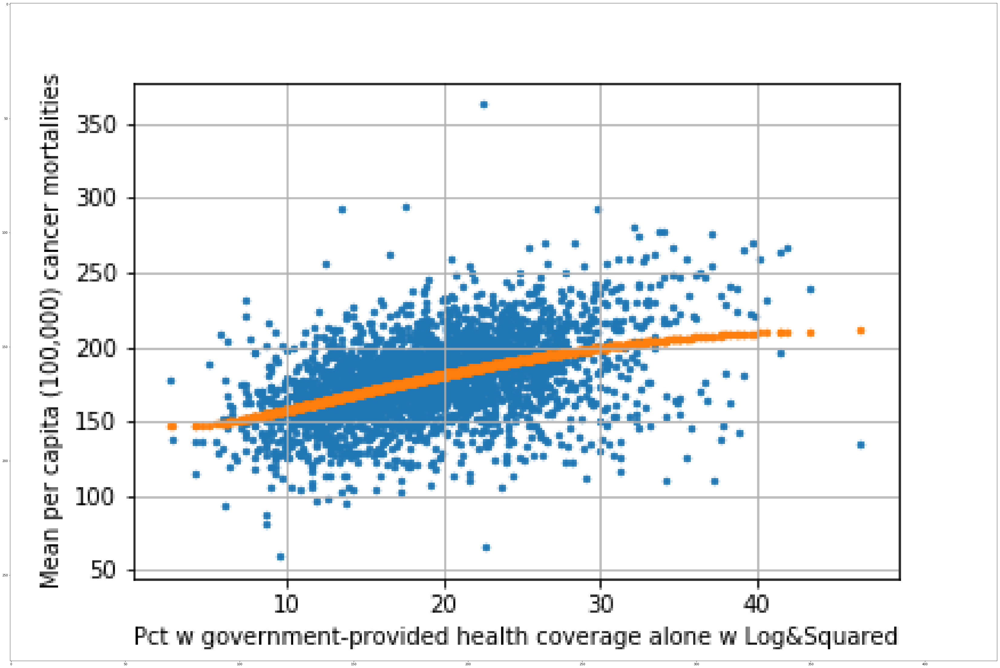

In [241]:
im_24_l = plt.imread("PctPublicCoverageAlone_log_sqrd_actual_&_predicted_Y.png")
implot_24_l = plt.imshow(im_24_l)

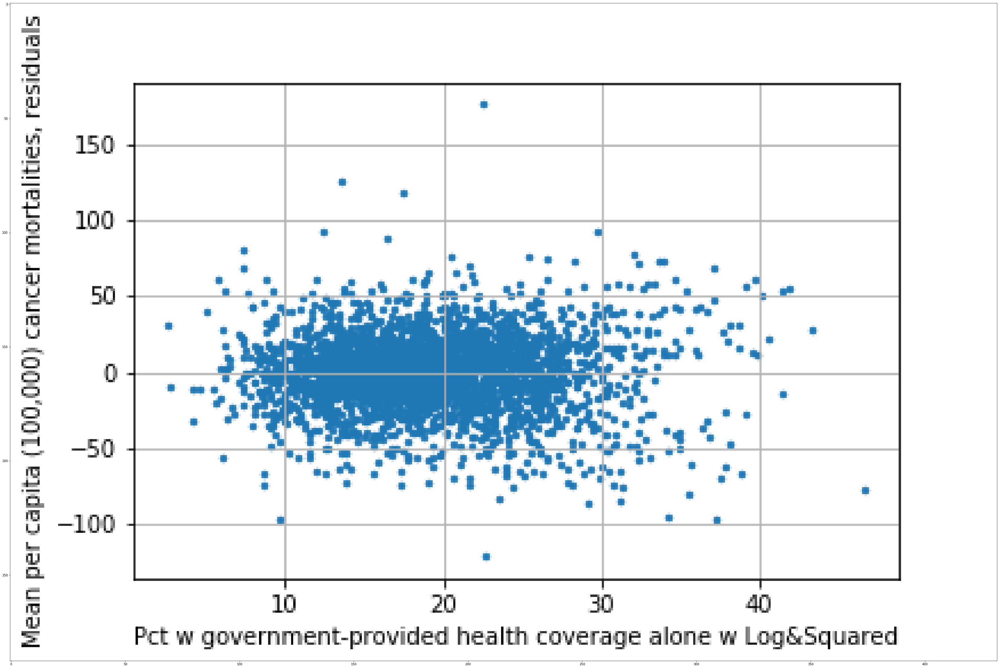

In [242]:
im_24_lres = plt.imread("PctPublicCoverageAlone_log_sqrd_residuals.png")
implot_24_lres = plt.imshow(im_24_lres)

## 'PctWhite': Percent of county residents who identify as White

The percentage of county residents who identify as White ranges from 10.2% to 100%, and has a mean value of 83.7% with a standard deviation of 16.4%. The counties with the lowest percentage of county residents who identify as White were in South Dakota, Wisconsin, Alaska and Mississippi. The counties with the highest percentage were in Nebraska, North Dakota, Kentucky and Montana.

In [243]:
cancer.describe().PctWhite

count    3047.000000
mean       83.645286
std        16.380025
min        10.199155
25%        77.296180
50%        90.059774
75%        95.451693
max       100.000000
Name: PctWhite, dtype: float64

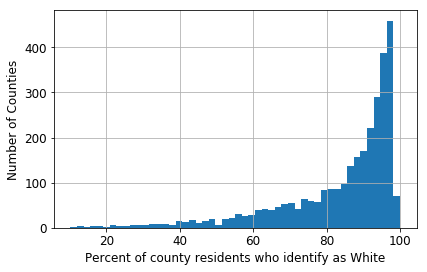

In [244]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctWhite'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents who identify as White", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctWhite_dist.png')

In [245]:
pct_white = cancer.sort_values(by='PctWhite').PctWhite
pct_white.head()

Geography
Todd County, South Dakota           10.199155
Menominee County, Wisconsin         11.008762
Bethel Census Area, Alaska          12.016202
Northwest Arctic Borough, Alaska    12.273668
Claiborne County, Mississippi       13.622722
Name: PctWhite, dtype: float64

In [246]:
pct_white.tail()

Geography
Nance County, Nebraska          99.615279
Steele County, North Dakota     99.646286
Jackson County, Kentucky        99.693045
Magoffin County, Kentucky       99.845905
Wibaux County, Montana         100.000000
Name: PctWhite, dtype: float64

There is a weak negative correlation of -0.18 between the percentage of county residents who identify as white and cancer mortality. This shows as the percentage of county residents who identify as "White" increases, cancer mortality slightly decreases.

In [247]:
r_PctWhite = pearson_r(cancer['PctWhite'], cancer['TARGET_deathRate'])
r_PctWhite

-0.17739998027523515

In [248]:
cov_matrix_PctWhite = np.cov(cancer['PctWhite'], cancer['TARGET_deathRate'])
cov_matrix_PctWhite

array([[268.30522651, -80.64078985],
       [-80.64078985, 770.14638047]])

One can see the weakly negative correlation between the percentage of county residents who identify as white and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformations of 'PctWhite' are added, and doing so increased the model's accuracy by 0.0003.

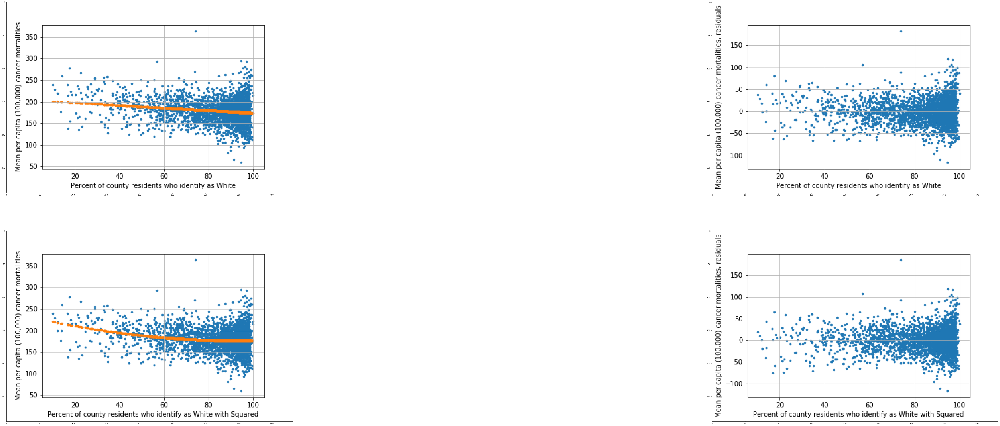

In [249]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_25_ap = plt.imread("PctWhite_actual_&_predicted_Y.png")
implot_25_ap = plt.imshow(im_25_ap)
plt.subplot(2, 2, 2)
im_25_r = plt.imread("PctWhite_residuals.png")
implot_25_r = plt.imshow(im_25_r)
plt.subplot(2, 2, 3)
im_25_sq = plt.imread("PctWhite_sqrd_actual_&_predicted_Y.png")
implot_25_sq = plt.imshow(im_25_sq)
plt.subplot(2, 2, 4)
im_25_sqres = plt.imread("PctWhite_sqrd_residuals.png")
implot_25_sqres = plt.imshow(im_25_sqres)

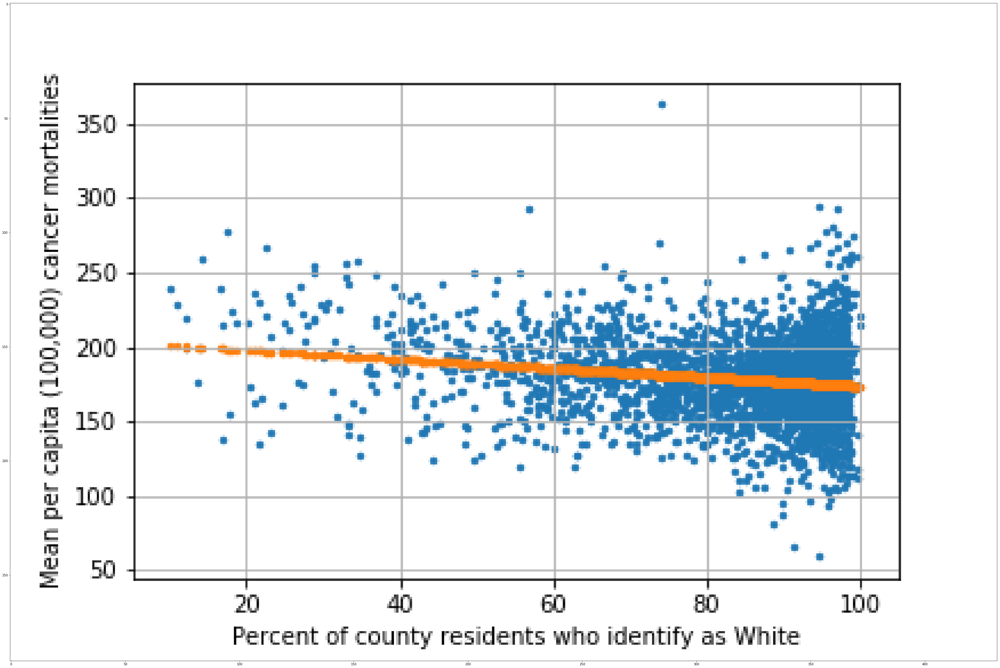

In [250]:
im_25_ap = plt.imread("PctWhite_actual_&_predicted_Y.png")
implot_25_ap = plt.imshow(im_25_ap)

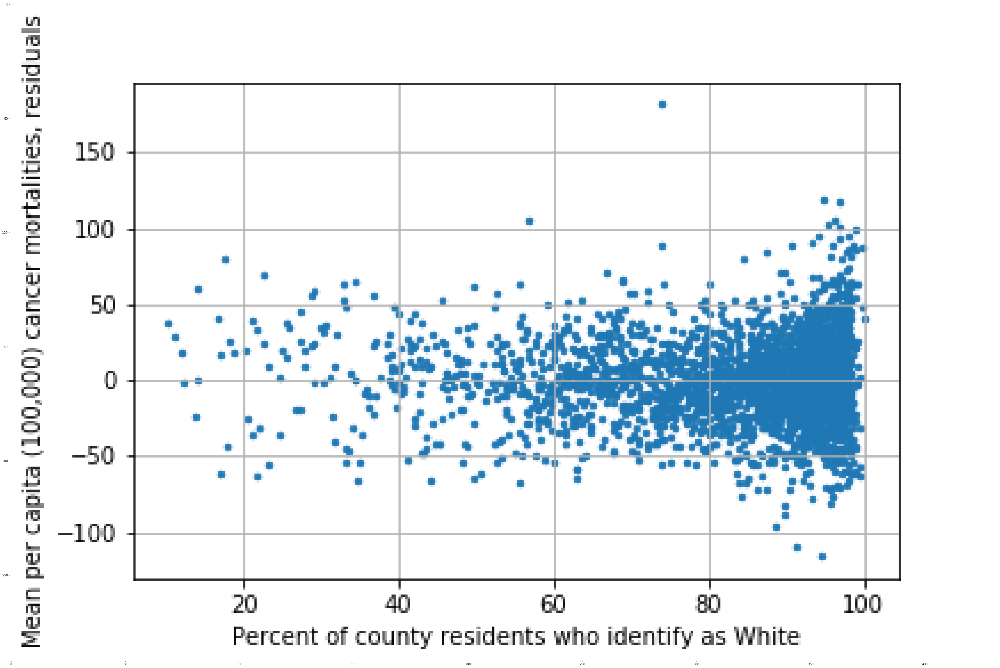

In [251]:
im_25_r = plt.imread("PctWhite_residuals.png")
implot_25_r = plt.imshow(im_25_r)

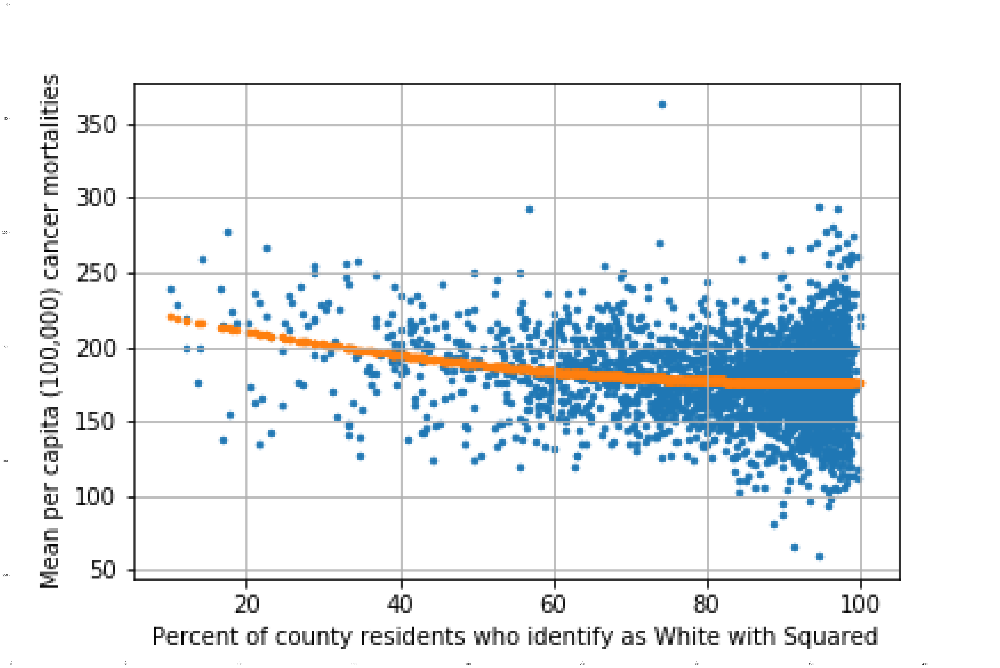

In [252]:
im_25_sq = plt.imread("PctWhite_sqrd_actual_&_predicted_Y.png")
implot_25_sq = plt.imshow(im_25_sq)

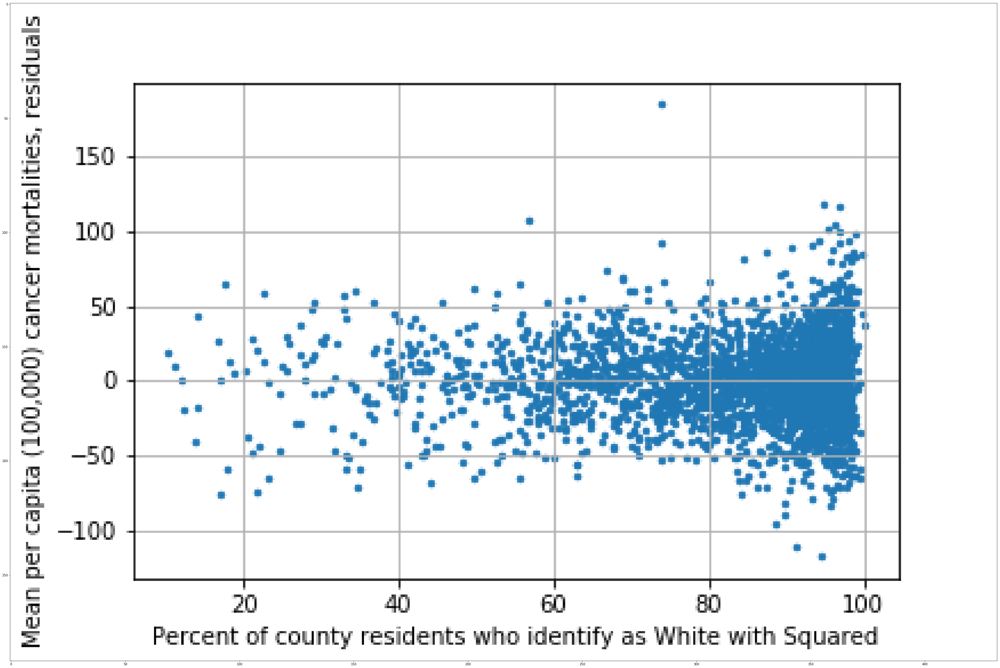

In [253]:
im_25_sqres = plt.imread("PctWhite_sqrd_residuals.png")
implot_25_sqres = plt.imshow(im_25_sqres)

## 'PctBlack': Percent of county residents who identify as Black

The percent of county residents who identify as Black ranges from zero to 86%, and has a mean value of 9.1% with a standard deviation of 14.5%. The counties with the lowest percentage of county residents who identify as Black were in New Mexico, Kansas, Illinois and Virginia. The counties with the highest percentage were in Alabama and Mississippi.

In [243]:
cancer.describe().PctBlack

count    3047.000000
mean        9.107978
std        14.534538
min         0.000000
25%         0.620675
50%         2.247576
75%        10.509732
max        85.947799
Name: PctBlack, dtype: float64

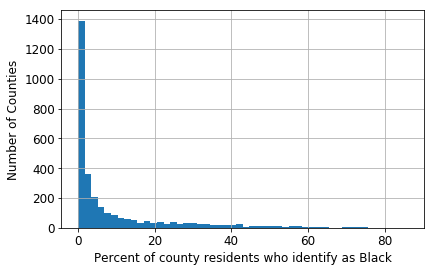

In [254]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctBlack'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents who identify as Black", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctBlack_dist.png')

In [245]:
pct_black = cancer.sort_values(by='PctBlack').PctBlack
pct_black.head()

Geography
De Baca County, New Mexico    0.0
Scott County, Kansas          0.0
Scott County, Illinois        0.0
Hodgeman County, Kansas       0.0
Highland County, Virginia     0.0
Name: PctBlack, dtype: float64

In [246]:
pct_black.tail()

Geography
Greene County, Alabama           80.659998
Macon County, Alabama            81.281846
Holmes County, Mississippi       82.559131
Claiborne County, Mississippi    84.866024
Jefferson County, Mississippi    85.947799
Name: PctBlack, dtype: float64

There is a positive correlation of 0.26 between the percentage of county residents who identify as Black and cancer mortality. This shows that as the percentage of county residents who identify as "Black" increases, cancer mortality increases.

In [247]:
r_PctBlack = pearson_r(cancer['PctBlack'], cancer['TARGET_deathRate'])
r_PctBlack

0.25702356046449165

In [248]:
cov_matrix_PctBlack = np.cov(cancer['PctBlack'], cancer['TARGET_deathRate'])
cov_matrix_PctBlack

array([[211.25279261, 103.67183941],
       [103.67183941, 770.14638047]])

One can see the moderately positive correlation between the percentage of county residents who identify as Black and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformations of 'PctBlack' are added, and doing so increased the model's accuracy by 0.004.

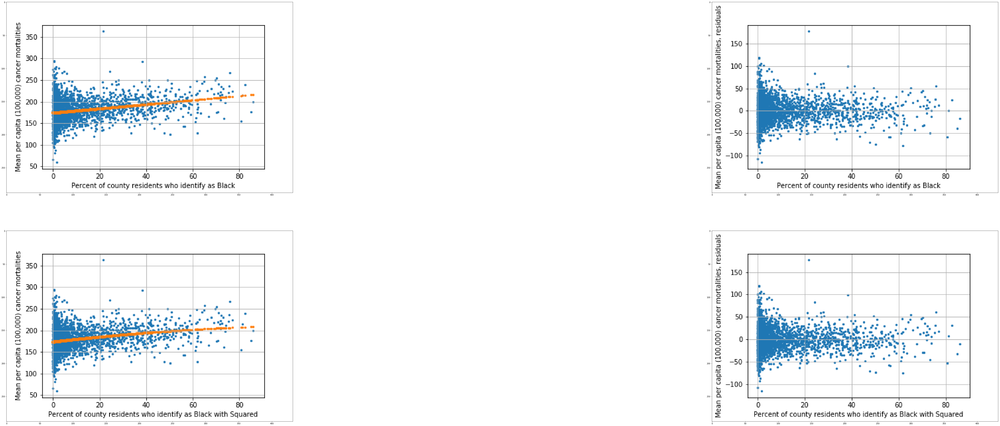

In [249]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_26_ap = plt.imread("PctBlack_actual_&_predicted_Y.png")
implot_26_ap = plt.imshow(im_26_ap)
plt.subplot(2, 2, 2)
im_26_r = plt.imread("PctBlack_residuals.png")
implot_26_r = plt.imshow(im_26_r)
plt.subplot(2, 2, 3)
im_26_sq = plt.imread("PctBlack_sqrd_actual_&_predicted_Y.png")
implot_26_sq = plt.imshow(im_26_sq)
plt.subplot(2, 2, 4)
im_26_sqres = plt.imread("PctBlack_sqrd_residuals.png")
implot_26_sqres = plt.imshow(im_26_sqres)

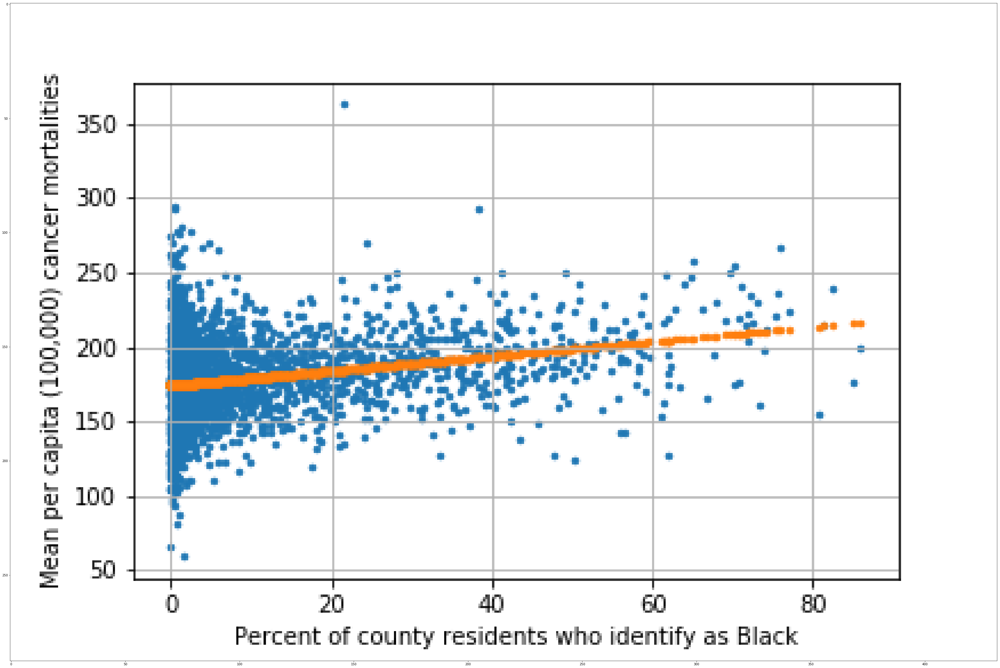

In [250]:
im_26_ap = plt.imread("PctBlack_actual_&_predicted_Y.png")
implot_26_ap = plt.imshow(im_26_ap)

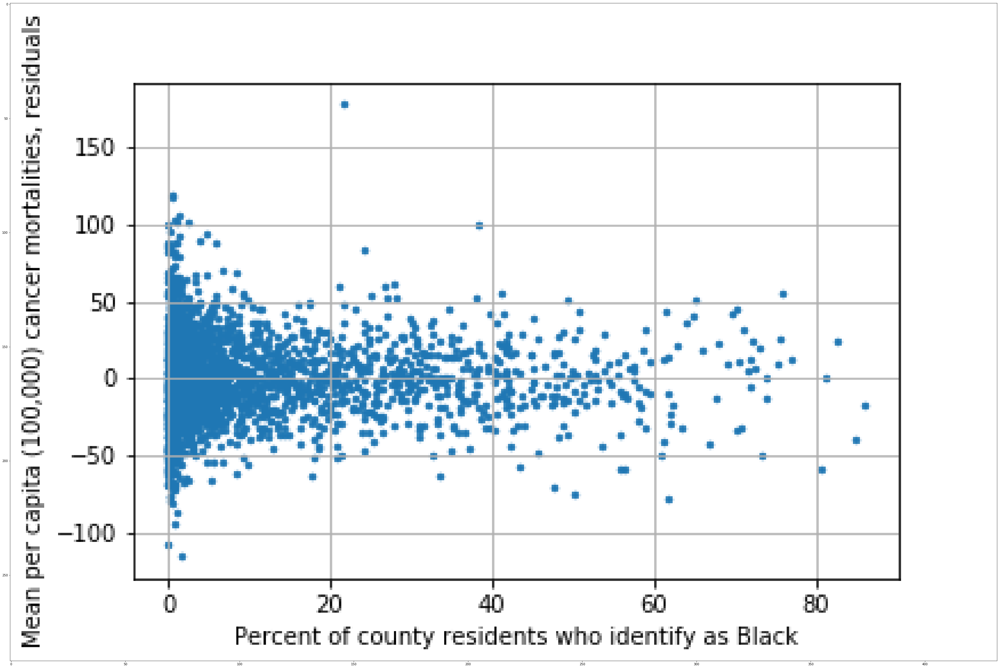

In [251]:
im_26_r = plt.imread("PctBlack_residuals.png")
implot_26_r = plt.imshow(im_26_r)

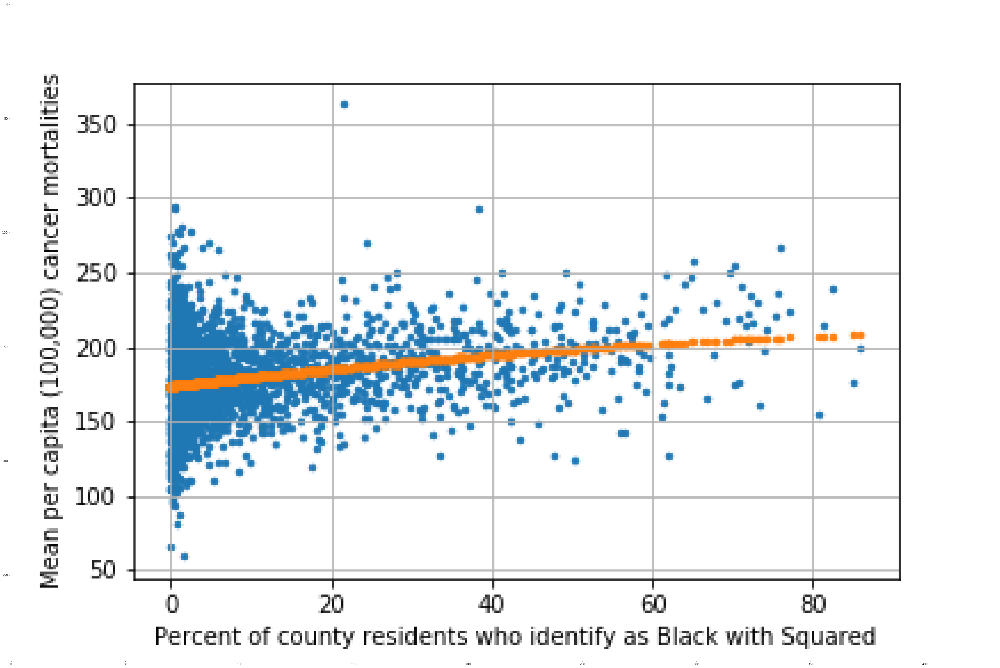

In [252]:
im_26_sq = plt.imread("PctBlack_sqrd_actual_&_predicted_Y.png")
implot_26_sq = plt.imshow(im_26_sq)

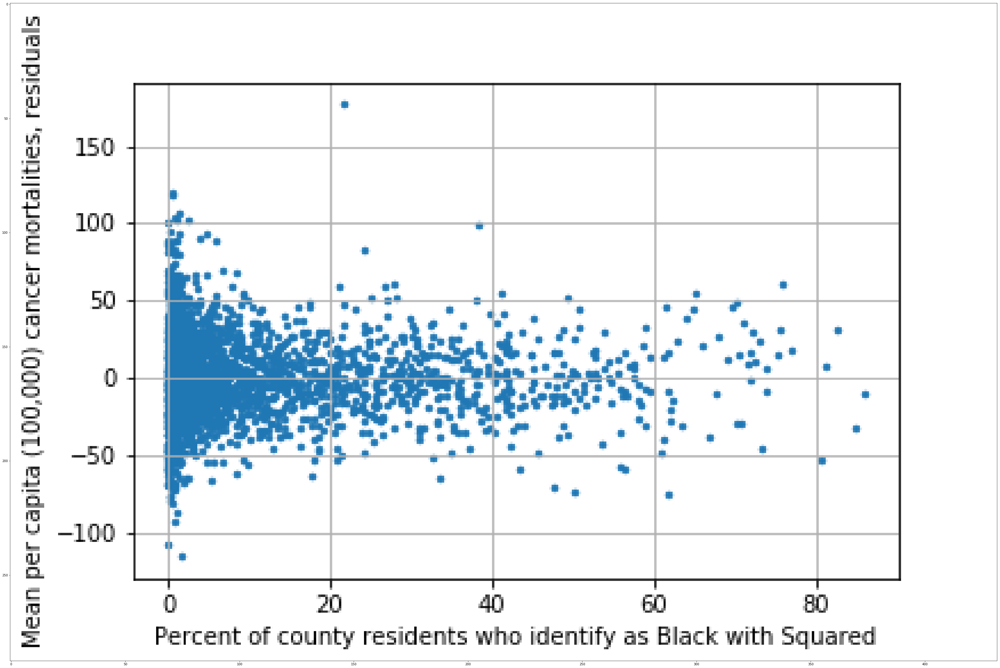

In [253]:
im_26_sqres = plt.imread("PctBlack_sqrd_residuals.png")
implot_26_sqres = plt.imshow(im_26_sqres)

## 'PctAsian': Percent of county residents who identify as Asian

The percent of county residents who identify as Asian ranges from zero to 43%, and has a mean value of 1.3% with a standard deviation of 2.6%. The counties with the lowest percentage of county residents who identify as Asian were in South Carolina, Missouri, Texas, Virginia and New Mexico. The counties with the highest percentage were in California, Hawaii and Alaska.

In [255]:
cancer.describe().PctAsian

count    3047.000000
mean        1.253965
std         2.610276
min         0.000000
25%         0.254199
50%         0.549812
75%         1.221037
max        42.619425
Name: PctAsian, dtype: float64

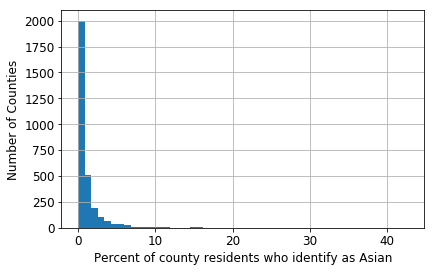

In [261]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PctAsian'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents who identify as Asian", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PctAsian_dist.png')

In [257]:
pct_asian = cancer.sort_values(by='PctAsian').PctAsian
pct_asian.head()

Geography
Abbeville County, South Carolina    0.0
Iron County, Missouri               0.0
Irion County, Texas                 0.0
Highland County, Virginia           0.0
Hidalgo County, New Mexico          0.0
Name: PctAsian, dtype: float64

In [258]:
pct_asian.tail()

Geography
Santa Clara County, California        33.760905
San Francisco County, California      33.829510
Kauai County, Hawaii                  35.640183
Aleutians West Census Area, Alaska    37.156932
Honolulu County, Hawaii               42.619425
Name: PctAsian, dtype: float64

There is a moderate negative correlation of -0.19 between the percentage of county residents who identify as Asian and cancer mortality. This shows that as the percentage of county residents who identify as Asian increases, cancer mortality decreases.

Adding a logarithmic or exponential expansion of 'PctAsian' did not add to the model's overall accuracy.

In [259]:
r_PctAsian = pearson_r(cancer['PctAsian'], cancer['TARGET_deathRate'])
r_PctAsian

-0.18633110452226684

In [260]:
cov_matrix_PctAsian = np.cov(cancer['PctAsian'], cancer['TARGET_deathRate'])
cov_matrix_PctAsian

array([[  6.81354285, -13.49766028],
       [-13.49766028, 770.14638047]])

## 'PctOtherRace': Percent of county residents who identify in a category which is not White, Black, or Asian 

The percent of county residents who identify as a race other than white, black or Asian ranges from zero to 42%, and has a mean value of 2% with a standard deviation of 3.5%. The counties with the lowest percentage of county residents who identify as 'other race' were in Kansas, Mississippi, Virginia and Nebraska. The counties with the highest percentage were in New Mexico, Texas, and New York.

In [262]:
cancer.describe().PctOtherRace

count    3047.000000
mean        1.983523
std         3.517710
min         0.000000
25%         0.295172
50%         0.826185
75%         2.177960
max        41.930251
Name: PctOtherRace, dtype: float64

Text(0, 0.5, 'Number of Counties')

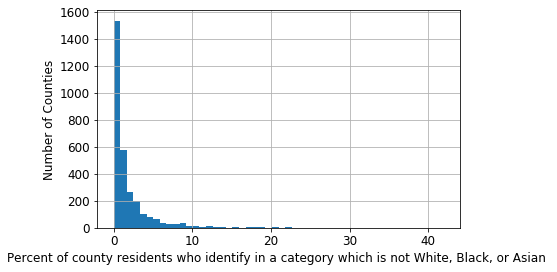

In [263]:
cancer['PctOtherRace'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of county residents who identify in a category which is not White, Black, or Asian ", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [264]:
pct_other_race = cancer.sort_values(by='PctOtherRace').PctOtherRace
pct_other_race.head()

Geography
Lane County, Kansas           0.0
Hodgeman County, Kansas       0.0
Holmes County, Mississippi    0.0
Buena Vista city, Virginia    0.0
Cherry County, Nebraska       0.0
Name: PctOtherRace, dtype: float64

In [265]:
pct_other_race.tail()

Geography
San Miguel County, New Mexico    36.828520
Crane County, Texas              37.610994
Bronx County, New York           37.859023
Reagan County, Texas             38.743747
Crockett County, Texas           41.930251
Name: PctOtherRace, dtype: float64

There is a moderate negative correlation of -0.19 between the percentage of county residents who identify as a race other than white, black or Asian and cancer mortality. This shows that as the percentage of county residents who identify as a race other than White, Black or Asian increases, cancer mortality decreases.

Adding a logarithmic or exponential expansion of 'PctOtherRace' did not add to the model's overall accuracy.

In [266]:
r_PctOtherRace = pearson_r(cancer['PctOtherRace'], cancer['TARGET_deathRate'])
r_PctOtherRace

-0.18989357107608779

In [267]:
cov_matrix_PctOtherRace = np.cov(cancer['PctOtherRace'], cancer['TARGET_deathRate'])
cov_matrix_PctOtherRace

array([[ 12.37428461, -18.53774703],
       [-18.53774703, 770.14638047]])

## 'PctMarriedHouseholds': Percent of married households

The percentage of households in a county that have married residents (versus simply the percentage of county residents who are married) ranges from 22.3% to 78.1%, and has a mean value of 51.2% with a standard deviation of 6.6%. The counties with the lowest percentage of county residents who were married were in Georgia, Virginia, the District of Columbia, Maryland and Missouri. The counties with the highest percentage were in Utah, Kansas, and Idaho.

In [268]:
cancer.describe().PctMarriedHouseholds

count    3047.000000
mean       51.243872
std         6.572814
min        22.992490
25%        47.763063
50%        51.669941
75%        55.395132
max        78.075397
Name: PctMarriedHouseholds, dtype: float64

Text(0, 0.5, 'Number of Counties')

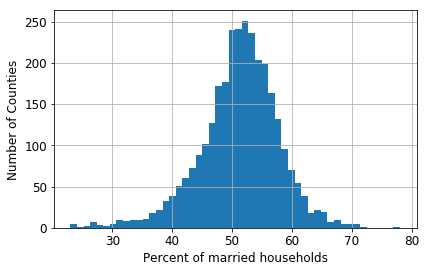

In [269]:
cancer['PctMarriedHouseholds'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Percent of married households", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [270]:
pct_married_households = cancer.sort_values(by='PctMarriedHouseholds').PctMarriedHouseholds
pct_married_households.head()

Geography
Stewart County, Georgia                       22.992490
Richmond city, Virginia                       23.885628
District of Columbia, District of Columbia    23.915652
Baltimore city, Maryland                      24.024634
St. Louis city, Missouri                      24.429078
Name: PctMarriedHouseholds, dtype: float64

In [271]:
pct_married_households.tail()

Geography
Rich County, Utah         70.781250
Utah County, Utah         71.127007
Stevens County, Kansas    71.400100
Madison County, Idaho     71.703057
Morgan County, Utah       78.075397
Name: PctMarriedHouseholds, dtype: float64

There is a moderate negative correlation of -0.29 between the percentage of married households and cancer mortality, showing that cancer mortality decreases as the percentage of married households in a county increases.

Adding a logarithmic or exponential expansion of 'PctMarriedHouseholds' did not add to the model's overall accuracy.

In [272]:
r_PctMarriedHouseholds = pearson_r(cancer['PctMarriedHouseholds'], cancer['TARGET_deathRate'])
r_PctMarriedHouseholds

-0.2933253405101326

In [273]:
cov_matrix_PctMarriedHouseholds = np.cov(cancer['PctMarriedHouseholds'], cancer['TARGET_deathRate'])
cov_matrix_PctMarriedHouseholds

array([[ 43.20188117, -53.50416021],
       [-53.50416021, 770.14638047]])

## 'BirthRate': Number of live births relative to number of women in county

The number of live births relative to the number of women in a county ranges from zero to 21.3%, and has a mean value of 5.6% with a standard deviation of 2%. The counties with the number of live births relative to the number of women in a county were in Texas and New Mexico. The counties with the highest percentage were in Texas, Wyoming and Montana.

In [274]:
cancer.describe().BirthRate

count    3047.000000
mean        5.640306
std         1.985816
min         0.000000
25%         4.521419
50%         5.381478
75%         6.493677
max        21.326165
Name: BirthRate, dtype: float64

Text(0, 0.5, 'Number of Counties')

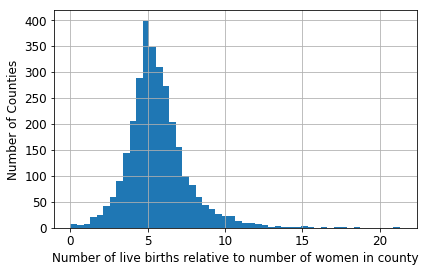

In [275]:
cancer['BirthRate'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Number of live births relative to number of women in county", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [276]:
birth_rate = cancer.sort_values(by='BirthRate').BirthRate
birth_rate.head()

Geography
Coke County, Texas            0.000000
De Baca County, New Mexico    0.000000
Jeff Davis County, Texas      0.000000
Kinney County, Texas          0.000000
Donley County, Texas          0.284091
Name: BirthRate, dtype: float64

In [277]:
birth_rate.tail()

Geography
Jim Hogg County, Texas     17.260579
Weston County, Wyoming     17.401046
Wibaux County, Montana     17.877095
Granite County, Montana    18.556701
Fallon County, Montana     21.326165
Name: BirthRate, dtype: float64

There is a very weak correlation of -0.09 between birthrate and cancer mortality. 

Adding a logarithmic or exponential expansion of 'BirthRate' did not add to the model's overall accuracy.

In [278]:
r_BirthRate = pearson_r(cancer['BirthRate'], cancer['TARGET_deathRate'])
r_BirthRate

-0.08740696984073312

In [279]:
cov_matrix_BirthRate = np.cov(cancer['BirthRate'], cancer['TARGET_deathRate'])
cov_matrix_BirthRate

array([[  3.94346456,  -4.81694486],
       [ -4.81694486, 770.14638047]])

## 'INTPTLAT': Latitude

The United States' latitude ranges from 19.6 to 70, from Hawaii to Alaska.

In [280]:
cancer.describe().INTPTLAT

count    3047.000000
mean       38.393854
std         5.164576
min        19.597764
25%        34.741834
50%        38.367848
75%        41.748017
max        69.449343
Name: INTPTLAT, dtype: float64

The distribution of counties across the range of latitudes is interesting as a measure of population. One can see that the measure of central tendency and greatest number of counties is found at a latitude of 38 (the north/south middle of the country), that the concentration of counties decreases the further away from the latitude of 38, and that Hawaii and Alaska occur as outliers on each tail of the distribution. 

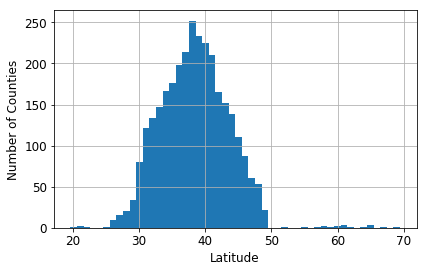

In [281]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['INTPTLAT'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Latitude", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('INTPTLAT_dist.png')

Latitude has a weakly negative correlation of -0.18 with cancer mortality, suggesting that generally the further north a county is the lower its cancer mortality rate is.

Adding a logarithmic or exponential expansion of 'INTPTLAT' did not add to the model's overall accuracy.

In [282]:
r_Latitude = pearson_r(cancer['INTPTLAT'], cancer['TARGET_deathRate'])
r_Latitude

-0.18413185621388237

In [283]:
cov_matrix_Latitude = np.cov(cancer['INTPTLAT'], cancer['TARGET_deathRate'])
cov_matrix_Latitude

array([[ 26.67284399, -26.39065887],
       [-26.39065887, 770.14638047]])

## 'INTPTLONG': Longitude

The United States' longitude ranges from -164.2 to -67.6.

In [282]:
cancer.describe().INTPTLONG

count    3047.000000
mean      -91.925063
std        12.544077
min      -174.159600
25%       -97.801963
50%       -90.065394
75%       -83.324437
max       -67.609354
Name: INTPTLONG, dtype: float64

One can see that the greatest concentration of counties exists at the longitude of -91.9, in the Midwest.

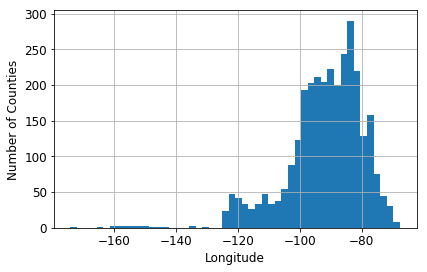

In [284]:
cancer['INTPTLONG'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Longitude", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('INTPTLONG_dist.png')

Longitude has a weakly positive correlation of 0.26 with cancer mortality, suggesting that generally the further east a county is the higher its cancer mortality rate is.

In [285]:
r_Longitude = pearson_r(cancer['INTPTLONG'], cancer['TARGET_deathRate'])
r_Longitude

0.2629654019833177

In [286]:
cov_matrix_Longitude = np.cov(cancer['INTPTLONG'], cancer['TARGET_deathRate'])
cov_matrix_Longitude

array([[157.35387205,  91.54275303],
       [ 91.54275303, 770.14638047]])

One can see the weakly positive correlation between longitude and cancer mortality in the prediction line below. Adding the squared transformation of longitude reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.0005.

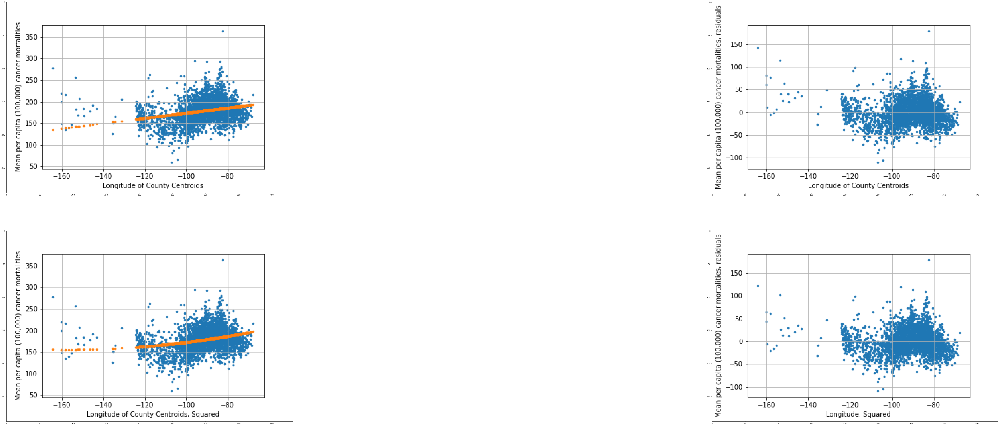

In [287]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_34_ap = plt.imread("Longitude_actual_&_predicted_Y.png")
implot_34_ap = plt.imshow(im_34_ap)
plt.subplot(2, 2, 2)
im_34_r = plt.imread("Longitude_residuals.png")
implot_34_r = plt.imshow(im_34_r)
plt.subplot(2, 2, 3)
im_34_sq = plt.imread("Longitude_Squared_actual_&_predicted_Y.png")
implot_34_sq = plt.imshow(im_34_sq)
plt.subplot(2, 2, 4)
im_34_sqres = plt.imread("Longitude_Squared_residuals.png")
implot_34_sqres = plt.imshow(im_34_sqres)

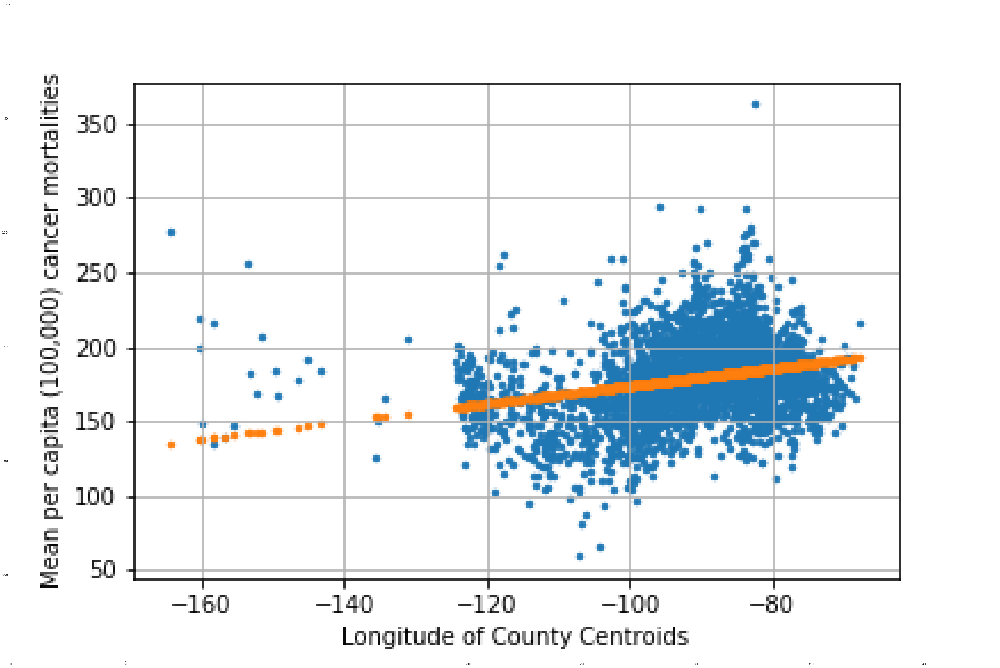

In [288]:
im_34_ap = plt.imread("Longitude_actual_&_predicted_Y.png")
implot_34_ap = plt.imshow(im_34_ap)

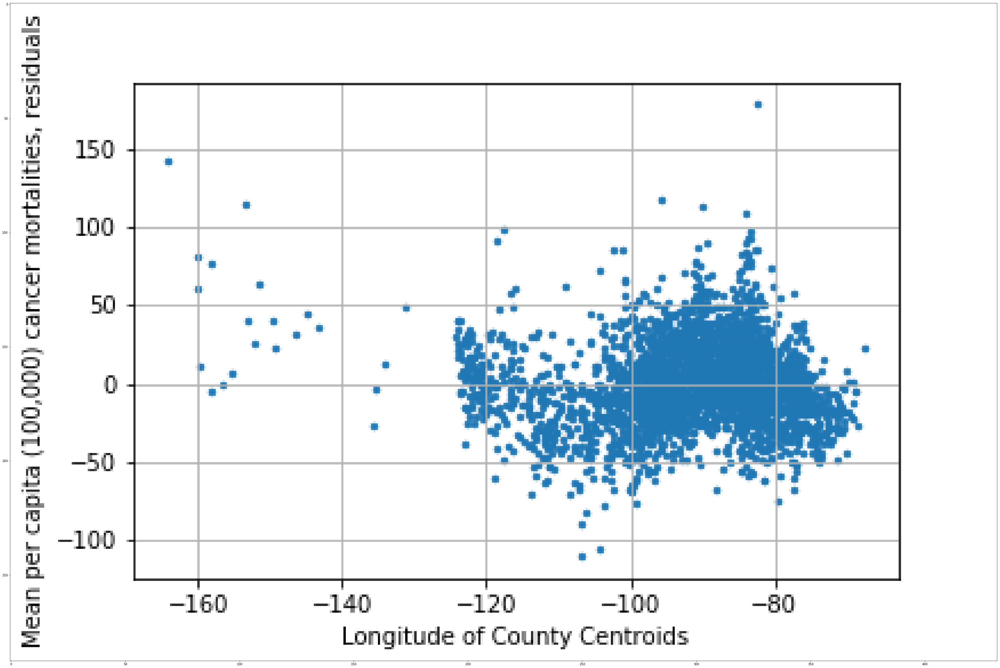

In [289]:
im_34_r = plt.imread("Longitude_residuals.png")
implot_34_r = plt.imshow(im_34_r)

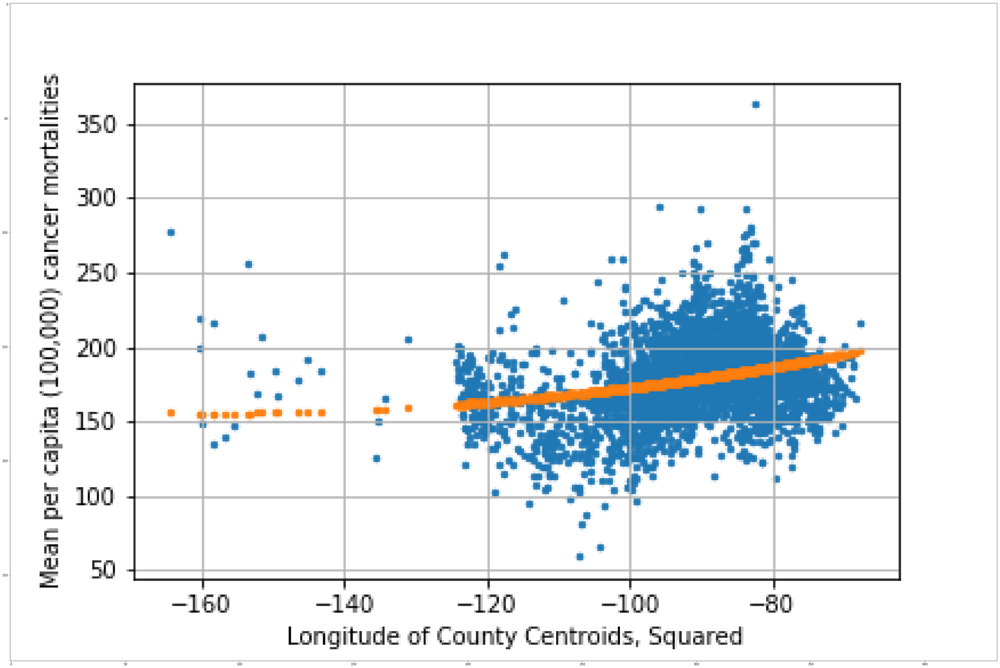

In [290]:
im_34_sq = plt.imread("Longitude_Squared_actual_&_predicted_Y.png")
implot_34_sq = plt.imshow(im_34_sq)

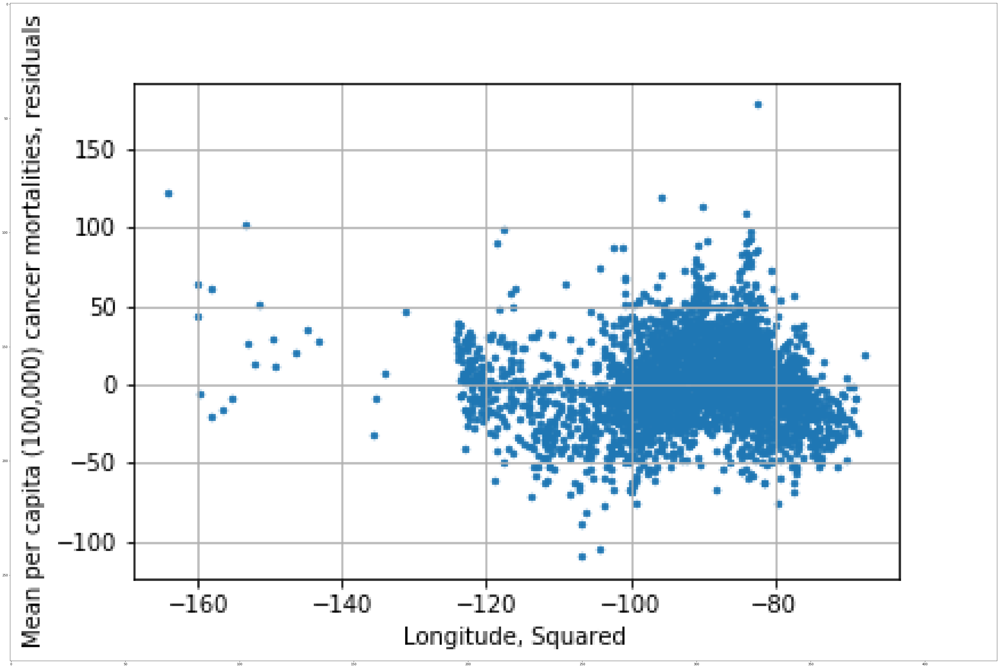

In [291]:
im_34_sqres = plt.imread("Longitude_Squared_residuals.png")
implot_34_sqres = plt.imshow(im_34_sqres)

## Individual Distance Features for Top 10 Oncology Hospitals and Urban Centers

There are a total of 36 individual features for the L1 and L2 distances to the top 10 oncology hospitals and eight urban centers. Running histograms of these features will simply repeat the geographic layout of the country which is explored elsewhere, so they will not be created for the individual distance features. The scatterplots of the logarithmic and exponential transformations of these features is also not very interesting, so they will not be created here.

However, 16 of these 36 features did improve the OLS linear regression model's accuracy when their logarithmic and/or exponential transformations were added to the core feature set. These features are detailed in the following table.

In [292]:
improved_dist_features = pd.read_excel("Feature_key_for_residuals_plotting_080520.xls", sheet_name = 'Distance_Features')
improved_dist_features

,Feature #,"Feature Name (blue=don't add, green= add)",Score,Score with log version,Score with log version & squared version,Core Score,Feature Set Score + LogFeature,Core+Log-Core,Core+Log+Sqrd,Core+Log+Squared minus Core+Log,Feature Set Score + sqrd alone,Diff bw Core & +Sqrd
0,36,mskcc_l1 (log went up),0.049193,0.051118,0.115376,0.624388,0.625847,0.001460,0.625474,-0.000373488,NaN,NaN
1,37,mayo_l1 (both went up),0.034703,0.034703,0.091994,0.625847,0.625894,0.000046,0.625896,2.49385e-06,,
2,39,dfb_l1 (both went up),0.034703,0.034703,0.091994,0.625896,0.625899,0.000002,0.62621,0.000311475,,
3,40,cleveland_l1 (both went up),0.034703,0.034703,0.091994,0.626210,0.626763,0.000553,0.629701,0.00293828,,
4,41,upmcps_l1 (log went up),0.034703,0.034703,0.091994,0.629701,0.629747,0.000046,0.627556,-0.00219118,,
5,43,mgs_l1 (log went up),0.034703,0.034703,0.091994,0.629747,0.629887,0.000140,0.628781,-0.00110638,,
6,47,atlanta_l1 (log went up),0.042518,0.043139,0.106965,0.629887,0.632220,0.002333,0.632218,-1.41676e-06,,
7,49,denver_l1 (squared went up),0.042518,0.043139,0.106965,0.632220,0.631616,-0.000604,,,0.633089,0.000869629
8,50,los_ang_l1 (squared went up),0.042518,0.043139,0.106965,0.633089,0.629934,-0.003156,,,0.633727,0.000637674
9,51,seattle_l1 (log went up),0.042518,0.043139,0.106965,0.633727,0.634159,0.000432,0.629391,-0.00476772,,


Correlations between each of the individual distance features and the target variable are run to see if any correlations stand out. Although some of these features have up to a 0.34 correlation with the target variable, most of them have between a .1 and .2 correlation. Because the hospitals and urban centers are spread throughout the country (as are all the country centroids), it is difficult to ascribe any meaning to these correlations, as a county may be far from one hospital or urban center but close to another. At any rate, none of these correlations truly stand out, and the L1 and L2 distances to the closest top 10 oncology hospital and urban center are covered later in the notebook.

In [293]:
r_utmda_l1 = pearson_r(cancer['utmda_l1'], cancer['TARGET_deathRate'])
r_utmda_l1

-0.1403389612656115

In [294]:
cov_matrix_utmda_l1 = np.cov(cancer['utmda_l1'], cancer['TARGET_deathRate'])
cov_matrix_utmda_l1

array([[113.15538145, -41.42881427],
       [-41.42881427, 770.14638047]])

In [295]:
r_mskcc_l1 = pearson_r(cancer['mskcc_l1'], cancer['TARGET_deathRate'])
r_mskcc_l1

-0.22225640452045384

In [296]:
cov_matrix_mskcc_l1 = np.cov(cancer['mskcc_l1'], cancer['TARGET_deathRate'])
cov_matrix_mskcc_l1

array([[184.07588451, -83.68341055],
       [-83.68341055, 770.14638047]])

In [297]:
r_mayo_l1 = pearson_r(cancer['mayo_l1'], cancer['TARGET_deathRate'])
r_mayo_l1

-0.06761029953167562

In [298]:
cov_matrix_mayo_l1 = np.cov(cancer['mayo_l1'], cancer['TARGET_deathRate'])
cov_matrix_mayo_l1

array([[ 81.25744335, -16.91340608],
       [-16.91340608, 770.14638047]])

In [299]:
r_hopkins_l1 = pearson_r(cancer['hopkins_l1'], cancer['TARGET_deathRate'])
r_hopkins_l1

-0.25600525403153424

In [300]:
cov_matrix_hopkins_l1 = np.cov(cancer['hopkins_l1'], cancer['TARGET_deathRate'])
cov_matrix_hopkins_l1

array([[181.76317211, -95.78300642],
       [-95.78300642, 770.14638047]])

In [301]:
r_dfb_l1 = pearson_r(cancer['dfb_l1'], cancer['TARGET_deathRate'])
r_dfb_l1

-0.19760390060751076

In [302]:
cov_matrix_dfb_l1 = np.cov(cancer['dfb_l1'], cancer['TARGET_deathRate'])
cov_matrix_dfb_l1

array([[182.67653168, -74.11797258],
       [-74.11797258, 770.14638047]])

In [303]:
r_cleveland_l1 = pearson_r(cancer['cleveland_l1'], cancer['TARGET_deathRate'])
r_cleveland_l1

-0.2503378052496651

In [304]:
cov_matrix_cleveland_l1 = np.cov(cancer['cleveland_l1'], cancer['TARGET_deathRate'])
cov_matrix_cleveland_l1

array([[144.77530597, -83.59115489],
       [-83.59115489, 770.14638047]])

In [305]:
r_upmcps_l1 = pearson_r(cancer['upmcps_l1'], cancer['TARGET_deathRate'])
r_upmcps_l1

-0.25557635715444904

In [306]:
cov_matrix_upmcps_l1 = np.cov(cancer['upmcps_l1'], cancer['TARGET_deathRate'])
cov_matrix_upmcps_l1

array([[159.65935778, -89.61991011],
       [-89.61991011, 770.14638047]])

In [307]:
r_hlmcc_l1 = pearson_r(cancer['hlmcc_l1'], cancer['TARGET_deathRate'])
r_hlmcc_l1

-0.3278826352636987

In [308]:
cov_matrix_hlmcc_l1 = np.cov(cancer['hlmcc_l1'], cancer['TARGET_deathRate'])
cov_matrix_hlmcc_l1

array([[ 185.79548407, -124.02882609],
       [-124.02882609,  770.14638047]])

In [309]:
r_mgs_l1 = pearson_r(cancer['mgs_l1'], cancer['TARGET_deathRate'])
r_mgs_l1

-0.1973052607998539

In [310]:
cov_matrix_mgs_l1 = np.cov(cancer['mgs_l1'], cancer['TARGET_deathRate'])
cov_matrix_mgs_l1

array([[182.61456371, -73.9934044 ],
       [-73.9934044 , 770.14638047]])

In [311]:
r_nw_mem_l1 = pearson_r(cancer['nw_mem_l1'], cancer['TARGET_deathRate'])
r_nw_mem_l1

-0.22461297384488654

In [312]:
cov_matrix_nw_mem_l1 = np.cov(cancer['nw_mem_l1'], cancer['TARGET_deathRate'])
cov_matrix_nw_mem_l1

array([[102.36806139, -63.0672242 ],
       [-63.0672242 , 770.14638047]])

In [313]:
r_chi_l1 = pearson_r(cancer['chi_l1'], cancer['TARGET_deathRate'])
r_chi_l1

-0.22477003116032157

In [314]:
cov_matrix_chi_l1 = np.cov(cancer['chi_l1'], cancer['TARGET_deathRate'])
cov_matrix_chi_l1

array([[102.363548  , -63.10993173],
       [-63.10993173, 770.14638047]])

In [315]:
r_nyc_l1 = pearson_r(cancer['nyc_l1'], cancer['TARGET_deathRate'])
r_nyc_l1

-0.22316384436059797

In [316]:
cov_matrix_nyc_l1 = np.cov(cancer['nyc_l1'], cancer['TARGET_deathRate'])
cov_matrix_nyc_l1

array([[184.14541083, -84.0409443 ],
       [-84.0409443 , 770.14638047]])

In [317]:
r_atlanta_l1 = pearson_r(cancer['atlanta_l1'], cancer['TARGET_deathRate'])
r_atlanta_l1

-0.34518492552824176

In [318]:
cov_matrix_atlanta_l1 = np.cov(cancer['atlanta_l1'], cancer['TARGET_deathRate'])
cov_matrix_atlanta_l1

array([[ 160.40611084, -121.32461321],
       [-121.32461321,  770.14638047]])

In [319]:
r_dallas_l1 = pearson_r(cancer['dallas_l1'], cancer['TARGET_deathRate'])
r_dallas_l1

-0.10191968202575001

In [320]:
cov_matrix_dallas_l1 = np.cov(cancer['dallas_l1'], cancer['TARGET_deathRate'])
cov_matrix_dallas_l1

array([[102.90952666, -28.69277084],
       [-28.69277084, 770.14638047]])

In [321]:
r_denver_l1 = pearson_r(cancer['denver_l1'], cancer['TARGET_deathRate'])
r_denver_l1

0.23667925542773455

In [322]:
cov_matrix_denver_l1 = np.cov(cancer['denver_l1'], cancer['TARGET_deathRate'])
cov_matrix_denver_l1

array([[ 82.70802193,  59.73386977],
       [ 59.73386977, 770.14638047]])

In [323]:
r_los_ang_l1 = pearson_r(cancer['los_ang_l1'], cancer['TARGET_deathRate'])
r_los_ang_l1

0.2162231291363226

In [324]:
cov_matrix_los_ang_l1 = np.cov(cancer['los_ang_l1'], cancer['TARGET_deathRate'])
cov_matrix_los_ang_l1

array([[118.77162459,  65.3950891 ],
       [ 65.3950891 , 770.14638047]])

In [325]:
r_seattle_l1 = pearson_r(cancer['seattle_l1'], cancer['TARGET_deathRate'])
r_seattle_l1

0.34150997806657374

In [326]:
cov_matrix_seattle_l1 = np.cov(cancer['seattle_l1'], cancer['TARGET_deathRate'])
cov_matrix_seattle_l1

array([[173.14927481, 124.70974035],
       [124.70974035, 770.14638047]])

In [327]:
r_san_fran_l1 = pearson_r(cancer['san_fran_l1'], cancer['TARGET_deathRate'])
r_san_fran_l1

0.2640649568382298

In [328]:
cov_matrix_san_fran_l1 = np.cov(cancer['san_fran_l1'], cancer['TARGET_deathRate'])
cov_matrix_san_fran_l1

array([[125.75790358,  82.17979529],
       [ 82.17979529, 770.14638047]])

In [329]:
r_utmda_l2 = pearson_r(cancer['utmda_l2'], cancer['TARGET_deathRate'])
r_utmda_l2

-0.16263617494489563

In [330]:
cov_matrix_utmda_l2 = np.cov(cancer['utmda_l2'], cancer['TARGET_deathRate'])
cov_matrix_utmda_l2

array([[ 60.20096198, -35.01914241],
       [-35.01914241, 770.14638047]])

In [331]:
r_mskcc_l2 = pearson_r(cancer['mskcc_l2'], cancer['TARGET_deathRate'])
r_mskcc_l2

-0.26134583666135525

In [332]:
cov_matrix_mskcc_l2 = np.cov(cancer['mskcc_l2'], cancer['TARGET_deathRate'])
cov_matrix_mskcc_l2

array([[147.86303208, -88.19257623],
       [-88.19257623, 770.14638047]])

In [333]:
r_mayo_l2 = pearson_r(cancer['mayo_l2'], cancer['TARGET_deathRate'])
r_mayo_l2

-0.08771718521152178

In [334]:
cov_matrix_mayo_l2 = np.cov(cancer['mayo_l2'], cancer['TARGET_deathRate'])
cov_matrix_mayo_l2

array([[ 56.54952284, -18.30567715],
       [-18.30567715, 770.14638047]])

In [335]:
r_hopkins_l2 = pearson_r(cancer['hopkins_l2'], cancer['TARGET_deathRate'])
r_hopkins_l2

-0.279314448465969

In [336]:
cov_matrix_hopkins_l2 = np.cov(cancer['hopkins_l2'], cancer['TARGET_deathRate'])
cov_matrix_hopkins_l2

array([[141.79963975, -92.30338005],
       [-92.30338005, 770.14638047]])

In [337]:
r_dfb_l2 = pearson_r(cancer['dfb_l2'], cancer['TARGET_deathRate'])
r_dfb_l2

-0.25118532373139774

In [338]:
cov_matrix_dfb_l2 = np.cov(cancer['dfb_l2'], cancer['TARGET_deathRate'])
cov_matrix_dfb_l2

array([[150.46045452, -85.50511292],
       [-85.50511292, 770.14638047]])

In [339]:
r_cleveland_l2 = pearson_r(cancer['cleveland_l2'], cancer['TARGET_deathRate'])
r_cleveland_l2

-0.2881197006704857

In [340]:
cov_matrix_cleveland_l2 = np.cov(cancer['cleveland_l2'], cancer['TARGET_deathRate'])
cov_matrix_cleveland_l2

array([[109.35273392, -83.61311761],
       [-83.61311761, 770.14638047]])

In [341]:
r_upmcps_l2 = pearson_r(cancer['upmcps_l2'], cancer['TARGET_deathRate'])
r_upmcps_l2

-0.29092151065431304

In [342]:
cov_matrix_upmcps_l2 = np.cov(cancer['upmcps_l2'], cancer['TARGET_deathRate'])
cov_matrix_upmcps_l2

array([[122.25750762, -89.26891213],
       [-89.26891213, 770.14638047]])

In [343]:
r_hlmcc_l2 = pearson_r(cancer['hlmcc_l2'], cancer['TARGET_deathRate'])
r_hlmcc_l2

-0.32563439665252714

In [344]:
cov_matrix_hlmcc_l2 = np.cov(cancer['hlmcc_l2'], cancer['TARGET_deathRate'])
cov_matrix_hlmcc_l2

array([[104.72395349, -92.47831901],
       [-92.47831901, 770.14638047]])

In [345]:
r_mgs_l2 = pearson_r(cancer['mgs_l2'], cancer['TARGET_deathRate'])
r_mgs_l2

-0.2510868809779164

In [346]:
cov_matrix_mgs_l2 = np.cov(cancer['mgs_l2'], cancer['TARGET_deathRate'])
cov_matrix_mgs_l2

array([[150.46331442, -85.47241467],
       [-85.47241467, 770.14638047]])

In [347]:
r_nw_mem_l2 = pearson_r(cancer['nw_mem_l2'], cancer['TARGET_deathRate'])
r_nw_mem_l2

-0.2487267336830405

In [348]:
cov_matrix_nw_mem_l2 = np.cov(cancer['nw_mem_l2'], cancer['TARGET_deathRate'])
cov_matrix_nw_mem_l2

array([[ 74.97799544, -59.76900398],
       [-59.76900398, 770.14638047]])

In [349]:
r_chi_l2 = pearson_r(cancer['chi_l2'], cancer['TARGET_deathRate'])
r_chi_l2

-0.24888976248663278

In [350]:
cov_matrix_chi_l2 = np.cov(cancer['chi_l2'], cancer['TARGET_deathRate'])
cov_matrix_chi_l2

array([[ 74.96885267, -59.80453319],
       [-59.80453319, 770.14638047]])

In [351]:
r_nyc_l2 = pearson_r(cancer['nyc_l2'], cancer['TARGET_deathRate'])
r_nyc_l2

-0.26172166133386476

In [352]:
cov_matrix_nyc_l2 = np.cov(cancer['nyc_l2'], cancer['TARGET_deathRate'])
cov_matrix_nyc_l2

array([[147.8437653 , -88.31364605],
       [-88.31364605, 770.14638047]])

In [353]:
r_atlanta_l2 = pearson_r(cancer['atlanta_l2'], cancer['TARGET_deathRate'])
r_atlanta_l2

-0.3416618061905724

In [354]:
cov_matrix_atlanta_l2 = np.cov(cancer['atlanta_l2'], cancer['TARGET_deathRate'])
cov_matrix_atlanta_l2

array([[103.08777128, -96.26904133],
       [-96.26904133, 770.14638047]])

In [355]:
r_dallas_l2 = pearson_r(cancer['dallas_l2'], cancer['TARGET_deathRate'])
r_dallas_l2

-0.10149907509238994

In [356]:
cov_matrix_dallas_l2 = np.cov(cancer['dallas_l2'], cancer['TARGET_deathRate'])
cov_matrix_dallas_l2

array([[ 58.86930328, -21.61191108],
       [-21.61191108, 770.14638047]])

In [357]:
r_denver_l2 = pearson_r(cancer['denver_l2'], cancer['TARGET_deathRate'])
r_denver_l2

0.23693095292224364

In [358]:
cov_matrix_denver_l2 = np.cov(cancer['denver_l2'], cancer['TARGET_deathRate'])
cov_matrix_denver_l2

array([[ 65.15723027,  53.07496884],
       [ 53.07496884, 770.14638047]])

In [359]:
r_los_ang_l2 = pearson_r(cancer['los_ang_l2'], cancer['TARGET_deathRate'])
r_los_ang_l2

0.2928375415745736

In [360]:
cov_matrix_los_ang_l2 = np.cov(cancer['los_ang_l2'], cancer['TARGET_deathRate'])
cov_matrix_los_ang_l2

array([[ 97.34177171,  80.17943929],
       [ 80.17943929, 770.14638047]])

In [361]:
r_seattle_l2 = pearson_r(cancer['seattle_l2'], cancer['TARGET_deathRate'])
r_seattle_l2

0.312055504423006

In [362]:
cov_matrix_seattle_l2 = np.cov(cancer['seattle_l2'], cancer['TARGET_deathRate'])
cov_matrix_seattle_l2

array([[119.58583803,  94.7018281 ],
       [ 94.7018281 , 770.14638047]])

In [363]:
r_san_fran_l2 = pearson_r(cancer['san_fran_l2'], cancer['TARGET_deathRate'])
r_san_fran_l2

0.30263057651067404

In [364]:
cov_matrix_san_fran_l2 = np.cov(cancer['san_fran_l2'], cancer['TARGET_deathRate'])
cov_matrix_san_fran_l2

array([[116.63516082,  90.70144181],
       [ 90.70144181, 770.14638047]])

## 'onc_min_distsl1': L1 distance to closest top 10 oncology hospital

The L1 distance to the closest top 10 oncology hospital for each county ranges from 0.019 to 92.48 latitude/longitude units, and has a mean value of 8.28 with a standard deviation of 9.18. The counties with the shortest L1 distance to a top 10 oncology hospital were in New York, Maryland, Illinois, Pennsylvania and Massachusetts. The counties with the longest distance are all in Alaska.

In [365]:
cancer.describe().onc_min_distsl1

count    3047.000000
mean        8.284430
std         9.182755
min         0.018729
25%         3.362678
50%         5.782848
75%         8.700715
max        92.482598
Name: onc_min_distsl1, dtype: float64

Text(0, 0.5, 'Number of Counties')

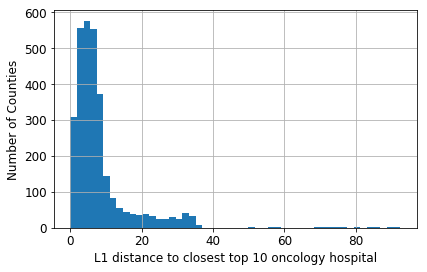

In [366]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['onc_min_distsl1'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L1 distance to closest top 10 oncology hospital", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [367]:
onc_min_dists_l1 = cancer.sort_values(by='onc_min_distsl1').onc_min_distsl1
onc_min_dists_l1.head()

Geography
New York County, New York         0.018729
Baltimore city, Maryland          0.021108
Cook County, Illinois             0.024661
Allegheny County, Pennsylvania    0.047308
Suffolk County, Massachusetts     0.073396
Name: onc_min_distsl1, dtype: float64

In [368]:
onc_min_dists_l1.tail()

Geography
Bethel Census Area, Alaska            84.591766
North Slope Borough, Alaska           86.432173
Aleutians West Census Area, Alaska    89.992900
Northwest Arctic Borough, Alaska      90.536152
Nome Census Area, Alaska              92.482598
Name: onc_min_distsl1, dtype: float64

There is a weakly negative correlation of -0.16 between the L1 distance to the closest top 10 oncology hospital and cancer mortality, suggesting that there is a small decrease in cancer mortality associated with a county being closer to one of these hospitals. 

Adding a logarithmic or exponential expansion of 'onc_min_distsl1' did not add to the model's overall accuracy.

In [369]:
r_onc_min_distsl1 = pearson_r(cancer['onc_min_distsl1'], cancer['TARGET_deathRate'])
r_onc_min_distsl1

-0.16274144030252988

In [370]:
cov_matrix_onc_min_distsl1 = np.cov(cancer['onc_min_distsl1'], cancer['TARGET_deathRate'])
cov_matrix_onc_min_distsl1

array([[ 84.32298317, -41.472267  ],
       [-41.472267  , 770.14638047]])

## 'onc_min_distsl2': L2 distance to closest top 10 oncology hospital

The L2 distance to the closest top 10 oncology hospital for each county ranges from 0.01 to 82 latitude/longitude units, and has a mean value of 6.78 with a standard deviation of 7.86. The counties with the shortest L2 distance to a top 10 oncology hospital were in New York, Maryland, Illinois, Pennsylvania and Massachusetts. The counties with the greatest distance are all in Alaska.

In [371]:
cancer.describe().onc_min_distsl2

count    3047.000000
mean        6.783582
std         7.857754
min         0.013774
25%         2.693923
50%         4.618598
75%         6.859514
max        81.944768
Name: onc_min_distsl2, dtype: float64

Text(0, 0.5, 'Number of Counties')

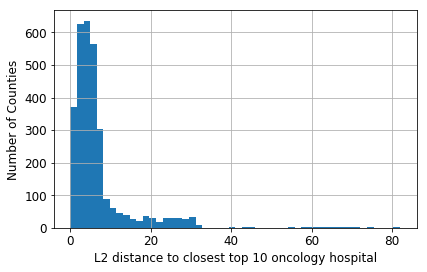

In [372]:
cancer['onc_min_distsl2'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L2 distance to closest top 10 oncology hospital", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [373]:
onc_min_dists_l2 = cancer.sort_values(by='onc_min_distsl2').onc_min_distsl2
onc_min_dists_l2.head()

Geography
New York County, New York         0.013774
Baltimore city, Maryland          0.018086
Cook County, Illinois             0.023965
Allegheny County, Pennsylvania    0.033927
Suffolk County, Massachusetts     0.054895
Name: onc_min_distsl2, dtype: float64

In [374]:
onc_min_dists_l2.tail()

Geography
Dillingham Census Area, Alaska        67.605522
Bethel Census Area, Alaska            69.764826
Northwest Arctic Borough, Alaska      71.356171
Nome Census Area, Alaska              74.665977
Aleutians West Census Area, Alaska    81.944768
Name: onc_min_distsl2, dtype: float64

There is a weakly negative correlation of -0.17 between the L2 distance to the closest top 10 oncology hospital and cancer mortality, suggesting that there is a small decrease in cancer mortality associated with a county being closer to one of these hospitals.

Adding a logarithmic or exponential expansion of 'onc_min_distsl2' did not add to the model's overall accuracy.

In [375]:
r_onc_min_distsl2 = pearson_r(cancer['onc_min_distsl2'], cancer['TARGET_deathRate'])
r_onc_min_distsl2

-0.16602483644053895

In [376]:
cov_matrix_onc_min_distsl2 = np.cov(cancer['onc_min_distsl2'], cancer['TARGET_deathRate'])
cov_matrix_onc_min_distsl2

array([[ 61.74429566, -36.20413043],
       [-36.20413043, 770.14638047]])

## 'city_min_distsl1': L1 distance to closest regional urban center

The shortest L1 distance to the closest of eight regional urban centers ranges from 0.03 to 59.03 latitude/longitude units, and has a mean value of 5.9 with a standard deviation of 4.3.

In [377]:
cancer.describe().city_min_distsl1

count    3047.000000
mean        5.890349
std         4.310897
min         0.031849
25%         3.681109
50%         5.463573
75%         7.340860
max        59.034298
Name: city_min_distsl1, dtype: float64

Text(0, 0.5, 'Number of Counties')

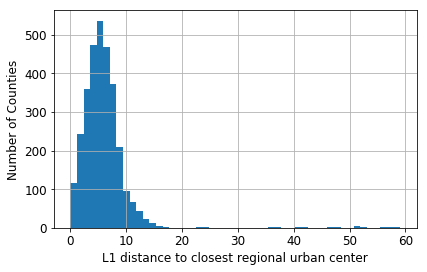

In [378]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['city_min_distsl1'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L1 distance to closest regional urban center", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a very weakly negative correlation of -0.06 between the shortest L1 distance of a county to a regional urban center and cancer mortality.

In [379]:
r_city_min_distsl1 = pearson_r(cancer['city_min_distsl1'], cancer['TARGET_deathRate'])
r_city_min_distsl1

-0.051970532380718866

In [380]:
cov_matrix_city_min_distsl1 = np.cov(cancer['city_min_distsl1'], cancer['TARGET_deathRate'])
cov_matrix_city_min_distsl1

array([[ 18.58383161,  -6.21743761],
       [ -6.21743761, 770.14638047]])

One can see the very weak negative correlation between the shortest L1 distance to a regional urban center and cancer mortality in the prediction line. Adding the squared transformation of the shortest L1 distance to a regional urban center reduces the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.001.

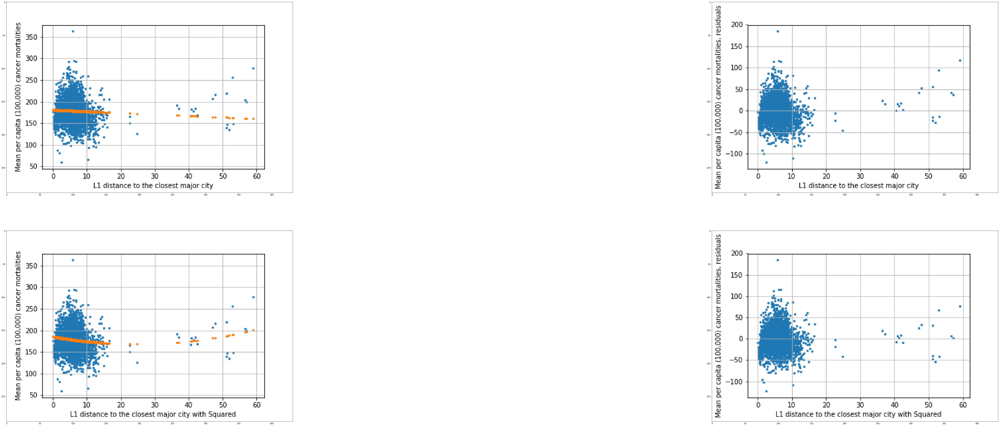

In [381]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_73_ap = plt.imread("city_min_distsl1_actual_&_predicted_Y.png")
implot_73_ap = plt.imshow(im_73_ap)
plt.subplot(2, 2, 2)
im_73_r = plt.imread("city_min_distsl1_residuals.png")
implot_73_r = plt.imshow(im_73_r)
plt.subplot(2, 2, 3)
im_73_sq = plt.imread("city_min_distsl1_sqrd_actual_&_predicted_Y.png")
implot_73_sq = plt.imshow(im_73_sq)
plt.subplot(2, 2, 4)
im_73_sqres = plt.imread("city_min_distsl1_sqrd_residuals.png")
implot_73_sqres = plt.imshow(im_73_sqres)

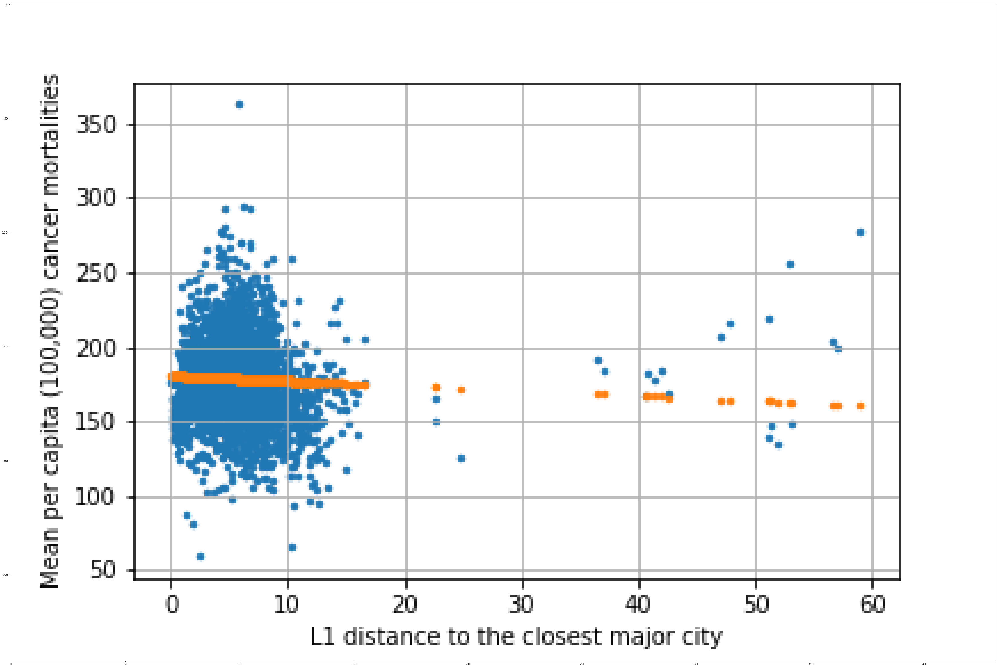

In [382]:
im_73_ap = plt.imread("city_min_distsl1_actual_&_predicted_Y.png")
implot_73_ap = plt.imshow(im_73_ap)

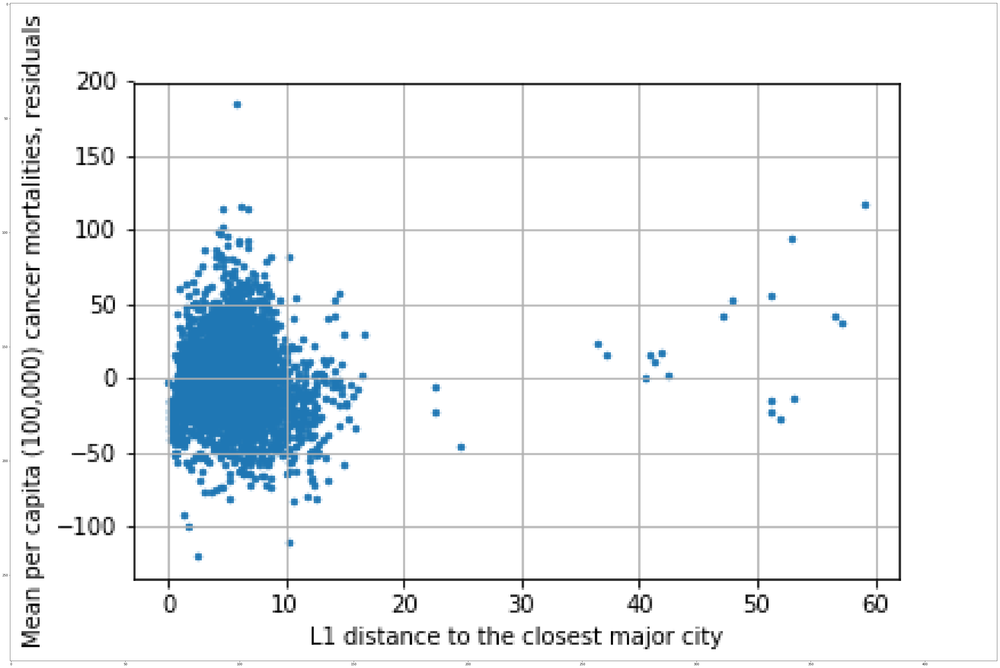

In [383]:
im_73_r = plt.imread("city_min_distsl1_residuals.png")
implot_73_r = plt.imshow(im_73_r)

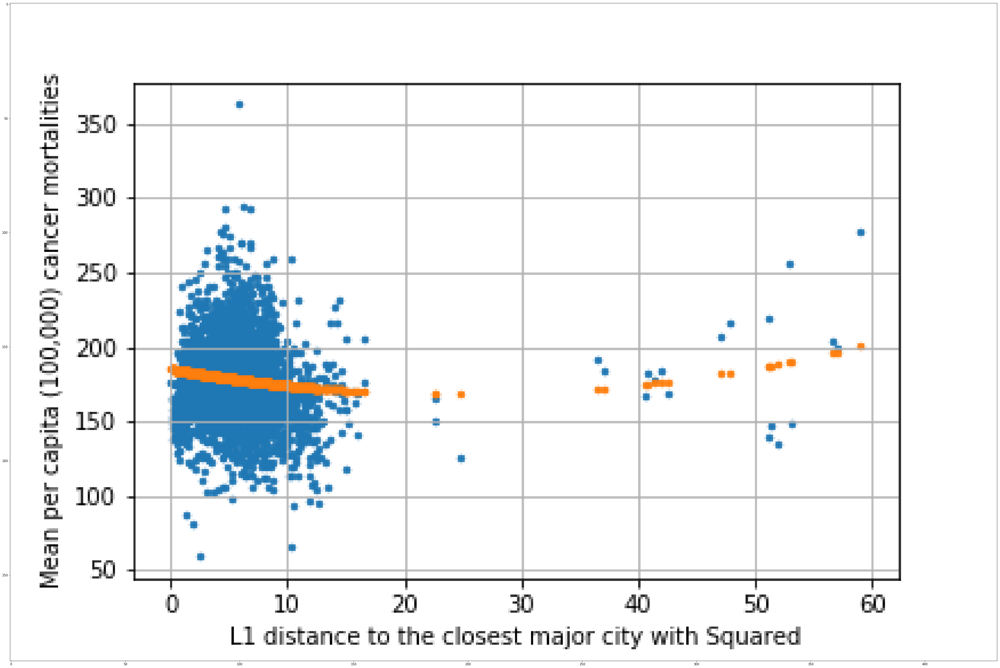

In [384]:
im_73_sq = plt.imread("city_min_distsl1_sqrd_actual_&_predicted_Y.png")
implot_73_sq = plt.imshow(im_73_sq)

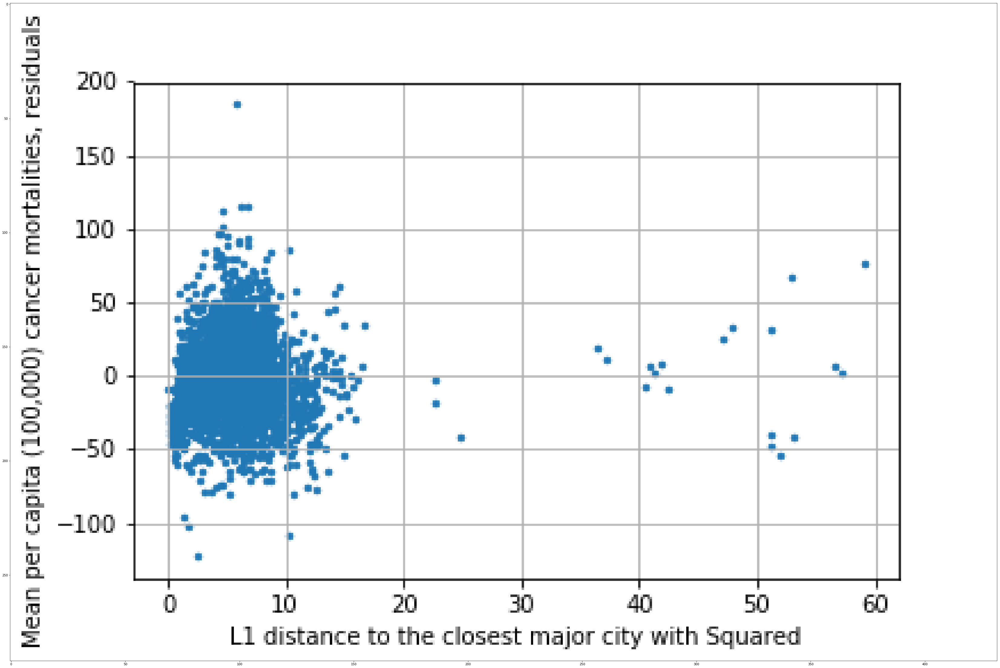

In [385]:
im_73_sqres = plt.imread("city_min_distsl1_sqrd_residuals.png")
implot_73_sqres = plt.imshow(im_73_sqres)

## 'city_min_distsl2': L2 distance to closest regional urban center

The L2 distance to the closest regional urban center ranges from 0.02 to 52.04 latitude/longitude units, and has a mean value of 4.64 with a standard deviation of 3.3. 

In [386]:
cancer.describe().city_min_distsl2

count    3047.000000
mean        4.644387
std         3.299891
min         0.022524
25%         2.914791
50%         4.334384
75%         5.799937
max        52.041722
Name: city_min_distsl2, dtype: float64

Text(0, 0.5, 'Number of Counties')

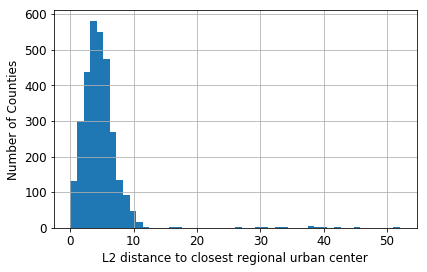

In [387]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['city_min_distsl2'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L2 distance to closest regional urban center", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a very weak negative correlation of -0.05 between the shortest L2 distance of a county to a regional urban center and cancer mortality. 

Adding a logarithmic or exponential version of 'city_min_distsl2' to the feature set did not improve the model's overall accuracy.

In [388]:
r_city_min_distsl2 = pearson_r(cancer['city_min_distsl2'], cancer['TARGET_deathRate'])
r_city_min_distsl2

-0.05270595101045524

In [389]:
cov_matrix_city_min_distsl2 = np.cov(cancer['city_min_distsl2'], cancer['TARGET_deathRate'])
cov_matrix_city_min_distsl2

array([[ 10.88928121,  -4.82665103],
       [ -4.82665103, 770.14638047]])

## 'sc_min_dists_l1': L1 distance to closest EPA Superfund Cleanup Site

The L1 distance to the closest EPA Superfund Cleanup site ranges from 0.004 to 16.62 latitude/longitude units, and has a mean value of 0.86 with a standard deviation of 0.96. 

In [390]:
cancer.describe().sc_min_dists_l1

count    3047.000000
mean        0.853315
std         0.957025
min         0.004103
25%         0.352145
50%         0.624394
75%         1.037150
max        16.617626
Name: sc_min_dists_l1, dtype: float64

Text(0, 0.5, 'Number of Counties')

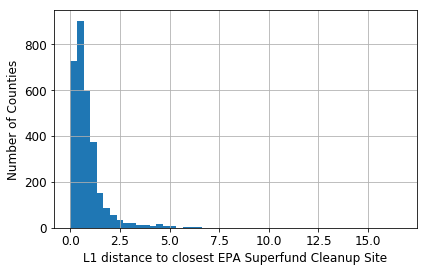

In [391]:
cancer['sc_min_dists_l1'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L1 distance to closest EPA Superfund Cleanup Site", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a very weakly negative correlation of -0.09 between the shortest L1 distance of a county to an EPA Superfund Cleanup site and cancer mortality.

In [392]:
r_sc_min_dists_l1 = pearson_r(cancer['sc_min_dists_l1'], cancer['TARGET_deathRate'])
r_sc_min_dists_l1

-0.08660196998832041

In [393]:
cov_matrix_sc_min_dists_l1 = np.cov(cancer['sc_min_dists_l1'], cancer['TARGET_deathRate'])
cov_matrix_sc_min_dists_l1

array([[  0.91589773,  -2.30005331],
       [ -2.30005331, 770.14638047]])

One can see the very weak negative correlation between the shortest L1 distance to an EPA Superfund Cleanup Site and cancer mortality in the prediction line. Adding the logarithmic transformation of the shortest L1 distance to an EPA Supefund Cleanup Site reduces the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.0003.

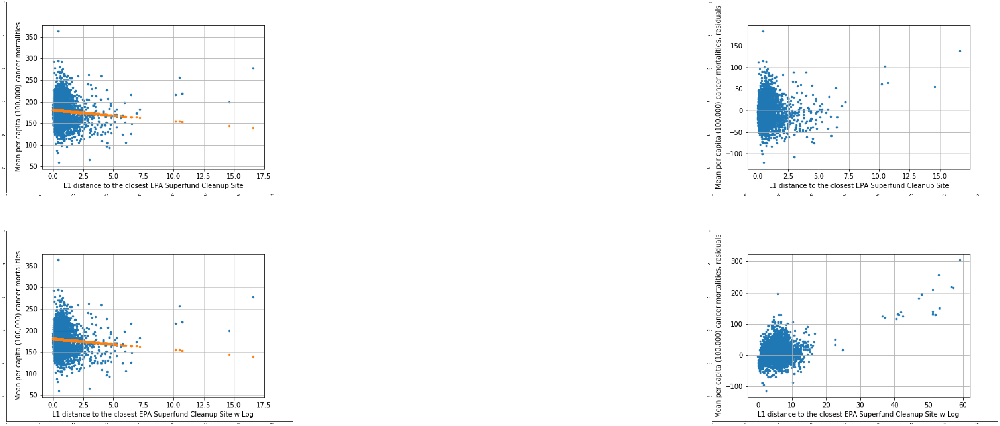

In [394]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_75_ap = plt.imread("sc_min_dists_l1_actual_&_predicted_Y.png")
implot_75_ap = plt.imshow(im_75_ap)
plt.subplot(2, 2, 2)
im_75_r = plt.imread("sc_min_dists_l1_residuals.png")
implot_75_r = plt.imshow(im_75_r)
plt.subplot(2, 2, 3)
im_75_l = plt.imread("sc_min_dists_l1_log_actual_&_predicted_Y.png")
implot_75_l = plt.imshow(im_75_l)
plt.subplot(2, 2, 4)
im_75_lres = plt.imread("sc_min_dists_l1_log_residuals.png")
implot_75_lres = plt.imshow(im_75_lres)

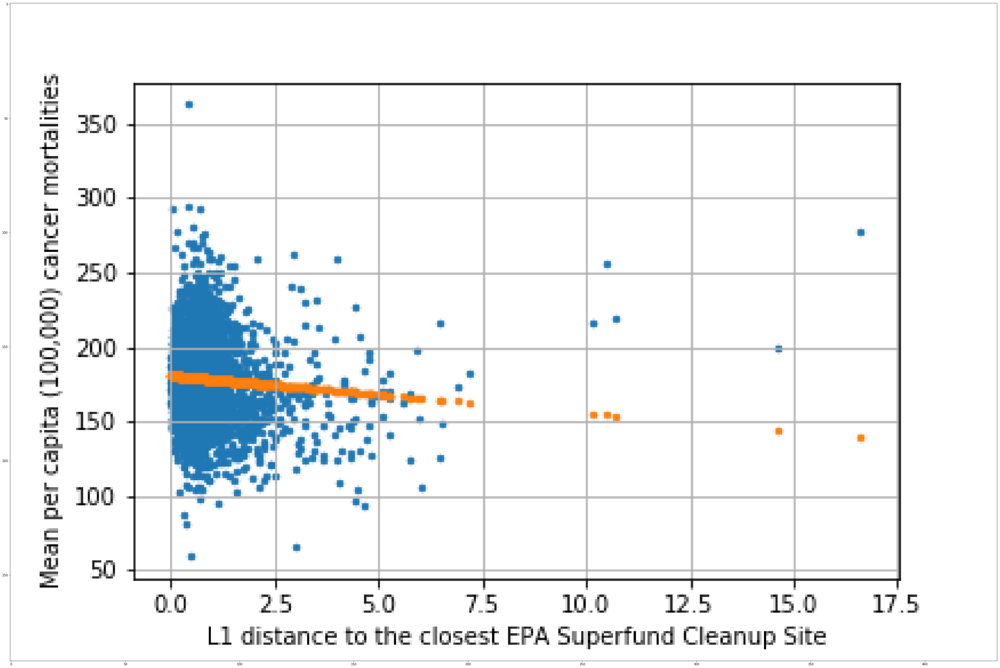

In [395]:
im_75_ap = plt.imread("sc_min_dists_l1_actual_&_predicted_Y.png")
implot_75_ap = plt.imshow(im_75_ap)

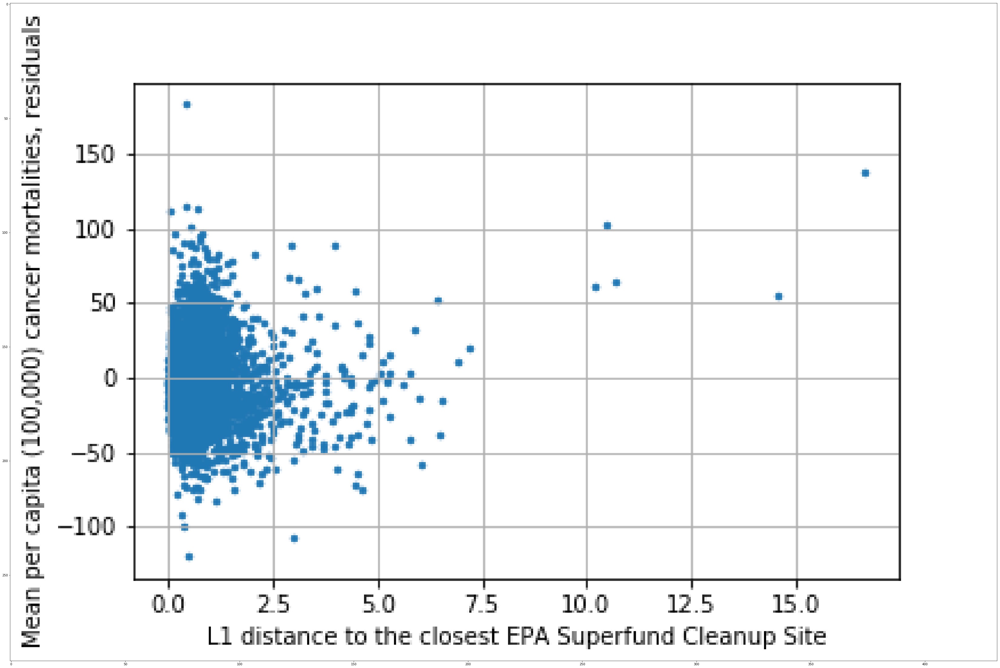

In [396]:
im_75_r = plt.imread("sc_min_dists_l1_residuals.png")
implot_75_r = plt.imshow(im_75_r)

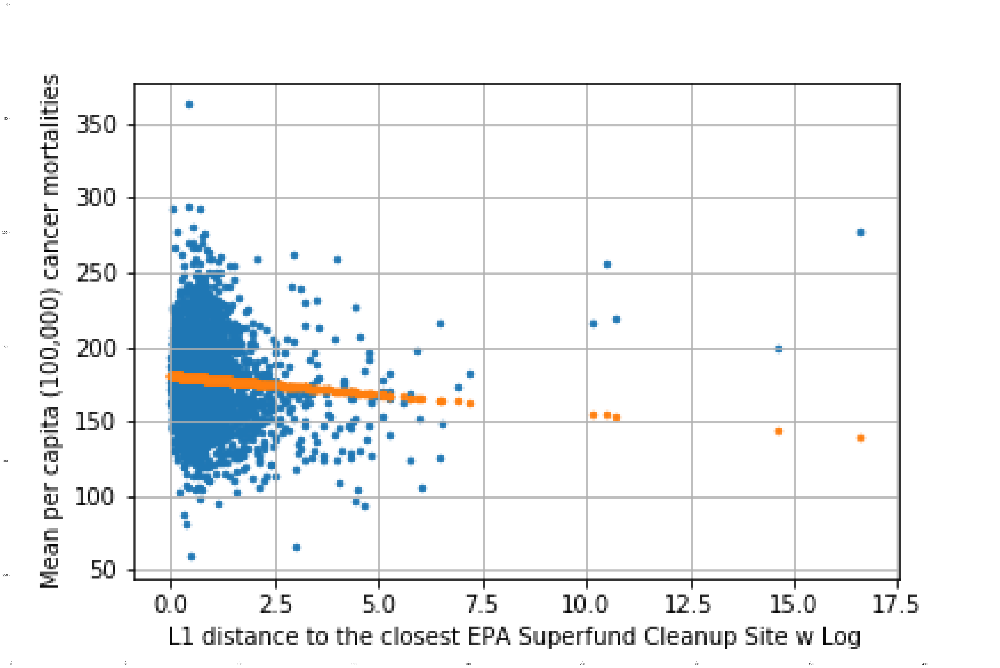

In [397]:
im_75_l = plt.imread("sc_min_dists_l1_log_actual_&_predicted_Y.png")
implot_75_l = plt.imshow(im_75_l)

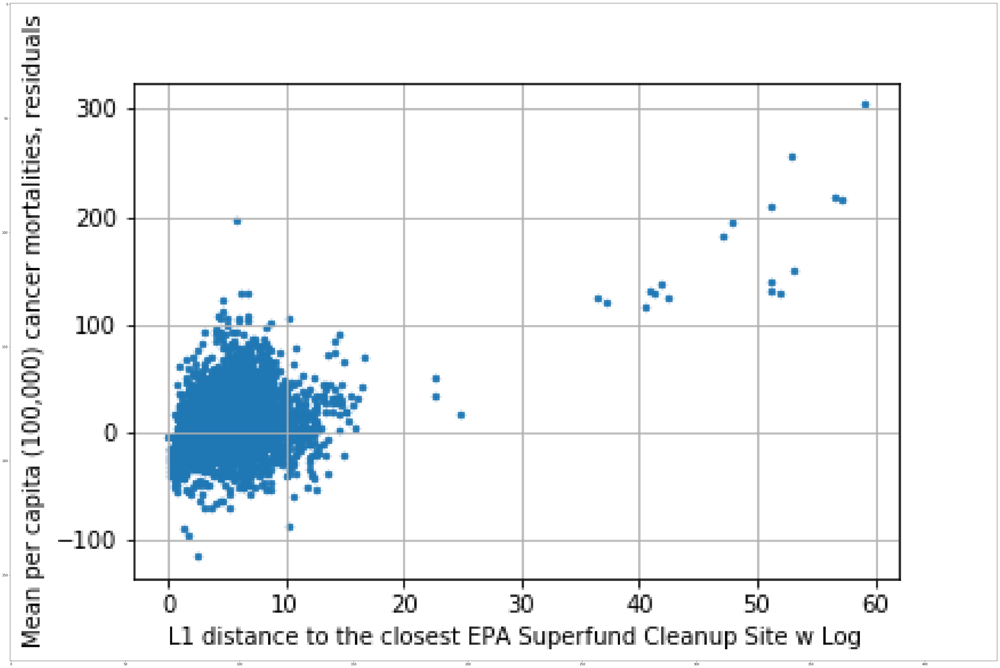

In [398]:
im_75_lres = plt.imread("sc_min_dists_l1_log_residuals.png")
implot_75_lres = plt.imshow(im_75_lres)

## 'sc_min_dists_l2': L2 distance to closest EPA Superfund Cleanup Site

The L2 distance to the closest EPA Superfund Cleanup site ranges from 0.004 to 14.82 latitude/longitude units, and has a mean value of 0.68 with a standard deviation of 0.77. 

In [399]:
cancer.describe().sc_min_dists_l2

count    3047.000000
mean        0.682306
std         0.771956
min         0.004093
25%         0.283900
50%         0.496136
75%         0.826517
max        14.823535
Name: sc_min_dists_l2, dtype: float64

Text(0, 0.5, 'Number of Counties')

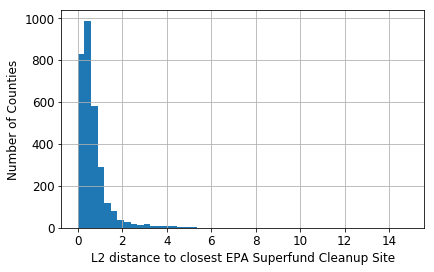

In [400]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['sc_min_dists_l2'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("L2 distance to closest EPA Superfund Cleanup Site", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a very weak negative correlation of -0.09 between the shortest L2 distance of a county to an EPA Superfund Cleanup site and cancer mortality.

Adding a logarithmic or exponential transformation of 'sc_min_dists_l2' did not add to the overall accuracy of the OLS linear regression model.

In [401]:
r_sc_min_dists_l2 = pearson_r(cancer['sc_min_dists_l2'], cancer['TARGET_deathRate'])
r_sc_min_dists_l2

-0.0847976096632344

In [402]:
cov_matrix_sc_min_dists_l2 = np.cov(cancer['sc_min_dists_l2'], cancer['TARGET_deathRate'])
cov_matrix_sc_min_dists_l2

array([[ 5.95915769e-01, -1.81661413e+00],
       [-1.81661413e+00,  7.70146380e+02]])

## 'PCT_LACCESS_POP10': Population, low access to grocery store (%), 2010

The county population percentage with low access to a grocery store (in 2010) ranges from zero to 100%, and has a mean value of 22.5% with a standard deviation of 18.22%. The counties with the lowest percentage of the county population with low access to a grocery store (in 2010) were in Wisconsin, Colorado, Virginia, Mississippi, and Tennessee. The counties with the highest percentage were in Colorado, Texas, Montana, Virginia and New Mexico.

In [403]:
cancer.describe().PCT_LACCESS_POP10

count    3047.000000
mean       22.476442
std        18.223760
min         0.000000
25%        10.757362
50%        19.407365
75%        28.919959
max       100.000001
Name: PCT_LACCESS_POP10, dtype: float64

Text(0, 0.5, 'Number of Counties')

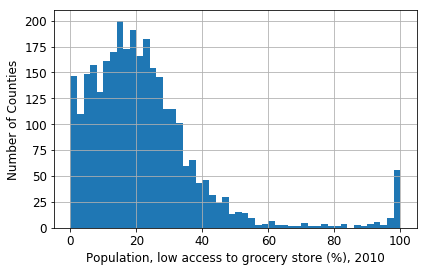

In [404]:
cancer['PCT_LACCESS_POP10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Population, low access to grocery store (%), 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [405]:
PCT_LACCESS_POP_10 = cancer.sort_values(by='PCT_LACCESS_POP10').PCT_LACCESS_POP10
PCT_LACCESS_POP_10.head()

Geography
Pepin County, Wisconsin           0.0
Gilpin County, Colorado           0.0
King George County, Virginia      0.0
Tishomingo County, Mississippi    0.0
Trousdale County, Tennessee       0.0
Name: PCT_LACCESS_POP10, dtype: float64

In [406]:
PCT_LACCESS_POP_10.tail()

Geography
Kiowa County, Colorado           100.000000
Oldham County, Texas             100.000000
Golden Valley County, Montana    100.000000
Highland County, Virginia        100.000000
Catron County, New Mexico        100.000001
Name: PCT_LACCESS_POP10, dtype: float64

There is a moderate negative correlation of -0.22 between the county population percentage with low access to a grocery store (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality decreases slightly. This is a surprising finding.

Adding a logarithmic or exponential transformation of 'PCT_LACCESS_POP10' did not add to the overall accuracy of the OLS linear regression model.

In [407]:
r_PCT_LACCESS_POP10 = pearson_r(cancer['PCT_LACCESS_POP10'], cancer['TARGET_deathRate'])
r_PCT_LACCESS_POP10

-0.22272966912706715

In [408]:
cov_matrix_PCT_LACCESS_POP10 = np.cov(cancer['PCT_LACCESS_POP10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LACCESS_POP10

array([[ 332.10544205, -112.64261066],
       [-112.64261066,  770.14638047]])

## 'PCT_LACCESS_LOWI10': Low income & low access to grocery store (%), 2010

The county population percentage with low income and low access to a grocery store (in 2010) ranges from zero to 72.3%, and has a mean value of 8% with a standard deviation of 7.5%. The counties with the lowest percentage of the county population with low income and low access to a grocery store (in 2010) were in Texas, New York, Mississippi, Virginia and Georgia. The counties with the highest percentage were in Colorado, Texas and South Dakota.

In [409]:
cancer.describe().PCT_LACCESS_LOWI10

count    3047.000000
mean        7.989026
std         7.482028
min         0.000000
25%         3.437848
50%         6.087776
75%        10.056570
max        72.274456
Name: PCT_LACCESS_LOWI10, dtype: float64

Text(0, 0.5, 'Number of Counties')

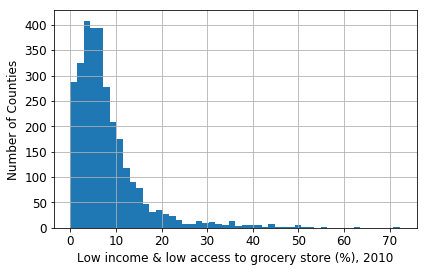

In [410]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PCT_LACCESS_LOWI10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Low income & low access to grocery store (%), 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [411]:
PCT_LACCESS_LOWI_10 = cancer.sort_values(by='PCT_LACCESS_LOWI10').PCT_LACCESS_LOWI10
PCT_LACCESS_LOWI_10.head()

Geography
Rains County, Texas               0.0
New York County, New York         0.0
Tishomingo County, Mississippi    0.0
King George County, Virginia      0.0
White County, Georgia             0.0
Name: PCT_LACCESS_LOWI10, dtype: float64

In [412]:
PCT_LACCESS_LOWI_10.tail()

Geography
Saguache County, Colorado      51.455473
Real County, Texas             52.408342
Costilla County, Colorado      55.349060
Corson County, South Dakota    62.935290
Hudspeth County, Texas         72.274456
Name: PCT_LACCESS_LOWI10, dtype: float64

There is a weak negative correlation of -0.10 between the county population percentage with low income and low access to a grocery store (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality very slightly decreases. This is a somewhat surprising finding, but less so than the 'PCT_LACCESS_10' correlation.

Adding a logarithmic or exponential expansion of 'PCT_LACCESS_LOWI10' did not add to the model's overall accuracy.

In [413]:
r_PCT_LACCESS_LOWI10 = pearson_r(cancer['PCT_LACCESS_LOWI10'], cancer['TARGET_deathRate'])
r_PCT_LACCESS_LOWI10

-0.09545233438227199

In [414]:
cov_matrix_PCT_LACCESS_LOWI10 = np.cov(cancer['PCT_LACCESS_LOWI10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LACCESS_LOWI10

array([[ 55.98074876, -19.81949319],
       [-19.81949319, 770.14638047]])

## 'PCT_LACCESS_CHILD10': Children, low access to store (%), 2010

The percentage of children with low access to a grocery store in 2010 ranges from zero to 34.02 latitude/longitude units, and has a mean value of 5.26 with a standard deviation of 4.44. 

In [415]:
cancer.describe().PCT_LACCESS_CHILD10

count    3047.000000
mean        5.263673
std         4.443704
min         0.000000
25%         2.384853
50%         4.398139
75%         6.815280
max        34.015595
Name: PCT_LACCESS_CHILD10, dtype: float64

Text(0, 0.5, 'Number of Counties')

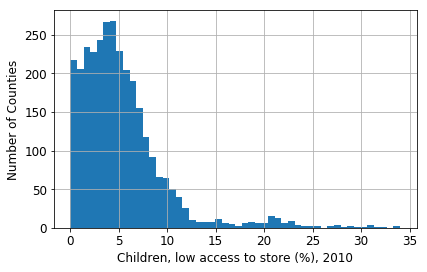

In [416]:
cancer['PCT_LACCESS_CHILD10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Children, low access to store (%), 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a weak negative correlation of -0.22 between the percentage of children with low access to a grocery store in 2010 and cancer mortality.

In [417]:
r_PCT_LACCESS_CHILD10 = pearson_r(cancer['PCT_LACCESS_CHILD10'], cancer['TARGET_deathRate'])
r_PCT_LACCESS_CHILD10

-0.2165995109836238

In [418]:
cov_matrix_PCT_LACCESS_CHILD10 = np.cov(cancer['PCT_LACCESS_CHILD10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LACCESS_CHILD10

array([[ 19.74650528, -26.71094383],
       [-26.71094383, 770.14638047]])

One can see the negative correlation between the percentage of county residents married and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformation of 'PCT_LACCESS_CHILD10' are added, and doing so increased the model's accuracy by 0.00009.

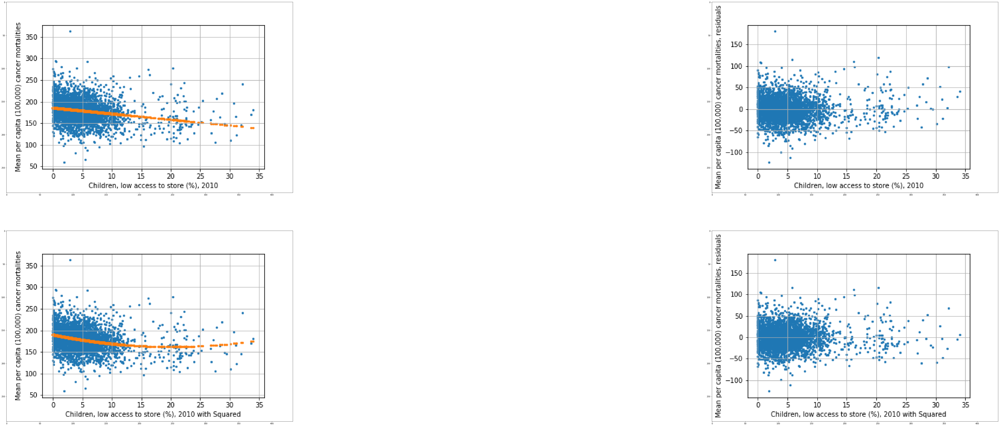

In [419]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_79_ap = plt.imread("PCT_LACCESS_CHILD10_actual_&_predicted_Y.png")
implot_79_ap = plt.imshow(im_79_ap)
plt.subplot(2, 2, 2)
im_79_r = plt.imread("PCT_LACCESS_CHILD10_residuals.png")
implot_79_r = plt.imshow(im_79_r)
plt.subplot(2, 2, 3)
im_79_sq = plt.imread("PCT_LACCESS_CHILD10_sqrd_actual_&_predicted_Y.png")
implot_79_sq = plt.imshow(im_79_sq)
plt.subplot(2, 2, 4)
im_79_sqres = plt.imread("PCT_LACCESS_CHILD10_sqrd_residuals.png")
implot_79_sqres = plt.imshow(im_79_sqres)

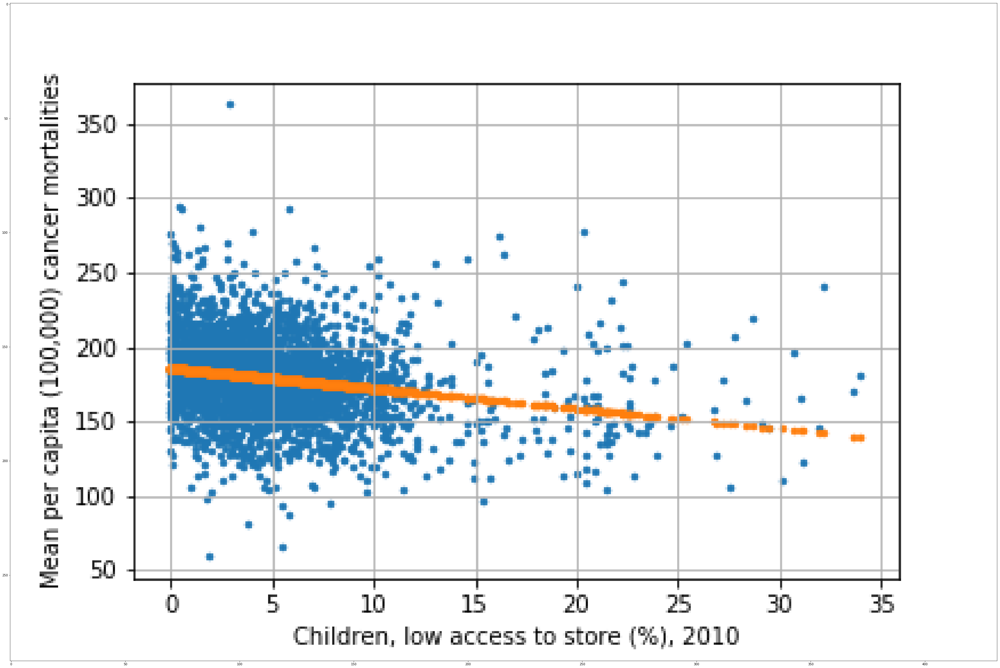

In [420]:
im_79_ap = plt.imread("PCT_LACCESS_CHILD10_actual_&_predicted_Y.png")
implot_79_ap = plt.imshow(im_79_ap)

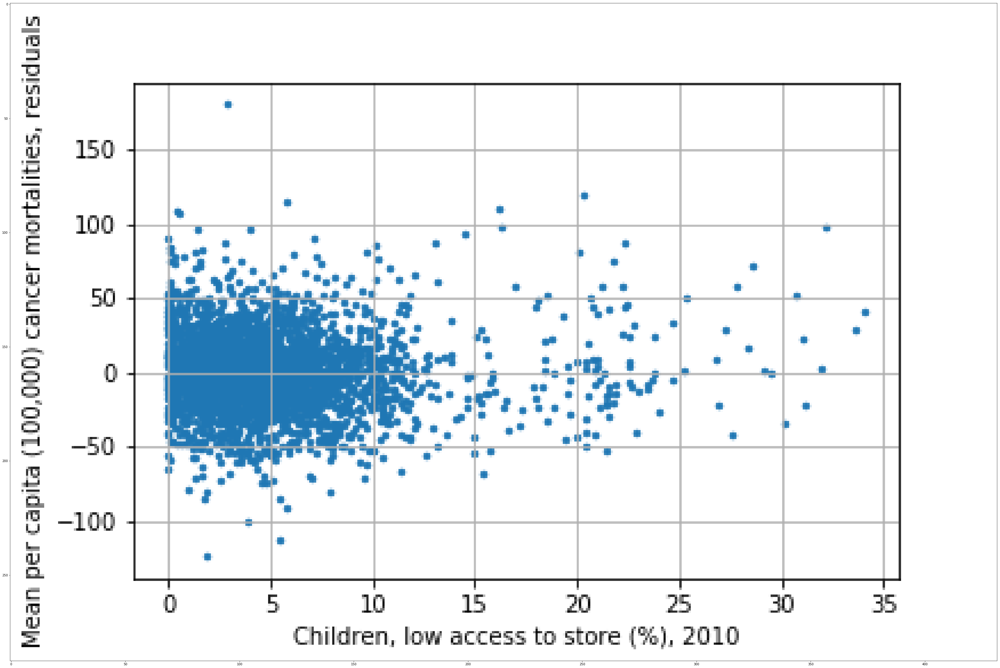

In [421]:
im_79_r = plt.imread("PCT_LACCESS_CHILD10_residuals.png")
implot_79_r = plt.imshow(im_79_r)

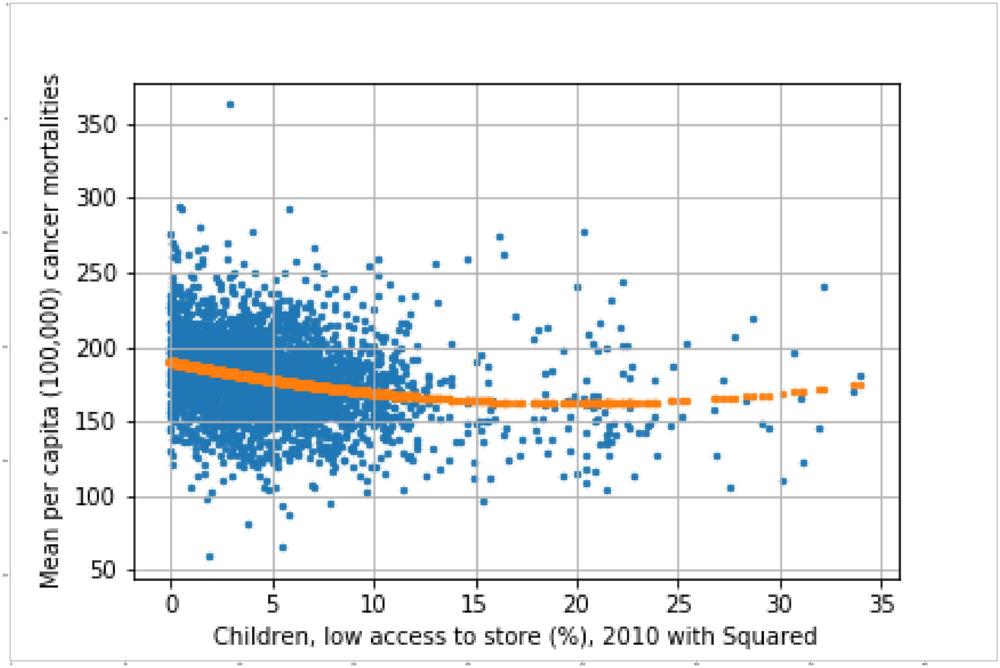

In [422]:
im_79_sq = plt.imread("PCT_LACCESS_CHILD10_sqrd_actual_&_predicted_Y.png")
implot_79_sq = plt.imshow(im_79_sq)

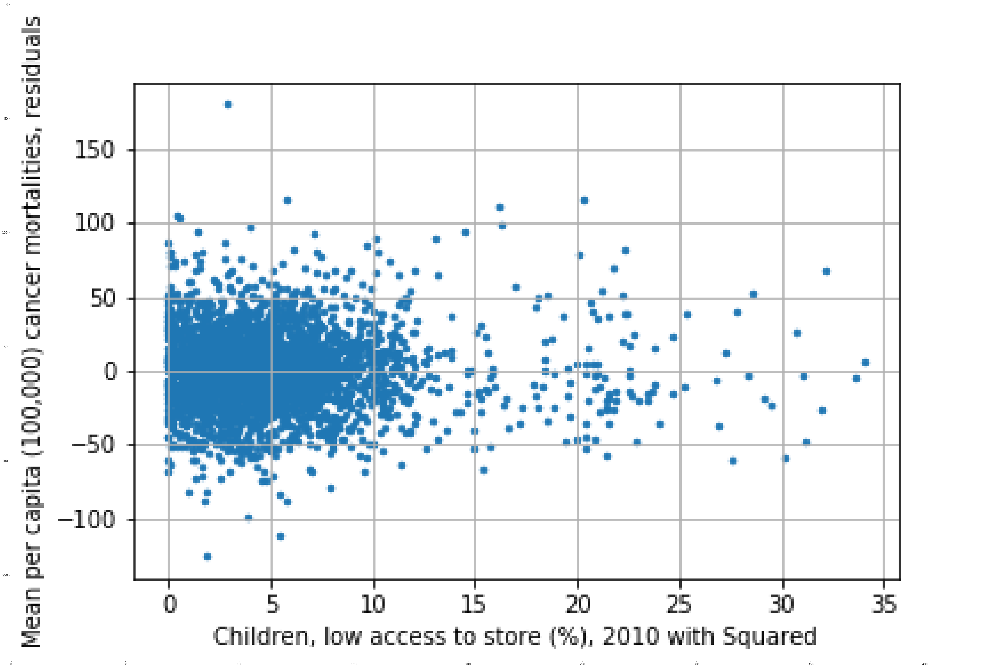

In [423]:
im_79_sqres = plt.imread("PCT_LACCESS_CHILD10_sqrd_residuals.png")
implot_79_sqres = plt.imshow(im_79_sqres)

## 'PCT_LACCESS_SENIORS10': Seniors, low access to store (%), 2010

The county population percentage of seniors with low access to a grocery store (in 2010) ranges from zero to 29.2%, and has a mean value of 3.7% with a standard deviation of 3.8%.

In [424]:
cancer.describe().PCT_LACCESS_SENIORS10

count    3047.000000
mean        3.706923
std         3.790068
min         0.000000
25%         1.575689
50%         2.804852
75%         4.409456
max        29.146426
Name: PCT_LACCESS_SENIORS10, dtype: float64

Text(0, 0.5, 'Number of Counties')

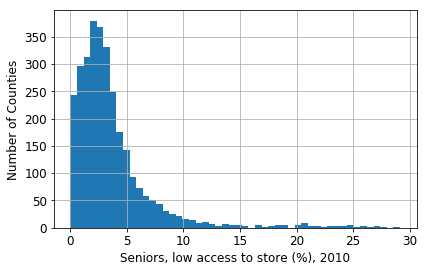

In [425]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PCT_LACCESS_SENIORS10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Seniors, low access to store (%), 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

There is a weak negative correlation of -0.21 between the county population percentage of seniors with low access to a grocery store (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality very slightly decreases. This is a somewhat surprising finding.

Adding a logarithmic or exponential expansion of 'PCT_LACCESS_SENIORS10' did not add to the model's overall accuracy.

In [426]:
r_PCT_LACCESS_SENIORS10 = pearson_r(cancer['PCT_LACCESS_SENIORS10'], cancer['TARGET_deathRate'])
r_PCT_LACCESS_SENIORS10

-0.20758122151079286

In [427]:
cov_matrix_PCT_LACCESS_SENIORS10 = np.cov(cancer['PCT_LACCESS_SENIORS10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LACCESS_SENIORS10

array([[ 14.36461561, -21.83341688],
       [-21.83341688, 770.14638047]])

## 'PCT_LACCESS_HHNV10': Households, no car & low access to store (%), 2010

The county population percentage with no car and low access to a grocery store (in 2010) ranges from zero to 60.9%, and has a mean value of 3.1% with a standard deviation of 2.8%. The counties with the lowest percentage of the county population with no car and low access to a grocery store (in 2010) were in Texas, New York, Virginia and Kansas. The counties with the highest percentage were in Ohio and Alaska.

In [428]:
cancer.describe().PCT_LACCESS_HHNV10

count    3047.000000
mean        3.101246
std         2.769818
min         0.000000
25%         1.631531
50%         2.574236
75%         3.781978
max        60.871017
Name: PCT_LACCESS_HHNV10, dtype: float64

Text(0, 0.5, 'Number of Counties')

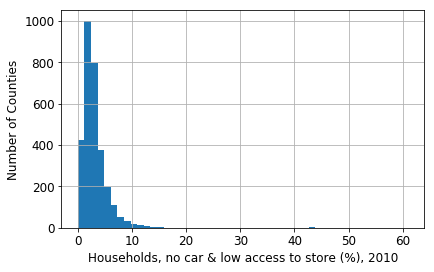

In [429]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PCT_LACCESS_HHNV10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Households, no car & low access to store (%), 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [430]:
PCT_LACCESS_HHNV_10 = cancer.sort_values(by='PCT_LACCESS_HHNV10').PCT_LACCESS_HHNV10
PCT_LACCESS_HHNV_10.head()

Geography
Reagan County, Texas           0.000000
New York County, New York      0.000000
Falls Church city, Virginia    0.000000
Kings County, New York         0.003214
Scott County, Kansas           0.012560
Name: PCT_LACCESS_HHNV10, dtype: float64

In [431]:
PCT_LACCESS_HHNV_10.tail()

Geography
Holmes County, Ohio                  29.507523
Northwest Arctic Borough, Alaska     43.670997
Nome Census Area, Alaska             43.805990
Yukon-Koyukuk Census Area, Alaska    50.178231
Bethel Census Area, Alaska           60.871017
Name: PCT_LACCESS_HHNV10, dtype: float64

There is a moderately positive correlation of 0.31 between the county population percentage with no car and low access to a grocery store (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality increases. This correlation makes more sense as one would assume that populations with low access to quality food would struggle more with cancer.

In [432]:
r_PCT_LACCESS_HHNV10 = pearson_r(cancer['PCT_LACCESS_HHNV10'], cancer['TARGET_deathRate'])
r_PCT_LACCESS_HHNV10

0.3138738176995286

In [433]:
cov_matrix_PCT_LACCESS_HHNV10 = np.cov(cancer['PCT_LACCESS_HHNV10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LACCESS_HHNV10

array([[  7.67189122,  24.12642353],
       [ 24.12642353, 770.14638047]])

One can see the moderately positive correlation between the percentage of county residents with no car and low access to a grocery store and cancer mortality in the prediction line. Adding the squared transformation of the percentage of county residents with no car and low access to a grocery store reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.00009.

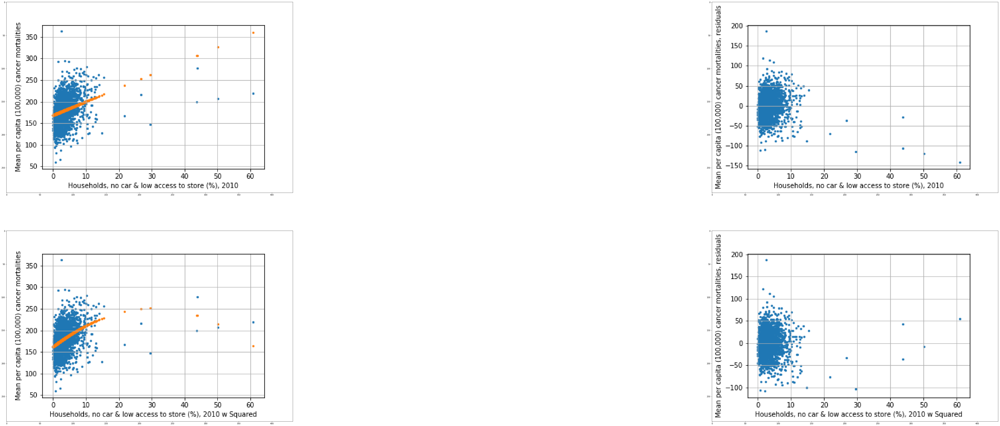

In [434]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_81_ap = plt.imread("PCT_LACCESS_HHNV10_actual_&_predicted_Y.png")
implot_81_ap = plt.imshow(im_81_ap)
plt.subplot(2, 2, 2)
im_81_r = plt.imread("PCT_LACCESS_HHNV10_residuals.png")
implot_81_r = plt.imshow(im_81_r)
plt.subplot(2, 2, 3)
im_81_sq = plt.imread("PCT_LACCESS_HHNV10_sqrd_actual_&_predicted_Y.png")
implot_81_sq = plt.imshow(im_81_sq)
plt.subplot(2, 2, 4)
im_81_sqres = plt.imread("PCT_LACCESS_HHNV10_sqrd_residuals.png")
implot_81_sqres = plt.imshow(im_81_sqres)

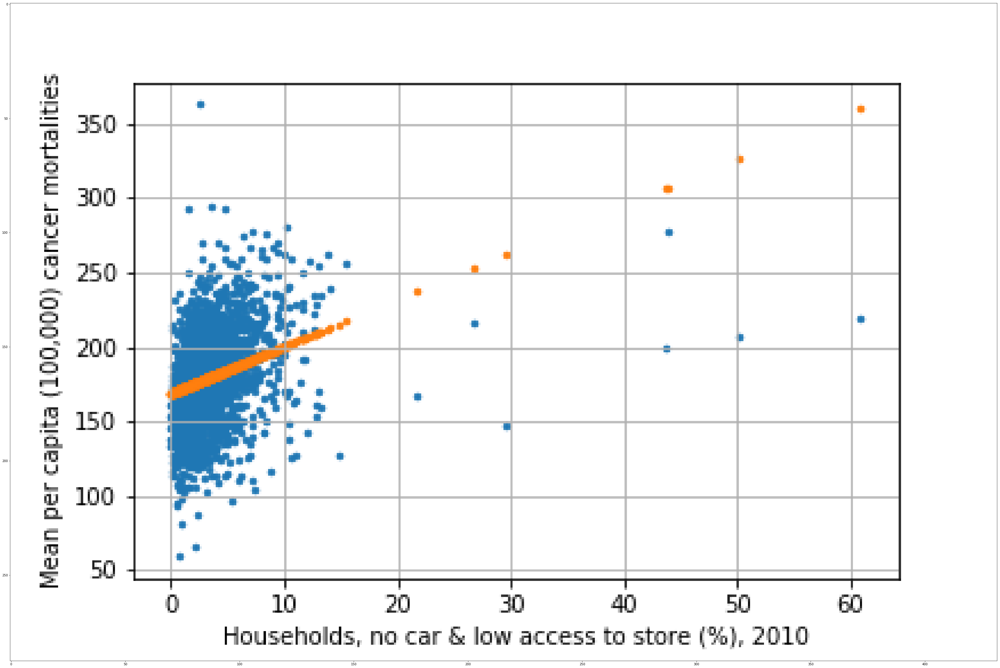

In [435]:
im_81_ap = plt.imread("PCT_LACCESS_HHNV10_actual_&_predicted_Y.png")
implot_81_ap = plt.imshow(im_81_ap)

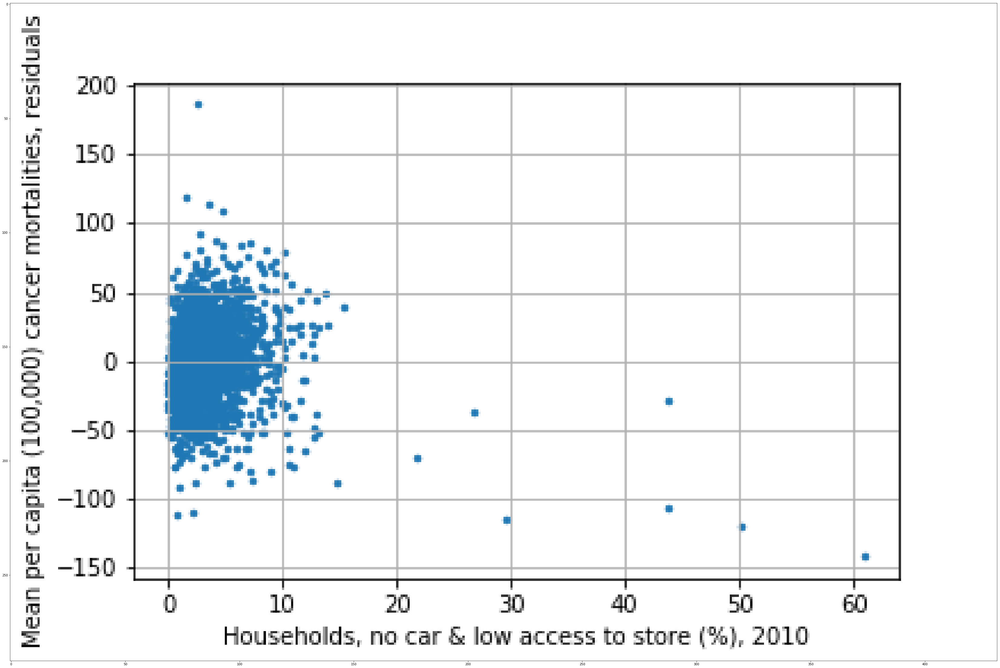

In [436]:
im_81_r = plt.imread("PCT_LACCESS_HHNV10_residuals.png")
implot_81_r = plt.imshow(im_81_r)

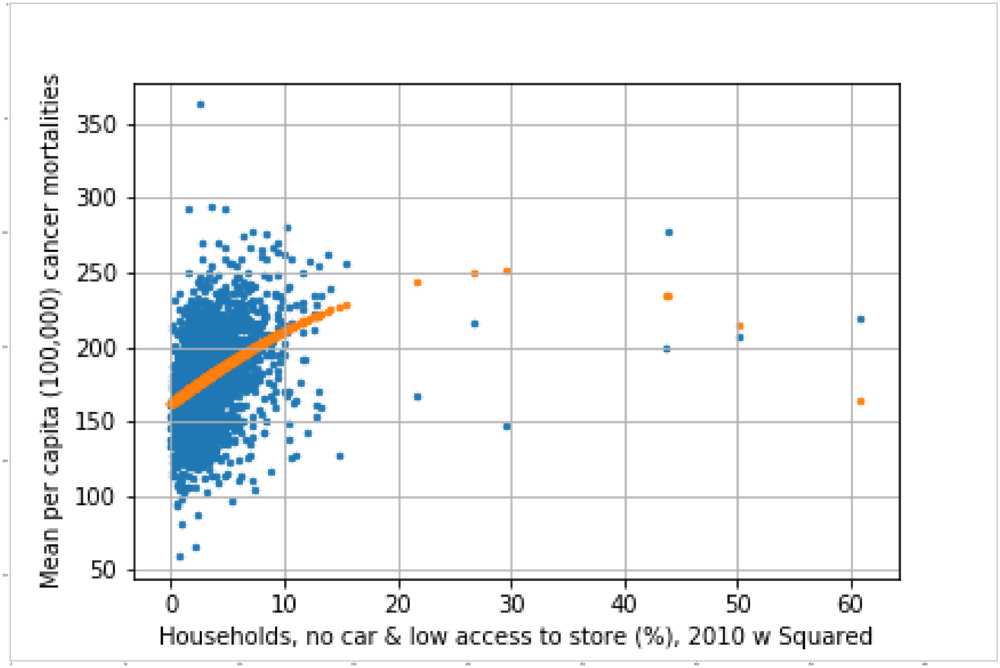

In [437]:
im_81_sq = plt.imread("PCT_LACCESS_HHNV10_sqrd_actual_&_predicted_Y.png")
implot_81_sq = plt.imshow(im_81_sq)

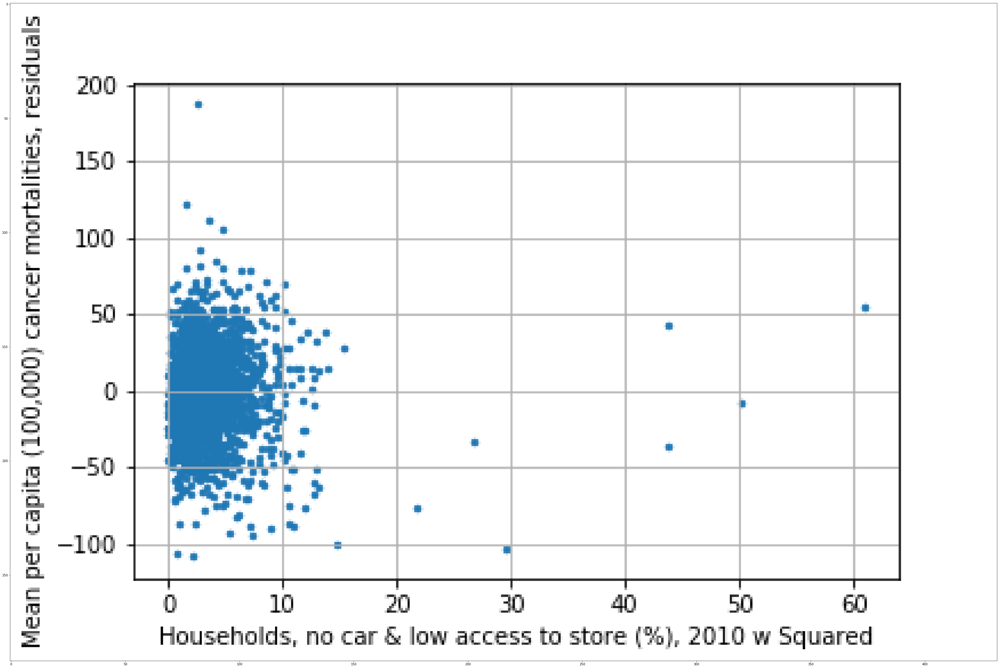

In [438]:
im_81_sqres = plt.imread("PCT_LACCESS_HHNV10_sqrd_residuals.png")
implot_81_sqres = plt.imshow(im_81_sqres)

## 'FOODINSEC_10_12': Household food insecurity (%, three-year average), 2010-12

The three-year average county population percentage with household food insecurity (2010-2012) ranges from 8.7% to 20.9%, and has a mean value of 14.8% with a standard deviation of 2.7%. The counties with the lowest percentage were in North Dakota. The counties with the highest percentage were in Mississippi and North Dakota.

In [439]:
cancer.describe().FOODINSEC_10_12

count    3047.000000
mean       14.774762
std         2.690049
min         8.700000
25%        13.000000
50%        14.800000
75%        16.700000
max        20.900000
Name: FOODINSEC_10_12, dtype: float64

Text(0, 0.5, 'Number of Counties')

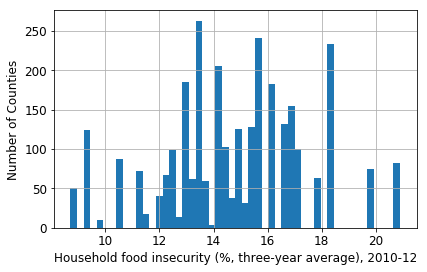

In [440]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['FOODINSEC_10_12'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Household food insecurity (%, three-year average), 2010-12", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [441]:
FOOD_INSEC_10_12 = cancer.sort_values(by='FOODINSEC_10_12').FOODINSEC_10_12
FOOD_INSEC_10_12.head()

Geography
Williams County, North Dakota    8.7
McHenry County, North Dakota     8.7
Sioux County, North Dakota       8.7
Sargent County, North Dakota     8.7
Rolette County, North Dakota     8.7
Name: FOODINSEC_10_12, dtype: float64

In [442]:
FOOD_INSEC_10_12.tail()

Geography
Union County, Mississippi       20.9
Walthall County, Mississippi    20.9
Coahoma County, Mississippi     20.9
Harrison County, Missouri       20.9
Griggs County, North Dakota     20.9
Name: FOODINSEC_10_12, dtype: float64

There is a weakly positive correlation of 0.18 between the three-year average county population percentage with household food insecurity (2010-2012) and cancer mortality. Therefore, as this percentage increases, cancer mortality increases slightly. 

Adding a logarithmic or exponential expansion of 'FOODINSEC_10_12' did not add to the model's overall accuracy.

In [443]:
r_FOODINSEC_10_12 = pearson_r(cancer['FOODINSEC_10_12'], cancer['TARGET_deathRate'])
r_FOODINSEC_10_12

0.17914608291967124

In [444]:
cov_matrix_FOODINSEC_10_12 = np.cov(cancer['FOODINSEC_10_12'], cancer['TARGET_deathRate'])
cov_matrix_FOODINSEC_10_12

array([[  7.23636546,  13.37378084],
       [ 13.37378084, 770.14638047]])

## 'CH_FOODINSEC_09_12': Household food insecurity (change %), 2007-09 to 2010-12

The percentage change of household food insecurity from 2007-2009 to 2010-2012 ranges from -0.9% to 5.7%, and has a mean value of 1.3% with a standard deviation of 1.2%. The counties with the lowest percentage change were all in Vermont. The counties with the highest percentage change were in Louisiana and North Carolina.

In [445]:
cancer.describe().CH_FOODINSEC_09_12

count    3047.000000
mean        1.308270
std         1.152583
min        -0.900000
25%         0.600000
50%         1.100000
75%         1.900000
max         5.700000
Name: CH_FOODINSEC_09_12, dtype: float64

Text(0, 0.5, 'Number of Counties')

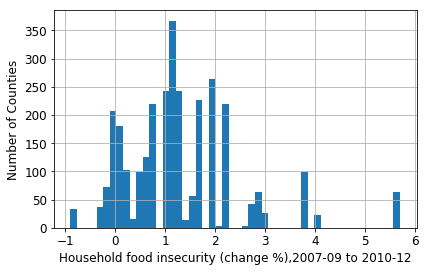

In [446]:
cancer['CH_FOODINSEC_09_12'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Household food insecurity (change %),2007-09 to 2010-12", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [447]:
CH_FOOD_INSEC_09_12 = cancer.sort_values(by='CH_FOODINSEC_09_12').CH_FOODINSEC_09_12
CH_FOOD_INSEC_09_12.head()

Geography
Chittenden County, Vermont   -0.9
Caledonia County, Vermont    -0.9
Orleans County, Vermont      -0.9
Windsor County, Vermont      -0.9
Windham County, Vermont      -0.9
Name: CH_FOODINSEC_09_12, dtype: float64

In [448]:
CH_FOOD_INSEC_09_12.tail()

Geography
Winn Parish, Louisiana              5.7
Granville County, North Carolina    5.7
Concordia Parish, Louisiana         5.7
Plaquemines Parish, Louisiana       5.7
West Feliciana Parish, Louisiana    5.7
Name: CH_FOODINSEC_09_12, dtype: float64

There is a weakly positive correlation of 0.12 between the percentage change of household food insecurity from 2007-2009 to 2010-2012 and cancer mortality. Therefore, as this percentage increases, cancer mortality slightly increases. 

Adding a logarithmic or exponential expansion of 'CH_FOODINSEC_09_12' did not add to the model's overall accuracy.

In [449]:
r_CH_FOODINSEC_09_12 = pearson_r(cancer['CH_FOODINSEC_09_12'], cancer['TARGET_deathRate'])
r_CH_FOODINSEC_09_12

0.1212140278989795

In [450]:
cov_matrix_CH_FOODINSEC_09_12 = np.cov(cancer['CH_FOODINSEC_09_12'], cancer['TARGET_deathRate'])
cov_matrix_CH_FOODINSEC_09_12

array([[  1.32844766,   3.87714235],
       [  3.87714235, 770.14638047]])

## 'PCT_LOCLFARM07': Farms with direct sales (%), 2007

The percentage of farms with direct sales (in 2007) ranges from zero to 100%, with a mean value of 6.5% and a standard deviation of 6%. The counties with the lowest percentage were in Colorado, North Dakota, South Dakota and Kansas. The counties with the highest percentage were in New York, Louisiana, Minnesota and Virginia.

In [451]:
cancer.describe().PCT_LOCLFARM07

count    3047.000000
mean        6.466885
std         5.948934
min         0.000000
25%         2.900000
50%         4.700000
75%         8.000000
max       100.000000
Name: PCT_LOCLFARM07, dtype: float64

Text(0, 0.5, 'Number of Counties')

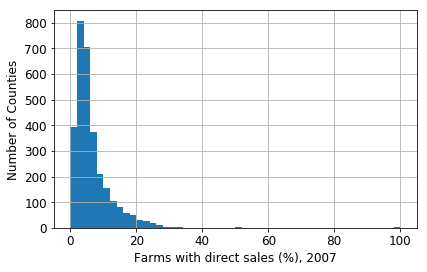

In [452]:
cancer['PCT_LOCLFARM07'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Farms with direct sales (%), 2007", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [453]:
PCT_LOCL_FARM_07 = cancer.sort_values(by='PCT_LOCLFARM07').PCT_LOCLFARM07
PCT_LOCL_FARM_07.head()

Geography
Broomfield County, Colorado      0.0
McIntosh County, North Dakota    0.2
Divide County, North Dakota      0.2
Dewey County, South Dakota       0.2
Hamilton County, Kansas          0.2
Name: PCT_LOCLFARM07, dtype: float64

In [454]:
PCT_LOCL_FARM_07.tail()

Geography
Queens County, New York        50.0
Orleans Parish, Louisiana      50.0
Ramsey County, Minnesota       53.3
Arlington County, Virginia    100.0
Kings County, New York        100.0
Name: PCT_LOCLFARM07, dtype: float64

There is a very weakly negative correlation of -0.09 between the percentage of farms with direct sales (in 2007) and cancer mortality.

Adding a logarithmic or exponential expansion of 'PCT_LOCLFARM07' did not add to the model's overall accuracy. 

In [455]:
r_PCT_LOCLFARM07 = pearson_r(cancer['PCT_LOCLFARM07'], cancer['TARGET_deathRate'])
r_PCT_LOCLFARM07

-0.08936607459125287

In [456]:
cov_matrix_PCT_LOCLFARM07 = np.cov(cancer['PCT_LOCLFARM07'], cancer['TARGET_deathRate'])
cov_matrix_PCT_LOCLFARM07

array([[ 35.38981902, -14.75361656],
       [-14.75361656, 770.14638047]])

## 'PC_DIRSALES07': Direct farm sales per capita, 2007

The number of direct farm sales per capita (in 2007) ranges from zero to 178.3, with a mean value of 7.5 and a standard deviation of 10.6. The counties with the lowest percentage were in New York, Georgia, Minnesota, Kentucky and Louisiana. The counties with the highest percentage were in Montana, Tennessee, California, Vermont and South Dakota.

In [457]:
cancer.describe().PC_DIRSALES07

count    3047.000000
mean        7.485832
std        10.575292
min         0.000000
25%         2.050000
50%         4.330000
75%         8.905000
max       178.310000
Name: PC_DIRSALES07, dtype: float64

Text(0, 0.5, 'Number of Counties')

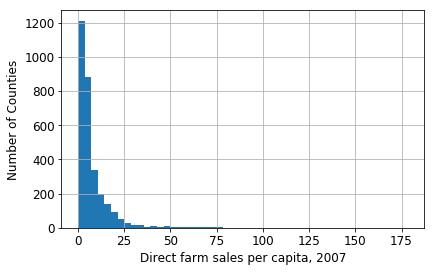

In [458]:
cancer['PC_DIRSALES07'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Direct farm sales per capita, 2007", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [459]:
PC_DIRSALES_07 = cancer.sort_values(by='PC_DIRSALES07').PC_DIRSALES07
PC_DIRSALES_07.head()

Geography
New York County, New York             0.0
DeKalb County, Georgia                0.0
Cook County, Minnesota                0.0
Knott County, Kentucky                0.0
West Baton Rouge Parish, Louisiana    0.0
Name: PC_DIRSALES07, dtype: float64

In [460]:
PC_DIRSALES_07.tail()

Geography
Judith Basin County, Montana     95.10
Bledsoe County, Tennessee       100.80
Glenn County, California        110.27
Addison County, Vermont         148.19
Tripp County, South Dakota      178.31
Name: PC_DIRSALES07, dtype: float64

There is a weak negative correlation of -0.11 between the number of direct farm sales per capita (in 2007) and cancer mortality. Therefore, as this number increases, cancer mortality slightly decreases. 

In [461]:
r_PC_DIRSALES07 = pearson_r(cancer['PC_DIRSALES07'], cancer['TARGET_deathRate'])
r_PC_DIRSALES07

-0.1100128674055045

In [462]:
cov_matrix_PC_DIRSALES07 = np.cov(cancer['PC_DIRSALES07'], cancer['TARGET_deathRate'])
cov_matrix_PC_DIRSALES07

array([[111.83680416, -32.28661372],
       [-32.28661372, 770.14638047]])

One can see the weakly negative correlation between the number of direct farm sales per capita (in 2007) and cancer mortality in the prediction line. Adding the squared transformation reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.00009.

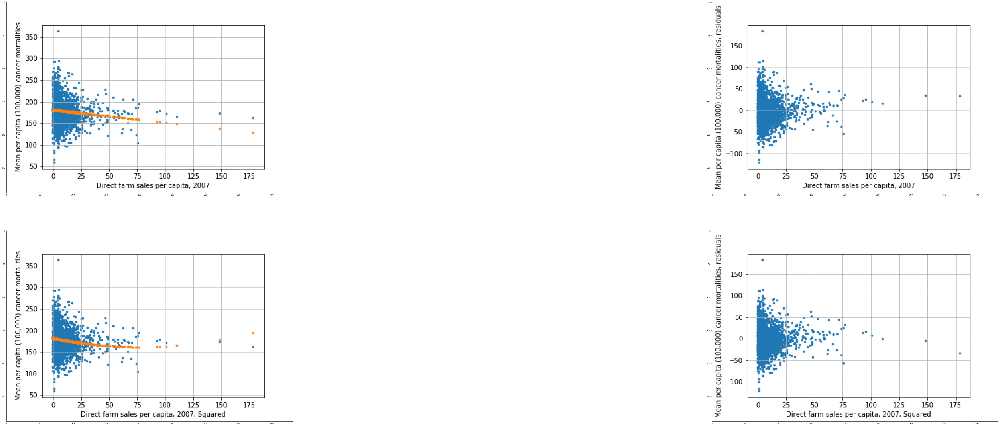

In [463]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_88_ap = plt.imread("PC_DIRSALES07_actual_&_predicted_Y.png")
implot_88_ap = plt.imshow(im_88_ap)
plt.subplot(2, 2, 2)
im_88_r = plt.imread("PC_DIRSALES07_residuals.png")
implot_88_r = plt.imshow(im_88_r)
plt.subplot(2, 2, 3)
im_88_sq = plt.imread("PC_DIRSALES07_squared_actual_&_predicted_Y.png")
implot_88_sq = plt.imshow(im_88_sq)
plt.subplot(2, 2, 4)
im_88_sqres = plt.imread("PC_DIRSALES07_squared_residuals.png")
implot_88_sqres = plt.imshow(im_88_sqres)

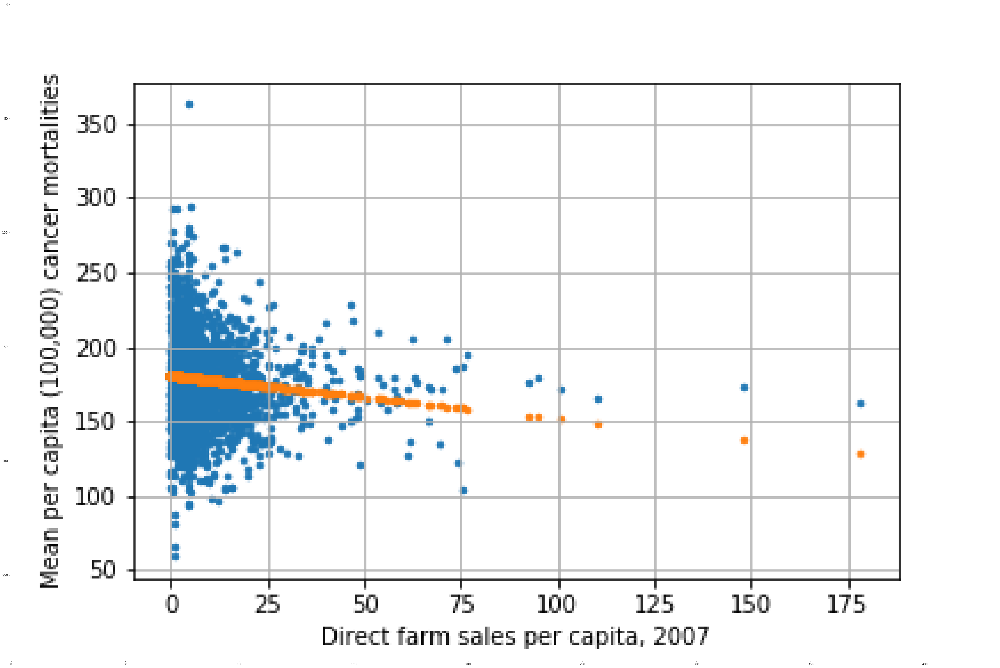

In [464]:
im_88_ap = plt.imread("PC_DIRSALES07_actual_&_predicted_Y.png")
implot_88_ap = plt.imshow(im_88_ap)

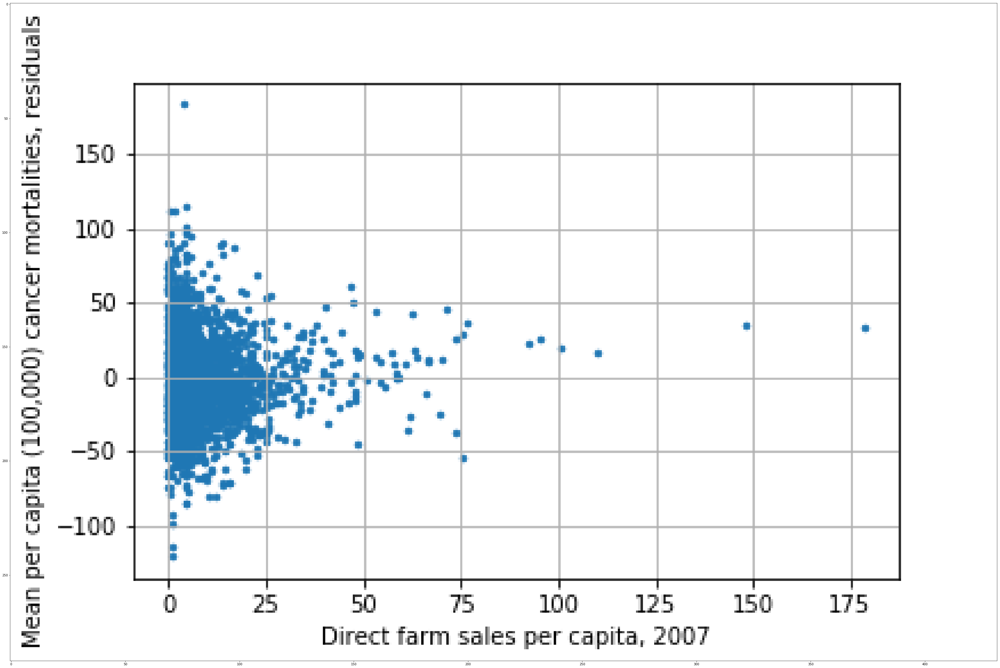

In [465]:
im_88_r = plt.imread("PC_DIRSALES07_residuals.png")
implot_88_r = plt.imshow(im_88_r)

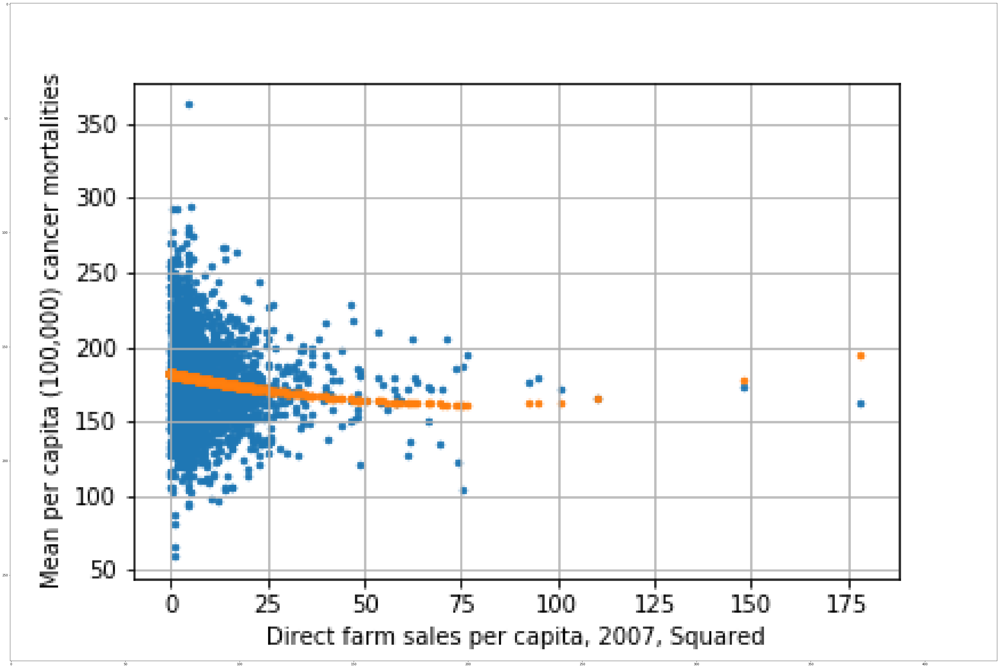

In [466]:
im_88_sq = plt.imread("PC_DIRSALES07_squared_actual_&_predicted_Y.png")
implot_88_sq = plt.imshow(im_88_sq)

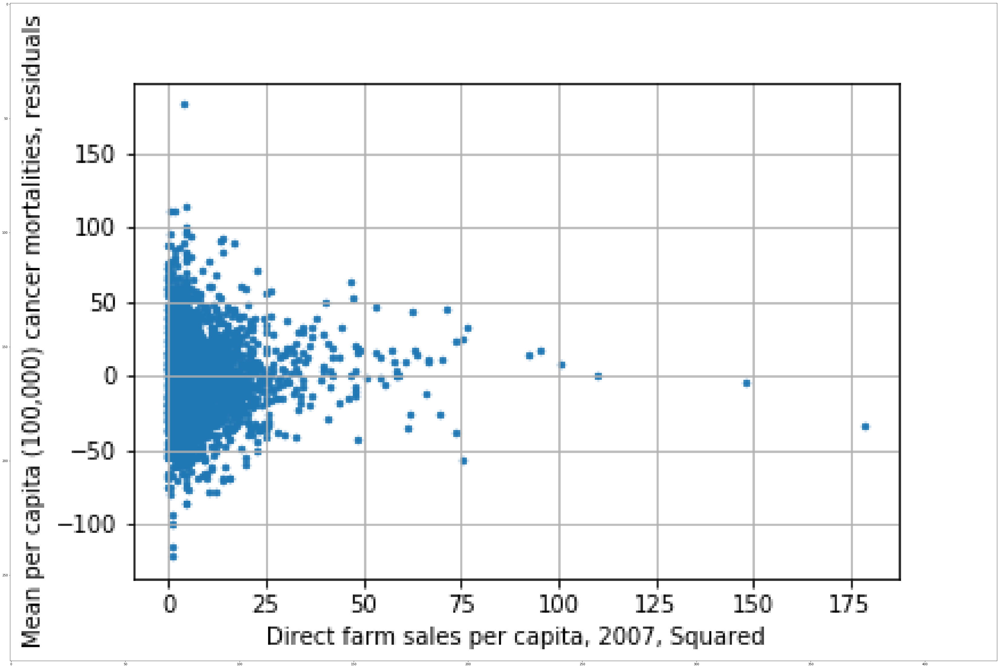

In [467]:
im_88_sqres = plt.imread("PC_DIRSALES07_squared_residuals.png")
implot_88_sqres = plt.imshow(im_88_sqres)

## 'FMRKT13': Farmers' markets, 2013

The number of farmers' markets per county (in 2013) ranges from zero to 131, with a mean value of 2.6 and a standard deviation of 5.7. The counties with the lowest number of farmers' markets (in 2013) were in Kansas, Illinois, Mississippi and Texas. The counties with the highest percentage were in Colorado, Massachusetts and Illinois.

In [468]:
cancer.describe().FMRKT13

count    3047.000000
mean        2.639974
std         5.723609
min         0.000000
25%         0.000000
50%         1.000000
75%         3.000000
max       131.000000
Name: FMRKT13, dtype: float64

Text(0, 0.5, 'Number of Counties')

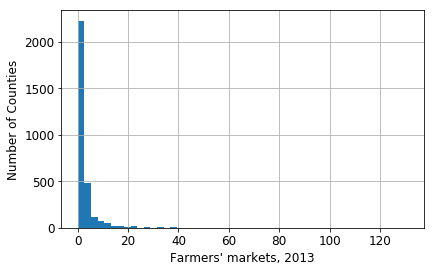

In [469]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['FMRKT13'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Farmers' markets, 2013", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [470]:
FMRKT_13 = cancer.sort_values(by='FMRKT13').FMRKT13
FMRKT_13.head()

Geography
Lane County, Kansas           0
Kendall County, Illinois      0
Kemper County, Mississippi    0
Kearny County, Kansas         0
Karnes County, Texas          0
Name: FMRKT13, dtype: int64

In [471]:
FMRKT_13.tail()

Geography
San Diego County, California        50
Middlesex County, Massachusetts     55
Worcester County, Massachusetts     56
Los Angeles County, California     117
Cook County, Illinois              131
Name: FMRKT13, dtype: int64

There is a weakly negative correlation of -0.14 between the number of farmers' markets per county (in 2013) and cancer mortality. Therefore, as this number increases, cancer mortality slightly decreases.

In [472]:
r_FMRKT13 = pearson_r(cancer['FMRKT13'], cancer['TARGET_deathRate'])
r_FMRKT13

-0.1420092127080557

In [473]:
cov_matrix_FMRKT13 = np.cov(cancer['FMRKT13'], cancer['TARGET_deathRate'])
cov_matrix_FMRKT13

array([[ 32.75970164, -22.5565735 ],
       [-22.5565735 , 770.14638047]])

One can see the weakly negative correlation between the number of farmers' markets per county (in 2013) and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformations of 'FMRKT13' are added, and doing so increased the model's accuracy by 0.0005.

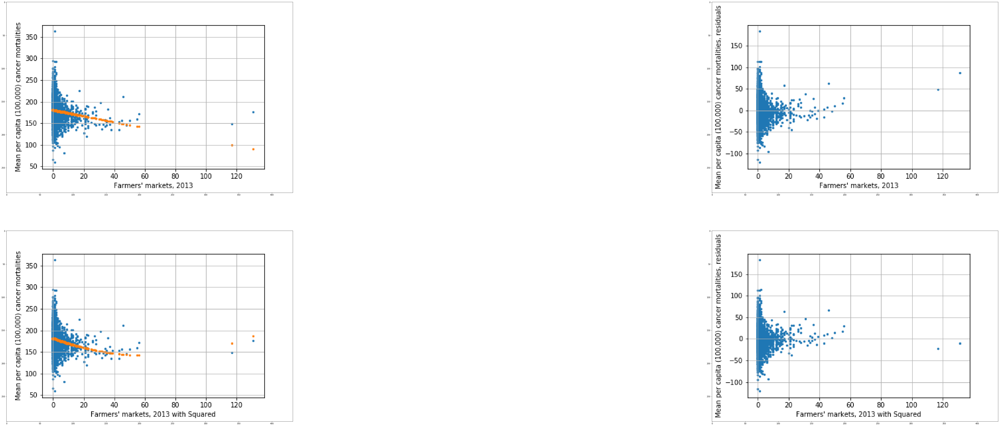

In [474]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_89_ap = plt.imread("FMRKT13_actual_&_predicted_Y.png")
implot_89_ap = plt.imshow(im_89_ap)
plt.subplot(2, 2, 2)
im_89_r = plt.imread("FMRKT13_residuals.png")
implot_89_r = plt.imshow(im_89_r)
plt.subplot(2, 2, 3)
im_89_sq = plt.imread("FMRKT13_sqrd_actual_&_predicted_Y.png")
implot_89_sq = plt.imshow(im_89_sq)
plt.subplot(2, 2, 4)
im_89_sqres = plt.imread("FMRKT13_sqrd_residuals.png")
implot_89_sqres = plt.imshow(im_89_sqres)

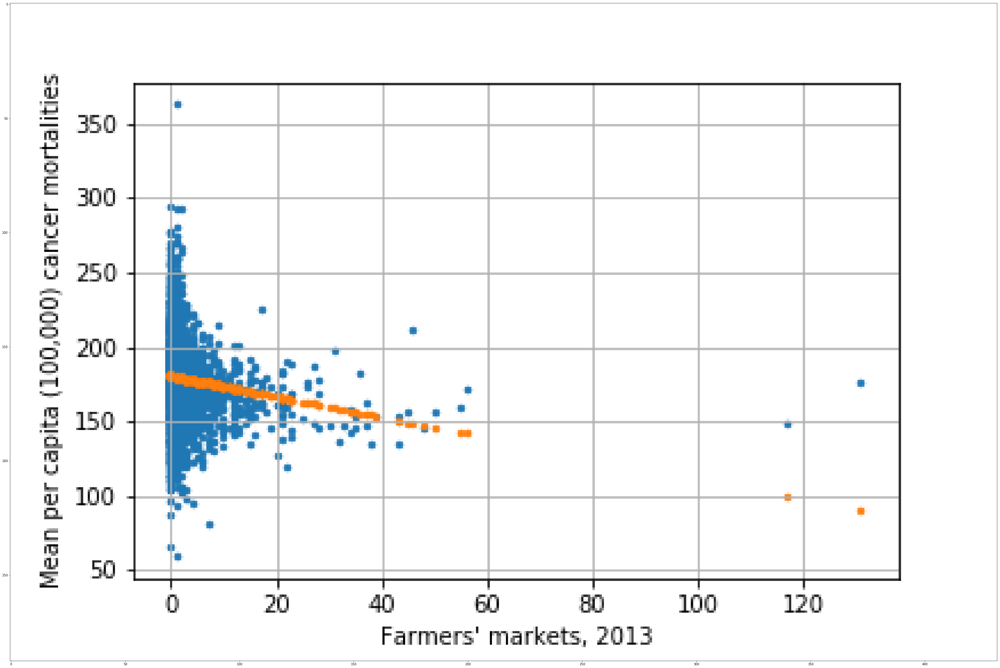

In [475]:
im_89_ap = plt.imread("FMRKT13_actual_&_predicted_Y.png")
implot_89_ap = plt.imshow(im_89_ap)

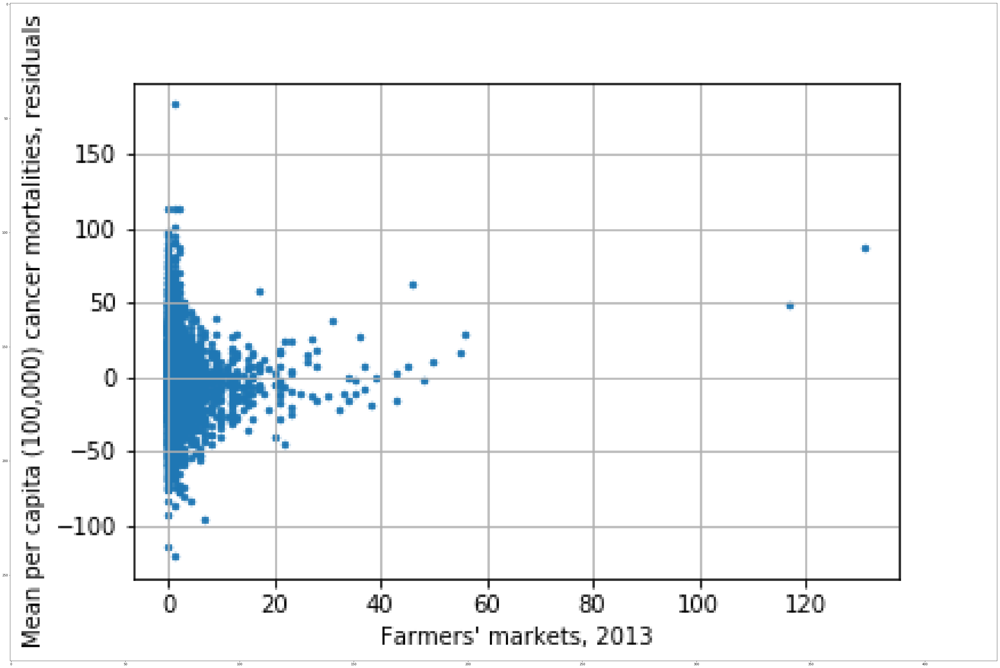

In [476]:
im_89_r = plt.imread("FMRKT13_residuals.png")
implot_89_r = plt.imshow(im_89_r)

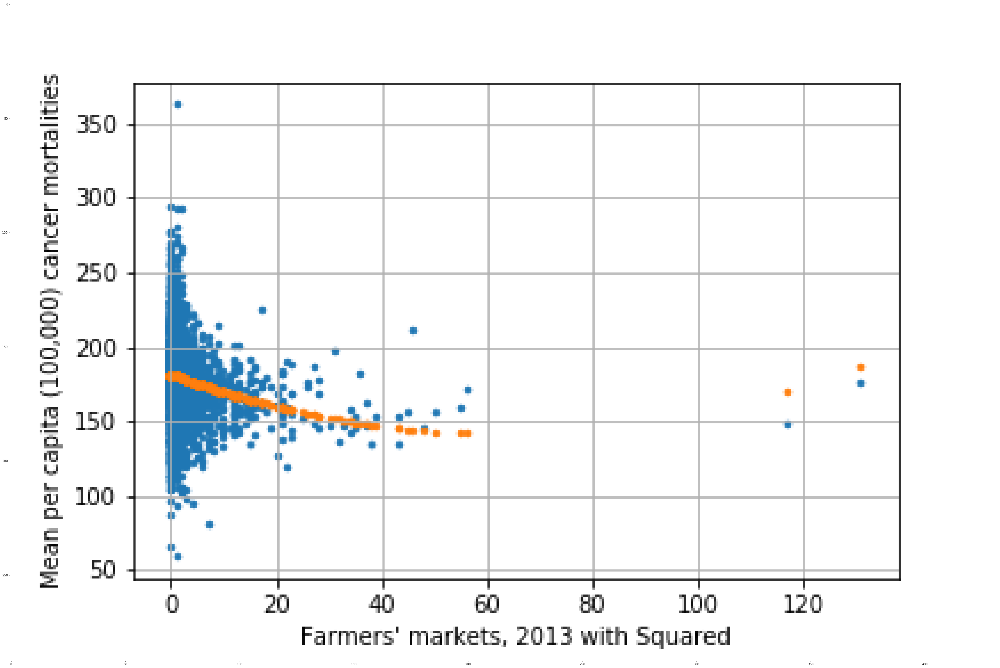

In [477]:
im_89_sq = plt.imread("FMRKT13_sqrd_actual_&_predicted_Y.png")
implot_89_sq = plt.imshow(im_89_sq)

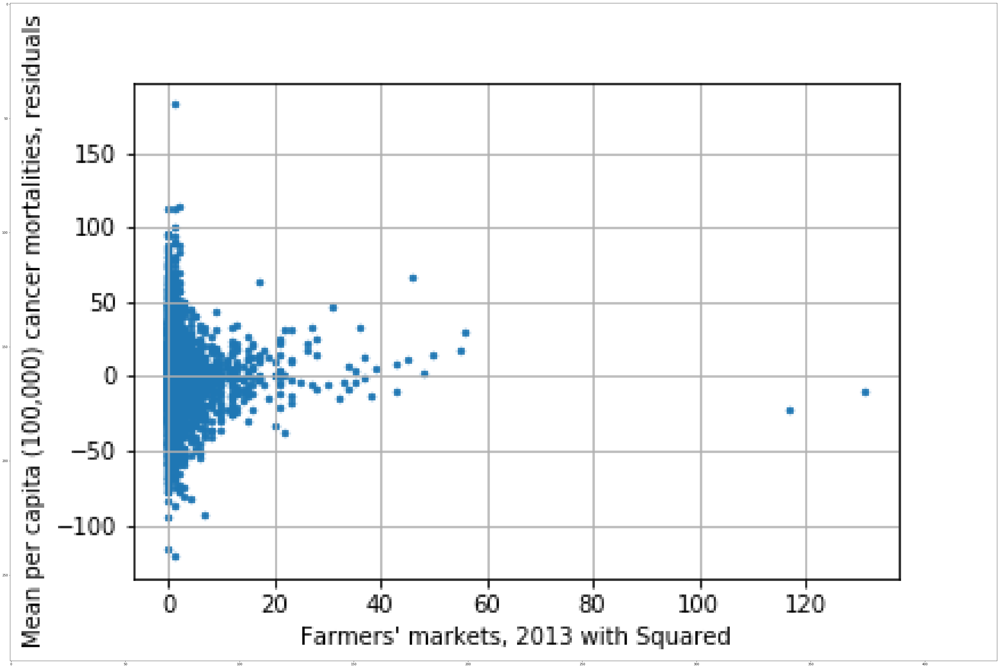

In [478]:
im_89_sqres = plt.imread("FMRKT13_sqrd_residuals.png")
implot_89_sqres = plt.imshow(im_89_sqres)

## 'PCH_FMRKT_09_13': Farmers' markets (% change), 2009-13

The percentage change in farmers' markets between 2009 and 2013 ranges from -100% to 1,400%, with a mean value of 26.4% and a standard deviation of 82.3%. The counties with the lowest percentage increase were in Wisconsin, Colorado, Virginia, Mississippi, and Tennessee. The counties with the highest percentage were in Colorado, Texas, Montana, Virginia and New Mexico.

In [479]:
cancer.describe().PCH_FMRKT_09_13

count    3047.000000
mean       26.433100
std        82.285113
min      -100.000000
25%         0.000000
50%         0.000000
75%        21.825397
max      1400.000000
Name: PCH_FMRKT_09_13, dtype: float64

Text(0, 0.5, 'Number of Counties')

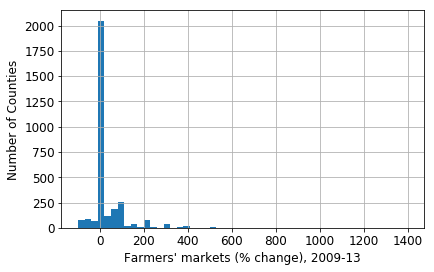

In [480]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PCH_FMRKT_09_13'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Farmers' markets (% change), 2009-13", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [481]:
PCH_F_MRKT_09_13 = cancer.sort_values(by='PCH_FMRKT_09_13').PCH_FMRKT_09_13
PCH_F_MRKT_09_13.head()

Geography
Stanton County, Nebraska     -100.0
Cass County, Illinois        -100.0
McCracken County, Kentucky   -100.0
Kendall County, Illinois     -100.0
McLean County, Kentucky      -100.0
Name: PCH_FMRKT_09_13, dtype: float64

In [482]:
PCH_F_MRKT_09_13.tail()

Geography
Orange County, Florida          600.0
Richland County, Ohio           600.0
Kalamazoo County, Michigan      900.0
Centre County, Pennsylvania    1100.0
Fulton County, Georgia         1400.0
Name: PCH_FMRKT_09_13, dtype: float64

There is a very weak negative correlation of -0.08 between the percentage change in farmers' markets between 2009 and 2013 and cancer mortality. Therefore, as this percentage increases, cancer mortality very slightly decreases. 

In [483]:
r_PCH_FMRKT_09_13 = pearson_r(cancer['PCH_FMRKT_09_13'], cancer['TARGET_deathRate'])
r_PCH_FMRKT_09_13

-0.07926145549392648

In [484]:
cov_matrix_PCH_FMRKT_09_13 = np.cov(cancer['PCH_FMRKT_09_13'], cancer['TARGET_deathRate'])
cov_matrix_PCH_FMRKT_09_13

array([[6770.83981471, -180.99640634],
       [-180.99640634,  770.14638047]])

One can see the weakly negative correlation between percentage change in farmers' markets between 2009 and 2013  and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the exponential transformations of 'PCH_FMRKT_09_13' are added, and doing so increased the model's accuracy by 0.0000007.

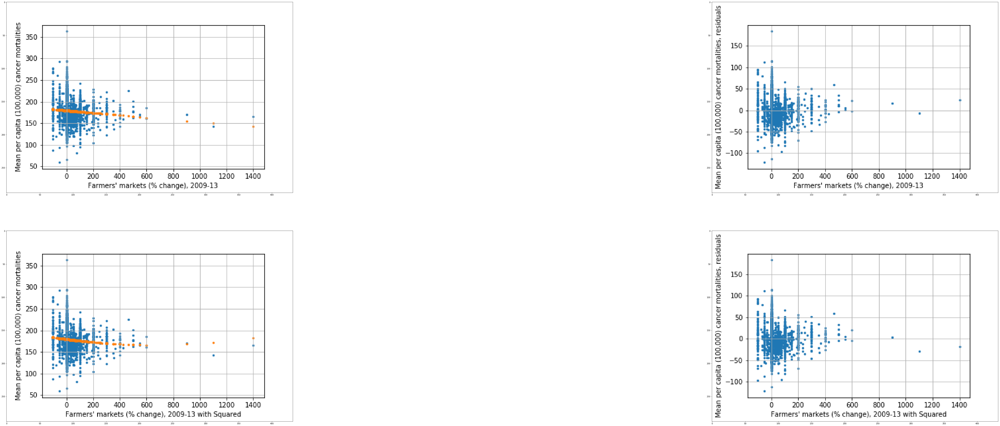

In [485]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_90_ap = plt.imread("PCH_FMRKT_09_13_actual_&_predicted_Y.png")
implot_90_ap = plt.imshow(im_90_ap)
plt.subplot(2, 2, 2)
im_90_r = plt.imread("PCH_FMRKT_09_13_residuals.png")
implot_90_r = plt.imshow(im_90_r)
plt.subplot(2, 2, 3)
im_90_sq = plt.imread("PCH_FMRKT_09_13_sqrd_actual_&_predicted_Y.png")
implot_90_sq = plt.imshow(im_90_sq)
plt.subplot(2, 2, 4)
im_90_sqres = plt.imread("PCH_FMRKT_09_13_sqrd_residuals.png")
implot_90_sqres = plt.imshow(im_90_sqres)

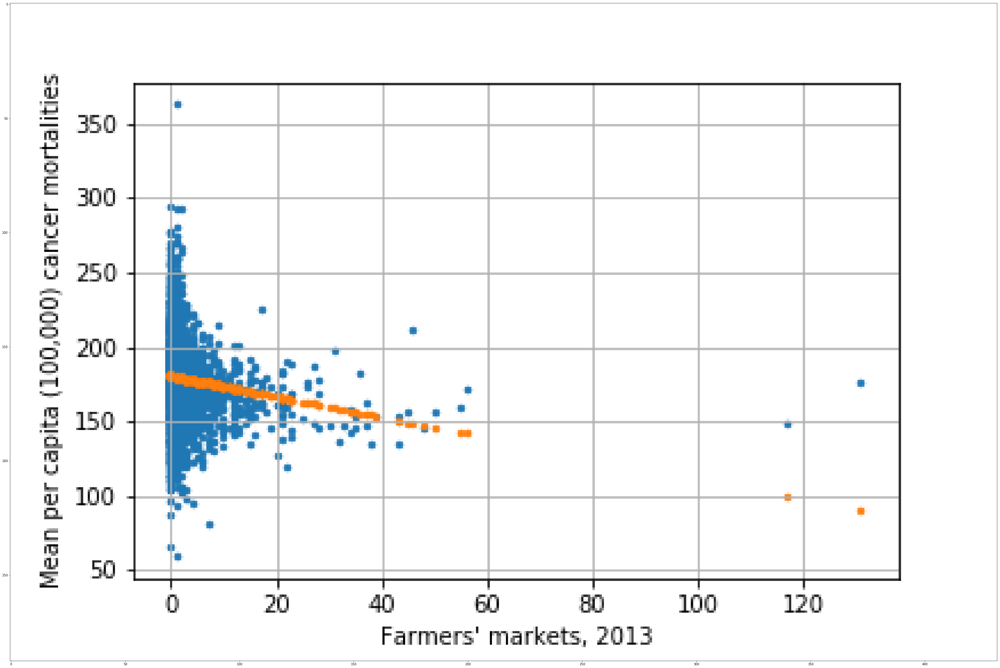

In [486]:
im_89_ap = plt.imread("FMRKT13_actual_&_predicted_Y.png")
implot_89_ap = plt.imshow(im_89_ap)

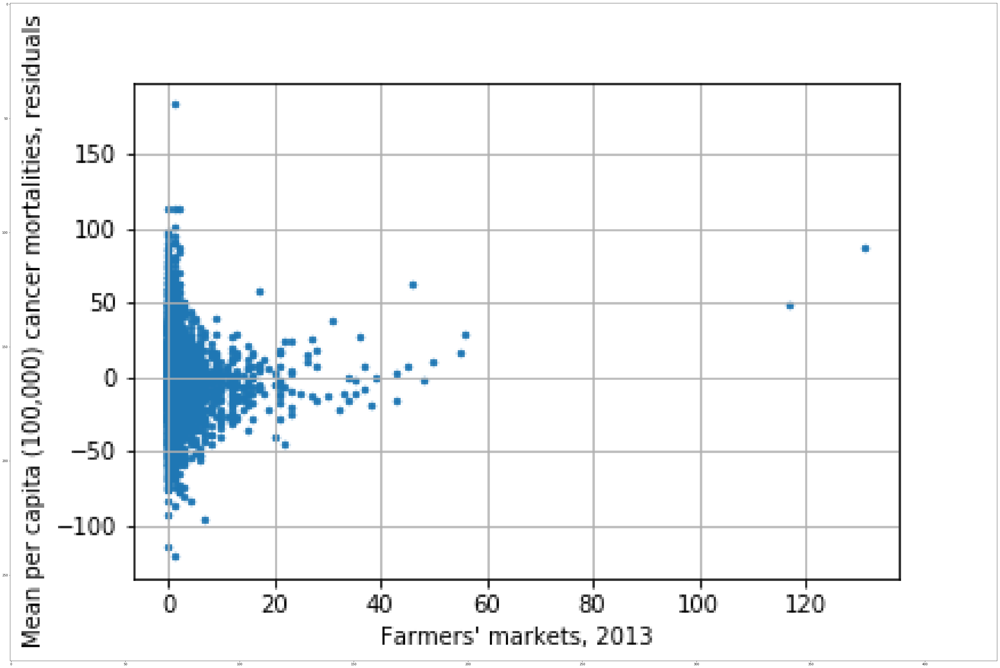

In [487]:
im_89_r = plt.imread("FMRKT13_residuals.png")
implot_89_r = plt.imshow(im_89_r)

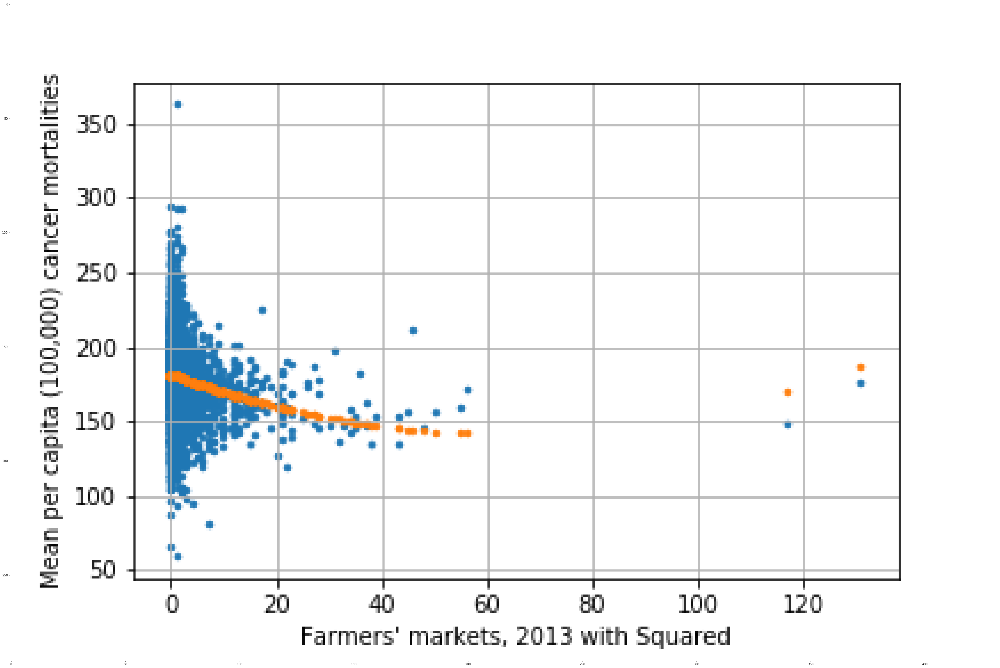

In [488]:
im_89_sq = plt.imread("FMRKT13_sqrd_actual_&_predicted_Y.png")
implot_89_sq = plt.imshow(im_89_sq)

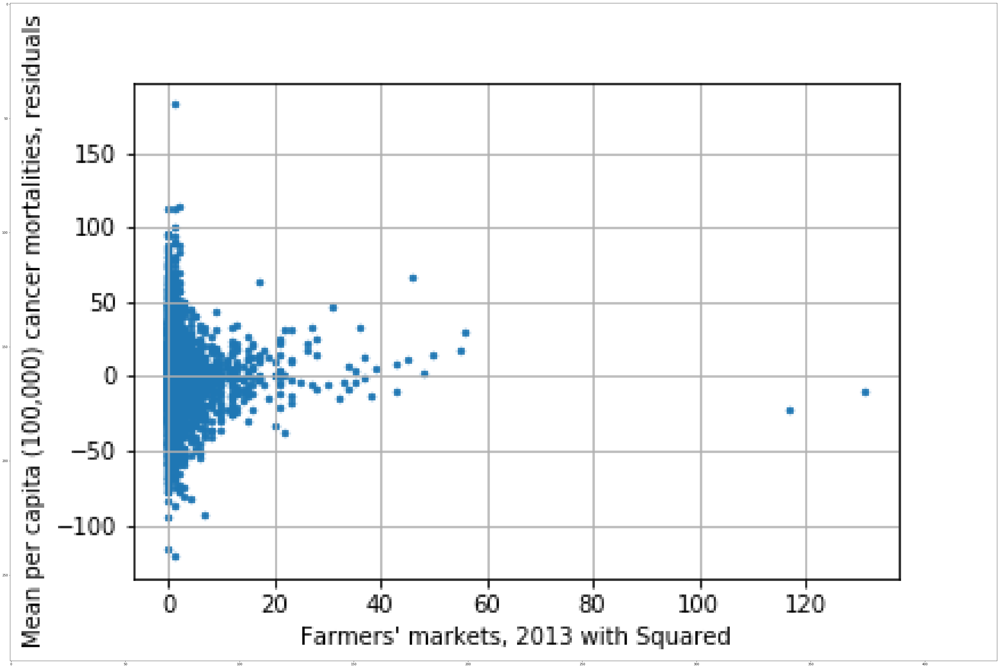

In [489]:
im_89_sqres = plt.imread("FMRKT13_sqrd_residuals.png")
implot_89_sqres = plt.imshow(im_89_sqres)

## 'PCT_DIABETES_ADULTS10': Adult diabetes rate, 2010

The percentage of adults in each county with diabetes (in 2010) ranges from 3.3% to 19.4%, with a mean value of 10.7% and a standard deviation of 2.3%. The counties with the lowest percentage were in Colorado, Wyoming and Utah. The counties with the highest percentage were in Mississippi and Alabama.

In [490]:
cancer.describe().PCT_DIABETES_ADULTS10

count    3047.000000
mean       10.728684
std         2.247625
min         3.300000
25%         9.200000
50%        10.600000
75%        12.200000
max        19.400000
Name: PCT_DIABETES_ADULTS10, dtype: float64

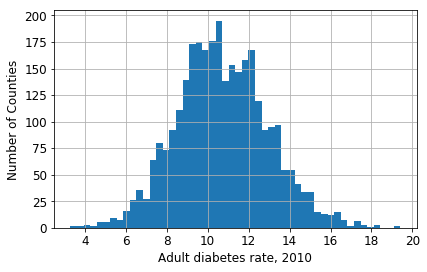

In [491]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['PCT_DIABETES_ADULTS10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Adult diabetes rate, 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PCT_DIABETES_ADULTS10_dist.png')

In [492]:
PCT_DIABETES_ADULTS_10 = cancer.sort_values(by='PCT_DIABETES_ADULTS10').PCT_DIABETES_ADULTS10
PCT_DIABETES_ADULTS_10.head()

Geography
Routt County, Colorado     3.3
Eagle County, Colorado     3.6
Teton County, Wyoming      3.9
Summit County, Colorado    3.9
Summit County, Utah        4.0
Name: PCT_DIABETES_ADULTS10, dtype: float64

In [493]:
PCT_DIABETES_ADULTS_10.tail()

Geography
Jefferson County, Mississippi    18.2
Perry County, Alabama            18.2
Quitman County, Mississippi      18.3
Lowndes County, Alabama          19.3
Greene County, Alabama           19.4
Name: PCT_DIABETES_ADULTS10, dtype: float64

There is a strongly positive correlation of 0.53 between the percentage of adults in each county with diabetes (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality dramatically increases.

Adding a logarithmic or exponential expansion of 'PCT_DIABETES_ADULTS10' did not add to the model's overall accuracy. 

In [494]:
r_PCT_DIABETES_ADULTS10 = pearson_r(cancer['PCT_DIABETES_ADULTS10'], cancer['TARGET_deathRate'])
r_PCT_DIABETES_ADULTS10

0.5281365745674178

In [495]:
cov_matrix_PCT_DIABETES_ADULTS10 = np.cov(cancer['PCT_DIABETES_ADULTS10'], cancer['TARGET_deathRate'])
cov_matrix_PCT_DIABETES_ADULTS10

array([[  5.05181649,  32.9425085 ],
       [ 32.9425085 , 770.14638047]])

## 'PCT_OBESE_ADULTS13': Adult obesity rate, 2013

The percentage of adults in each county with obesity in 2013 ranges from 21.3% to 35.1%, with a mean value of 29.8% and a standard deviation of 3%. The counties with the lowest percentage were all in Colorado. The counties with the highest percentage were in West Virginia and Mississippi.

In [496]:
cancer.describe().PCT_OBESE_ADULTS13

count    3047.000000
mean       29.839219
std         3.017237
min        21.300000
25%        27.800000
50%        30.300000
75%        31.700000
max        35.100000
Name: PCT_OBESE_ADULTS13, dtype: float64

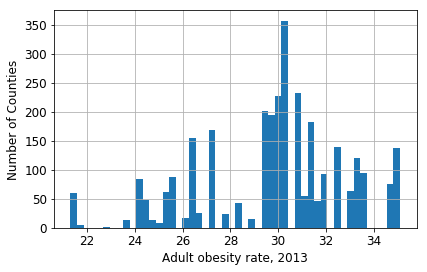

In [497]:
cancer['PCT_OBESE_ADULTS13'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Adult obesity rate, 2013", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.savefig('PCT_OBESE_ADULTS13.png')

In [498]:
PCT_OBESE_ADULTS_13 = cancer.sort_values(by='PCT_OBESE_ADULTS13').PCT_OBESE_ADULTS13
PCT_OBESE_ADULTS_13.head()

Geography
Ouray County, Colorado          21.3
San Miguel County, Colorado     21.3
La Plata County, Colorado       21.3
Clear Creek County, Colorado    21.3
Douglas County, Colorado        21.3
Name: PCT_OBESE_ADULTS13, dtype: float64

In [499]:
PCT_OBESE_ADULTS_13.tail()

Geography
Harrison County, West Virginia    35.1
Grenada County, Mississippi       35.1
Choctaw County, Mississippi       35.1
Taylor County, West Virginia      35.1
Rankin County, Mississippi        35.1
Name: PCT_OBESE_ADULTS13, dtype: float64

There is a moderate to strong positive correlation of 0.43 between the percentage of county adult residents with obesity (in 2013) and cancer mortality. Therefore, as this percentage increases, cancer mortality increases.

In [500]:
r_PCT_OBESE_ADULTS13 = pearson_r(cancer['PCT_OBESE_ADULTS13'], cancer['TARGET_deathRate'])
r_PCT_OBESE_ADULTS13

0.4290654947193953

In [501]:
cov_matrix_PCT_OBESE_ADULTS13 = np.cov(cancer['PCT_OBESE_ADULTS13'], cancer['TARGET_deathRate'])
cov_matrix_PCT_OBESE_ADULTS13

array([[  9.10371745,  35.92688919],
       [ 35.92688919, 770.14638047]])

One can see the moderately positive correlation between the percentage of county adults with obesity (in 2013) and cancer mortality in the prediction line. Adding the logarithmic and exponential transformation of the obesity percentage reduced the error between the actual and predicted values of cancer mortality, and increased the overall accuracy of the linear regression model by 0.000005.

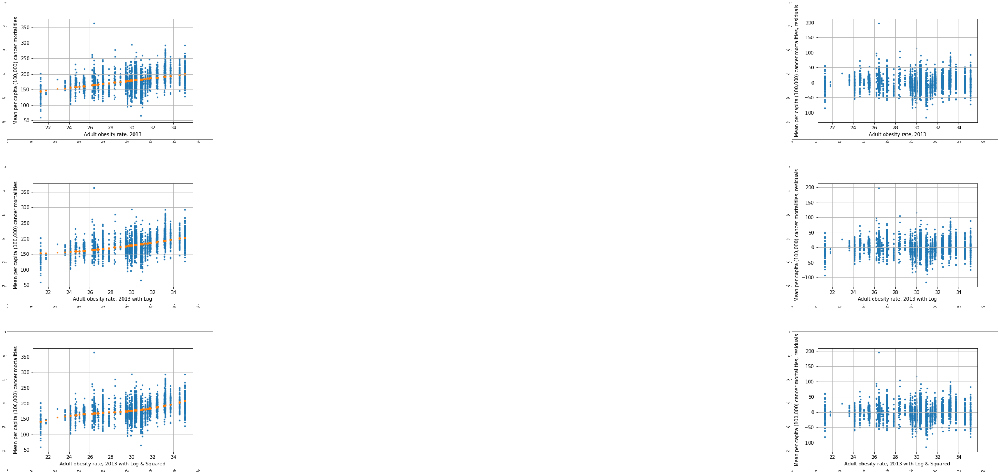

In [502]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(3, 2, 1)
im_92_ap = plt.imread("PCT_OBESE_ADULTS13_actual_&_predicted_Y.png")
implot_92_ap = plt.imshow(im_92_ap)
plt.subplot(3, 2, 2)
im_92_r = plt.imread("PCT_OBESE_ADULTS13_residuals.png")
implot_92_r = plt.imshow(im_92_r)
plt.subplot(3, 2, 3)
im_92_l = plt.imread("PCT_OBESE_ADULTS13_log_actual_&_predicted_Y.png")
implot_92_l = plt.imshow(im_92_l)
plt.subplot(3, 2, 4)
im_92_lres = plt.imread("PCT_OBESE_ADULTS13_log_residuals.png")
implot_92_lres = plt.imshow(im_92_lres)
plt.subplot(3, 2, 5)
im_92_lsq = plt.imread("PCT_OBESE_ADULTS13_log_sqrd_actual_&_predicted_Y.png")
implot_92_lsq = plt.imshow(im_92_lsq)
plt.subplot(3, 2, 6)
im_92_lsqres = plt.imread("PCT_OBESE_ADULTS13_log_sqrd_residuals.png")
implot_92_lsqres = plt.imshow(im_92_lsqres)

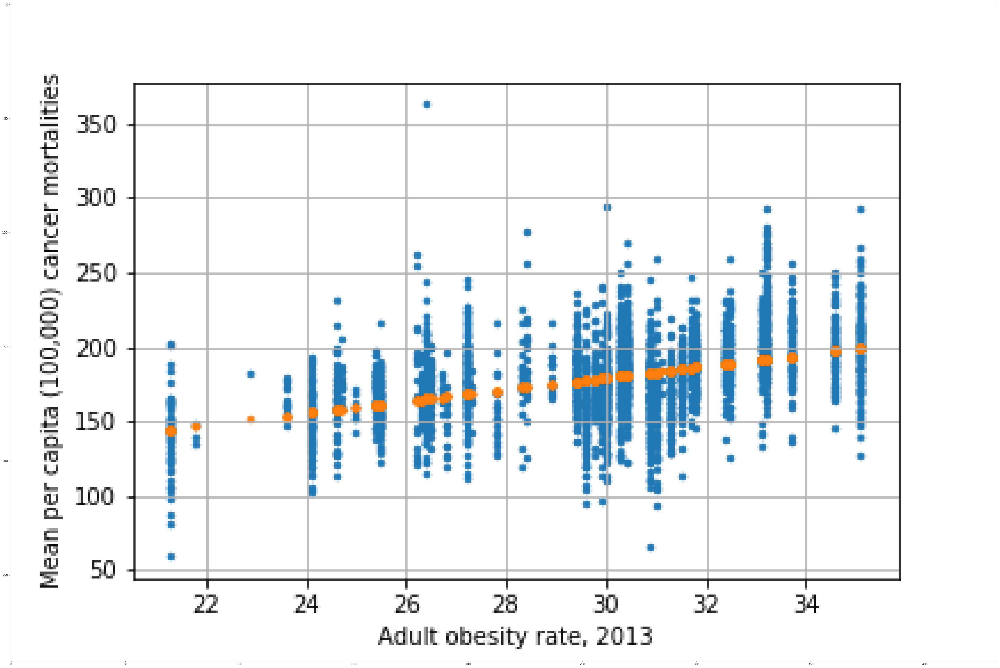

In [503]:
im_92_ap = plt.imread("PCT_OBESE_ADULTS13_actual_&_predicted_Y.png")
implot_92_ap = plt.imshow(im_92_ap)

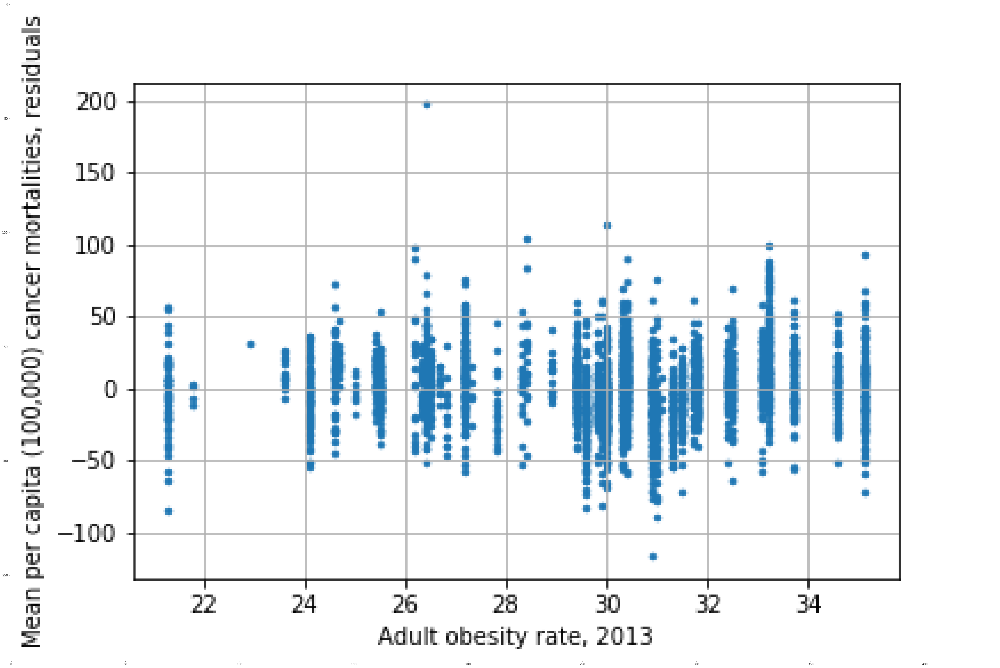

In [504]:
im_92_r = plt.imread("PCT_OBESE_ADULTS13_residuals.png")
implot_92_r = plt.imshow(im_92_r)

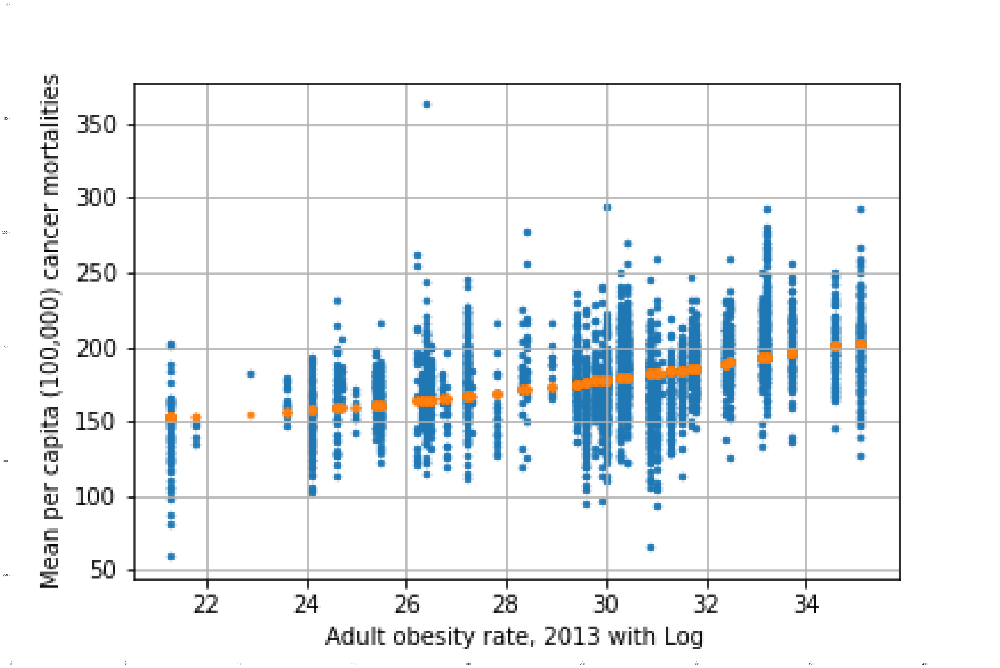

In [505]:
im_92_l = plt.imread("PCT_OBESE_ADULTS13_log_actual_&_predicted_Y.png")
implot_92_l = plt.imshow(im_92_l)

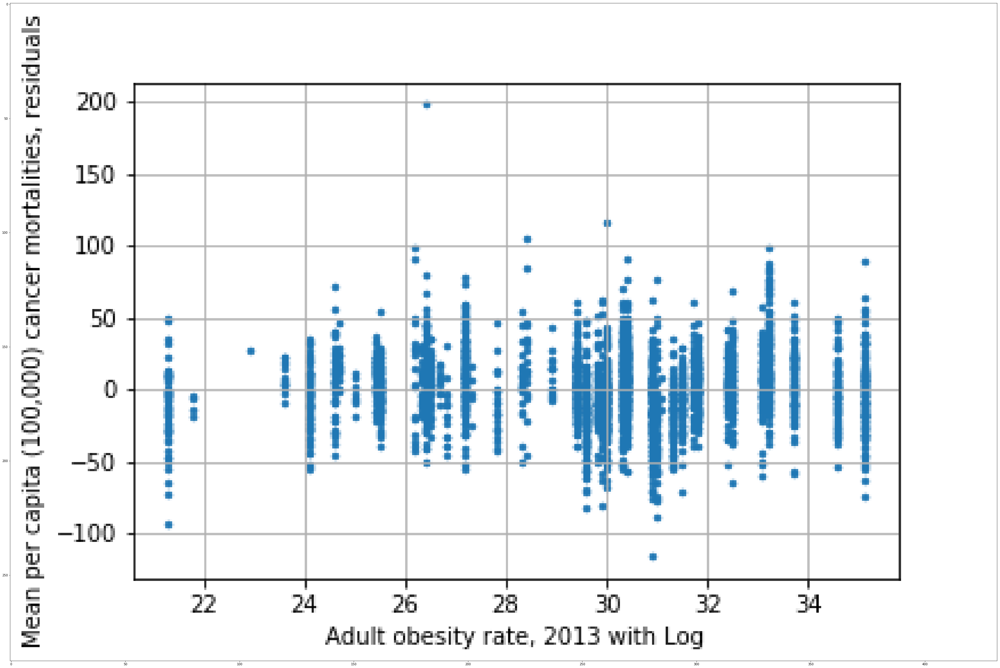

In [506]:
im_92_lres = plt.imread("PCT_OBESE_ADULTS13_log_residuals.png")
implot_92_lres = plt.imshow(im_92_lres)

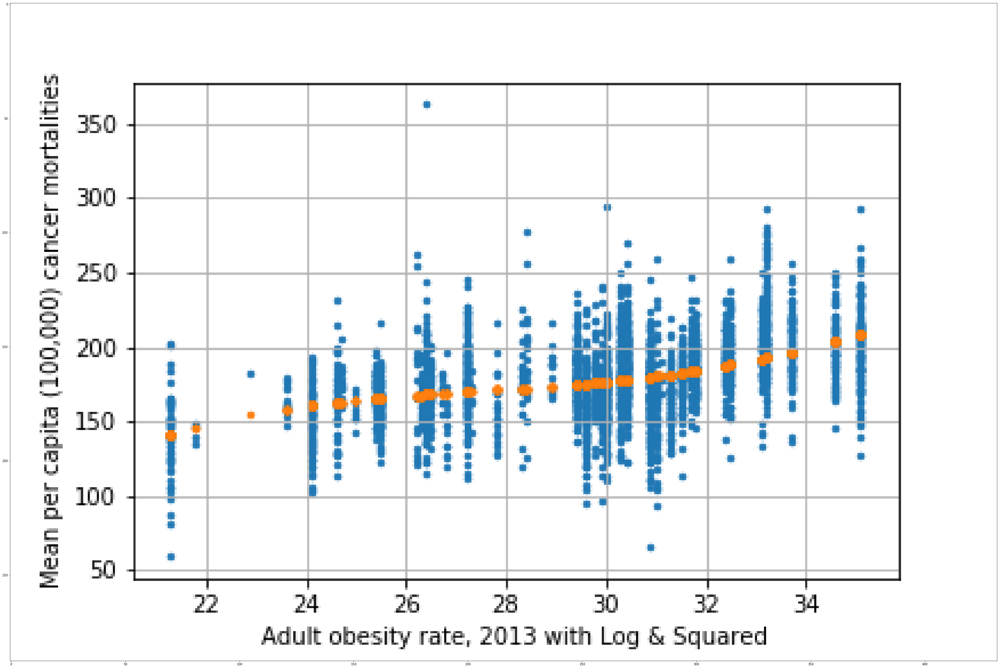

In [507]:
im_92_lsq = plt.imread("PCT_OBESE_ADULTS13_log_sqrd_actual_&_predicted_Y.png")
implot_92_lsq = plt.imshow(im_92_lsq)

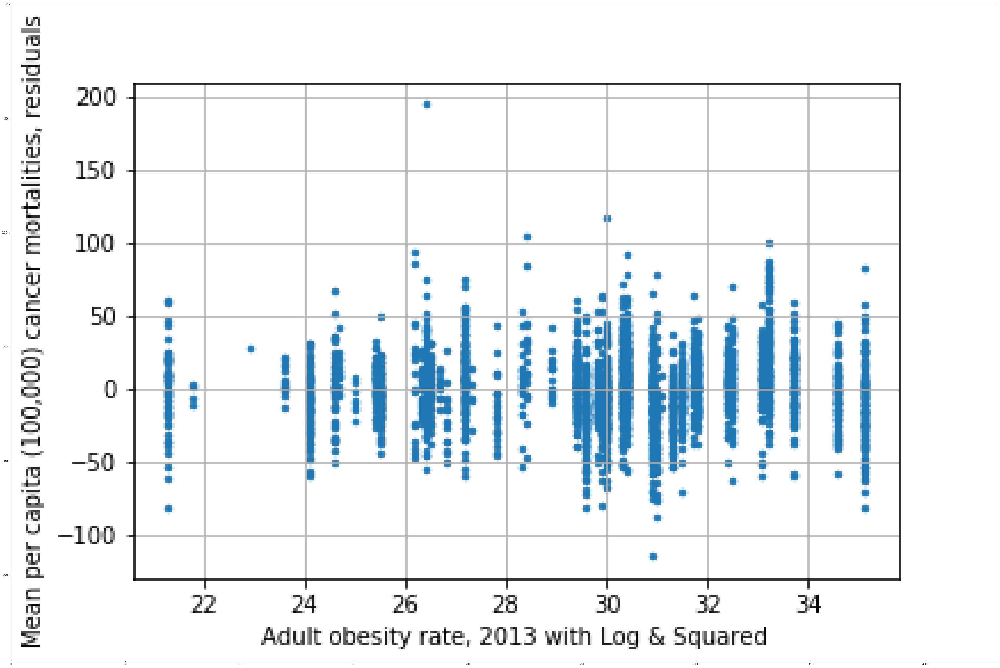

In [508]:
im_92_lsqres = plt.imread("PCT_OBESE_ADULTS13_log_sqrd_residuals.png")
implot_92_lsqres = plt.imshow(im_92_lsqres)

## 'RECFAC12': Recreation & fitness facilities, 2012

The number of recreation and fitness facilities by county (in 2012) ranges from zero to 749, with a mean value of 9.4 and a standard deviation of 30.2. The counties with the lowest number of recreation and fitness facilities were in South Carolina, Texas, South Dakota, Kansas and Oklahoma. The counties with the highest percentage were in California, Washington, New York and Illinois.

In [509]:
cancer.describe().RECFAC12

count    3047.000000
mean        9.438136
std        30.203382
min         0.000000
25%         0.000000
50%         2.000000
75%         6.000000
max       749.000000
Name: RECFAC12, dtype: float64

Text(0, 0.5, 'Number of Counties')

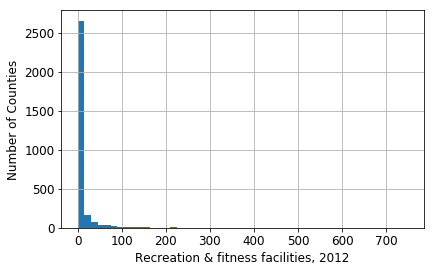

In [510]:
plt.rcParams["figure.figsize"] = (6.5, 4)
cancer['RECFAC12'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Recreation & fitness facilities, 2012", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

(0, 250)

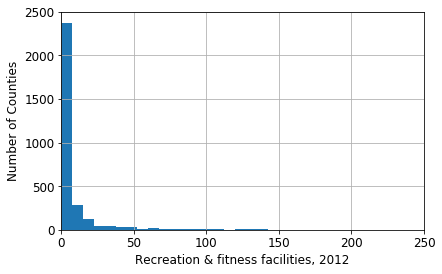

In [511]:
cancer['RECFAC12'].hist(bins=100, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Recreation & fitness facilities, 2012", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)
plt.xlim(0, 250)

In [512]:
REC_FAC_12 = cancer.sort_values(by='RECFAC12').RECFAC12
REC_FAC_12.head()

Geography
Abbeville County, South Carolina    0
Kinney County, Texas                0
Kingsbury County, South Dakota      0
Kingman County, Kansas              0
Kingfisher County, Oklahoma         0
Name: RECFAC12, dtype: int64

In [513]:
REC_FAC_12.tail()

Geography
Orange County, California         316
King County, Washington           327
New York County, New York         422
Cook County, Illinois             460
Los Angeles County, California    749
Name: RECFAC12, dtype: int64

There is a slightly negative correlation of -0.14 between the percentage of recreation and fitness facilities by county (in 2012) and cancer mortality. Therefore, as this percentage increases, cancer mortality slightly decreases.

Adding a logarithmic or exponential expansion of 'REC_FAC_12' did not add to the model's overall accuracy. 

In [514]:
r_RECFAC12 = pearson_r(cancer['RECFAC12'], cancer['TARGET_deathRate'])
r_RECFAC12

-0.14226075669653007

In [515]:
cov_matrix_RECFAC12 = np.cov(cancer['RECFAC12'], cancer['TARGET_deathRate'])
cov_matrix_RECFAC12

array([[ 912.24428385, -119.24147213],
       [-119.24147213,  770.14638047]])

## 'PCH_RECFAC_07_12': Recreation & fitness facilities (% change), 2007-12

The percentage change in recreation and fitness facilities between 2007 and 2012 ranges from -100% to 300%, with a mean value of -10.8% and a standard deviation of 49.6%. The counties with the lowest percentage change were in Iowa, Texas, Arkansas, Virginia and Minnesota. The counties with the highest percentage change were in Wisconsin, Arkansas, North Dakota, Virginia and Minnesota.

In [516]:
cancer.describe().PCH_RECFAC_07_12

count    3047.000000
mean      -10.801615
std        49.622088
min      -100.000000
25%       -33.333333
50%         0.000000
75%         0.000000
max       300.000000
Name: PCH_RECFAC_07_12, dtype: float64

Text(0, 0.5, 'Number of Counties')

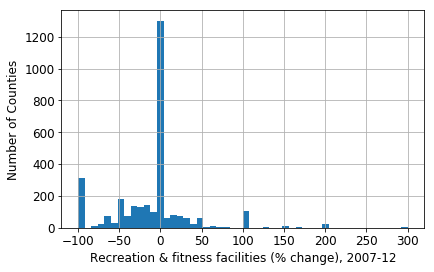

In [517]:
cancer['PCH_RECFAC_07_12'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Recreation & fitness facilities (% change), 2007-12", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [518]:
PCH_REC_FAC_07_12 = cancer.sort_values(by='PCH_RECFAC_07_12').PCH_RECFAC_07_12
PCH_REC_FAC_07_12.head()

Geography
Clayton County, Iowa           -100.0
Stephens County, Texas         -100.0
Drew County, Arkansas          -100.0
Lee County, Virginia           -100.0
Pennington County, Minnesota   -100.0
Name: PCH_RECFAC_07_12, dtype: float64

In [519]:
PCH_REC_FAC_07_12.tail()

Geography
Washburn County, Wisconsin       300.0
Greene County, Arkansas          300.0
Stutsman County, North Dakota    300.0
Falls Church city, Virginia      300.0
Martin County, Minnesota         300.0
Name: PCH_RECFAC_07_12, dtype: float64

There is a very small negative correlation of -0.04 between the percentage change in recreation and fitness facilities between 2007 and 2012 and cancer mortality. Therefore, as this percentage increases, cancer mortality very slightly decreases.

Adding a logarithmic or exponential expansion of 'PCH_RECFAC_07_12' did not add to the model's overall accuracy. 

In [520]:
r_PCH_RECFAC_07_12 = pearson_r(cancer['PCH_RECFAC_07_12'], cancer['TARGET_deathRate'])
r_PCH_RECFAC_07_12

-0.03718137755732569

In [521]:
cov_matrix_PCH_RECFAC_07_12 = np.cov(cancer['PCH_RECFAC_07_12'], cancer['TARGET_deathRate'])
cov_matrix_PCH_RECFAC_07_12

array([[2462.35157708,  -51.20202609],
       [ -51.20202609,  770.14638047]])

## 'NATAMEN': ERS natural amenity index, 1999

According to the USDA, the ERS "natural amenities scale is a measure of the physical characteristics of a county area that enhance the location as a place to live. The scale was constructed by combining six measures of climate, topography, and water area that reflect environmental qualities most people prefer. These measures are warm winter, winter sun, temperate summer, low summer humidity, topographic variation, and water area. The data are available for counties in the lower 48 States." (https://www.ers.usda.gov/data-products/natural-amenities-scale/) 

The range of ERS natural amenity index values (in 1999) is from 1 to 7, with a mean value of 3.5 and a standard deviation of 1.04. The counties with the five lowest rankings were in Minnesota and North Dakota. The counties with the five highest rankings were in California and Colorado.

In [522]:
cancer.describe().NATAMEN

count    3047.000000
mean        3.482442
std         1.038777
min         1.000000
25%         3.000000
50%         3.000000
75%         4.000000
max         7.000000
Name: NATAMEN, dtype: float64

In [523]:
natamen_counts = round(cancer['NATAMEN'].value_counts(normalize=True), 3)*100
natamen_counts

3    40.8
4    31.9
2    14.1
5     7.8
6     3.7
7     1.1
1     0.5
Name: NATAMEN, dtype: float64

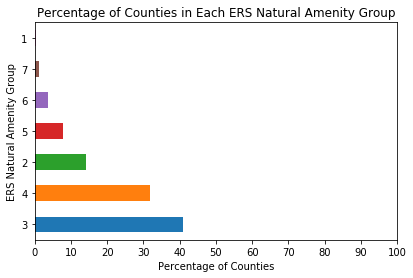

In [524]:
natamen_counts.plot(kind='barh', title='Percentage of Counties in Each ERS Natural Amenity Group', xlim=(0, 100),
                      xticks = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100], color=current_palette)
plt.xlabel('Percentage of Counties')
plt.ylabel('ERS Natural Amenity Group')
plt.show()

In [525]:
NATAMEN_index = cancer.sort_values(by='NATAMEN').NATAMEN
NATAMEN_index.head()

Geography
Dodge County, Minnesota             1
Kittson County, Minnesota           1
Grand Forks County, North Dakota    1
Pennington County, Minnesota        1
Pembina County, North Dakota        1
Name: NATAMEN, dtype: int64

In [526]:
NATAMEN_index.tail()

Geography
Ventura County, California     7
Mono County, California        7
Napa County, California        7
Gilpin County, Colorado        7
Monterey County, California    7
Name: NATAMEN, dtype: int64

There is a slightly negative correlation of -0.17 between ERS Natural Amenity Index rankings (in 1999) and cancer mortality. Therefore, as this percentage increases, cancer mortality slightly decreases.

Adding a logarithmic or exponential expansion of 'NATAMEN' did not add to the model's overall accuracy. 

In [527]:
r_NATAMEN = pearson_r(cancer['NATAMEN'], cancer['TARGET_deathRate'])
r_NATAMEN

-0.16571053087658608

In [528]:
cov_matrix_NATAMEN = np.cov(cancer['NATAMEN'], cancer['TARGET_deathRate'])
cov_matrix_NATAMEN

array([[  1.07905799,  -4.77704289],
       [ -4.77704289, 770.14638047]])

## 'PERPOV10': Persistent-poverty counties, 2010

'PERPOV10', the binary feature describing whether a county has persistent poverty or not (in 2010) has a mean value of 0.11, translating to 11.4% of U.S. counties being classified as being in persistent poverty.

In [529]:
cancer.describe().PERPOV10

count    3047.000000
mean        0.113554
std         0.317321
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: PERPOV10, dtype: float64

In [530]:
perpov10_counts = round(cancer['PERPOV10'].value_counts(normalize=True), 3)*100
perpov10_counts

0    88.6
1    11.4
Name: PERPOV10, dtype: float64

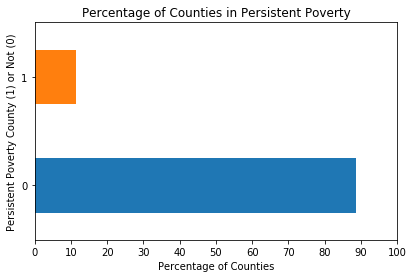

In [531]:
perpov10_counts.plot(kind='barh', title='Percentage of Counties in Persistent Poverty', xlim=(0, 100),
                      xticks = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100], color=current_palette)
plt.xlabel('Percentage of Counties')
plt.ylabel('Persistent Poverty County (1) or Not (0)')
plt.show()

There is a moderately positive correlation of 0.27 between persistent poverty counties and cancer mortality. Therefore, as this percentage increases, cancer mortality increases.

In [532]:
r_PERPOV10 = pearson_r(cancer['PERPOV10'], cancer['TARGET_deathRate'])
r_PERPOV10

0.2690413222864318

In [533]:
cov_matrix_PERPOV10 = np.cov(cancer['PERPOV10'], cancer['TARGET_deathRate'])
cov_matrix_PERPOV10

array([[1.00692780e-01, 2.36921674e+00],
       [2.36921674e+00, 7.70146380e+02]])

## 'CHILDPOVRATE10': Child poverty rate, 2010

The percentage of children in poverty per county (in 2010) ranges from 2.7% to 61.1%, with a mean value of 24.2% and a standard deviation of 9%. The counties with the lowest percentage of its children in poverty (in 2010) were in Virginia, New Mexico, Colorado, New Jersey and Virginia. The counties with the highest percentage were in Georgia and Mississippi.

In [534]:
cancer.describe().CHILDPOVRATE10

count    3047.000000
mean       24.178405
std         9.041120
min         2.700000
25%        17.400000
50%        23.500000
75%        29.900000
max        61.100000
Name: CHILDPOVRATE10, dtype: float64

Text(0, 0.5, 'Number of Counties')

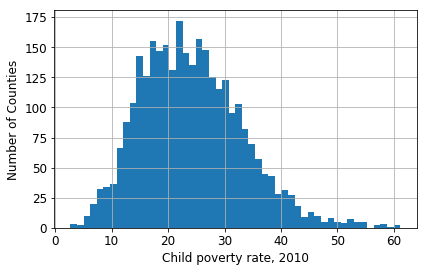

In [535]:
cancer['CHILDPOVRATE10'].hist(bins=50, grid=True, xlabelsize=12, ylabelsize=12)
plt.xlabel("Child poverty rate, 2010", fontsize=12)
plt.ylabel("Number of Counties", fontsize=12)

In [536]:
CHILDPOVRATE10 = cancer.sort_values(by='CHILDPOVRATE10').CHILDPOVRATE10
CHILDPOVRATE10.head()

Geography
Falls Church city, Virginia      2.7
Los Alamos County, New Mexico    3.2
Douglas County, Colorado         3.8
Hunterdon County, New Jersey     4.2
Loudoun County, Virginia         4.2
Name: CHILDPOVRATE10, dtype: float64

In [537]:
CHILDPOVRATE10.tail()

Geography
Atkinson County, Georgia         58.1
Clay County, Georgia             58.3
Sharkey County, Mississippi      58.9
Issaquena County, Mississippi    60.1
Humphreys County, Mississippi    61.1
Name: CHILDPOVRATE10, dtype: float64

There is a moderately positive correlation of 0.45 between the percentage of children in poverty (in 2010) and cancer mortality. Therefore, as this percentage increases, cancer mortality increases.

In [538]:
r_CHILDPOVRATE10 = pearson_r(cancer['CHILDPOVRATE10'], cancer['TARGET_deathRate'])
r_CHILDPOVRATE10

0.4453520514620203

In [539]:
cov_matrix_CHILDPOVRATE10 = np.cov(cancer['CHILDPOVRATE10'], cancer['TARGET_deathRate'])
cov_matrix_CHILDPOVRATE10

array([[ 81.74185786, 111.74094726],
       [111.74094726, 770.14638047]])

One can see the strong positive correlation between the percentage of children in poverty (in 2010) and cancer mortality in the prediction line of the first of the plots below. The error between the actual and predicted data points of cancer mortality is reduced when the logarithmic transformation of 'CHILDPOVRATE10' is added, and doing so increased the model's accuracy by a sizable 0.003.

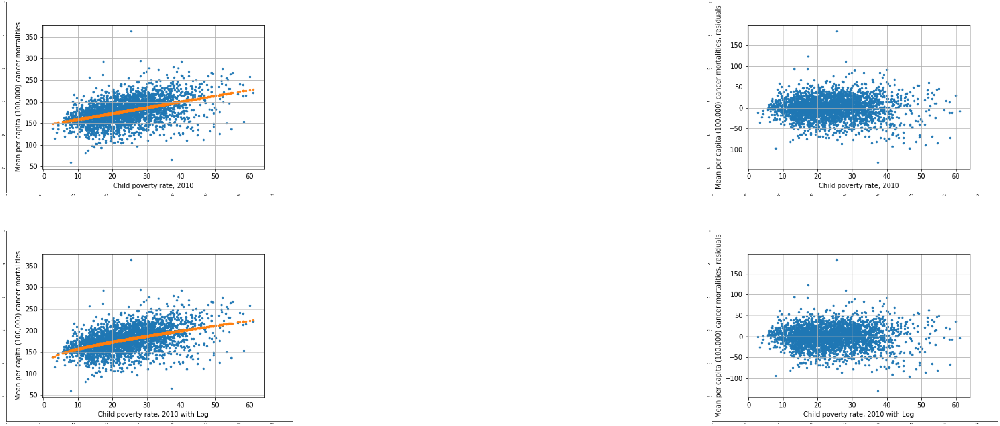

In [540]:
plt.rcParams["figure.figsize"] = (120, 40)
plt.subplot(2, 2, 1)
im_95_ap = plt.imread("CHILDPOVRATE10_actual_&_predicted_Y.png")
implot_95_ap = plt.imshow(im_95_ap)
plt.subplot(2, 2, 2)
im_95_r = plt.imread("CHILDPOVRATE10_residuals.png")
implot_95_r = plt.imshow(im_95_r)
plt.subplot(2, 2, 3)
im_95_l = plt.imread("CHILDPOVRATE10_log_actual_&_predicted_Y.png")
implot_95_l = plt.imshow(im_95_l)
plt.subplot(2, 2, 4)
im_95_lres = plt.imread("CHILDPOVRATE10_log_residuals.png")
implot_95_lres = plt.imshow(im_95_lres)

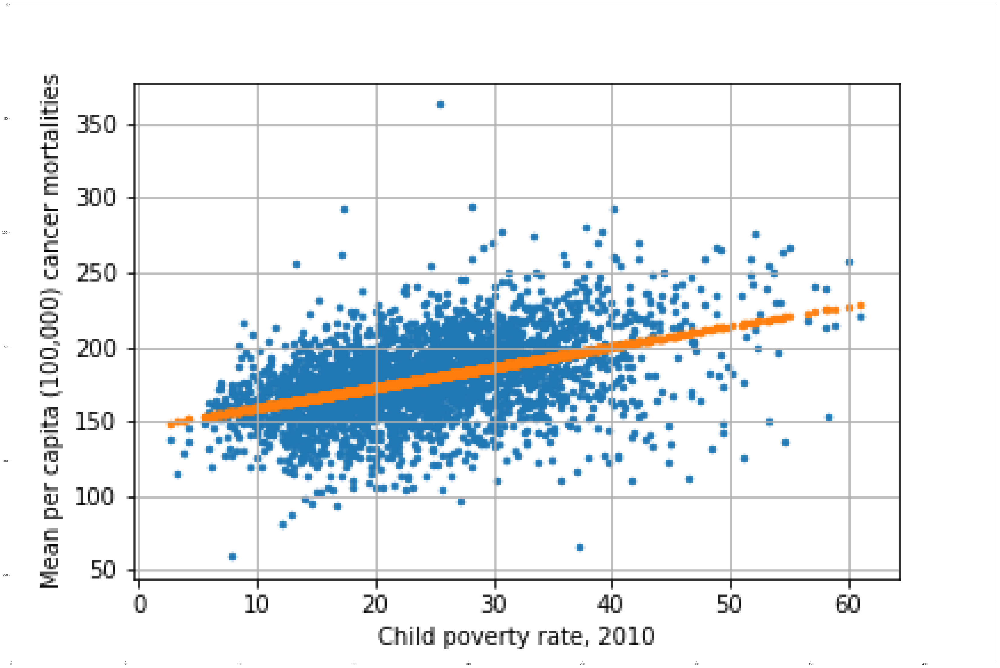

In [541]:
im_95_ap = plt.imread("CHILDPOVRATE10_actual_&_predicted_Y.png")
implot_95_ap = plt.imshow(im_95_ap)

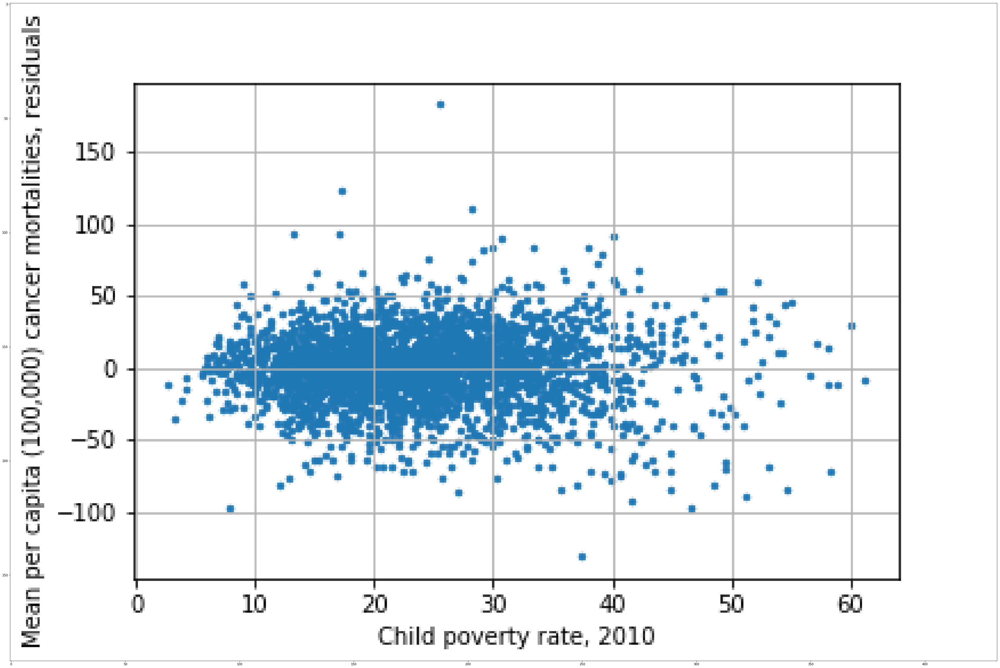

In [542]:
im_95_r = plt.imread("CHILDPOVRATE10_residuals.png")
implot_95_r = plt.imshow(im_95_r)

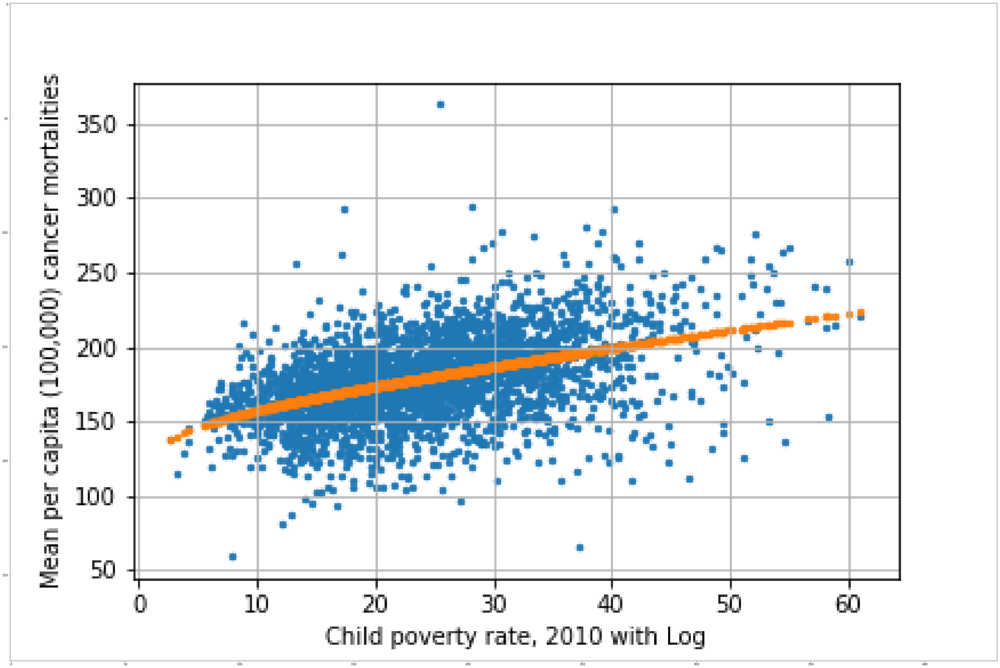

In [543]:
im_95_l = plt.imread("CHILDPOVRATE10_log_actual_&_predicted_Y.png")
implot_95_l = plt.imshow(im_95_l)

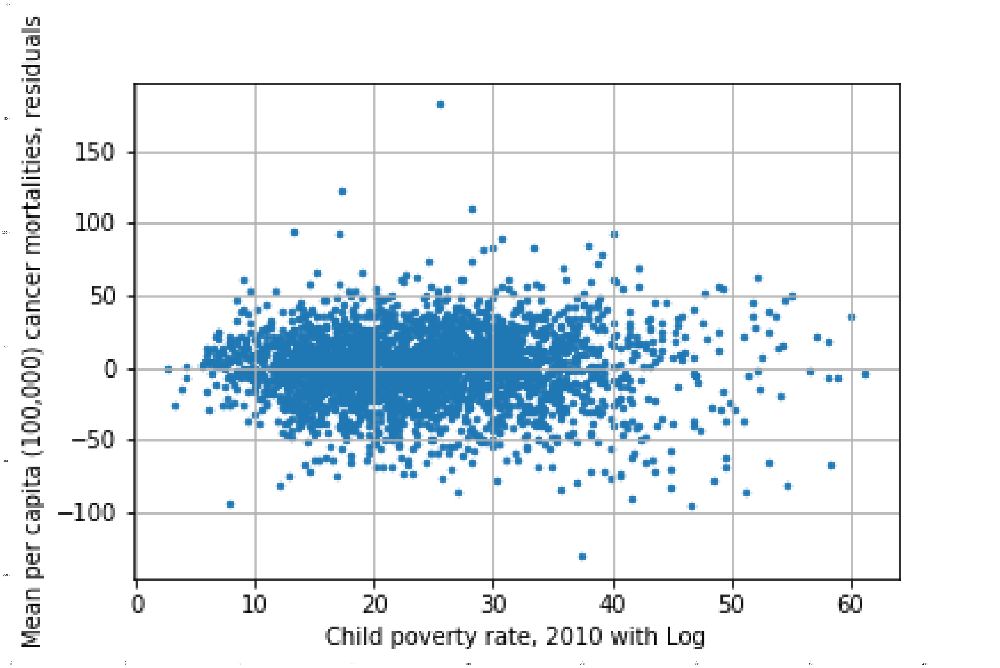

In [544]:
im_95_lres = plt.imread("CHILDPOVRATE10_log_residuals.png")
implot_95_lres = plt.imshow(im_95_lres)

## 'PERCHLDPOV10': Persistent-child-poverty counties, 2010

'PERCHLDPOV10', the binary feature describing whether a county has persistent child poverty or not (in 2010) has a mean value of 0.23, translating to 23% of U.S. counties being classified as having persistent child poverty.

In [545]:
cancer.describe().PERCHLDPOV10

count    3047.000000
mean        0.227437
std         0.419246
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: PERCHLDPOV10, dtype: float64

In [546]:
PERCHLDPOV10_counts = round(cancer['PERCHLDPOV10'].value_counts(normalize=True), 3)*100
PERCHLDPOV10_counts

0    77.3
1    22.7
Name: PERCHLDPOV10, dtype: float64

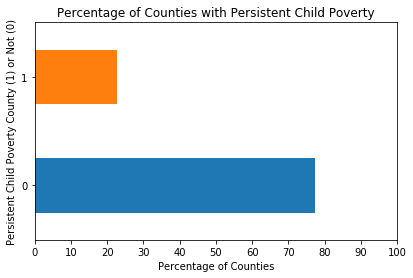

In [547]:
plt.rcParams["figure.figsize"] = (6.5, 4)
PERCHLDPOV10_counts.plot(kind='barh', title='Percentage of Counties with Persistent Child Poverty', xlim=(0, 100),
                      xticks = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100], color=current_palette)
plt.xlabel('Percentage of Counties')
plt.ylabel('Persistent Child Poverty County (1) or Not (0)')
plt.show()

There is a moderately positive correlation of 0.30 between persistent child poverty and cancer mortality. Therefore, as this percentage increases, cancer mortality also increases.

Adding a logarithmic or exponential expansion of 'PERPOV10' did not add to the model's overall accuracy. 

In [548]:
r_PERCHLDPOV10 = pearson_r(cancer['PERCHLDPOV10'], cancer['TARGET_deathRate'])
r_PERCHLDPOV10

0.2963546842606912

In [549]:
cov_matrix_PERCHLDPOV10 = np.cov(cancer['PERCHLDPOV10'], cancer['TARGET_deathRate'])
cov_matrix_PERCHLDPOV10

array([[1.7576700e-01, 3.4479988e+00],
       [3.4479988e+00, 7.7014638e+02]])

## 'METRO13': Metro/nonmetro counties, 2010

'METRO13', the binary feature describing whether a county is metropolitan or not (in 2010) has a mean value of 0.38, translating to 38% of U.S. counties being classified as metropolitan.

In [550]:
cancer.describe().METRO13

count    3047.000000
mean        0.377420
std         0.484821
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: METRO13, dtype: float64

In [551]:
METRO13_counts = round(cancer['METRO13'].value_counts(normalize=True), 3)*100
METRO13_counts

0    62.3
1    37.7
Name: METRO13, dtype: float64

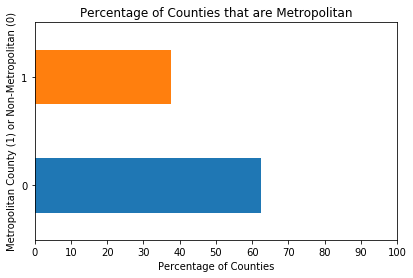

In [552]:
METRO13_counts.plot(kind='barh', title='Percentage of Counties that are Metropolitan', xlim=(0, 100),
                      xticks = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100], color=current_palette)
plt.xlabel('Percentage of Counties')
plt.ylabel('Metropolitan County (1) or Non-Metropolitan (0)')
plt.show()

There is a slightly negative correlation of -0.08 between metropolitan counties and cancer mortality. Therefore, metropolitan counties have a slightly lower rate of cancer mortality.

In [553]:
r_METRO13 = pearson_r(cancer['METRO13'], cancer['TARGET_deathRate'])
r_METRO13

-0.08071192032072759

In [554]:
cov_matrix_METRO13 = np.cov(cancer['METRO13'], cancer['TARGET_deathRate'])
cov_matrix_METRO13

array([[ 2.35051387e-01, -1.08593975e+00],
       [-1.08593975e+00,  7.70146380e+02]])

## 'POPLOSS00': Population-loss counties, 2000

'POPLOSS00', the binary feature describing whether a county has lost population (in 2000) has a mean value of 0.18, translating to 18% of U.S. counties being classified as having population loss in the year 2000.

In [555]:
cancer.describe().POPLOSS00

count    3047.000000
mean        0.184116
std         0.387642
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: POPLOSS00, dtype: float64

In [556]:
POPLOSS00_counts = round(cancer['POPLOSS00'].value_counts(normalize=True), 3)*100
POPLOSS00_counts

0    81.6
1    18.4
Name: POPLOSS00, dtype: float64

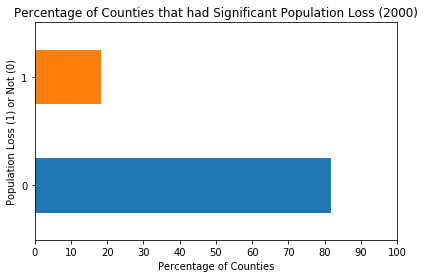

In [557]:
POPLOSS00_counts.plot(kind='barh', title='Percentage of Counties that had Significant Population Loss (2000)', xlim=(0, 100),
                      xticks = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100], color=current_palette)
plt.xlabel('Percentage of Counties')
plt.ylabel('Population Loss (1) or Not (0)')
plt.show()

There is a near non-correlation of 0.025 between population loss and cancer mortality. 

In [558]:
r_POPLOSS00 = pearson_r(cancer['POPLOSS00'], cancer['TARGET_deathRate'])
r_POPLOSS00

0.02510270804641162

In [559]:
cov_matrix_POPLOSS00 = np.cov(cancer['POPLOSS00'], cancer['TARGET_deathRate'])
cov_matrix_POPLOSS00

array([[1.50266314e-01, 2.70046175e-01],
       [2.70046175e-01, 7.70146380e+02]])

# Map of United States Cancer Mortality

In order to map the cancer mortality distribution across the United States, the range of the cancer mortality rate is first established.

In [560]:
target_min = cancer['TARGET_deathRate'].min()
target_max = cancer['TARGET_deathRate'].max()
print(target_min)
print(target_max)

59.7
362.8


A list called 'sorted_death_rate' is created that holds the sorted values of the target variable 'TARGET_deathRate'. The length is verified as the row size of the overall DataFrame.

In [561]:
sorted_death_rate = list(cancer['TARGET_deathRate'].sort_values())
n = len(sorted_death_rate)
n

3047

The lower fence post of each quintile is defined by multiplying each number in the range of 0 through 4 times the length of the 'sorted_death_rate' list divided by 5, and turns it into an integer. This inputs the index location of the lower fence post of each quintile and returns the actual value of the lower fence post of each quintile.

In [562]:
quintiles = [sorted_death_rate[int(i*n/5)] for i in range(5)]
quintiles

[59.7, 156.8, 171.5, 184.3, 200.2]

To verify that this code works, the following cell calculates the index position of the lower fence post for each quintile in simple arithmetical terms.

In [563]:
print(int(0*3047/5))
print(int(1*3047/5))
print(int(2*3047/5))
print(int(3*3047/5))
print(int(4*3047/5))

0
609
1218
1828
2437


Then, the index position of each of these quintile lower fence posts is called to verify that the values of the 'quintiles' list created above are correct. They indeed do match.

In [564]:
print(sorted_death_rate[0])
print(sorted_death_rate[609])
print(sorted_death_rate[1218])
print(sorted_death_rate[1828])
print(sorted_death_rate[2437])

59.7
156.8
171.5
184.3
200.2


In order to solve the "fence post problem" and add the upper limit of the fifth quintile, the last index location of the 'sorted_death_rate' list plus a negligible quantity is appended to the quintiles list.

In [565]:
quintiles.append(sorted_death_rate[-1]+0.1)

In [566]:
cancer['mortality_quintile'] = ''
for i, name in zip(range(6), ('Lowest Mortality', 'Low Mortality', 'Medium Mortality', 'High Mortality', 'Highest Mortality')):
    cancer['mortality_quintile'][
        (cancer['TARGET_deathRate'] >= quintiles[i]) &
        (cancer['TARGET_deathRate'] < quintiles[i+1])
        ] = name

/Users/DanLoew/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [567]:
cancer.head()

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

In [568]:
cancer['mortality_color'] = ''
for i, name in zip(range(6), 'bmgyr'):
    cancer['mortality_color'][
        (cancer['TARGET_deathRate'] >= quintiles[i]) &
        (cancer['TARGET_deathRate'] < quintiles[i+1])
        ] = name

/Users/DanLoew/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [569]:
cancer.head()

,avgAnnCount,TARGET_deathRate,incidenceRate,medIncome,popEst2015,povertyPercent,studyPerCap,MedianAge,MedianAgeMale,MedianAgeFemale,AvgHouseholdSize,PercentMarried,PctNoHS18_24,PctHS18_24,PctSomeCol18_24,PctBachDeg18_24,PctHS25_Over,PctBachDeg25_Over,PctEmployed16_Over,PctUnemployed16_Over,PctPrivateCoverage,PctPrivateCoverageAlone,PctEmpPrivCoverage,PctPublicCoverage,PctPublicCoverageAlone,PctWhite,PctBlack,PctAsian,PctOtherRace,PctMarriedHouseholds,BirthRate,PctSomeCol18_24_isnull,PctEmployed16_Over_isnull,PctPrivateCoverageAlone_isnull,age_gt_100,household_lt_1,"binnedInc_(34218.1, 37413.8]","binnedInc_(37413.8, 40362.7]","binnedInc_(40362.7, 42724.4]","binnedInc_(42724.4, 45201]","binnedInc_(45201, 48021.6]","binnedInc_(48021.6, 51046.4]","binnedInc_(51046.4, 54545.6]","binnedInc_(54545.6, 61494.5]","binnedInc_(61494.5, 125635]","binnedInc_[22640, 34218.1]",ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG,State_Alabama,State_Alaska,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,State_Georgia,State_Hawaii,State_Idaho,State_Illinois,State_Indiana,State_Iowa,State_Kansas,State_Kentucky,State_Louisiana,State_Maine,State_Maryland,State_Massachusetts,State_Michigan,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Nebraska,State_Nevada,State_New Hampshire,State_New Jersey,State_New Mexico,State_New York,State_North Carolina,State_North Dakota,State_Ohio,State_Oklahoma,State_Oregon,State_Pennsylvania,State_Rhode Island,State_South Carolina,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming,utmda_l1,mskcc_l1,mayo_l1,hopkins_l1,dfb_l1,cleveland_l1,upmcps_l1,hlmcc_l1,mgs_l1,nw_mem_l1,chi_l1,nyc_l1,atlanta_l1,dallas_l1,denver_l1,los_ang_l1,seattle_l1,san_fran_l1,utmda_l2,mskcc_l2,mayo_l2,hopkins_l2,dfb_l2,cleveland_l2,upmcps_l2,hlmcc_l2,mgs_l2,nw_mem_l2,chi_l2,nyc_l2,atlanta_l2,dallas_l2,denver_l2,los_ang_l2,seattle_l2,san_fran_l2,onc_min_distsl1,onc_min_distsl2,city_min_distsl1,city_min_distsl2,sc_min_dists_l1,sc_min_dists_l2,PCT_LACCESS_POP10,PCT_LACCESS_LOWI10,PCT_LACCESS_CHILD10,PCT_LACCESS_SENIORS10,PCT_LACCESS_HHNV10,PCT_LACCESS_POP10_isnull,PCT_LACCESS_LOWI10_isnull,PCT_LACCESS_CHILD10_isnull,PCT_LACCESS_SENIORS10_isnull,PCT_LACCESS_HHNV10_isnull,FOODINSEC_00_02,FOODINSEC_07_09,FOODINSEC_10_12,CH_FOODINSEC_02_12,CH_FOODINSEC_09_12,VLFOODSEC_00_02,VLFOODSEC_07_09,VLFOODSEC_10_12,CH_VLFOODSEC_02_12,CH_VLFOODSEC_09_12,FOODINSEC_CHILD_01_07,FOODINSEC_CHILD_03_11,FOODINSEC_00_02_isnull,FOODINSEC_07_09_isnull,FOODINSEC_10_12_isnull,CH_FOODINSEC_02_12_isnull,CH_FOODINSEC_09_12_isnull,VLFOODSEC_00_02_isnull,VLFOODSEC_07_09_isnull,VLFOODSEC_10_12_isnull,CH_VLFOODSEC_02_12_isnull,CH_VLFOODSEC_09_12_isnull,FOODINSEC_CHILD_01_07_isnull,FOODINSEC_CHILD_03_11_isnull,PCT_LOCLFARM07,PCT_LOCLSALE07,PC_DIRSALES07,FMRKT09,FMRKT13,PCH_FMRKT_09_13,FMRKTPTH09,FMRKTPTH13,PCH_FMRKTPTH_09_13,PCT_FMRKT_SNAP13,PCT_FMRKT_WIC13,PCT_FMRKT_WICCASH13,PCT_FMRKT_SFMNP13,PCT_FRMKT_FRVEG13,PCT_FRMKT_ANMLPROD13,PCT_FMRKT_OTHER13,VEG_FARMS07,VEG_ACRES07,VEG_ACRESPTH07,FRESHVEG_FARMS07,FRESHVEG_ACRES07,FRESHVEG_ACRESPTH07,ORCHARD_FARMS07,ORCHARD_ACRES07,ORCHARD_ACRESPTH07,BERRY_FARMS07,BERRY_ACRES07,BERRY_ACRESPTH07,SLHOUSE07,GHVEG_FARMS07,GHVEG_SQFT07,GHVEG_SQFTPTH07,FOODHUB12,CSA07,AGRITRSM_OPS07,AGRITRSM_RCT07,FARM_TO_SCHOOL,PCT_LOCLFARM07_isnull,PCT_LOCLSALE07_isnull,PC_DIRSALES07_isnull,FMRKT09_isnull,FMRKT13_isnull,PCH_FMRKT_09_13_isnull,FMRKTPTH09_isnull,FMRKTPTH13_isnull,PCH_FMRKTPTH_09_13_isnull,PCT_FMRKT_SNAP13_isnull,PCT_FMRKT_WIC13_isnull,PCT_FMRKT_WICCASH13_isnull,PCT_FMRKT_SFMNP13_isnull,PCT_FRMKT_FRVEG13_isnull,PCT_FRMKT_ANMLPROD13_isnull,PCT_FMRKT_OTHER13_isnull,VEG_FARMS07_isnull,VEG_ACRES07_isnull,VEG_ACRESPTH07_isnull,FRESHVEG_FARMS07_isnull,FRESHVEG_ACRES07_isnull,FRESHVEG_ACRESPTH07_isnull,ORCHARD_FARMS07_isnull,ORCHARD_ACRES07_isnull,ORCHARD_AC

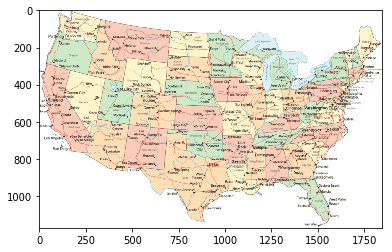

In [570]:
im_1 = plt.imread("map_of_continental_us.png")
implot_1 = plt.imshow(im_1)
# source: https://www.united-states-map.com/continental-us.htm

The latitude/longitude extent for the continental U.S. was found at https://www.quora.com/What-is-the-longitude-and-latitude-of-a-bounding-box-around-the-continental-United-States .

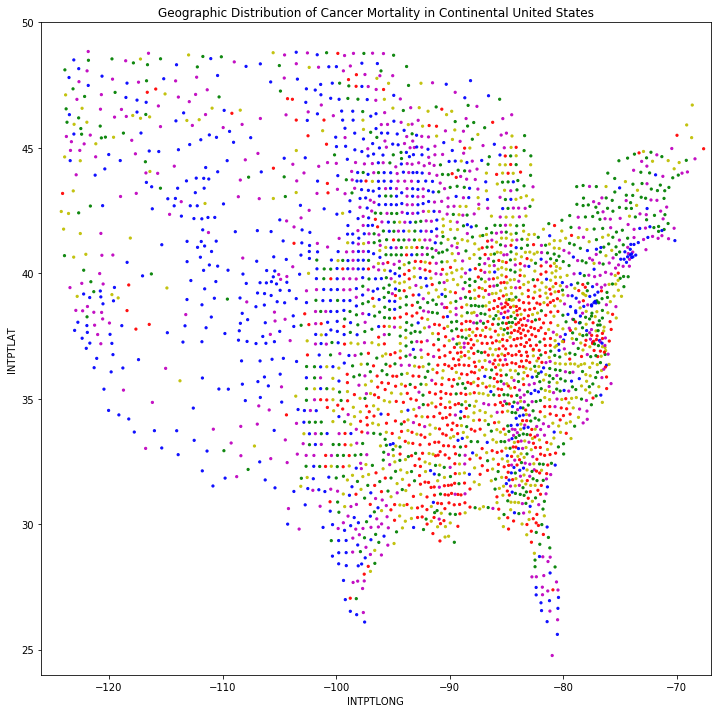

In [571]:
cancer.plot(
    x='INTPTLONG', 
    y='INTPTLAT', 
    kind='scatter', 
    figsize=(12, 12), 
    c=cancer['mortality_color'], 
    s=5, 
    alpha=0.9, 
    title='Geographic Distribution of Cancer Mortality in Continental United States')
plt.xlim(-126, -67)
plt.ylim(24, 50)
plt.savefig('Geographic Distribution of Cancer Mortality in Continental United States no map.png')

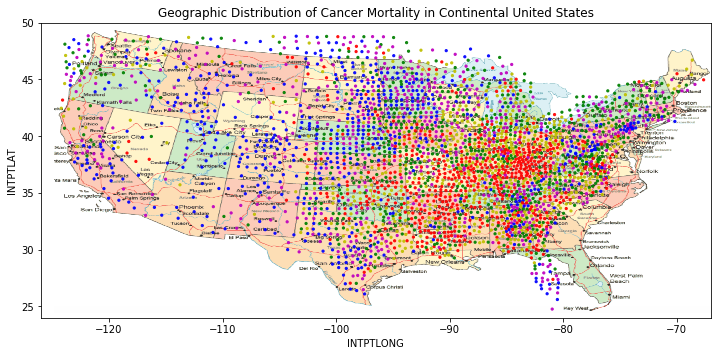

In [572]:
cancer.plot(
    x='INTPTLONG', 
    y='INTPTLAT', 
    kind='scatter', 
    figsize=(12, 12), 
    c=cancer['mortality_color'], 
    s=5, 
    alpha=0.9, 
    title='Geographic Distribution of Cancer Mortality in Continental United States')
plt.xlim(-126, -67)
plt.ylim(24, 50)
plt.imshow(im_1, zorder=0, extent=[-124.848974, -66.885444, 24.396308, 49.384358])
plt.savefig('Geographic Distribution of Cancer Mortality in Continental United States w map.png')

References:

Sim, J., Kim, Y., Kim, J., Lee, J., Kim, M., Shim, Y., Zo, J., Yun, Y. (2020, July). The major effects of health-related quality of life on 5-year survival prediction among lung cancer survivors: applications of machine learning. Scientific Reports 2020; 10: 10693. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7329866/

Gupta, S., Tran, T., Luo, W., Phung, D., Kennedy, R., Broad, A., Campbell, D., Kipp, D., Singh, M., Khasraw, M., Matheson, L., Ashley, D., Venkatesh, S. (2014, March). Machine-learning prediction of cancer survival: a retrospective study using electronic administrative records and a cancer registry. BMJ Open. 2014; 4(3): e004007. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3963101/